In [1]:
import os
from google.colab import drive
drive.mount('/content/drive',force_remount=True)

Mounted at /content/drive


# Entrenamiento RIRs sintéticas:

En este notebook se realiza el entrenamiento del modelo propuesto. Para esto, necesito conseguir las TAE de los audios y sus labels (es decir, el valor de tr al que quiero aproximar)

In [ ]:
#Librerías necesarias:
import sys 
sys.path.append('/content/drive/My Drive/Tesis/Notebooks/scripts')
from tae import TAE
from model import modelo
from preprocessing import preprocessing

import numpy as np
import os
from librosa import load
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from random import randrange

In [ ]:
"""
#Carpeta principal de mi ssd:
os.chdir("/content")
#Creo carpeta para guardar los audios:
os.mkdir("Base de datos")
#Me muevo a esa carpeta:
os.chdir("/content/Base de datos")

#Descomprimo los audios en la ssd:
MAIN_PATH="/content/drive/My Drive/Tesis/Base de datos"
#traigo el archivo a la ssd
tar_path = os.path.join(MAIN_PATH, 'ACE_RIRs_Sinteticas.tar.gz')
!cp "{tar_path}" .

#descomprimo la carpeta
!tar -xvf 'ACE_RIRs_Sinteticas.tar.gz'
!rm 'ACE_RIRs_Sinteticas.tar.gz'

"""

'\n#Carpeta principal de mi ssd:\nos.chdir("/content")\n#Creo carpeta para guardar los audios:\nos.mkdir("Base de datos")\n#Me muevo a esa carpeta:\nos.chdir("/content/Base de datos")\n\n#Descomprimo los audios en la ssd:\nMAIN_PATH="/content/drive/My Drive/Tesis/Base de datos"\n#traigo el archivo a la ssd\ntar_path = os.path.join(MAIN_PATH, \'ACE_RIRs_Sinteticas.tar.gz\')\n!cp "{tar_path}" .\n\n#descomprimo la carpeta\n!tar -xvf \'ACE_RIRs_Sinteticas.tar.gz\'\n!rm \'ACE_RIRs_Sinteticas.tar.gz\'\n\n'

In [ ]:
"""
# Obtengo los nombres de los audios:
path = '/content/Base de datos'
files_name = os.listdir(path)

print(len(files_name))
"""

"\n# Obtengo los nombres de los audios:\npath = '/content/Base de datos'\nfiles_name = os.listdir(path)\n\nprint(len(files_name))\n"

In [ ]:
#Calculo los TAE: CORRER ESTA CELDA SOLO SI NO EXISTEN LOS TAE, SINO SIMPLEMENTE CARGARLOS
#BAND = 8000

#tae, T30 = preprocessing(files_name=files_name, band=BAND)

In [ ]:
#Guardo los TAE: CORRER ESTA CELDA SOLO SI NO EXISTEN LOS TAE, SINO SIMPLEMENTE CARGARLOS
#tae = np.array(tae)
#T30 = np.array(T30)

#np.save(f'/content/drive/My Drive/Tesis/Base de datos/TAE 29000 sintéticas/TAE_'+str(BAND)+'.npy' ,tae)
#np.save(f'/content/drive/My Drive/Tesis/Base de datos/TAE 29000 sintéticas/T30_'+str(BAND)+'_values.npy', T30)

In [ ]:
#Separo en train y test:
X = np.load('/content/drive/My Drive/Tesis/Base de datos/TAE 29000 sintéticas/TAE_1000.npy')
y = np.load('/content/drive/My Drive/Tesis/Base de datos/TAE 29000 sintéticas/T30_1000_values.npy')

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

Banda de 1000 Hz:

In [ ]:
#Cargo el modelo:
blind_estimation_model_1000 = modelo()

#Descripción:
#blind_estimation_model_1000.summary()

In [ ]:
blind_estimation_model_1000.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
#Entreno el modelo:
history = blind_estimation_model_1000.fit(x=X_train, y=y_train, validation_split=0.1, batch_size=128, epochs=100)

Epoch 1/100
164/164 [==============================] - 3s 9ms/step - loss: 1.2360 - val_loss: 0.9511
Epoch 2/100
164/164 [==============================] - 1s 7ms/step - loss: 0.1955 - val_loss: 0.5720
Epoch 3/100
164/164 [==============================] - 1s 7ms/step - loss: 0.1287 - val_loss: 0.2515
Epoch 4/100
164/164 [==============================] - 2s 9ms/step - loss: 0.0970 - val_loss: 0.1201
Epoch 5/100
164/164 [==============================] - 1s 7ms/step - loss: 0.0803 - val_loss: 0.0415
Epoch 6/100
164/164 [==============================] - 1s 7ms/step - loss: 0.0691 - val_loss: 0.0387
Epoch 7/100
164/164 [==============================] - 1s 7ms/step - loss: 0.0590 - val_loss: 0.0303
Epoch 8/100
164/164 [==============================] - 1s 7ms/step - loss: 0.0508 - val_loss: 0.0350
Epoch 9/100
164/164 [==============================] - 1s 7ms/step - loss: 0.0442 - val_loss: 0.0393
Epoch 10/100
164/164 [==============================] - 1s 7ms/step - loss: 0.0407 - val_lo

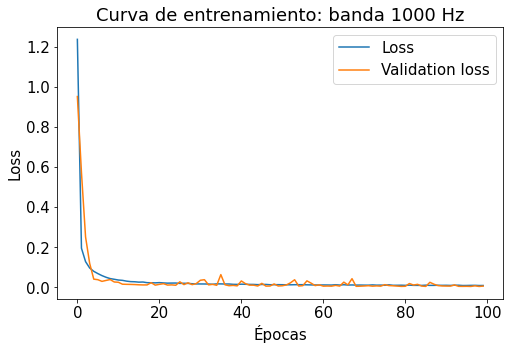

In [ ]:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title('Curva de entrenamiento: banda 1000 Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction_1000 = [np.round(blind_estimation_model_1000.predict(X_test[i,:,0].reshape(1,-1,1)),1)[0][0] for i in range(len(y_test))]

error_1000 = prediction_1000 - y_test

In [ ]:
error_1000

array([ 0.00000000e+00, -1.19209289e-08, -1.00000095e-01, ...,
       -1.00000024e-01, -2.38418578e-08, -1.19209289e-08])

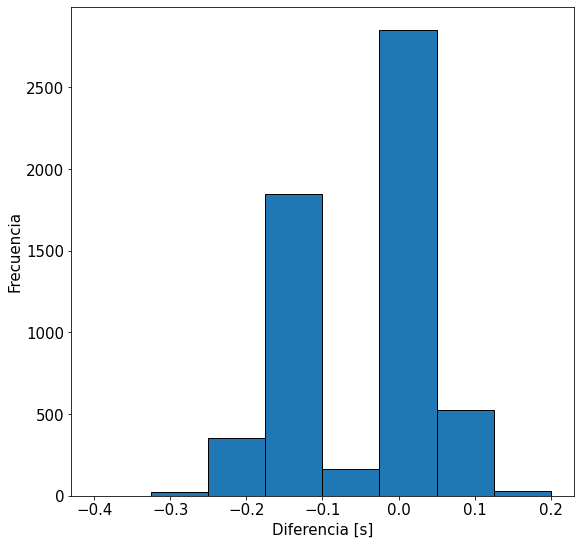

In [ ]:
import matplotlib.pyplot as plt

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

#ax.set_title('Histograma del RMSE')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(error_1000, bins=8, edgecolor="black");

Text(0, 0.5, 'Valor real [s]')

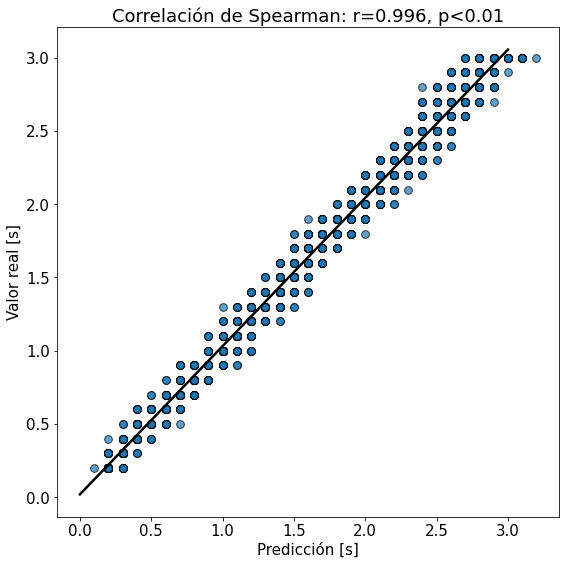

In [ ]:
# Generate data
x = prediction_1000
y = y_test

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(0, 3, num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

from scipy import stats

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(prediction_1000, y_test)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

In [ ]:
from scipy import stats
stats.spearmanr(prediction_1000, y_test)

SpearmanrResult(correlation=0.9959213830751, pvalue=0.0)

In [ ]:
#Guardo los pesos del modelo:
blind_estimation_model_1000.save_weights('/content/drive/My Drive/Tesis/Modelos/T30estimation_epochs100_band1000.hdf5')

In [ ]:
# Para cargar los pesos:
blind_estimation_model = modelo()
blind_estimation_model.load_weights('/content/drive/My Drive/Tesis/Modelos/T30estimation_epochs100_band1000.hdf5')

Para 125:

In [ ]:
#Cargo el modelo:
#Separo en train y test:
X = np.load('/content/drive/My Drive/Tesis/Base de datos/TAE 29000 sintéticas/TAE_125.npy')
y = np.load('/content/drive/My Drive/Tesis/Base de datos/TAE 29000 sintéticas/T30_125_values.npy')

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
blind_estimation_model = modelo()

In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train, y=y_train, validation_split=0.1, batch_size=256, epochs=100)

Epoch 1/100
82/82 [==============================] - 2s 12ms/step - loss: 0.8556 - val_loss: 1.5358
Epoch 2/100
82/82 [==============================] - 1s 9ms/step - loss: 0.2770 - val_loss: 0.9221
Epoch 3/100
82/82 [==============================] - 1s 9ms/step - loss: 0.1815 - val_loss: 0.6542
Epoch 4/100
82/82 [==============================] - 1s 8ms/step - loss: 0.1402 - val_loss: 0.5702
Epoch 5/100
82/82 [==============================] - 1s 9ms/step - loss: 0.1154 - val_loss: 0.3968
Epoch 6/100
82/82 [==============================] - 1s 9ms/step - loss: 0.1006 - val_loss: 0.2818
Epoch 7/100
82/82 [==============================] - 1s 9ms/step - loss: 0.0911 - val_loss: 0.1974
Epoch 8/100
82/82 [==============================] - 1s 9ms/step - loss: 0.0839 - val_loss: 0.1401
Epoch 9/100
82/82 [==============================] - 1s 9ms/step - loss: 0.0780 - val_loss: 0.0742
Epoch 10/100
82/82 [==============================] - 1s 9ms/step - loss: 0.0717 - val_loss: 0.0966
Epoch 11

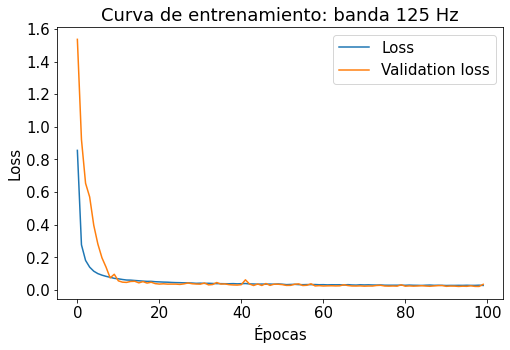

In [ ]:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title('Curva de entrenamiento: banda 125 Hz')
plt.legend()
plt.show()

In [ ]:
prediction_125 = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),1)[0][0] for i in range(len(y_test))]

error_125 = prediction_125 - y_test
stats.spearmanr(prediction_125, y_test)

SpearmanrResult(correlation=0.9838046119977996, pvalue=0.0)

(array([   3.,   11.,  132.,  739., 2541., 2121.,  240.,   13.]),
 array([-1.10000005, -0.88750004, -0.67500002, -0.46250001, -0.25      ,
        -0.03749999,  0.17500002,  0.38750004,  0.60000005]),
 <a list of 8 Patch objects>)

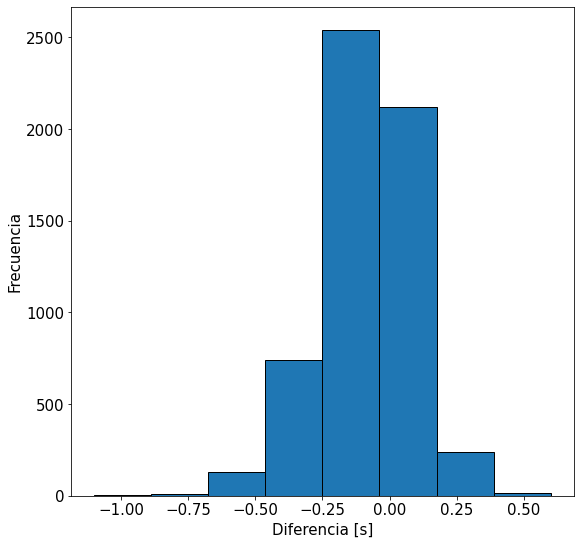

In [ ]:
# Histograma de las diferencias:
fig, ax = plt.subplots(figsize = (9, 9))

#ax.set_title('Histograma del RMSE')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(error_125, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

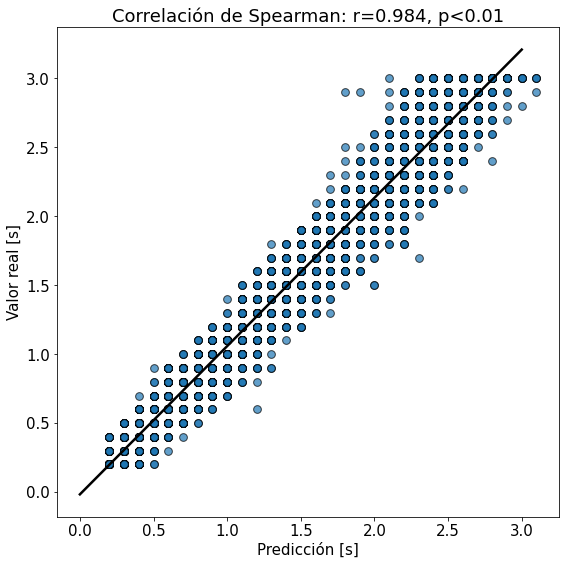

In [ ]:
# Generate data
x = prediction_125
y = y_test

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(0, 3, num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(prediction_125, y_test)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Para 250:

In [ ]:
#Cargo el modelo:
#Separo en train y test:
X = np.load('/content/drive/My Drive/Tesis/Base de datos/TAE 29000 sintéticas/TAE_250.npy')
y = np.load('/content/drive/My Drive/Tesis/Base de datos/TAE 29000 sintéticas/T30_250_values.npy')

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
blind_estimation_model = modelo()

In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train, y=y_train, validation_split=0.1, batch_size=256, epochs=100)

Epoch 1/100
82/82 [==============================] - 3s 11ms/step - loss: 1.2716 - val_loss: 2.7888
Epoch 2/100
82/82 [==============================] - 1s 9ms/step - loss: 0.2974 - val_loss: 1.8482
Epoch 3/100
82/82 [==============================] - 1s 9ms/step - loss: 0.1889 - val_loss: 1.2100
Epoch 4/100
82/82 [==============================] - 1s 8ms/step - loss: 0.1463 - val_loss: 0.8774
Epoch 5/100
82/82 [==============================] - 1s 8ms/step - loss: 0.1178 - val_loss: 0.6674
Epoch 6/100
82/82 [==============================] - 1s 8ms/step - loss: 0.1033 - val_loss: 0.5925
Epoch 7/100
82/82 [==============================] - 1s 8ms/step - loss: 0.0938 - val_loss: 0.3966
Epoch 8/100
82/82 [==============================] - 1s 8ms/step - loss: 0.0867 - val_loss: 0.2681
Epoch 9/100
82/82 [==============================] - 1s 8ms/step - loss: 0.0795 - val_loss: 0.2081
Epoch 10/100
82/82 [==============================] - 1s 8ms/step - loss: 0.0746 - val_loss: 0.1608
Epoch 11

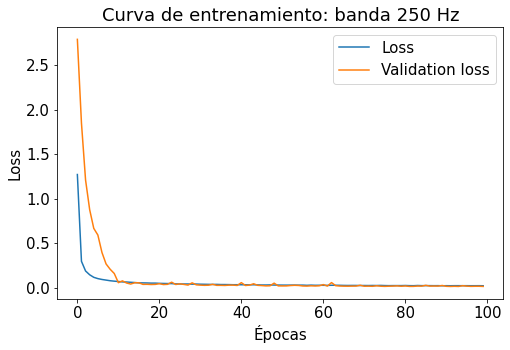

In [ ]:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title('Curva de entrenamiento: banda 250 Hz')
plt.legend()
plt.show()

In [ ]:
prediction_250 = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),1)[0][0] for i in range(len(y_test))]
error_250 = prediction_250 - y_test
stats.spearmanr(prediction_250, y_test)

SpearmanrResult(correlation=0.987984682564392, pvalue=0.0)

(array([2.000e+00, 1.900e+01, 3.900e+01, 5.100e+02, 3.369e+03, 1.284e+03,
        5.440e+02, 3.300e+01]),
 array([-0.8000001 , -0.63750008, -0.47500006, -0.31250004, -0.15000002,
         0.01249999,  0.17500001,  0.33750003,  0.50000005]),
 <a list of 8 Patch objects>)

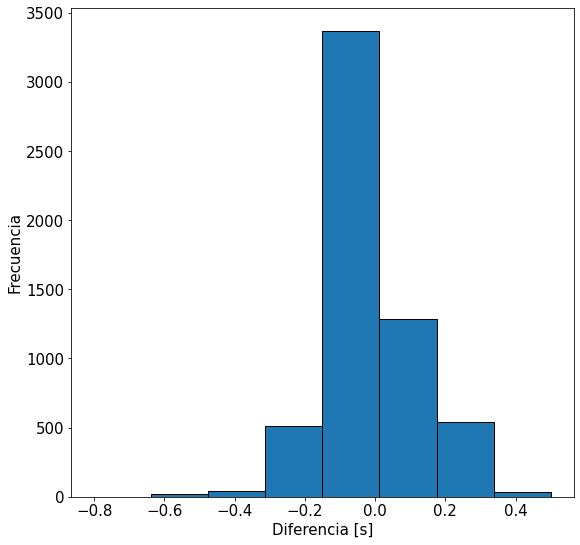

In [ ]:
# Histograma de las diferencias:
fig, ax = plt.subplots(figsize = (9, 9))

#ax.set_title('Histograma del RMSE')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(error_250, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

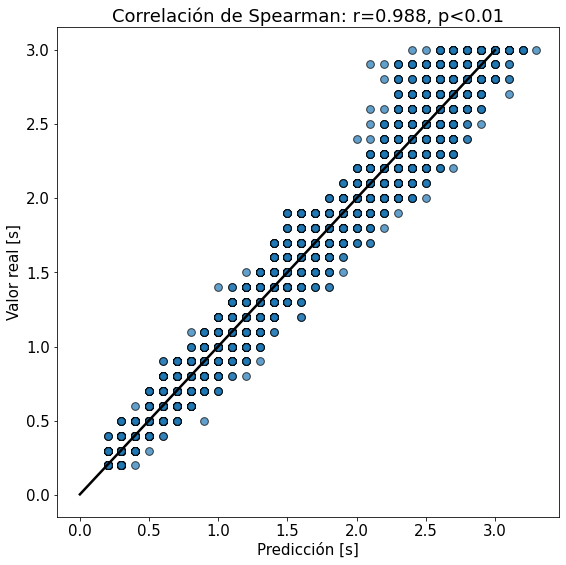

In [ ]:
# Generate data
x = prediction_250
y = y_test

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(0, 3, num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(prediction_250, y_test)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Para 500:

In [ ]:
#Cargo el modelo:
#Separo en train y test:
X = np.load('/content/drive/My Drive/Tesis/Base de datos/TAE 29000 sintéticas/TAE_500.npy')
y = np.load('/content/drive/My Drive/Tesis/Base de datos/TAE 29000 sintéticas/T30_500_values.npy')

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
blind_estimation_model = modelo()

In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train, y=y_train, validation_split=0.1, batch_size=256, epochs=100)

Epoch 1/100
82/82 [==============================] - 2s 11ms/step - loss: 0.5749 - val_loss: 0.9854
Epoch 2/100
82/82 [==============================] - 1s 8ms/step - loss: 0.1610 - val_loss: 0.5920
Epoch 3/100
82/82 [==============================] - 1s 8ms/step - loss: 0.1116 - val_loss: 0.4468
Epoch 4/100
82/82 [==============================] - 1s 8ms/step - loss: 0.0890 - val_loss: 0.3675
Epoch 5/100
82/82 [==============================] - 1s 8ms/step - loss: 0.0760 - val_loss: 0.3000
Epoch 6/100
82/82 [==============================] - 1s 9ms/step - loss: 0.0656 - val_loss: 0.2737
Epoch 7/100
82/82 [==============================] - 1s 8ms/step - loss: 0.0580 - val_loss: 0.1844
Epoch 8/100
82/82 [==============================] - 1s 9ms/step - loss: 0.0544 - val_loss: 0.0935
Epoch 9/100
82/82 [==============================] - 1s 8ms/step - loss: 0.0504 - val_loss: 0.0879
Epoch 10/100
82/82 [==============================] - 1s 8ms/step - loss: 0.0471 - val_loss: 0.0561
Epoch 11

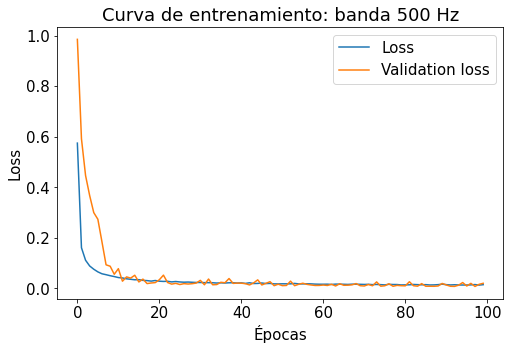

In [ ]:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title('Curva de entrenamiento: banda 500 Hz')
plt.legend()
plt.show()

In [ ]:
prediction_500 = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),1)[0][0] for i in range(len(y_test))]
error_500 = prediction_500 - y_test
stats.spearmanr(prediction_500, y_test)

SpearmanrResult(correlation=0.9923925587909944, pvalue=0.0)

(array([   3.,   16.,   85., 2055., 2057., 1132.,  417.,   35.]),
 array([-4.99999905e-01, -3.74999917e-01, -2.49999928e-01, -1.24999940e-01,
         4.76837159e-08,  1.25000036e-01,  2.50000024e-01,  3.75000012e-01,
         5.00000000e-01]),
 <a list of 8 Patch objects>)

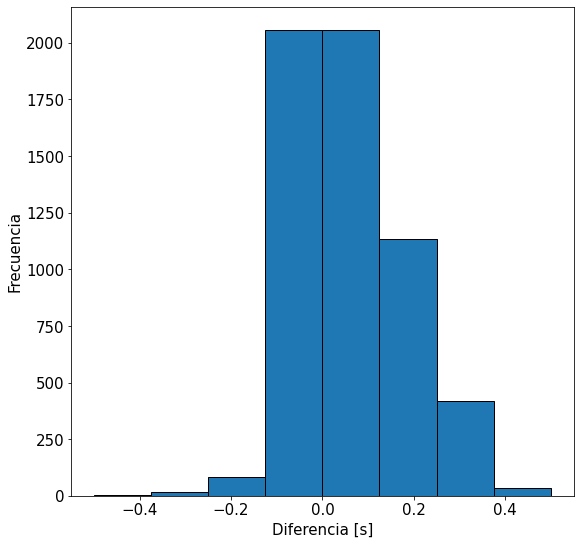

In [ ]:
# Histograma de las diferencias:
fig, ax = plt.subplots(figsize = (9, 9))

#ax.set_title('Histograma del RMSE')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(error_500, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

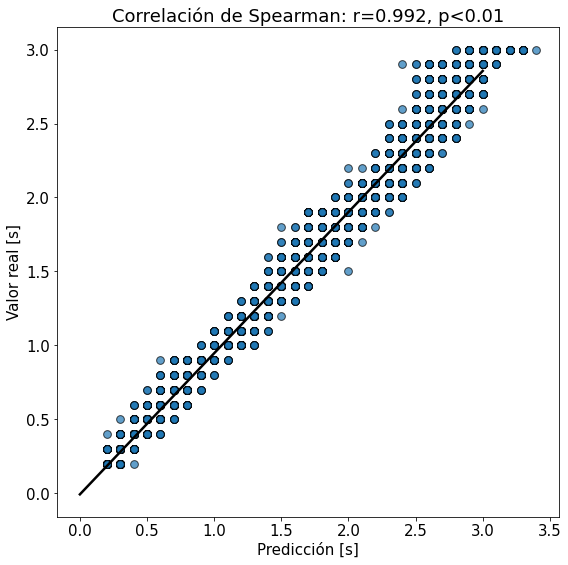

In [ ]:
# Generate data
x = prediction_500
y = y_test

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(0, 3, num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(prediction_500, y_test)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Para 2000

In [ ]:
#Cargo el modelo:
#Separo en train y test:
X = np.load('/content/drive/My Drive/Tesis/Base de datos/TAE 29000 sintéticas/TAE_2000.npy')
y = np.load('/content/drive/My Drive/Tesis/Base de datos/TAE 29000 sintéticas/T30_2000_values.npy')

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
blind_estimation_model = modelo()

In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train, y=y_train, validation_split=0.1, batch_size=256, epochs=100)

Epoch 1/100
82/82 [==============================] - 2s 12ms/step - loss: 1.1563 - val_loss: 0.8112
Epoch 2/100
82/82 [==============================] - 1s 8ms/step - loss: 0.2342 - val_loss: 0.5785
Epoch 3/100
82/82 [==============================] - 1s 8ms/step - loss: 0.1581 - val_loss: 0.4702
Epoch 4/100
82/82 [==============================] - 1s 9ms/step - loss: 0.1201 - val_loss: 0.3835
Epoch 5/100
82/82 [==============================] - 1s 8ms/step - loss: 0.0982 - val_loss: 0.2984
Epoch 6/100
82/82 [==============================] - 1s 9ms/step - loss: 0.0824 - val_loss: 0.2222
Epoch 7/100
82/82 [==============================] - 1s 8ms/step - loss: 0.0735 - val_loss: 0.1729
Epoch 8/100
82/82 [==============================] - 1s 8ms/step - loss: 0.0656 - val_loss: 0.1024
Epoch 9/100
82/82 [==============================] - 1s 9ms/step - loss: 0.0569 - val_loss: 0.0639
Epoch 10/100
82/82 [==============================] - 1s 8ms/step - loss: 0.0533 - val_loss: 0.0427
Epoch 11

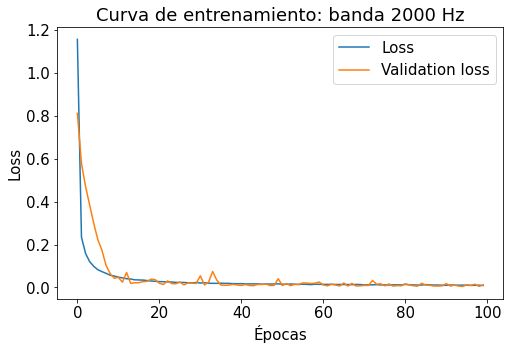

In [ ]:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title('Curva de entrenamiento: banda 2000 Hz')
plt.legend()
plt.show()

In [ ]:
prediction_2000 = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),1)[0][0] for i in range(len(y_test))]
error_2000 = prediction_2000 - y_test
stats.spearmanr(prediction_2000, y_test)

SpearmanrResult(correlation=0.9965763751963955, pvalue=0.0)

(array([1.000e+00, 1.800e+01, 1.930e+02, 7.540e+02, 1.627e+03, 2.524e+03,
        6.670e+02, 1.600e+01]),
 array([-0.5       , -0.41249999, -0.32499999, -0.23749998, -0.14999998,
        -0.06249997,  0.02500004,  0.11250004,  0.20000005]),
 <a list of 8 Patch objects>)

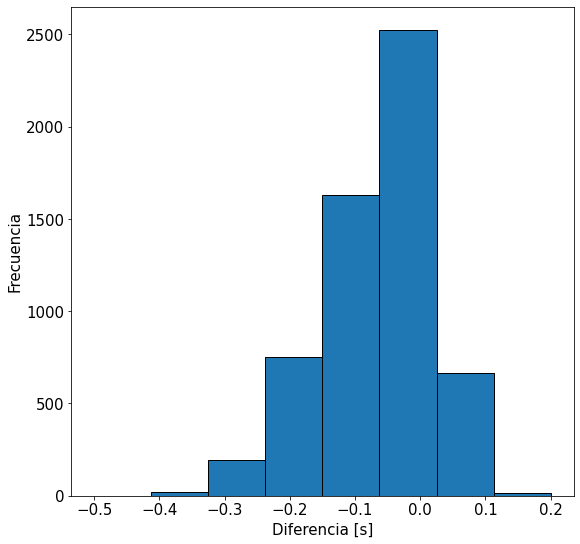

In [ ]:
# Histograma de las diferencias:
fig, ax = plt.subplots(figsize = (9, 9))

#ax.set_title('Histograma del RMSE')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(error_2000, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

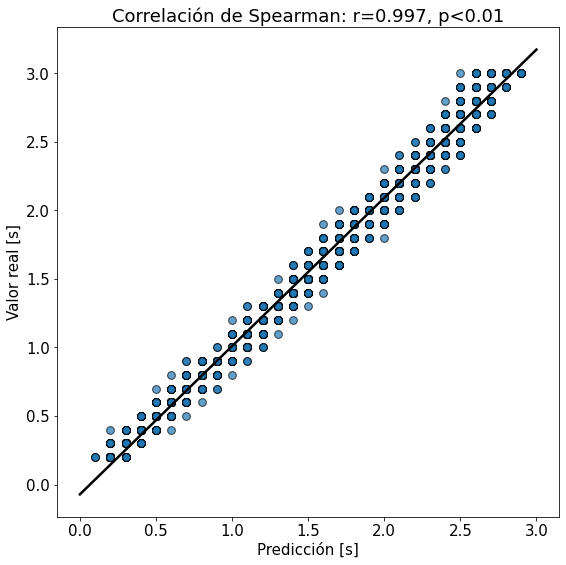

In [ ]:
# Generate data
x = prediction_2000
y = y_test

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(0, 3, num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(prediction_2000, y_test)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Para 4000:

In [ ]:
#Cargo el modelo:
#Separo en train y test:
X = np.load('/content/drive/My Drive/Tesis/Base de datos/TAE 29000 sintéticas/TAE_4000.npy')
y = np.load('/content/drive/My Drive/Tesis/Base de datos/TAE 29000 sintéticas/T30_4000_values.npy')

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
blind_estimation_model = modelo()

In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train, y=y_train, validation_split=0.1, batch_size=256, epochs=100)

Epoch 1/100
82/82 [==============================] - 2s 11ms/step - loss: 1.3693 - val_loss: 1.8710
Epoch 2/100
82/82 [==============================] - 1s 9ms/step - loss: 0.2785 - val_loss: 1.1836
Epoch 3/100
82/82 [==============================] - 1s 9ms/step - loss: 0.1752 - val_loss: 0.7397
Epoch 4/100
82/82 [==============================] - 1s 8ms/step - loss: 0.1272 - val_loss: 0.6399
Epoch 5/100
82/82 [==============================] - 1s 8ms/step - loss: 0.1011 - val_loss: 0.6960
Epoch 6/100
82/82 [==============================] - 1s 8ms/step - loss: 0.0815 - val_loss: 0.6632
Epoch 7/100
82/82 [==============================] - 1s 8ms/step - loss: 0.0694 - val_loss: 0.4334
Epoch 8/100
82/82 [==============================] - 1s 8ms/step - loss: 0.0584 - val_loss: 0.2348
Epoch 9/100
82/82 [==============================] - 1s 8ms/step - loss: 0.0541 - val_loss: 0.0866
Epoch 10/100
82/82 [==============================] - 1s 8ms/step - loss: 0.0485 - val_loss: 0.0825
Epoch 11

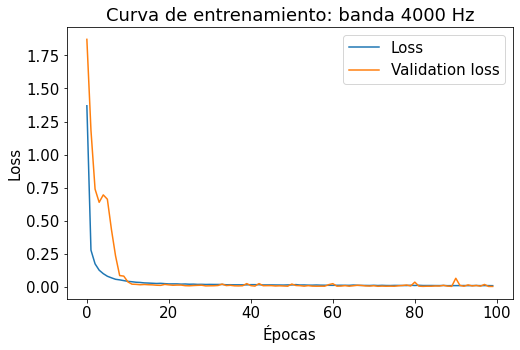

In [ ]:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title('Curva de entrenamiento: banda 4000 Hz')
plt.legend()
plt.show()

In [ ]:
prediction_4000 = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),1)[0][0] for i in range(len(y_test))]
error_4000 = prediction_4000 - y_test
stats.spearmanr(prediction_4000, y_test)

SpearmanrResult(correlation=0.9967273661806254, pvalue=0.0)

(array([  11.,  104., 1353.,  724., 2757.,  786.,   61.,    4.]),
 array([-3.00000095e-01, -2.25000077e-01, -1.50000060e-01, -7.50000417e-02,
        -2.38418578e-08,  7.49999940e-02,  1.50000012e-01,  2.25000030e-01,
         3.00000048e-01]),
 <a list of 8 Patch objects>)

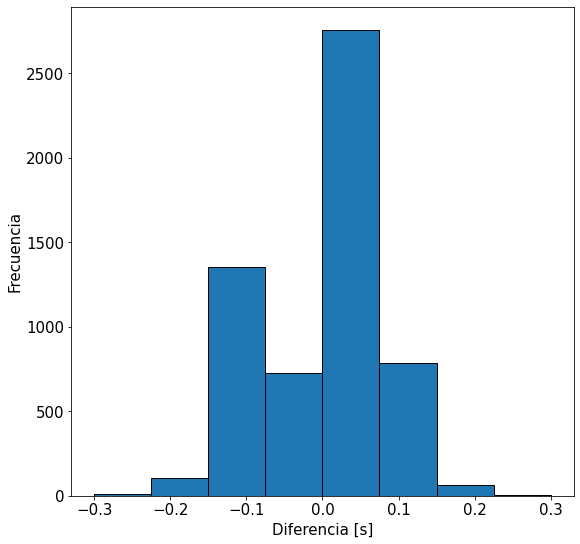

In [ ]:
# Histograma de las diferencias:
fig, ax = plt.subplots(figsize = (9, 9))

#ax.set_title('Histograma del RMSE')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(error_4000, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

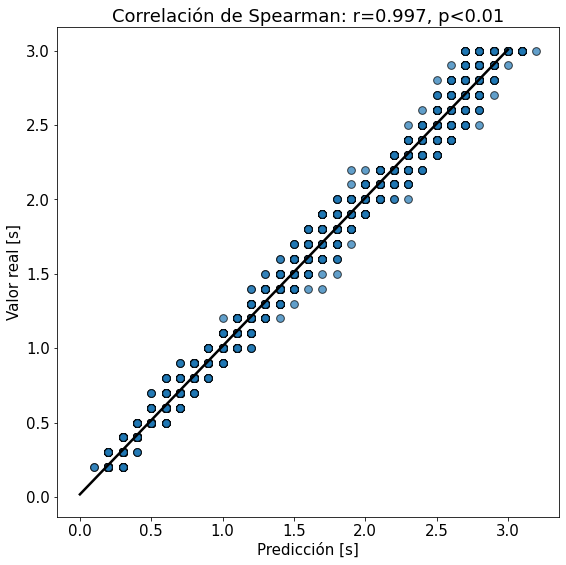

In [ ]:
# Generate data
x = prediction_4000
y = y_test

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(0, 3, num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(prediction_4000, y_test)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Para 8000:

In [ ]:
#Cargo el modelo:
#Separo en train y test:
X = np.load('/content/drive/My Drive/Tesis/Base de datos/TAE 29000 sintéticas/TAE_8000.npy')
y = np.load('/content/drive/My Drive/Tesis/Base de datos/TAE 29000 sintéticas/T30_8000_values.npy')

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
blind_estimation_model = modelo()

In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train, y=y_train, validation_split=0.1, batch_size=256, epochs=100)

Epoch 1/100
82/82 [==============================] - 3s 11ms/step - loss: 1.1761 - val_loss: 1.4494
Epoch 2/100
82/82 [==============================] - 1s 8ms/step - loss: 0.2133 - val_loss: 0.6767
Epoch 3/100
82/82 [==============================] - 1s 8ms/step - loss: 0.1363 - val_loss: 0.5539
Epoch 4/100
82/82 [==============================] - 1s 8ms/step - loss: 0.1000 - val_loss: 0.5920
Epoch 5/100
82/82 [==============================] - 1s 8ms/step - loss: 0.0833 - val_loss: 0.5398
Epoch 6/100
82/82 [==============================] - 1s 8ms/step - loss: 0.0706 - val_loss: 0.3210
Epoch 7/100
82/82 [==============================] - 1s 8ms/step - loss: 0.0595 - val_loss: 0.1758
Epoch 8/100
82/82 [==============================] - 1s 8ms/step - loss: 0.0518 - val_loss: 0.0707
Epoch 9/100
82/82 [==============================] - 1s 8ms/step - loss: 0.0459 - val_loss: 0.0390
Epoch 10/100
82/82 [==============================] - 1s 8ms/step - loss: 0.0426 - val_loss: 0.0268
Epoch 11

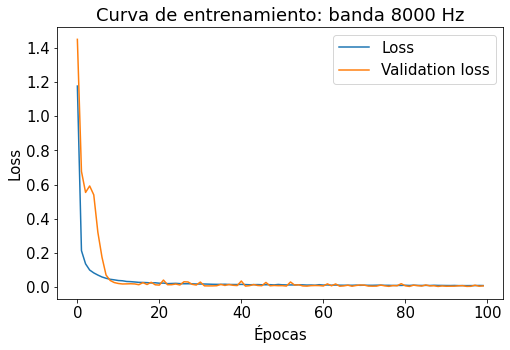

In [ ]:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title('Curva de entrenamiento: banda 8000 Hz')
plt.legend()
plt.show()

In [ ]:
prediction_8000 = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),1)[0][0] for i in range(len(y_test))]
error_8000 = prediction_8000 - y_test
stats.spearmanr(prediction_8000, y_test)

SpearmanrResult(correlation=0.9967370054748339, pvalue=0.0)

(array([5.000e+00, 3.020e+02, 2.909e+03, 2.470e+02, 1.890e+03, 4.140e+02,
        3.200e+01, 1.000e+00]),
 array([-0.2000001 , -0.12500009, -0.05000008,  0.02499992,  0.09999993,
         0.17499993,  0.24999994,  0.32499995,  0.39999995]),
 <a list of 8 Patch objects>)

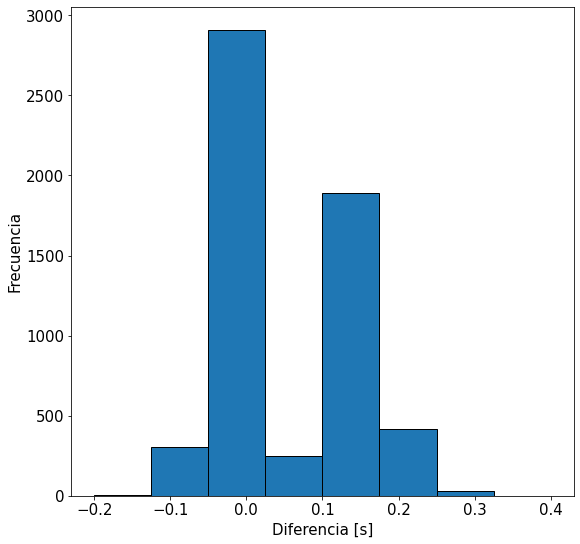

In [ ]:
# Histograma de las diferencias:
fig, ax = plt.subplots(figsize = (9, 9))

#ax.set_title('Histograma del RMSE')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(error_8000, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

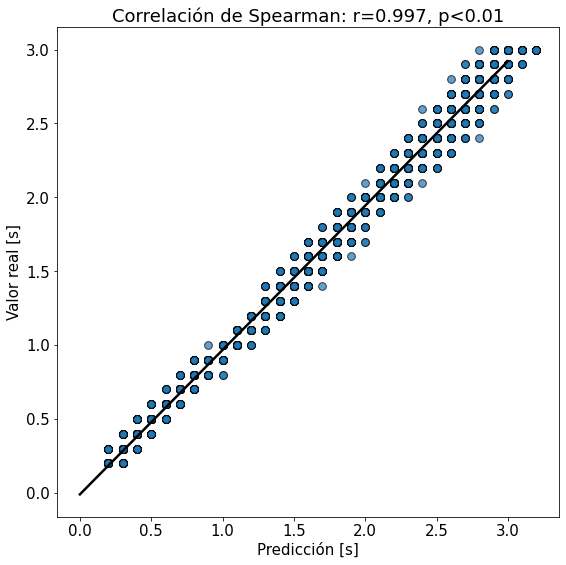

In [ ]:
# Generate data
x = prediction_8000
y = y_test

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(0, 3, num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(prediction_8000, y_test)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

# Entrenamiento RIRs reales y valores normalizados

En este caso, además de normalizar todo con el percentil 95, paso todos los valores a su escala sin dB ni %

In [41]:
#Librerías necesarias:
import sys 
sys.path.append('/content/drive/My Drive/Tesis/Notebooks/scripts')
from model_2 import modelo
from scipy import stats

import numpy as np
import os
from librosa import load
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

!pip install pickle5
import pickle5 as pickle
import matplotlib.pyplot as plt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


Outliers:

In [42]:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE sinteticos y reales')
with open('outliers.pickle', 'rb') as handle:
  outliers = list(set(pickle.load(handle)))

125 Hz:

In [43]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE sinteticos y reales')

band = 125

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

In [44]:
print(list(tae_dic.keys())[10000])
print(list(params_dic.keys())[10000])

F1s3-Xx01y01_1.2s
F1s3-sintetica_Seed2295707925_Tr0.2


In [45]:
print(len(list(tae_dic.keys())))
print(len(list(params_dic.keys())))

216940
216940


In [46]:
print(list(tae_dic.keys())[0:5])
print(list(params_dic.keys())[0:5])

['F1s3-sintetica_Seed1000489356_Tr0.8', 'F1s3-sintetica_Seed1001447394_Tr1.0', 'F1s3-sintetica_Seed1001731511_Tr0.3', 'F1s3-sintetica_Seed1002861871_Tr1.2', 'F1s3-sintetica_Seed100337391_Tr0.8']
['F1s3-sintetica_Seed1000489356_Tr0.8', 'F2s3-sintetica_Seed1000489356_Tr0.8', 'F3s3-sintetica_Seed1000489356_Tr0.8', 'F4s3-sintetica_Seed1000489356_Tr0.8', 'F5s3-sintetica_Seed1000489356_Tr0.8']


In [ ]:
print(params_dic['F1s3-sintetica_Seed1807110498_Tr3.0'])

[3.3177340165539593, -7.817570784307723, -3.0913787381216657, 14.184349409610135]


In [47]:
#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

In [48]:
#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
print(len(y))

193590


In [49]:
#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-25.301271999812975
10.009431125496194


In [ ]:
print(T30_perc_95) 
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

2.9811717931741186
2.467825240639838
4.668209976368018
63.835644328398686


In [50]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [51]:
print(X_train.shape)
print(y_train.shape)

(154872, 200, 1)
(154872, 4, 1)


In [52]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.1547120779236117


In [53]:
assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo y_train: 10.009431125496194
Mínimo y_train: -25.301271999812975


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
137/137 [==============================] - 20s 21ms/step - loss: 9.5163 - val_loss: 10.9833
Epoch 2/500
137/137 [==============================] - 2s 14ms/step - loss: 7.2995 - val_loss: 9.4253
Epoch 3/500
137/137 [==============================] - 2s 14ms/step - loss: 6.4199 - val_loss: 8.0881
Epoch 4/500
137/137 [==============================] - 2s 14ms/step - loss: 5.7009 - val_loss: 6.1481
Epoch 5/500
137/137 [==============================] - 2s 16ms/step - loss: 5.2051 - val_loss: 4.9206
Epoch 6/500
137/137 [==============================] - 2s 14ms/step - loss: 4.9312 - val_loss: 4.3371
Epoch 7/500
137/137 [==============================] - 2s 14ms/step - loss: 4.7202 - val_loss: 4.3149
Epoch 8/500
137/137 [==============================] - 2s 15ms/step - loss: 4.5997 - val_loss: 4.0566
Epoch 9/500
137/137 [==============================] - 2s 15ms/step - loss: 4.4804 - val_loss: 3.8794
Epoch 10/500
137/137 [==============================] - 2s 15ms/step - loss: 4.3

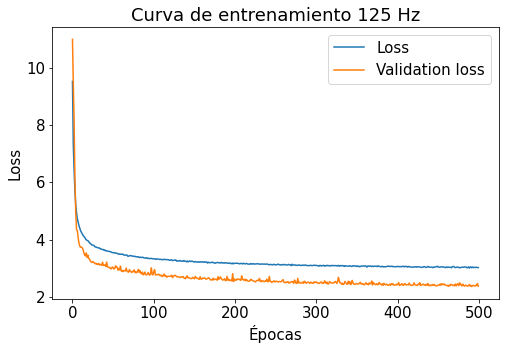

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
blind_estimation_model.predict(X_test[5,:,0].reshape(1,-1,1))[0]

array([  0.85789764, -14.198635  ,  -2.6794648 ,  -0.24099234],
      dtype=float32)

In [ ]:
np.round(y_test[0,:,0].reshape(1,-1,1),1)

array([[[ 0.8],
        [-3.3],
        [-0.9],
        [ 0.2]]])

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
prediction[0]

array([ 0.72, -4.6 , -1.09,  0.25], dtype=float32)

In [ ]:
np.round(prediction[1] - np.round(y_test[1,:,0].reshape(1,-1,1),2).flatten(),2)

array([ 0.  , -3.95, -0.98, -0.22])

In [ ]:
np.round(prediction[1][0] - np.round(y_test[1,:,0].reshape(1,-1,1),2).flatten()[0],2)

0.0

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([   55.,  3336., 16420., 10512.,  5923.,  1029.,   796.,   647.]),
 array([-0.64   , -0.43875, -0.2375 , -0.03625,  0.165  ,  0.36625,
         0.5675 ,  0.76875,  0.97   ]),
 <a list of 8 Patch objects>)

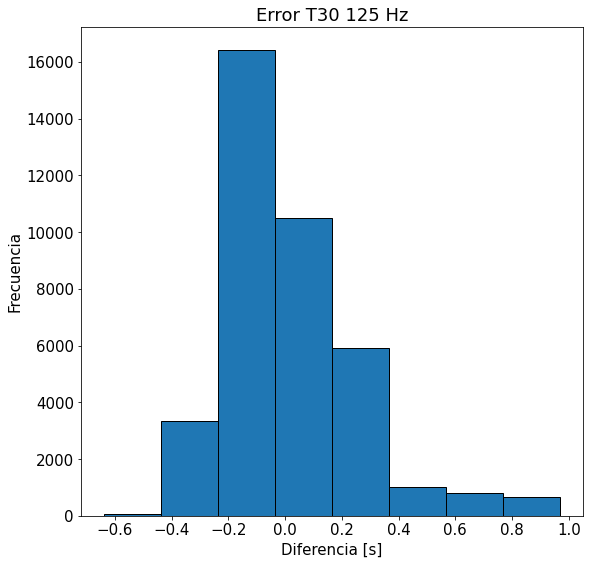

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([1.4000e+01, 8.6000e+01, 1.0100e+03, 1.7104e+04, 1.8299e+04,
        1.8440e+03, 3.1200e+02, 4.9000e+01]),
 array([-20.01   , -15.10125, -10.1925 ,  -5.28375,  -0.375  ,   4.53375,
          9.4425 ,  14.35125,  19.26   ]),
 <a list of 8 Patch objects>)

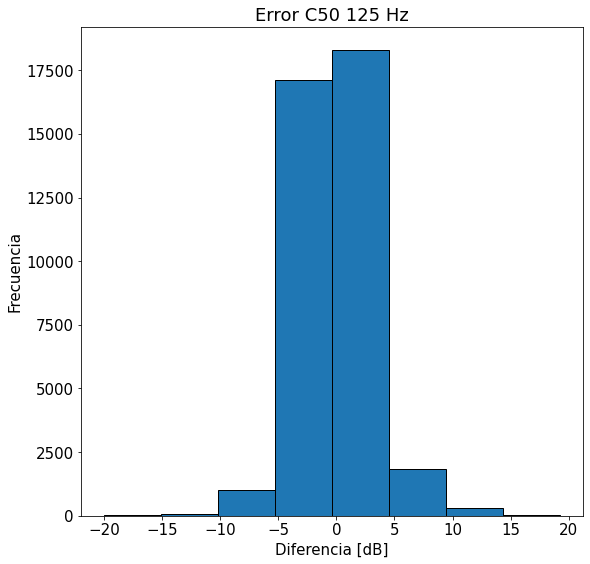

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([7.0000e+00, 1.6600e+02, 1.9398e+04, 1.8518e+04, 5.5800e+02,
        2.4000e+01, 7.0000e+00, 4.0000e+01]),
 array([-6.28   , -4.20375, -2.1275 , -0.05125,  2.025  ,  4.10125,
         6.1775 ,  8.25375, 10.33   ]),
 <a list of 8 Patch objects>)

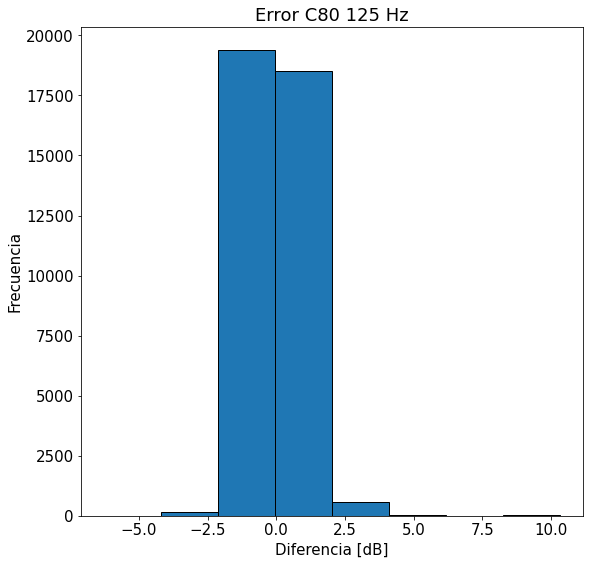

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([1.2000e+01, 3.1700e+02, 3.1050e+03, 1.4539e+04, 1.8481e+04,
        2.1940e+03, 6.8000e+01, 2.0000e+00]),
 array([-1.12, -0.84, -0.56, -0.28,  0.  ,  0.28,  0.56,  0.84,  1.12]),
 <a list of 8 Patch objects>)

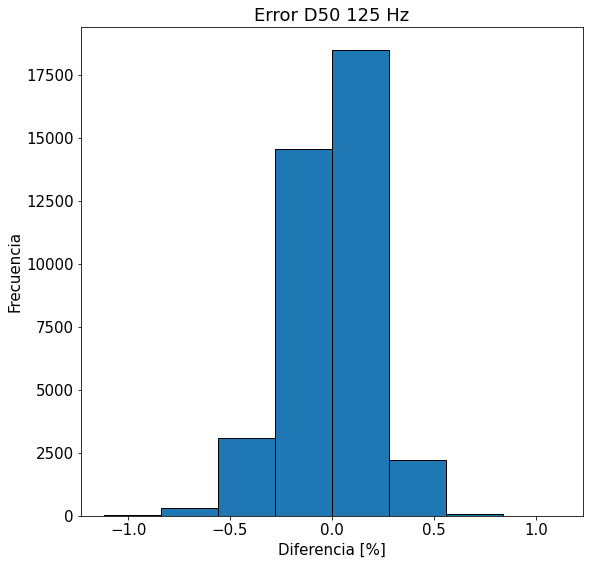

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

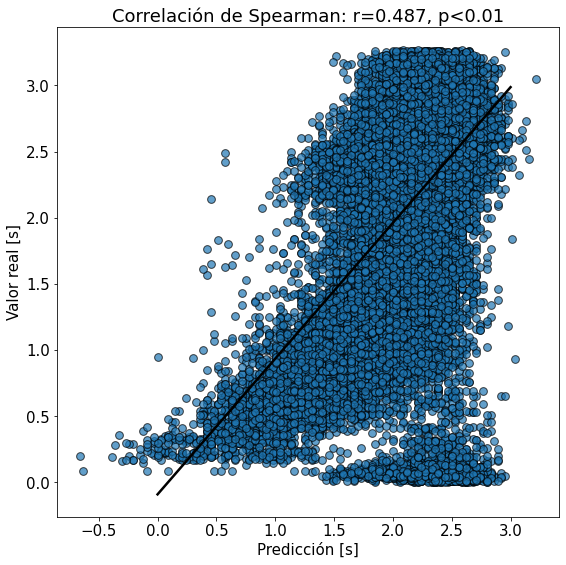

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

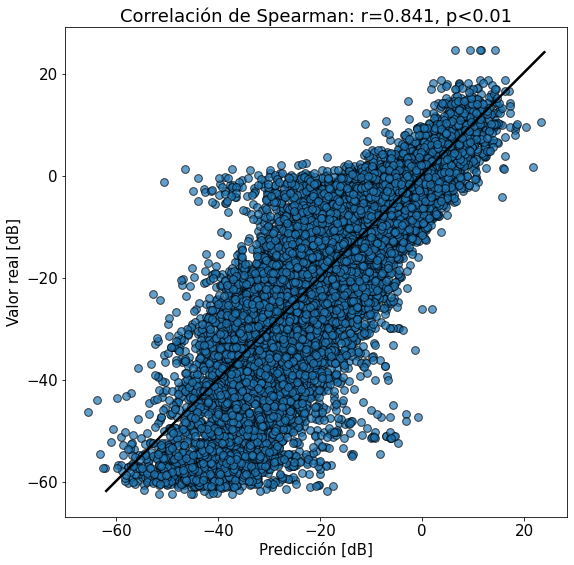

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

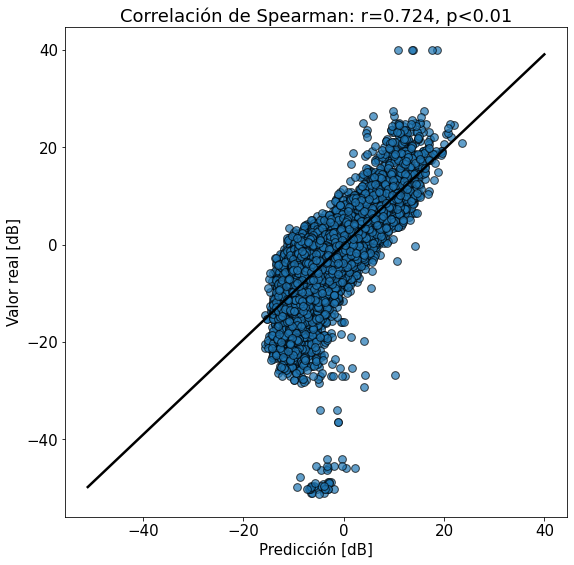

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

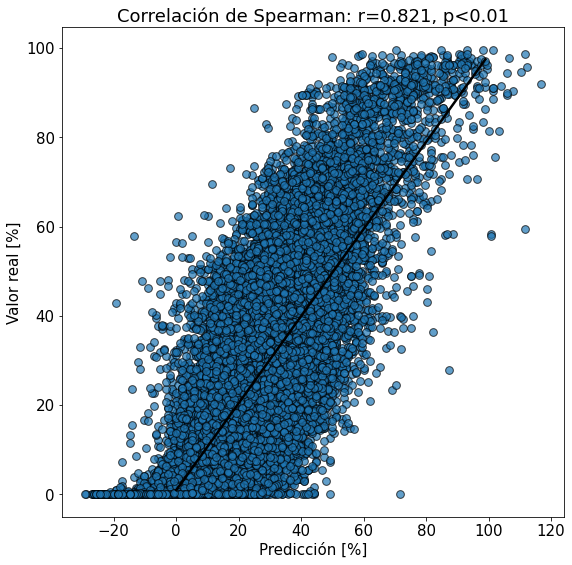

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

250 Hz:

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE sinteticos y reales')

band = 250

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-10.02535295428216
6.83891829138151


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

2.6735695322095
6.574199043544663
7.6277200220600685
81.96185445466573


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.17966023122846125
Máximo y_train: 6.83891829138151
Mínimo y_train: -10.02535295428216


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
137/137 [==============================] - 3s 15ms/step - loss: 1.2057 - val_loss: 1.1299
Epoch 2/500
137/137 [==============================] - 2s 12ms/step - loss: 0.8390 - val_loss: 1.1724
Epoch 3/500
137/137 [==============================] - 2s 13ms/step - loss: 0.6966 - val_loss: 1.1569
Epoch 4/500
137/137 [==============================] - 2s 13ms/step - loss: 0.6201 - val_loss: 0.9045
Epoch 5/500
137/137 [==============================] - 2s 12ms/step - loss: 0.5715 - val_loss: 0.6405
Epoch 6/500
137/137 [==============================] - 2s 12ms/step - loss: 0.5460 - val_loss: 0.5037
Epoch 7/500
137/137 [==============================] - 2s 13ms/step - loss: 0.5246 - val_loss: 0.4493
Epoch 8/500
137/137 [==============================] - 2s 12ms/step - loss: 0.5110 - val_loss: 0.4390
Epoch 9/500
137/137 [==============================] - 2s 13ms/step - loss: 0.5001 - val_loss: 0.4443
Epoch 10/500
137/137 [==============================] - 2s 12ms/step - loss: 0.488

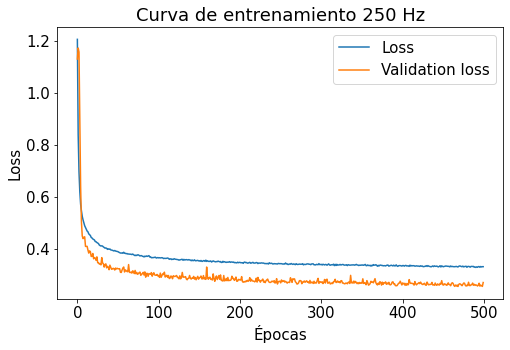

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([4.0000e+00, 4.0000e+00, 1.5000e+01, 2.0600e+03, 2.4936e+04,
        1.0639e+04, 1.0310e+03, 2.9000e+01]),
 array([-1.23 , -0.965, -0.7  , -0.435, -0.17 ,  0.095,  0.36 ,  0.625,
         0.89 ]),
 <a list of 8 Patch objects>)

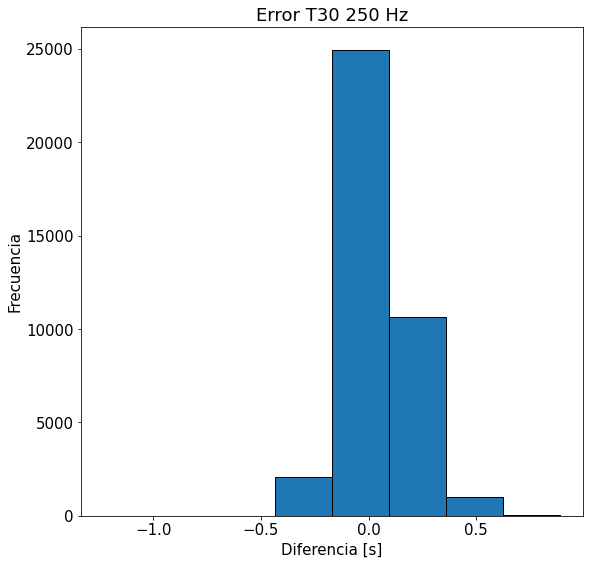

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([6.0000e+00, 6.4000e+01, 7.7200e+02, 1.3639e+04, 2.3015e+04,
        9.7900e+02, 2.0900e+02, 3.4000e+01]),
 array([-7.9    , -6.00375, -4.1075 , -2.21125, -0.315  ,  1.58125,
         3.4775 ,  5.37375,  7.27   ]),
 <a list of 8 Patch objects>)

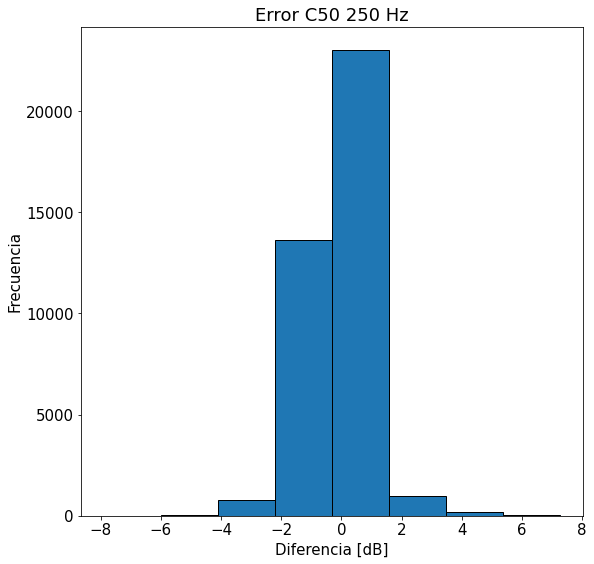

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([1.000e+00, 1.900e+01, 2.790e+03, 3.422e+04, 1.614e+03, 3.500e+01,
        1.800e+01, 2.100e+01]),
 array([-4.18  , -2.9925, -1.805 , -0.6175,  0.57  ,  1.7575,  2.945 ,
         4.1325,  5.32  ]),
 <a list of 8 Patch objects>)

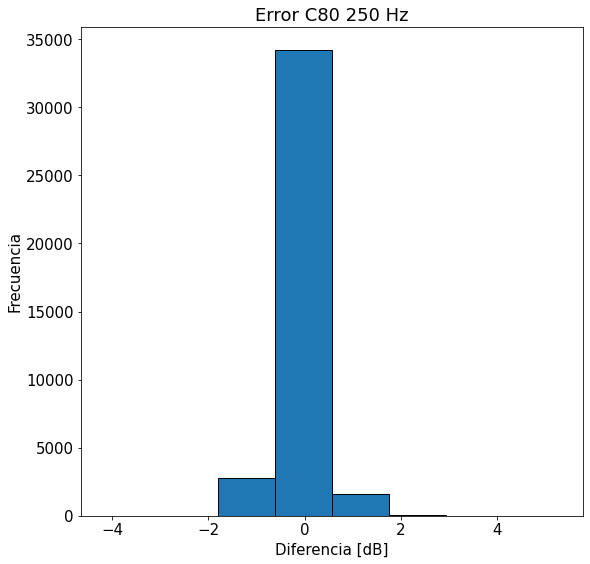

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([4.9000e+01, 2.3550e+03, 2.8862e+04, 7.3640e+03, 8.4000e+01,
        2.0000e+00, 0.0000e+00, 2.0000e+00]),
 array([-0.88   , -0.56125, -0.2425 ,  0.07625,  0.395  ,  0.71375,
         1.0325 ,  1.35125,  1.67   ]),
 <a list of 8 Patch objects>)

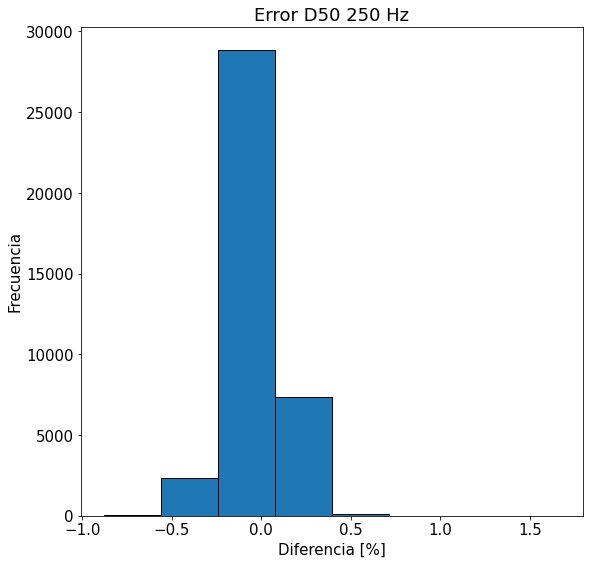

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

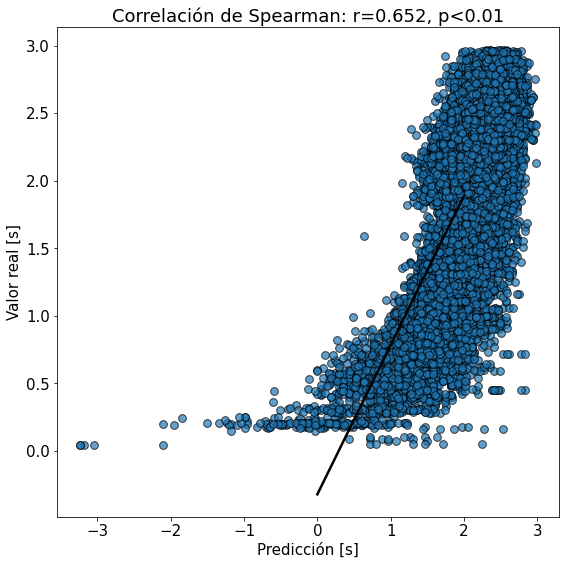

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

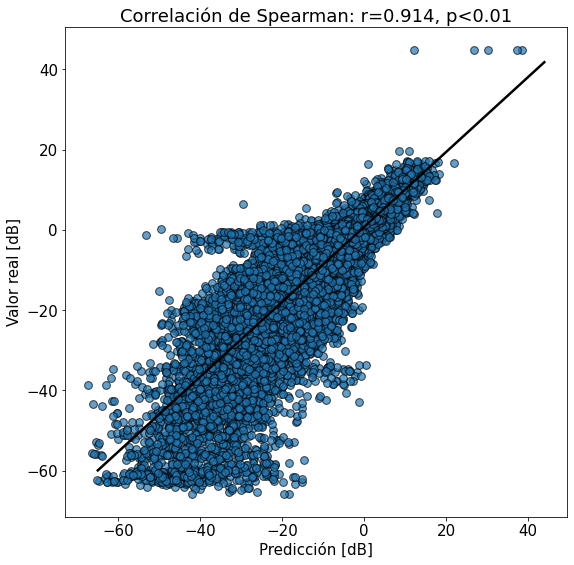

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

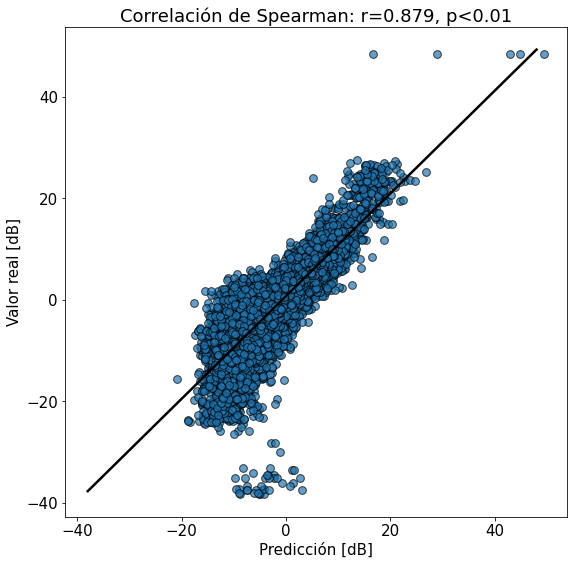

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

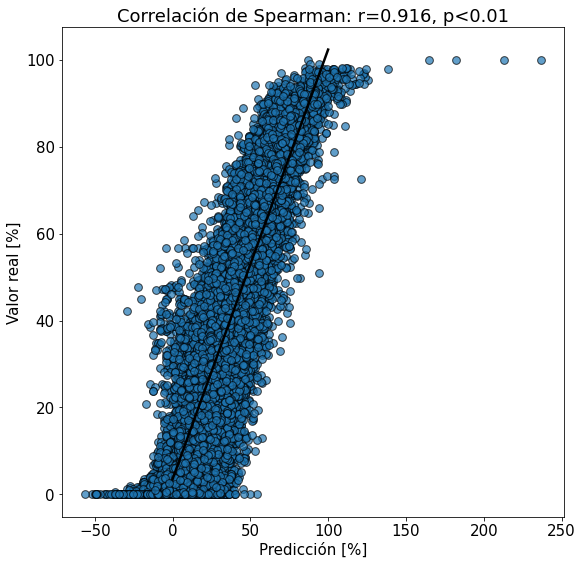

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

500 Hz

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE sinteticos y reales')

band = 500

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-8.458323375763829
5.9122660927179975


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

2.660692954570472
8.474602381530437
9.535817713654371
87.55936578477285


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.1229974167808528
Máximo y_train: 5.9122660927179975
Mínimo y_train: -8.458323375763829


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
137/137 [==============================] - 3s 15ms/step - loss: 0.6460 - val_loss: 0.9239
Epoch 2/500
137/137 [==============================] - 2s 12ms/step - loss: 0.4196 - val_loss: 0.9466
Epoch 3/500
137/137 [==============================] - 2s 13ms/step - loss: 0.3573 - val_loss: 0.8498
Epoch 4/500
137/137 [==============================] - 2s 13ms/step - loss: 0.3188 - val_loss: 0.4973
Epoch 5/500
137/137 [==============================] - 2s 13ms/step - loss: 0.2948 - val_loss: 0.3101
Epoch 6/500
137/137 [==============================] - 2s 13ms/step - loss: 0.2803 - val_loss: 0.2463
Epoch 7/500
137/137 [==============================] - 2s 13ms/step - loss: 0.2682 - val_loss: 0.2452
Epoch 8/500
137/137 [==============================] - 2s 13ms/step - loss: 0.2585 - val_loss: 0.2351
Epoch 9/500
137/137 [==============================] - 2s 15ms/step - loss: 0.2518 - val_loss: 0.2205
Epoch 10/500
137/137 [==============================] - 2s 15ms/step - loss: 0.245

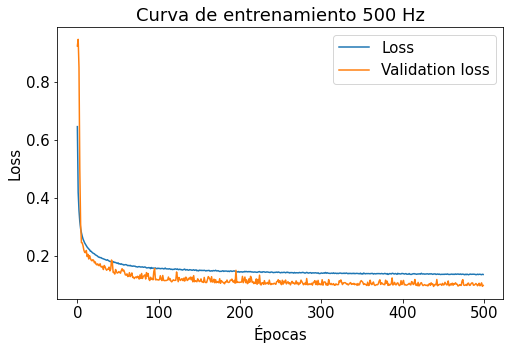

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([3.0000e+00, 1.8000e+01, 3.2500e+02, 1.8114e+04, 1.8797e+04,
        1.3760e+03, 7.7000e+01, 8.0000e+00]),
 array([-0.85   , -0.63875, -0.4275 , -0.21625, -0.005  ,  0.20625,
         0.4175 ,  0.62875,  0.84   ]),
 <a list of 8 Patch objects>)

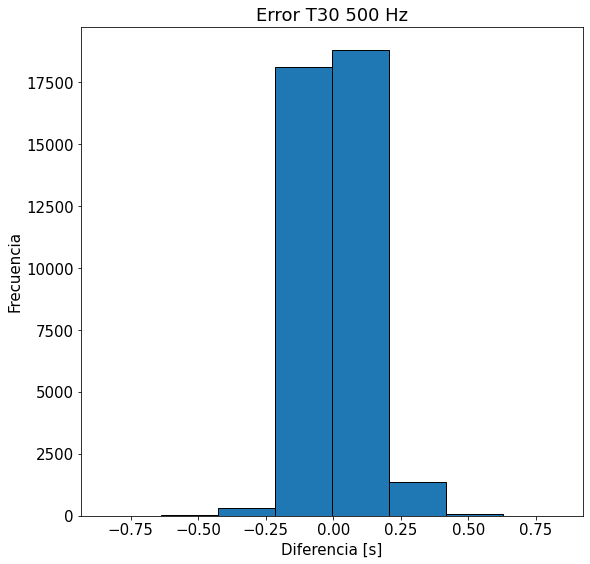

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([2.8000e+01, 1.7300e+02, 1.3130e+03, 3.5226e+04, 1.6140e+03,
        3.1300e+02, 4.7000e+01, 4.0000e+00]),
 array([-4.92   , -3.52625, -2.1325 , -0.73875,  0.655  ,  2.04875,
         3.4425 ,  4.83625,  6.23   ]),
 <a list of 8 Patch objects>)

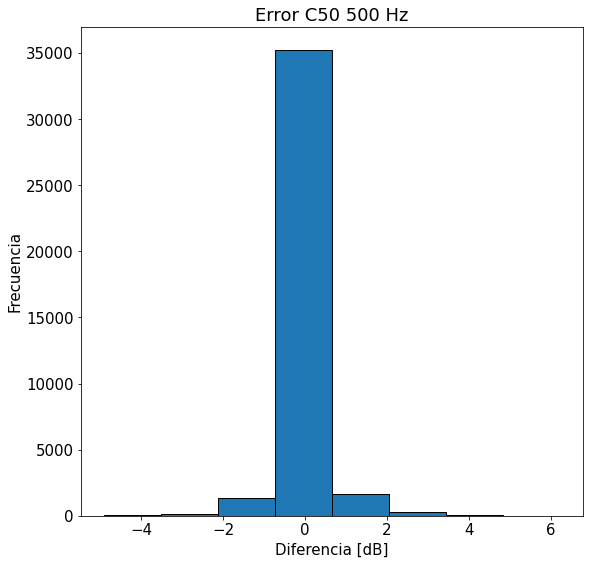

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([4.0000e+00, 4.0000e+00, 1.8250e+03, 3.5492e+04, 1.2800e+03,
        7.0000e+01, 3.3000e+01, 1.0000e+01]),
 array([-3.03   , -2.14125, -1.2525 , -0.36375,  0.525  ,  1.41375,
         2.3025 ,  3.19125,  4.08   ]),
 <a list of 8 Patch objects>)

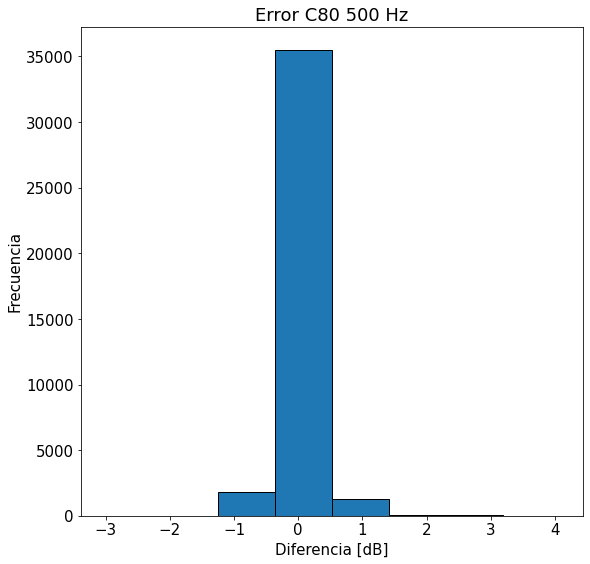

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([3.2000e+01, 7.3200e+02, 1.9798e+04, 1.6711e+04, 1.2850e+03,
        1.5100e+02, 8.0000e+00, 1.0000e+00]),
 array([-0.66  , -0.4325, -0.205 ,  0.0225,  0.25  ,  0.4775,  0.705 ,
         0.9325,  1.16  ]),
 <a list of 8 Patch objects>)

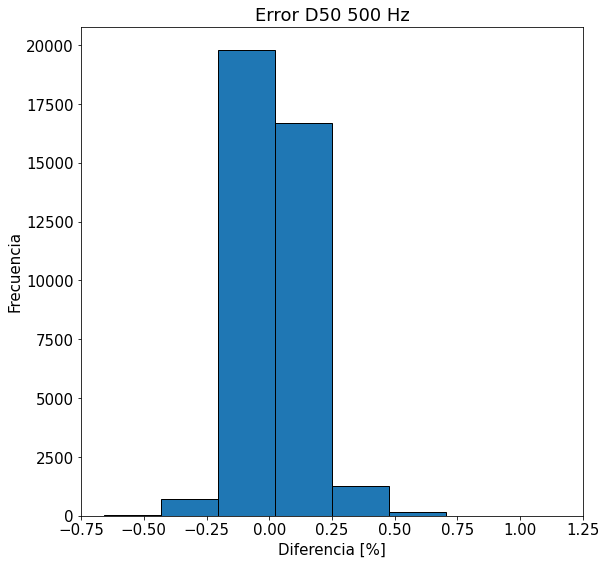

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

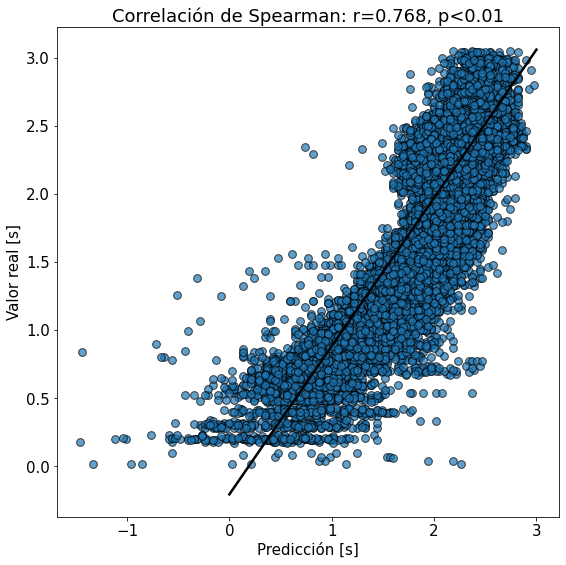

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

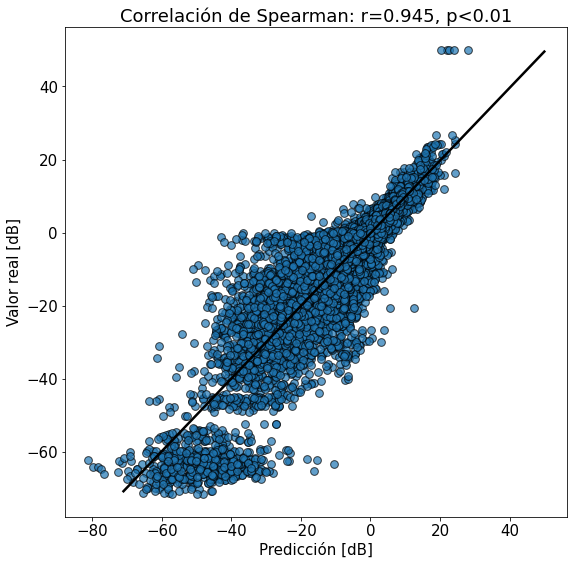

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

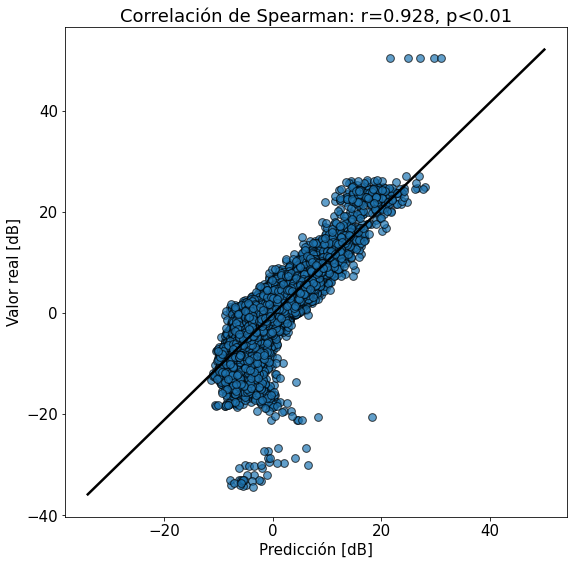

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

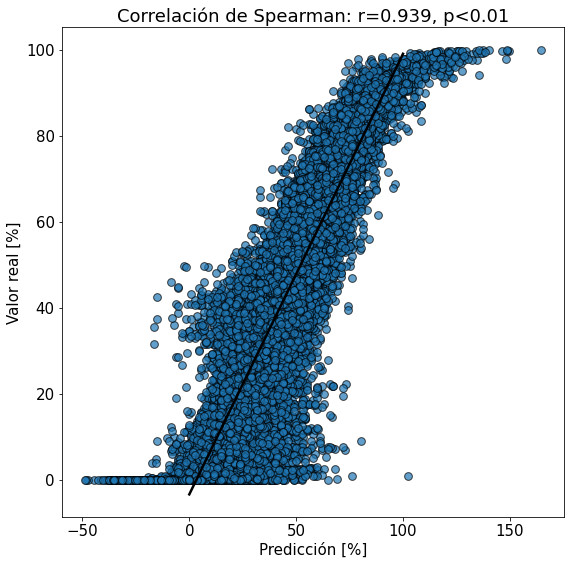

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

1000 Hz

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE sinteticos y reales')

band = 1000

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-8.426073077618815
4.589510379126383


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

2.713116356754423
8.783333746578812
9.851875229547831
88.31327995933745


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.1743810165607586
Máximo y_train: 4.589510379126383
Mínimo y_train: -8.426073077618815


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
137/137 [==============================] - 3s 14ms/step - loss: 0.6150 - val_loss: 0.5818
Epoch 2/500
137/137 [==============================] - 2s 13ms/step - loss: 0.3813 - val_loss: 0.7460
Epoch 3/500
137/137 [==============================] - 2s 12ms/step - loss: 0.3272 - val_loss: 0.5984
Epoch 4/500
137/137 [==============================] - 2s 12ms/step - loss: 0.2925 - val_loss: 0.4707
Epoch 5/500
137/137 [==============================] - 2s 12ms/step - loss: 0.2703 - val_loss: 0.3021
Epoch 6/500
137/137 [==============================] - 2s 13ms/step - loss: 0.2538 - val_loss: 0.2347
Epoch 7/500
137/137 [==============================] - 2s 12ms/step - loss: 0.2427 - val_loss: 0.2427
Epoch 8/500
137/137 [==============================] - 2s 12ms/step - loss: 0.2334 - val_loss: 0.2126
Epoch 9/500
137/137 [==============================] - 2s 12ms/step - loss: 0.2258 - val_loss: 0.1966
Epoch 10/500
137/137 [==============================] - 2s 12ms/step - loss: 0.218

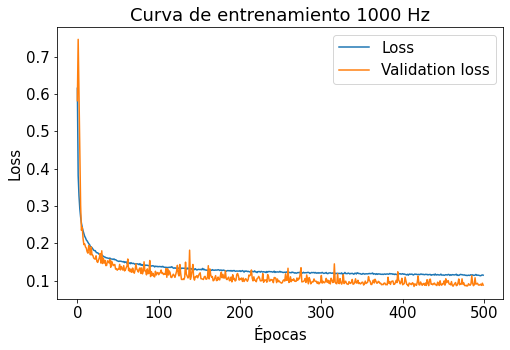

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([3.0000e+00, 1.8000e+01, 2.6070e+03, 2.8248e+04, 7.7160e+03,
        1.2000e+02, 2.0000e+00, 4.0000e+00]),
 array([-0.77  , -0.5525, -0.335 , -0.1175,  0.1   ,  0.3175,  0.535 ,
         0.7525,  0.97  ]),
 <a list of 8 Patch objects>)

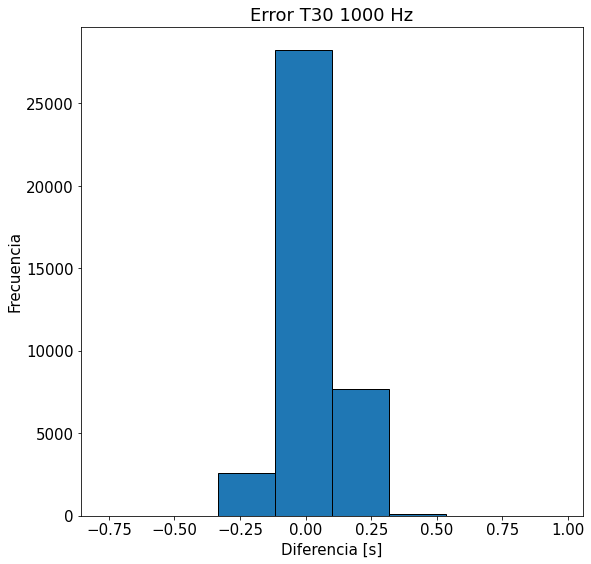

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([8.0000e+00, 2.0900e+02, 2.1830e+03, 3.5651e+04, 4.9400e+02,
        1.3800e+02, 3.1000e+01, 4.0000e+00]),
 array([-5.18  , -3.6075, -2.035 , -0.4625,  1.11  ,  2.6825,  4.255 ,
         5.8275,  7.4   ]),
 <a list of 8 Patch objects>)

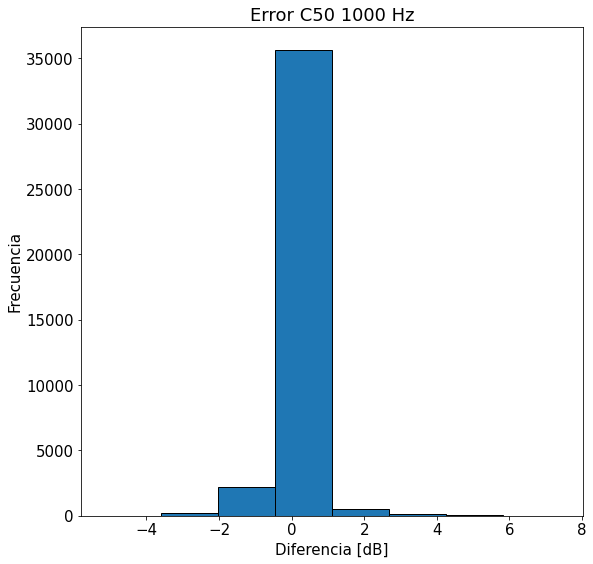

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([1.9000e+01, 2.5100e+02, 1.2756e+04, 2.5000e+04, 5.1900e+02,
        9.9000e+01, 4.8000e+01, 2.6000e+01]),
 array([-1.86   , -1.25125, -0.6425 , -0.03375,  0.575  ,  1.18375,
         1.7925 ,  2.40125,  3.01   ]),
 <a list of 8 Patch objects>)

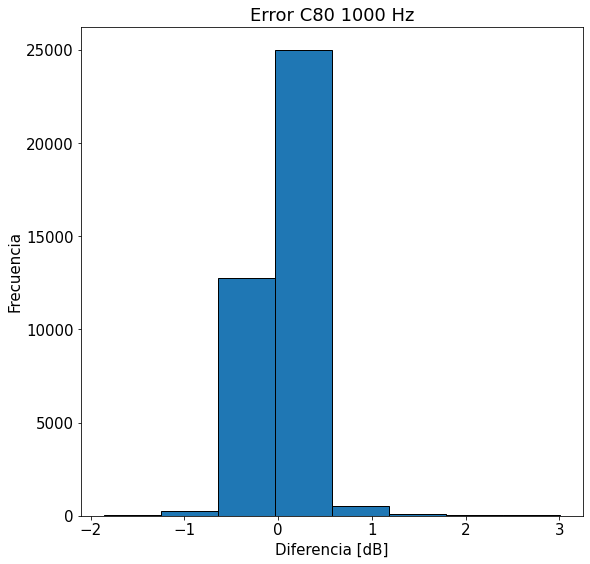

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([5.0000e+00, 8.7500e+02, 2.1961e+04, 1.5243e+04, 5.8600e+02,
        4.3000e+01, 4.0000e+00, 1.0000e+00]),
 array([-0.68   , -0.43375, -0.1875 ,  0.05875,  0.305  ,  0.55125,
         0.7975 ,  1.04375,  1.29   ]),
 <a list of 8 Patch objects>)

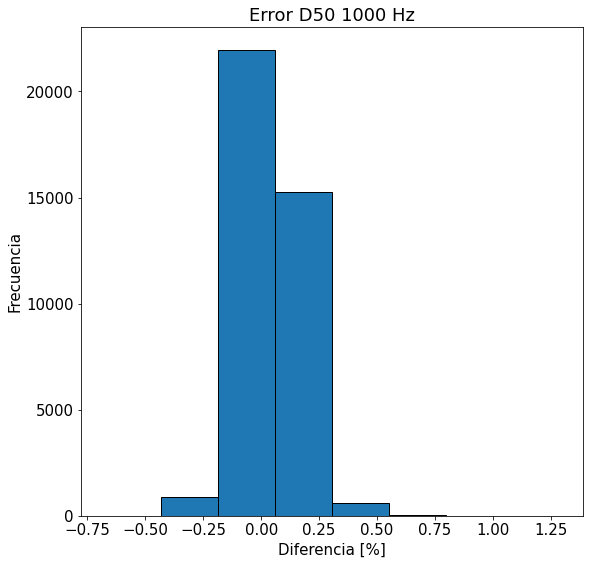

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

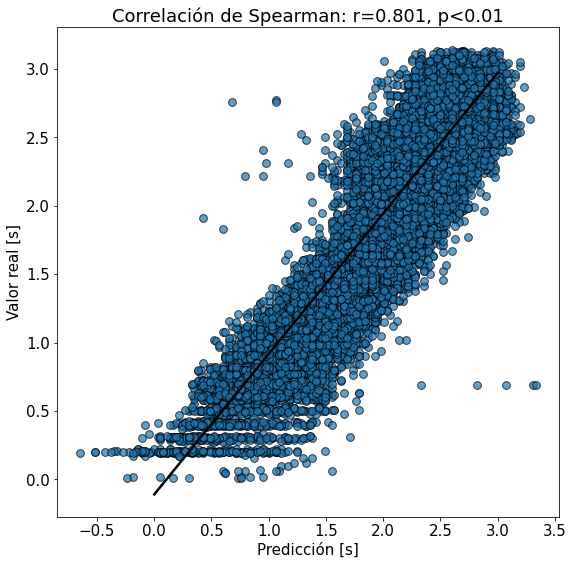

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

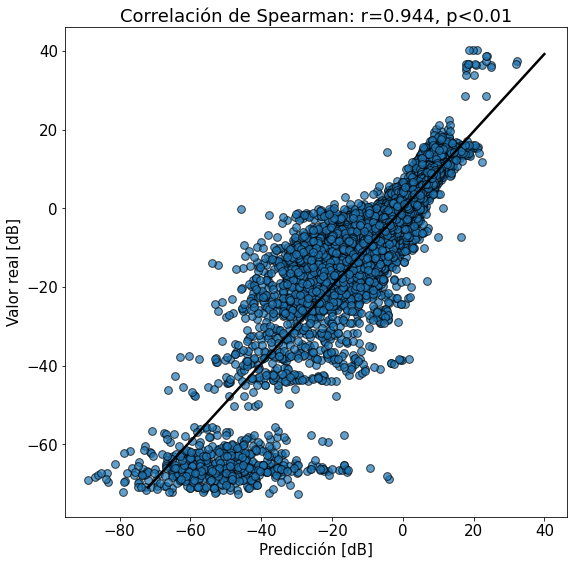

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

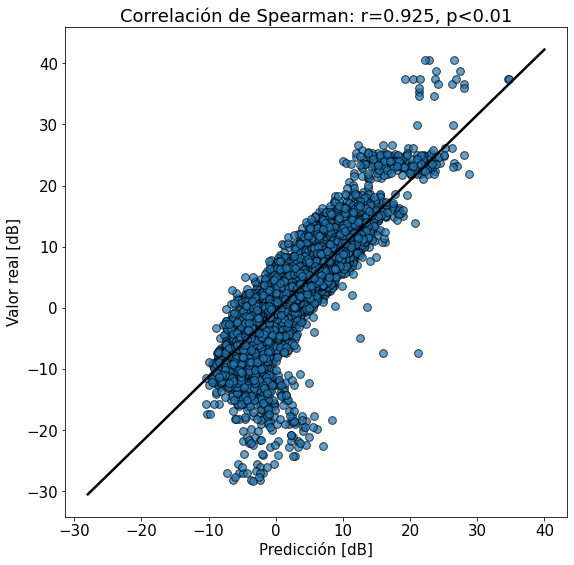

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

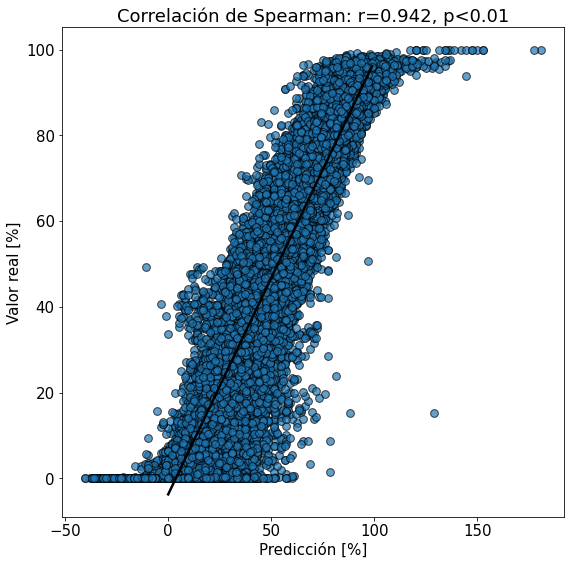

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

2000 Hz

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE sinteticos y reales')

band = 2000

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-7.893957922894453
2.352880661803969


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

2.61248049024854
9.438782313405854
10.89876583306533
89.78315827701283


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.10445733039717861
Máximo y_train: 2.352880661803969
Mínimo y_train: -7.893957922894453


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
137/137 [==============================] - 3s 15ms/step - loss: 0.5751 - val_loss: 0.4875
Epoch 2/500
137/137 [==============================] - 2s 13ms/step - loss: 0.2957 - val_loss: 0.5129
Epoch 3/500
137/137 [==============================] - 2s 12ms/step - loss: 0.2389 - val_loss: 0.5684
Epoch 4/500
137/137 [==============================] - 2s 12ms/step - loss: 0.2109 - val_loss: 0.3688
Epoch 5/500
137/137 [==============================] - 2s 13ms/step - loss: 0.1927 - val_loss: 0.2287
Epoch 6/500
137/137 [==============================] - 2s 12ms/step - loss: 0.1794 - val_loss: 0.1647
Epoch 7/500
137/137 [==============================] - 2s 12ms/step - loss: 0.1691 - val_loss: 0.1611
Epoch 8/500
137/137 [==============================] - 2s 13ms/step - loss: 0.1604 - val_loss: 0.1416
Epoch 9/500
137/137 [==============================] - 2s 13ms/step - loss: 0.1543 - val_loss: 0.1364
Epoch 10/500
137/137 [==============================] - 2s 12ms/step - loss: 0.148

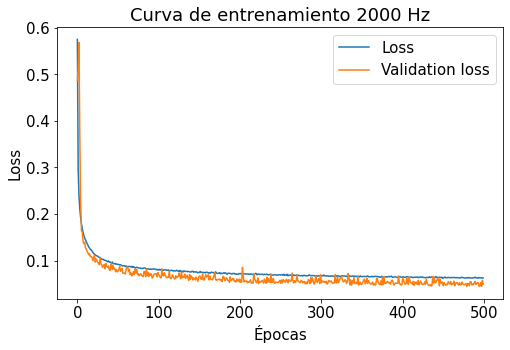

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([1.0000e+00, 3.0000e+00, 8.0000e+00, 3.3900e+02, 2.7884e+04,
        1.0407e+04, 6.9000e+01, 7.0000e+00]),
 array([-1.21   , -0.96125, -0.7125 , -0.46375, -0.215  ,  0.03375,
         0.2825 ,  0.53125,  0.78   ]),
 <a list of 8 Patch objects>)

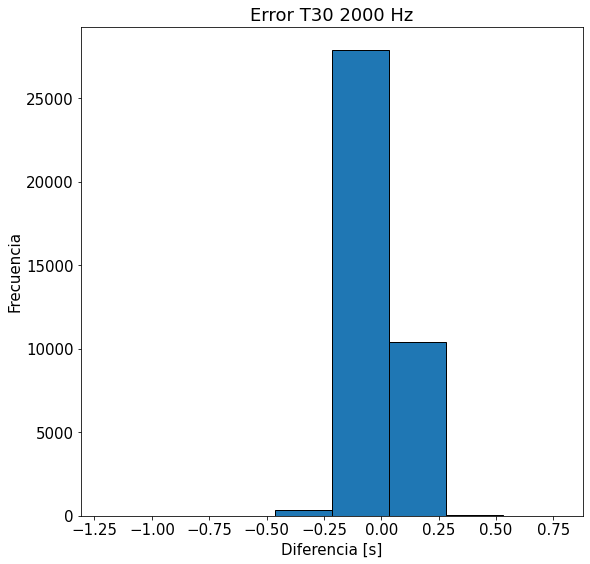

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([8.0000e+00, 5.3000e+01, 3.4700e+02, 2.9164e+04, 8.9900e+03,
        1.0100e+02, 4.4000e+01, 1.1000e+01]),
 array([-5.59   , -4.17375, -2.7575 , -1.34125,  0.075  ,  1.49125,
         2.9075 ,  4.32375,  5.74   ]),
 <a list of 8 Patch objects>)

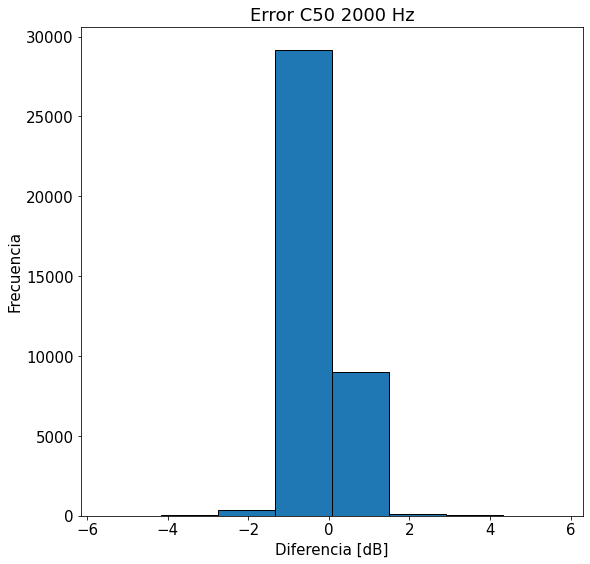

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([2.9000e+01, 4.1600e+02, 2.6136e+04, 1.1795e+04, 2.4100e+02,
        4.2000e+01, 3.7000e+01, 2.2000e+01]),
 array([-1.3    , -0.85125, -0.4025 ,  0.04625,  0.495  ,  0.94375,
         1.3925 ,  1.84125,  2.29   ]),
 <a list of 8 Patch objects>)

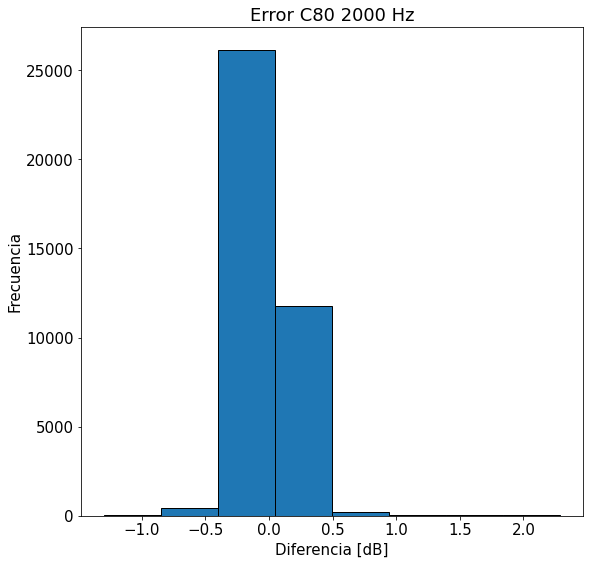

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([4.8000e+01, 8.3000e+02, 2.0559e+04, 1.6591e+04, 5.9600e+02,
        8.0000e+01, 1.3000e+01, 1.0000e+00]),
 array([-0.57  , -0.3775, -0.185 ,  0.0075,  0.2   ,  0.3925,  0.585 ,
         0.7775,  0.97  ]),
 <a list of 8 Patch objects>)

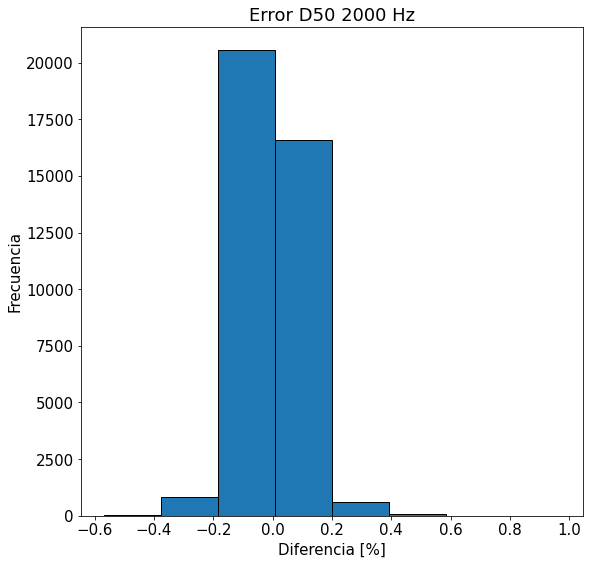

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

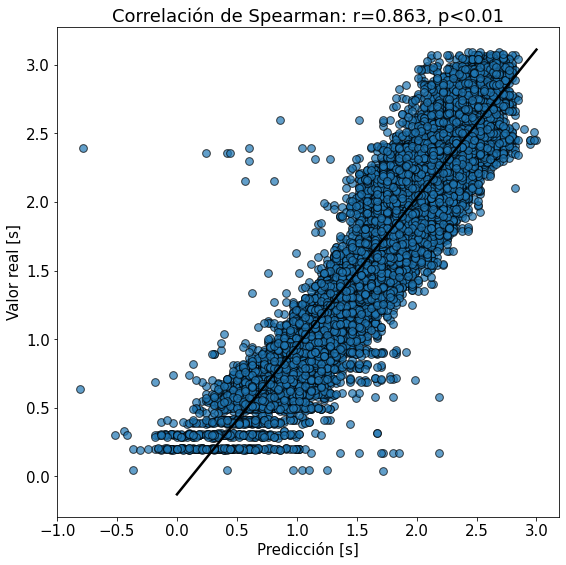

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

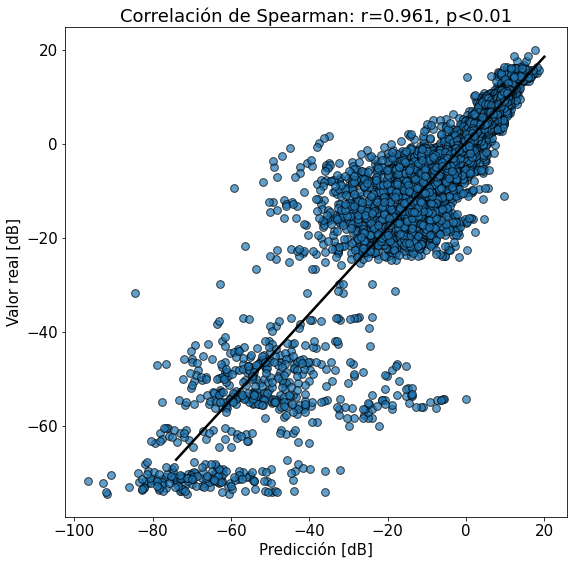

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

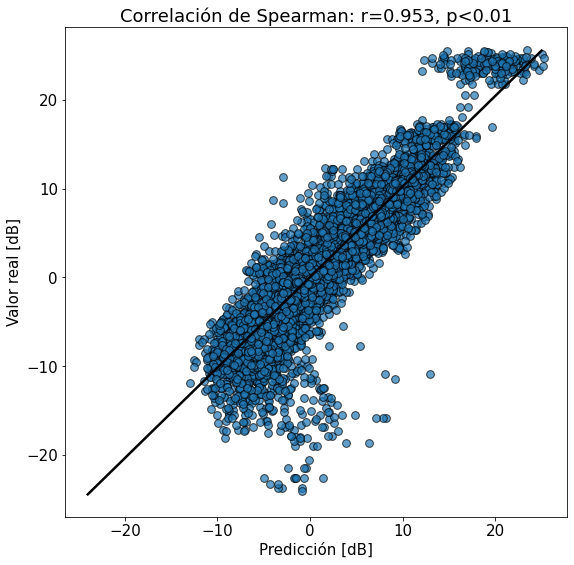

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

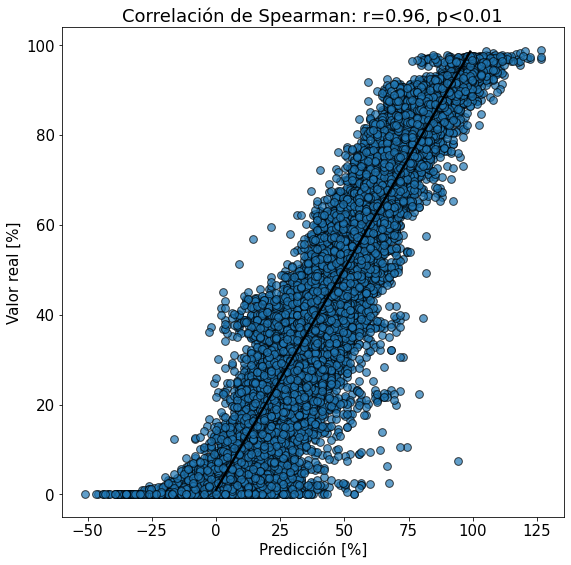

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

4000 Hz

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE sinteticos y reales')

band = 4000

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-6.886500377752845
2.0583138207708425


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

2.38863337091126
11.016153803550806
12.309813341286699
92.6665611955982


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.13137070416750804
Máximo y_train: 2.0583138207708425
Mínimo y_train: -6.886500377752845


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
137/137 [==============================] - 4s 16ms/step - loss: 0.3388 - val_loss: 0.5306
Epoch 2/500
137/137 [==============================] - 2s 13ms/step - loss: 0.1750 - val_loss: 0.7106
Epoch 3/500
137/137 [==============================] - 2s 13ms/step - loss: 0.1475 - val_loss: 0.6358
Epoch 4/500
137/137 [==============================] - 2s 13ms/step - loss: 0.1310 - val_loss: 0.3256
Epoch 5/500
137/137 [==============================] - 2s 13ms/step - loss: 0.1189 - val_loss: 0.1647
Epoch 6/500
137/137 [==============================] - 2s 13ms/step - loss: 0.1113 - val_loss: 0.0945
Epoch 7/500
137/137 [==============================] - 2s 13ms/step - loss: 0.1052 - val_loss: 0.0952
Epoch 8/500
137/137 [==============================] - 2s 13ms/step - loss: 0.0998 - val_loss: 0.0820
Epoch 9/500
137/137 [==============================] - 2s 13ms/step - loss: 0.0962 - val_loss: 0.0791
Epoch 10/500
137/137 [==============================] - 2s 13ms/step - loss: 0.092

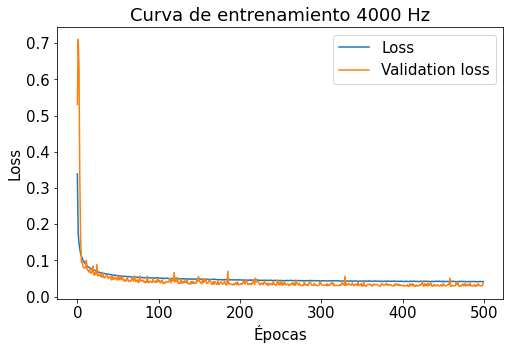

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([9.0000e+00, 2.6500e+02, 8.6340e+03, 2.2358e+04, 6.5440e+03,
        8.3800e+02, 5.9000e+01, 1.1000e+01]),
 array([-0.55 , -0.425, -0.3  , -0.175, -0.05 ,  0.075,  0.2  ,  0.325,
         0.45 ]),
 <a list of 8 Patch objects>)

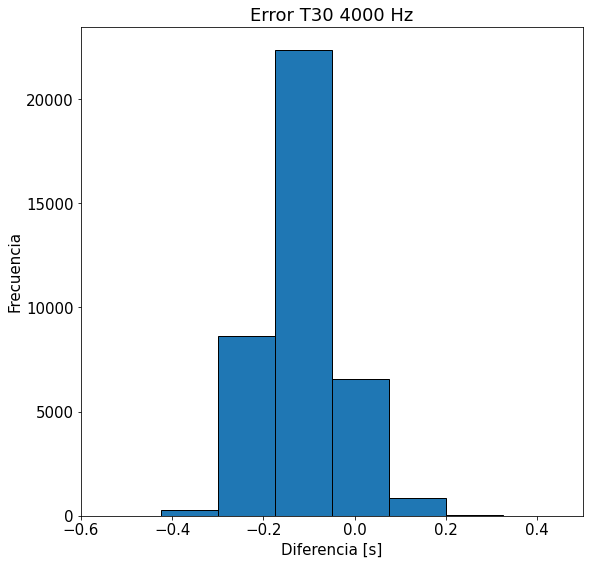

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([1.2000e+01, 1.8700e+02, 2.3043e+04, 1.5198e+04, 2.0100e+02,
        7.1000e+01, 4.0000e+00, 2.0000e+00]),
 array([-3.38   , -2.21625, -1.0525 ,  0.11125,  1.275  ,  2.43875,
         3.6025 ,  4.76625,  5.93   ]),
 <a list of 8 Patch objects>)

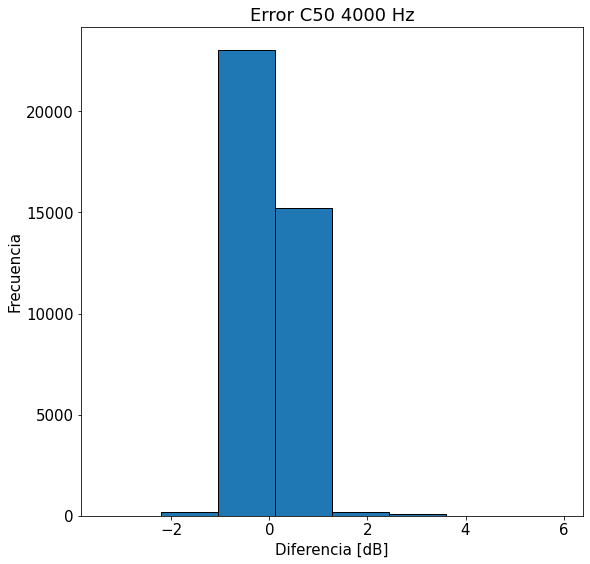

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([3.7000e+01, 7.3100e+02, 3.2117e+04, 5.4390e+03, 2.0800e+02,
        9.4000e+01, 7.1000e+01, 2.1000e+01]),
 array([-0.84 , -0.495, -0.15 ,  0.195,  0.54 ,  0.885,  1.23 ,  1.575,
         1.92 ]),
 <a list of 8 Patch objects>)

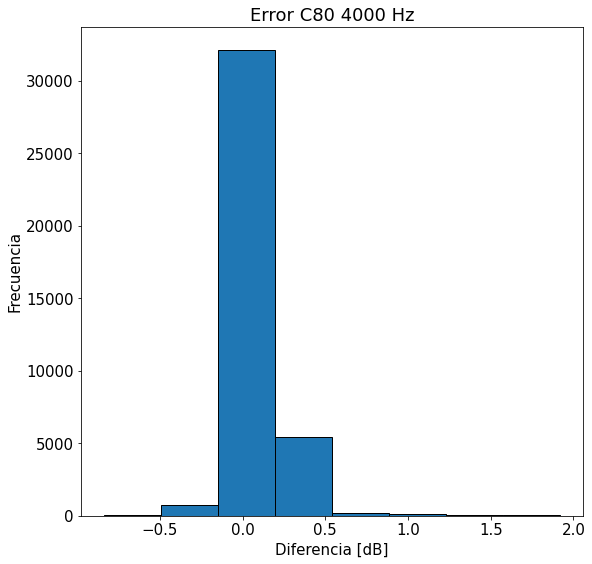

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([1.0000e+01, 1.2200e+02, 2.8920e+03, 2.9974e+04, 5.2100e+03,
        4.2100e+02, 7.0000e+01, 1.9000e+01]),
 array([-0.59, -0.41, -0.23, -0.05,  0.13,  0.31,  0.49,  0.67,  0.85]),
 <a list of 8 Patch objects>)

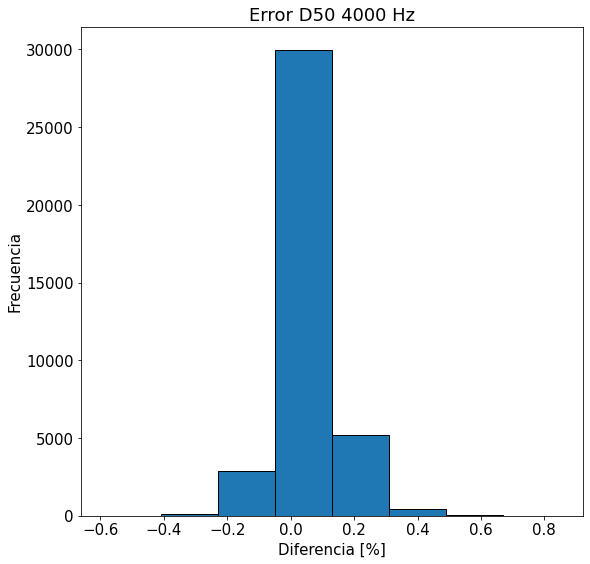

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

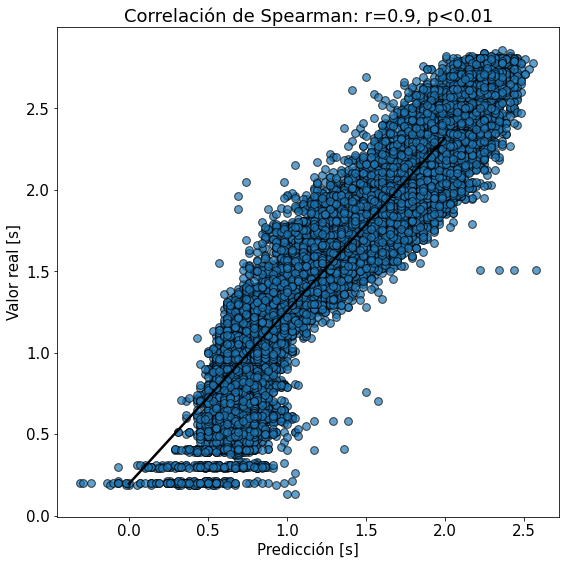

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

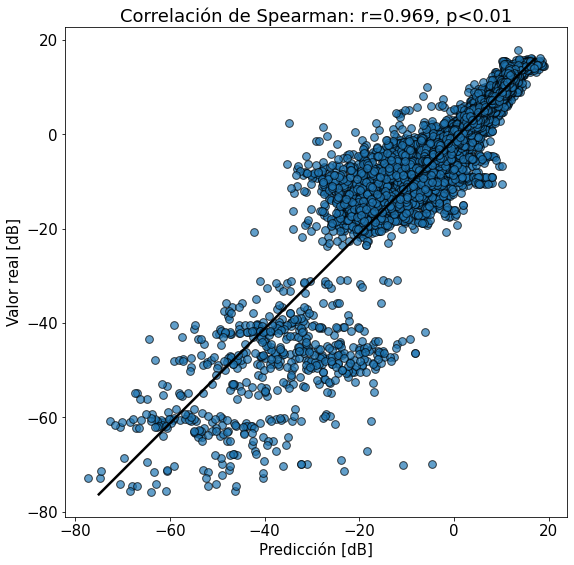

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

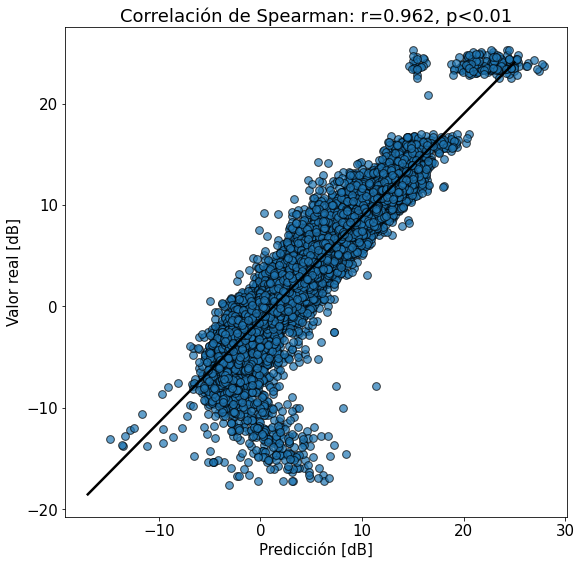

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

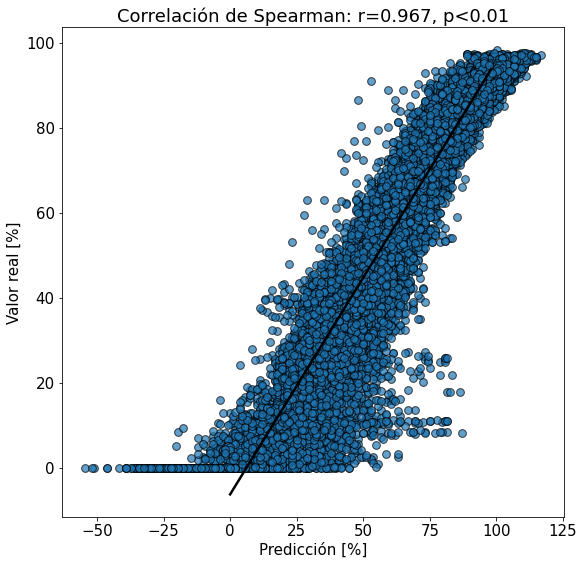

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

8000 Hz

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE sinteticos y reales')

band = 8000

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-5.50322323000086
1.950557429595135


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

2.3541946300411625
11.746401342993083
13.041080618158485
93.73039313319433


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.15264215250950752
Máximo y_train: 1.950557429595135
Mínimo y_train: -5.50322323000086


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
137/137 [==============================] - 5s 21ms/step - loss: 0.3938 - val_loss: 0.3737
Epoch 2/500
137/137 [==============================] - 2s 15ms/step - loss: 0.1559 - val_loss: 0.4080
Epoch 3/500
137/137 [==============================] - 2s 15ms/step - loss: 0.1248 - val_loss: 0.3290
Epoch 4/500
137/137 [==============================] - 2s 15ms/step - loss: 0.1082 - val_loss: 0.2096
Epoch 5/500
137/137 [==============================] - 2s 15ms/step - loss: 0.0979 - val_loss: 0.1182
Epoch 6/500
137/137 [==============================] - 2s 15ms/step - loss: 0.0902 - val_loss: 0.0782
Epoch 7/500
137/137 [==============================] - 2s 15ms/step - loss: 0.0846 - val_loss: 0.0678
Epoch 8/500
137/137 [==============================] - 2s 15ms/step - loss: 0.0794 - val_loss: 0.0658
Epoch 9/500
137/137 [==============================] - 2s 16ms/step - loss: 0.0752 - val_loss: 0.0594
Epoch 10/500
137/137 [==============================] - 2s 16ms/step - loss: 0.071

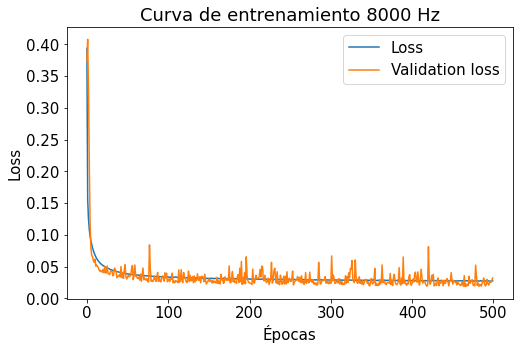

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([1.1000e+01, 7.0400e+02, 1.6219e+04, 1.9404e+04, 2.3440e+03,
        2.6000e+01, 6.0000e+00, 4.0000e+00]),
 array([-0.6    , -0.44375, -0.2875 , -0.13125,  0.025  ,  0.18125,
         0.3375 ,  0.49375,  0.65   ]),
 <a list of 8 Patch objects>)

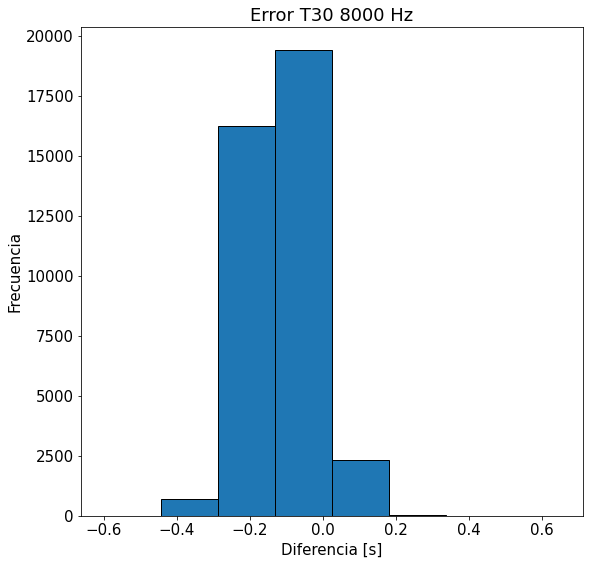

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([2.900e+01, 2.030e+02, 1.005e+03, 3.524e+04, 2.065e+03, 1.340e+02,
        3.300e+01, 9.000e+00]),
 array([-2.32  , -1.6575, -0.995 , -0.3325,  0.33  ,  0.9925,  1.655 ,
         2.3175,  2.98  ]),
 <a list of 8 Patch objects>)

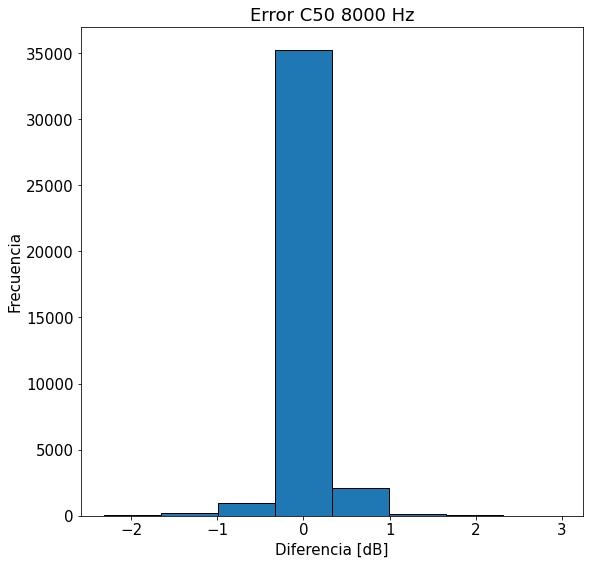

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([7.2000e+01, 1.4335e+04, 2.3696e+04, 4.8900e+02, 7.9000e+01,
        3.4000e+01, 9.0000e+00, 4.0000e+00]),
 array([-0.6    , -0.25875,  0.0825 ,  0.42375,  0.765  ,  1.10625,
         1.4475 ,  1.78875,  2.13   ]),
 <a list of 8 Patch objects>)

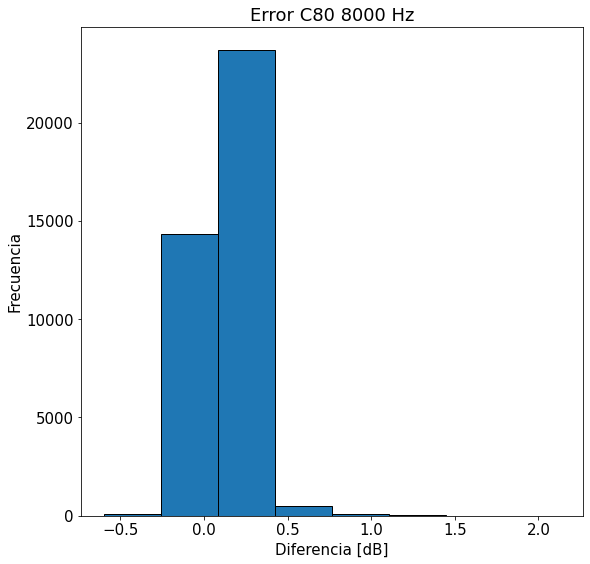

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([7.6000e+01, 7.3400e+02, 1.8090e+04, 1.8692e+04, 1.0420e+03,
        6.0000e+01, 2.1000e+01, 3.0000e+00]),
 array([-0.47  , -0.2975, -0.125 ,  0.0475,  0.22  ,  0.3925,  0.565 ,
         0.7375,  0.91  ]),
 <a list of 8 Patch objects>)

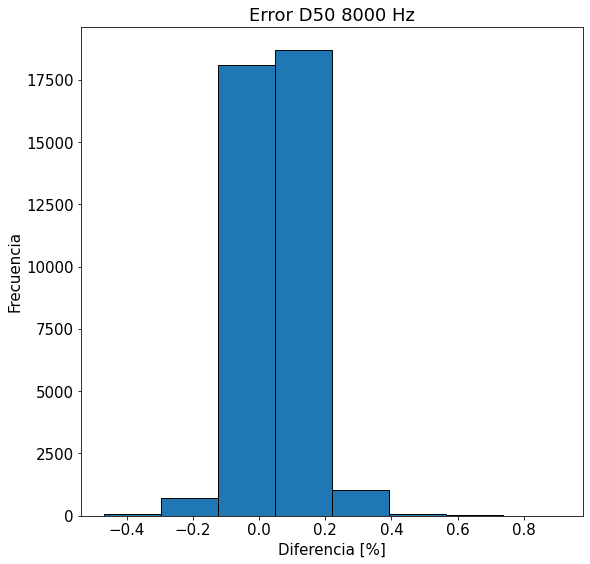

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

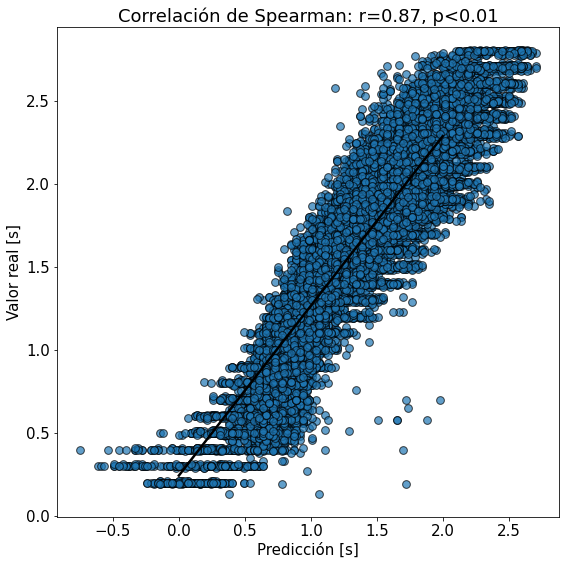

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

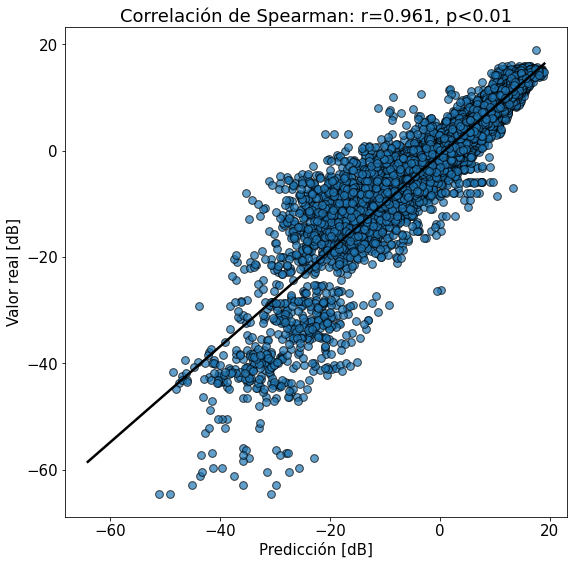

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

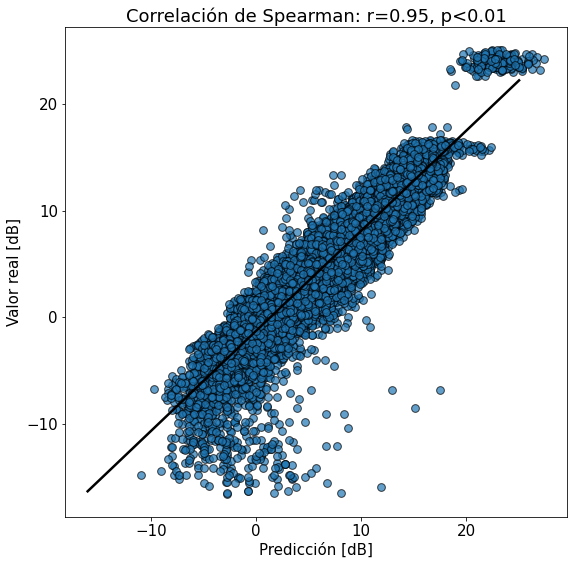

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

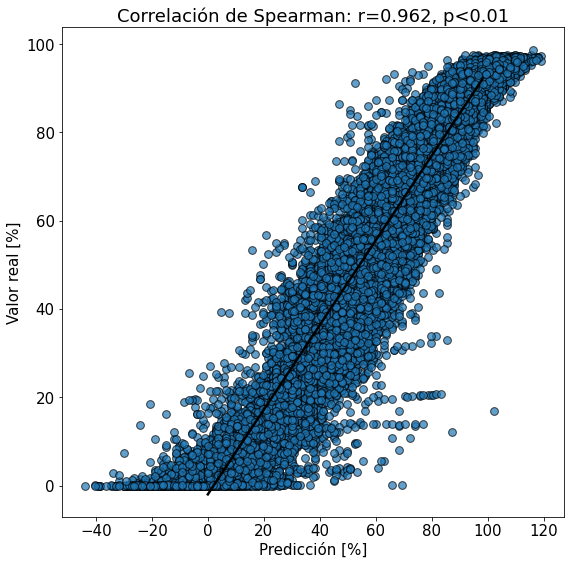

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

# Entrenamiento RIRs reales y sintéticas con ruido

En este caso, además de normalizar todo con el percentil 95, paso todos los valores a su escala sin dB ni %

In [ ]:
#Librerías necesarias:
import sys 
sys.path.append('/content/drive/My Drive/Tesis/Notebooks/scripts')
from model_2 import modelo
from scipy import stats

import numpy as np
import os
from librosa import load
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

!pip install pickle5
import pickle5 as pickle
import matplotlib.pyplot as plt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


Outliers:

In [ ]:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE con ruido')
with open('outliers.pickle', 'rb') as handle:
  outliers = list(set(pickle.load(handle)))

125 Hz:

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE con ruido')

band = 125

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

In [ ]:
print(list(tae_dic.keys())[10000])
print(list(params_dic.keys())[10000])

F1s3--Single_EE_lobby_1_Noise_Ambient_26_10.661dB--sintetica_Seed393668712_Tr0.2
F1s3--Single_EE_lobby_2_Noise_Ambient_19_9.104dB--sintetica_Seed2295707925_Tr0.2


In [ ]:
print(len(list(tae_dic.keys())))
print(len(list(params_dic.keys())))

216940
216940


In [ ]:
print(list(tae_dic.keys())[0:5])
print(list(params_dic.keys())[0:5])

['F1s3--Single_502_1_Noise_Ambient_0_-0.251dB--Zx12y07_4dB', 'F1s3--Single_502_1_Noise_Ambient_0_-0.506dB--Zx00y04_10dB', 'F1s3--Single_502_1_Noise_Ambient_0_-1.54dB--sintetica_Seed1272325897_Tr2.9', 'F1s3--Single_502_1_Noise_Ambient_0_-1.865dB--Xx03y11_2.6s', 'F1s3--Single_502_1_Noise_Ambient_0_-2.983dB--Xx09y10_2.3s']
['F1s3--Single_502_1_Noise_Ambient_25_6.051dB--sintetica_Seed1000489356_Tr0.8', 'F2s3--Single_502_2_Noise_Ambient_30_-3.524dB--sintetica_Seed1000489356_Tr0.8', 'F3s3--Single_EE_lobby_1_Noise_Fan_46_7.023dB--sintetica_Seed1000489356_Tr0.8', 'F4s3--Single_EE_lobby_1_Noise_Fan_44_18.522dB--sintetica_Seed1000489356_Tr0.8', 'F5s3--Single_EE_lobby_2_Noise_Fan_28_16.887dB--sintetica_Seed1000489356_Tr0.8']


In [ ]:
#print(params_dic['F1s3-sintetica_Seed1807110498_Tr3.0'])

In [ ]:
#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

In [ ]:
#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
print(len(y))

193300


In [ ]:
#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-23.636536415920926
9.35084541607995


In [ ]:
print(T30_perc_95) 
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

2.961142434425098
2.6416356678796293
4.890778846920549
64.75435749957332


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
print(X_train.shape)
print(y_train.shape)

(154640, 200, 1)
(154640, 4, 1)


In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.15673743374360594


In [ ]:
assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo y_train: 9.35084541607995
Mínimo y_train: -23.636536415920926


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
136/136 [==============================] - 20s 22ms/step - loss: 8.2935 - val_loss: 7.2607
Epoch 2/500
136/136 [==============================] - 2s 14ms/step - loss: 6.8870 - val_loss: 7.2829
Epoch 3/500
136/136 [==============================] - 2s 15ms/step - loss: 6.5106 - val_loss: 6.8754
Epoch 4/500
136/136 [==============================] - 2s 15ms/step - loss: 6.1690 - val_loss: 6.3881
Epoch 5/500
136/136 [==============================] - 2s 14ms/step - loss: 5.9467 - val_loss: 5.9789
Epoch 6/500
136/136 [==============================] - 2s 14ms/step - loss: 5.7919 - val_loss: 5.6412
Epoch 7/500
136/136 [==============================] - 2s 15ms/step - loss: 5.6778 - val_loss: 5.5693
Epoch 8/500
136/136 [==============================] - 2s 15ms/step - loss: 5.6044 - val_loss: 5.5894
Epoch 9/500
136/136 [==============================] - 2s 14ms/step - loss: 5.5264 - val_loss: 5.3835
Epoch 10/500
136/136 [==============================] - 2s 14ms/step - loss: 5.47

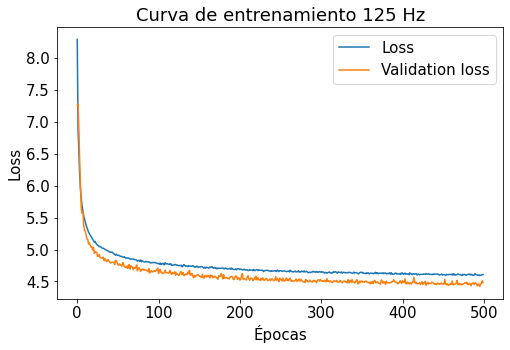

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
blind_estimation_model.predict(X_test[5,:,0].reshape(1,-1,1))[0]

array([ 0.69383216, -2.0294774 , -0.16816676,  0.44832495], dtype=float32)

In [ ]:
np.round(y_test[0,:,0].reshape(1,-1,1),1)

array([[[ 0.4],
        [-5.4],
        [-1.8],
        [ 0.1]]])

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
prediction[0]

array([ 0.62, -8.8 , -1.26,  0.12], dtype=float32)

In [ ]:
np.round(prediction[1] - np.round(y_test[1,:,0].reshape(1,-1,1),2).flatten(),2)

array([ 0.32, -0.76, -0.56, -0.45])

In [ ]:
np.round(prediction[1][0] - np.round(y_test[1,:,0].reshape(1,-1,1),2).flatten()[0],2)

0.32

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([   53.,  2527., 13898.,  7607.,  4953.,  5314.,  2188.,  2120.]),
 array([-0.67   , -0.48625, -0.3025 , -0.11875,  0.065  ,  0.24875,
         0.4325 ,  0.61625,  0.8    ]),
 <a list of 8 Patch objects>)

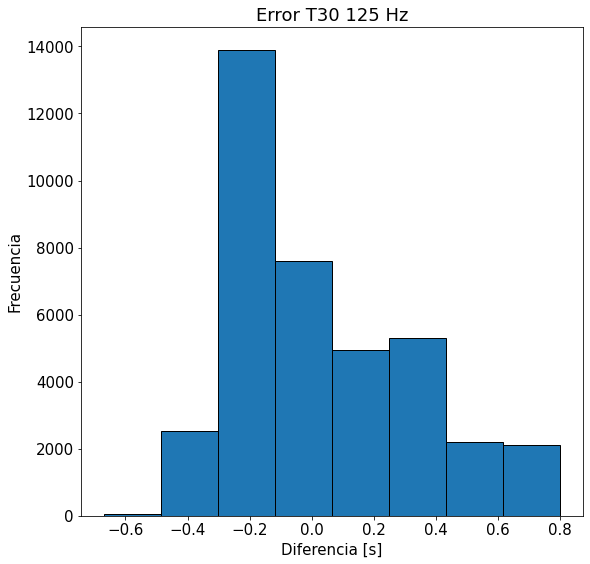

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([   29.,   734., 12616., 19493.,  3692.,  1397.,   597.,   102.]),
 array([-16.25 , -11.485,  -6.72 ,  -1.955,   2.81 ,   7.575,  12.34 ,
         17.105,  21.87 ]),
 <a list of 8 Patch objects>)

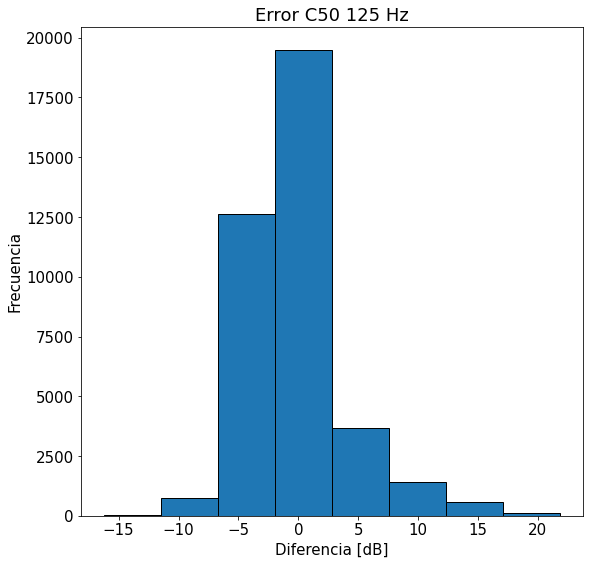

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([4.0000e+00, 1.0000e+02, 1.3170e+03, 3.0982e+04, 6.0550e+03,
        1.3400e+02, 7.0000e+00, 6.1000e+01]),
 array([-9.38 , -6.865, -4.35 , -1.835,  0.68 ,  3.195,  5.71 ,  8.225,
        10.74 ]),
 <a list of 8 Patch objects>)

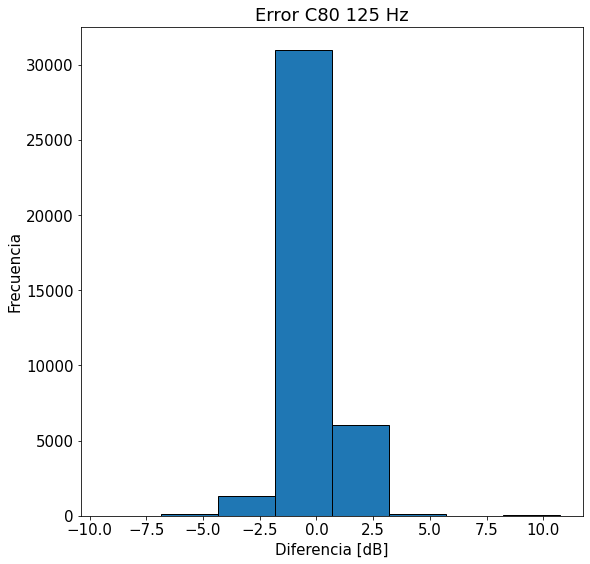

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([   40.,   313.,  1041.,  3425., 11468., 19116.,  3228.,    29.]),
 array([-1.49  , -1.1975, -0.905 , -0.6125, -0.32  , -0.0275,  0.265 ,
         0.5575,  0.85  ]),
 <a list of 8 Patch objects>)

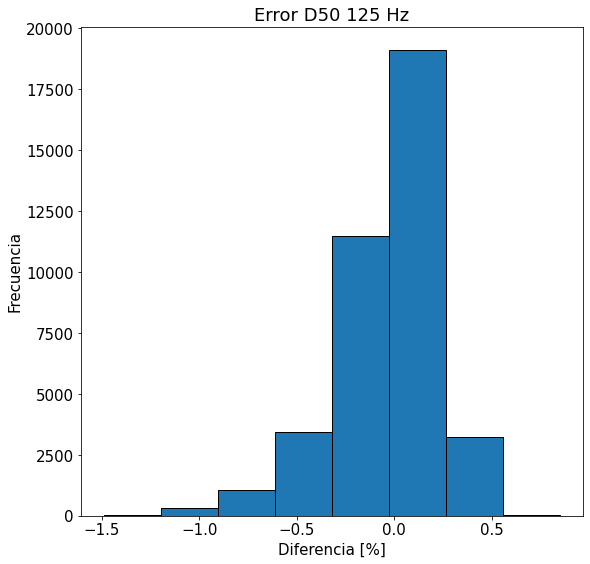

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

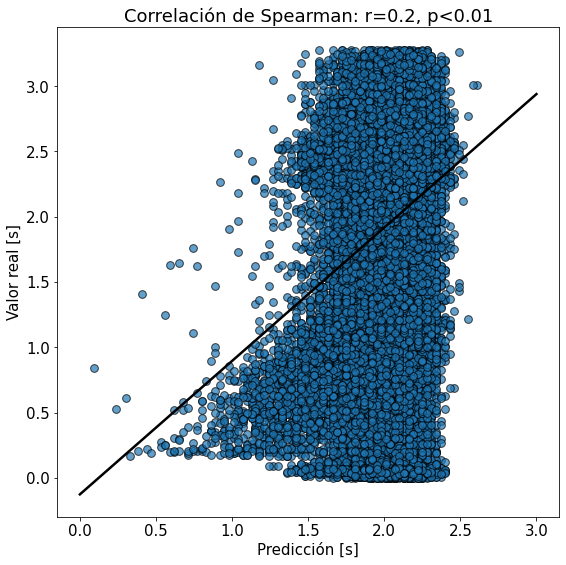

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

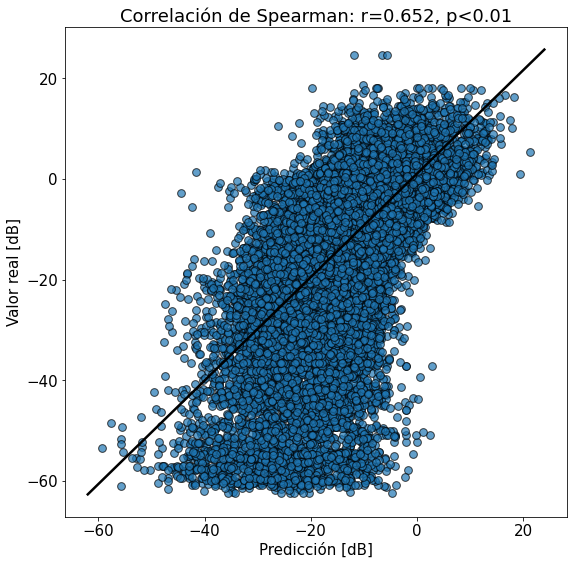

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

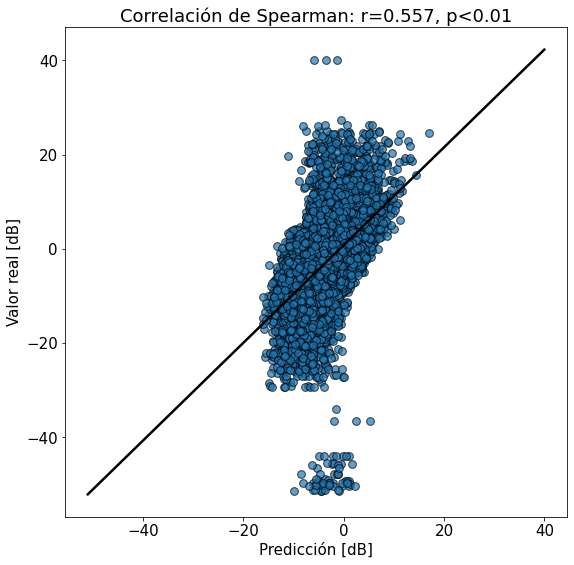

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

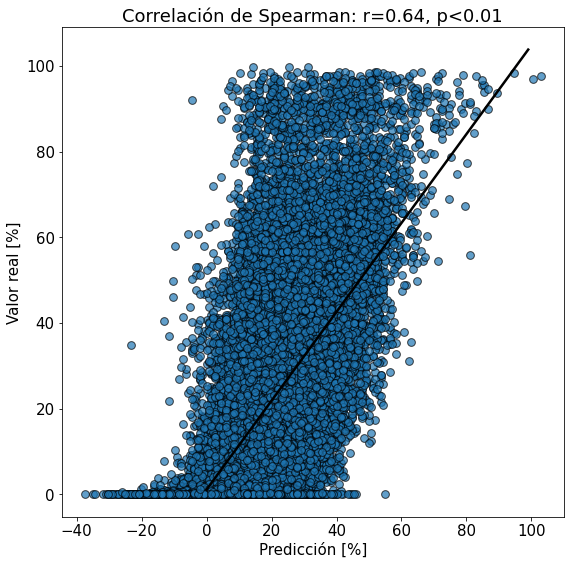

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

250 Hz:

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE con ruido')

band = 250

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-10.004996714135375
6.825032030846


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

2.6644592101390527
6.587574957433179
7.6417443614408835
82.0073448854456


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.1795318897862861
Máximo y_train: 6.825032030846
Mínimo y_train: -10.004996714135375


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
136/136 [==============================] - 3s 14ms/step - loss: 1.3451 - val_loss: 1.1773
Epoch 2/500
136/136 [==============================] - 2s 13ms/step - loss: 0.9267 - val_loss: 1.1062
Epoch 3/500
136/136 [==============================] - 2s 13ms/step - loss: 0.7989 - val_loss: 0.9642
Epoch 4/500
136/136 [==============================] - 2s 13ms/step - loss: 0.7301 - val_loss: 0.7972
Epoch 5/500
136/136 [==============================] - 2s 12ms/step - loss: 0.6923 - val_loss: 0.6569
Epoch 6/500
136/136 [==============================] - 2s 13ms/step - loss: 0.6651 - val_loss: 0.6181
Epoch 7/500
136/136 [==============================] - 2s 12ms/step - loss: 0.6413 - val_loss: 0.5917
Epoch 8/500
136/136 [==============================] - 2s 12ms/step - loss: 0.6261 - val_loss: 0.5738
Epoch 9/500
136/136 [==============================] - 2s 13ms/step - loss: 0.6138 - val_loss: 0.5619
Epoch 10/500
136/136 [==============================] - 2s 12ms/step - loss: 0.603

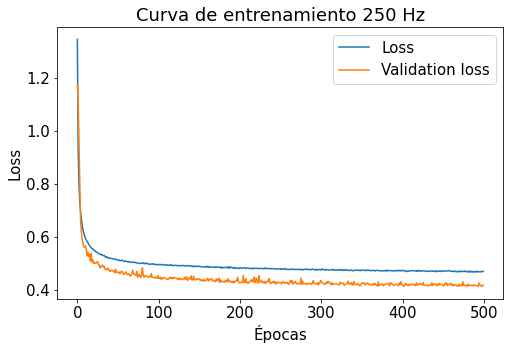

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([  129.,  3437., 17372.,  8676.,  5440.,  3128.,   431.,    47.]),
 array([-0.54   , -0.36625, -0.1925 , -0.01875,  0.155  ,  0.32875,
         0.5025 ,  0.67625,  0.85   ]),
 <a list of 8 Patch objects>)

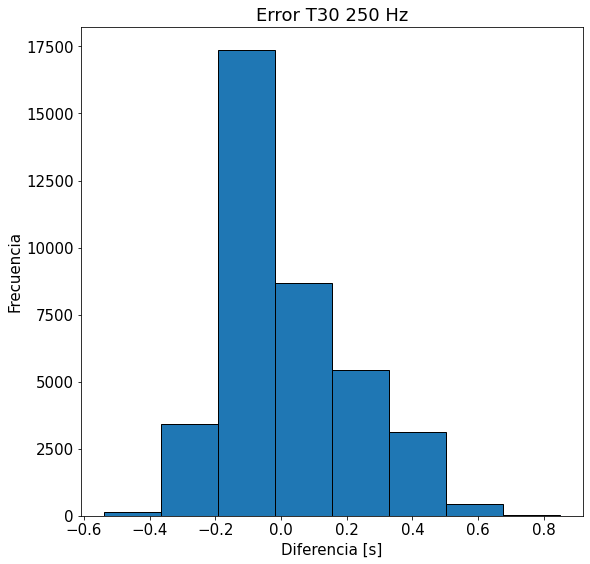

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([5.0000e+00, 1.2300e+02, 4.7550e+03, 3.0438e+04, 2.2820e+03,
        7.0600e+02, 2.8100e+02, 7.0000e+01]),
 array([-7.02  , -5.0175, -3.015 , -1.0125,  0.99  ,  2.9925,  4.995 ,
         6.9975,  9.    ]),
 <a list of 8 Patch objects>)

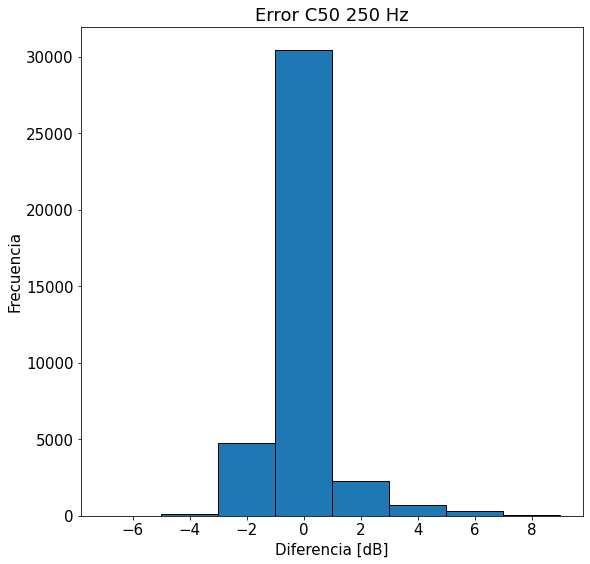

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([2.0000e+00, 7.0000e+00, 7.1000e+01, 4.5880e+03, 3.2842e+04,
        1.0630e+03, 2.7000e+01, 6.0000e+01]),
 array([-6.3    , -4.86125, -3.4225 , -1.98375, -0.545  ,  0.89375,
         2.3325 ,  3.77125,  5.21   ]),
 <a list of 8 Patch objects>)

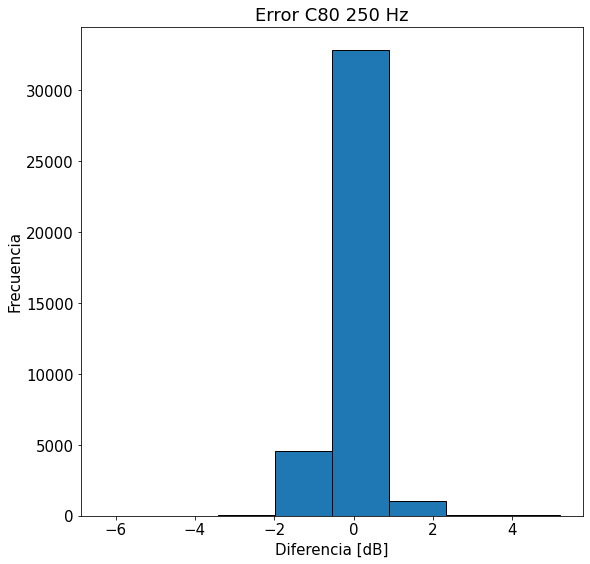

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([1.1000e+01, 1.1900e+02, 1.1460e+03, 7.3730e+03, 2.0901e+04,
        8.3310e+03, 7.3200e+02, 4.7000e+01]),
 array([-1.02 , -0.795, -0.57 , -0.345, -0.12 ,  0.105,  0.33 ,  0.555,
         0.78 ]),
 <a list of 8 Patch objects>)

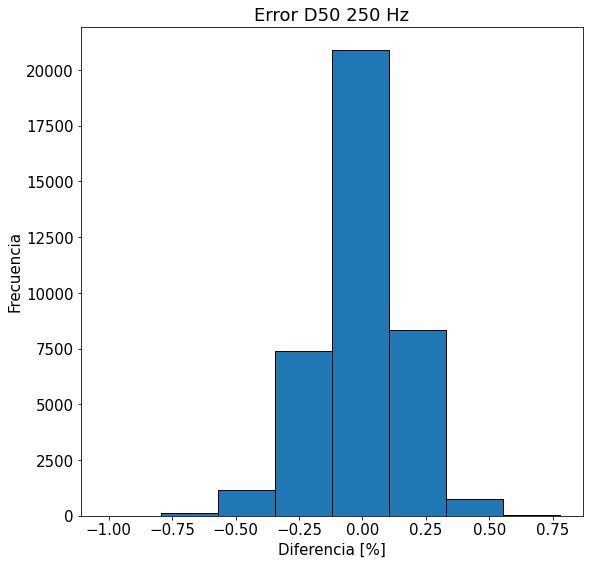

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

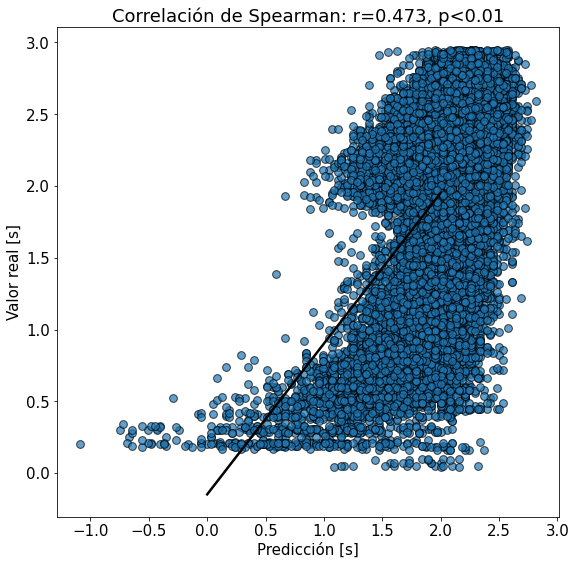

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

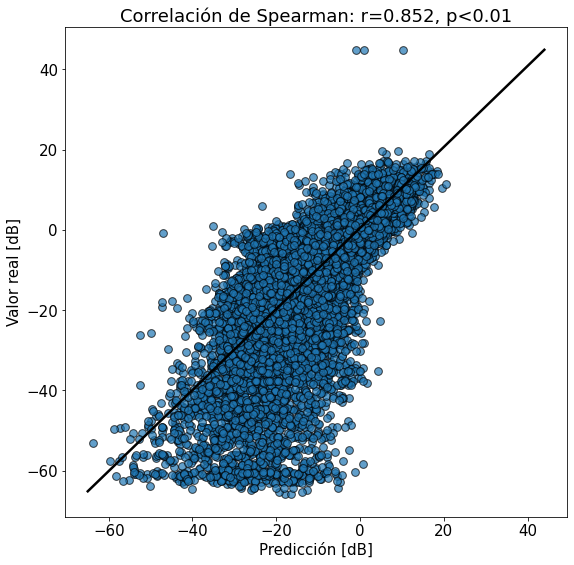

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

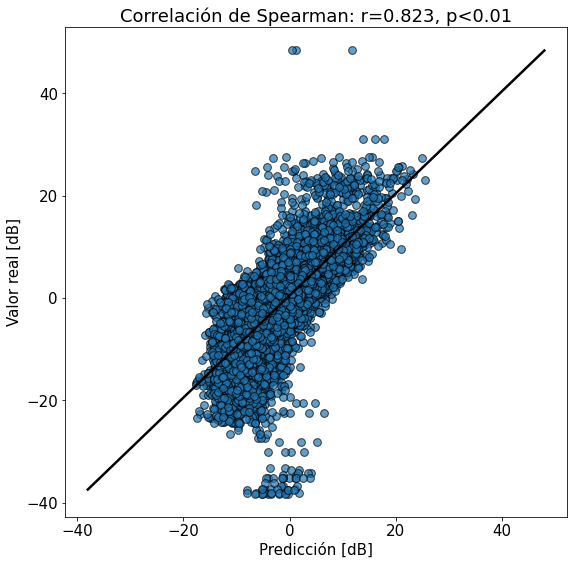

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

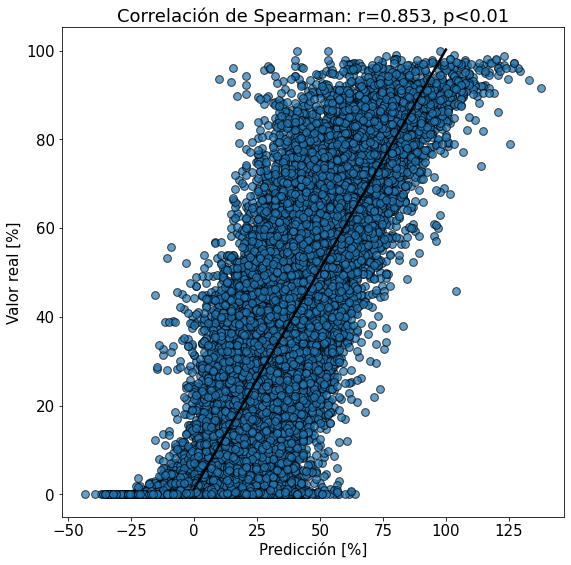

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

500 Hz

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE con ruido')

band = 500

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-8.512893814595603
5.950410171731849


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

2.6734085504411738
8.420277403331834
9.501012252296038
87.42247074693888


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.1269341014833659
Máximo y_train: 5.950410171731849
Mínimo y_train: -8.512893814595603


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
136/136 [==============================] - 3s 15ms/step - loss: 0.7511 - val_loss: 0.6394
Epoch 2/500
136/136 [==============================] - 2s 12ms/step - loss: 0.4920 - val_loss: 0.6064
Epoch 3/500
136/136 [==============================] - 2s 12ms/step - loss: 0.4196 - val_loss: 0.4704
Epoch 4/500
136/136 [==============================] - 2s 12ms/step - loss: 0.3793 - val_loss: 0.3809
Epoch 5/500
136/136 [==============================] - 2s 12ms/step - loss: 0.3550 - val_loss: 0.3294
Epoch 6/500
136/136 [==============================] - 2s 13ms/step - loss: 0.3392 - val_loss: 0.3078
Epoch 7/500
136/136 [==============================] - 2s 12ms/step - loss: 0.3266 - val_loss: 0.2979
Epoch 8/500
136/136 [==============================] - 2s 12ms/step - loss: 0.3195 - val_loss: 0.2974
Epoch 9/500
136/136 [==============================] - 2s 13ms/step - loss: 0.3133 - val_loss: 0.2869
Epoch 10/500
136/136 [==============================] - 2s 12ms/step - loss: 0.306

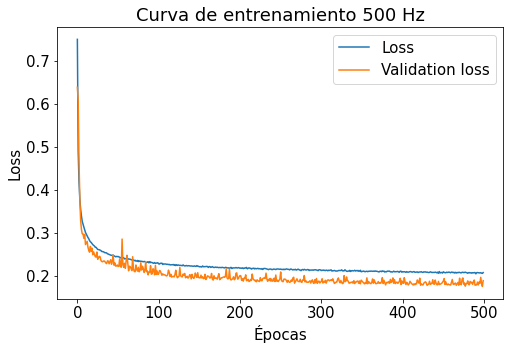

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([4.7000e+01, 3.3470e+03, 2.0684e+04, 6.1660e+03, 5.7450e+03,
        2.4970e+03, 1.5600e+02, 1.8000e+01]),
 array([-0.56, -0.37, -0.18,  0.01,  0.2 ,  0.39,  0.58,  0.77,  0.96]),
 <a list of 8 Patch objects>)

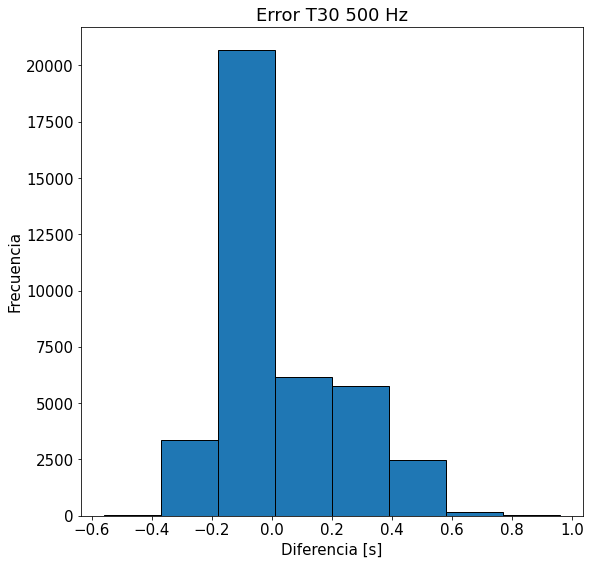

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([8.0000e+00, 1.4700e+02, 1.5456e+04, 2.1738e+04, 8.8200e+02,
        2.9800e+02, 9.9000e+01, 3.2000e+01]),
 array([-5.35  , -3.6275, -1.905 , -0.1825,  1.54  ,  3.2625,  4.985 ,
         6.7075,  8.43  ]),
 <a list of 8 Patch objects>)

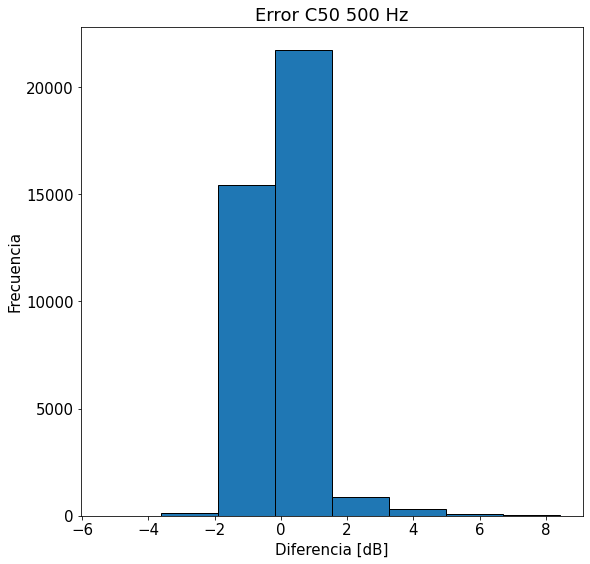

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([3.0000e+00, 2.0000e+00, 1.1300e+02, 7.2510e+03, 3.0672e+04,
        5.4500e+02, 2.8000e+01, 4.6000e+01]),
 array([-4.61   , -3.54125, -2.4725 , -1.40375, -0.335  ,  0.73375,
         1.8025 ,  2.87125,  3.94   ]),
 <a list of 8 Patch objects>)

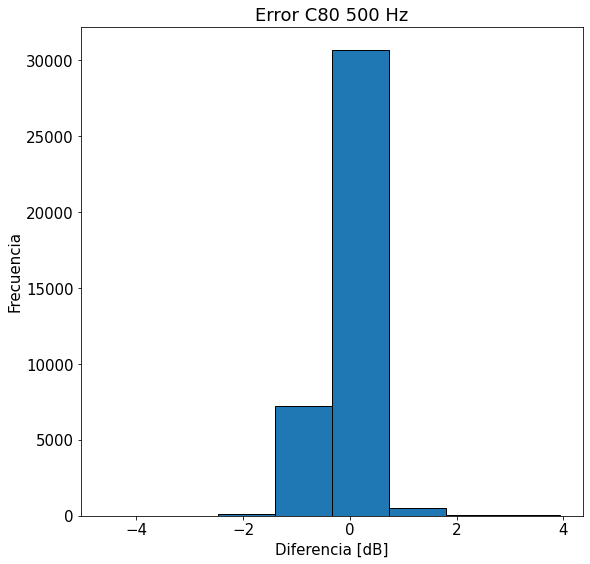

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([2.7000e+01, 6.1900e+02, 7.7280e+03, 2.3047e+04, 6.2480e+03,
        8.8800e+02, 1.0000e+02, 3.0000e+00]),
 array([-0.8    , -0.58125, -0.3625 , -0.14375,  0.075  ,  0.29375,
         0.5125 ,  0.73125,  0.95   ]),
 <a list of 8 Patch objects>)

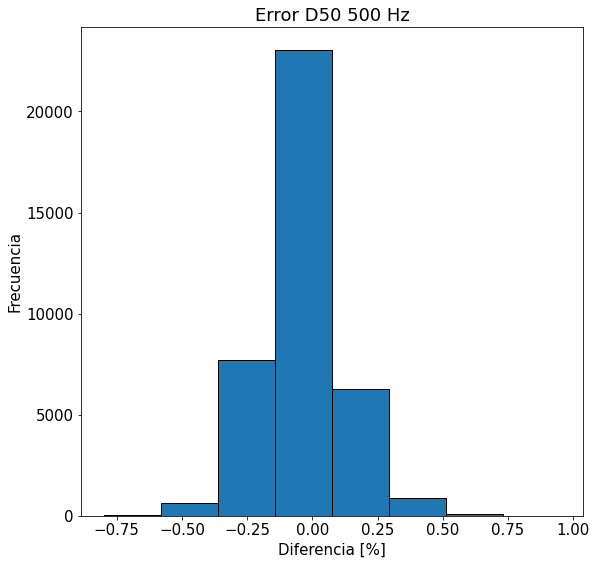

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

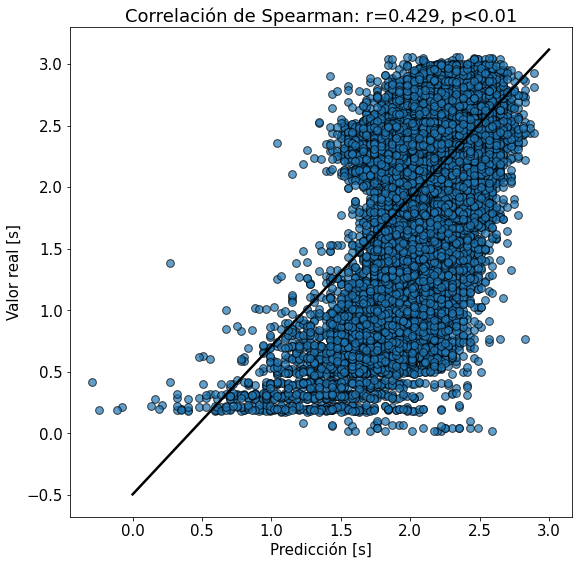

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

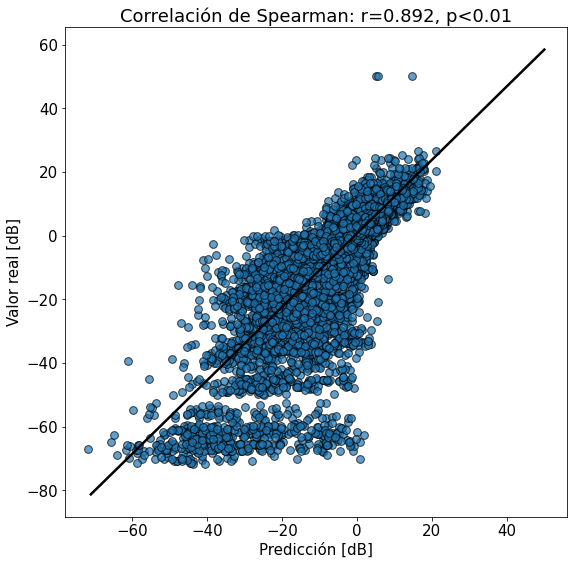

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

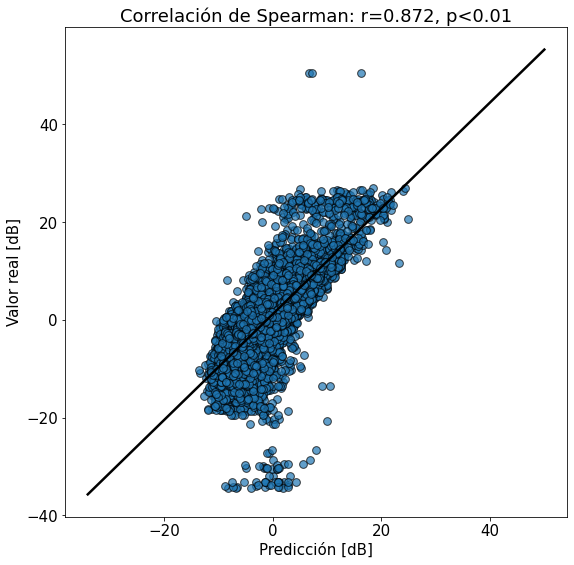

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

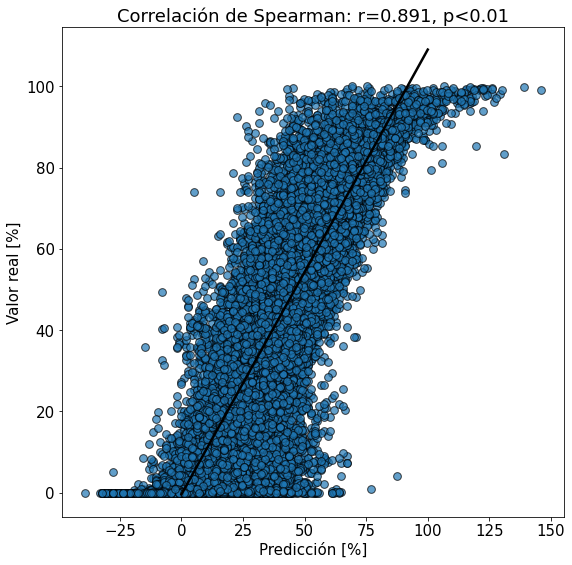

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

1000 Hz

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE con ruido')

band = 1000

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-8.482198797193828
4.620080915383618


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

2.7319535897149496
8.725215452185934
9.798464840399502
88.17445322983731


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.12964634185677454
Máximo y_train: 4.620080915383618
Mínimo y_train: -8.482198797193828


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
136/136 [==============================] - 3s 15ms/step - loss: 0.5834 - val_loss: 0.5189
Epoch 2/500
136/136 [==============================] - 2s 12ms/step - loss: 0.4242 - val_loss: 0.5889
Epoch 3/500
136/136 [==============================] - 2s 12ms/step - loss: 0.3786 - val_loss: 0.6443
Epoch 4/500
136/136 [==============================] - 2s 12ms/step - loss: 0.3472 - val_loss: 0.4681
Epoch 5/500
136/136 [==============================] - 2s 13ms/step - loss: 0.3237 - val_loss: 0.3287
Epoch 6/500
136/136 [==============================] - 2s 12ms/step - loss: 0.3069 - val_loss: 0.2794
Epoch 7/500
136/136 [==============================] - 2s 13ms/step - loss: 0.2954 - val_loss: 0.2709
Epoch 8/500
136/136 [==============================] - 2s 12ms/step - loss: 0.2868 - val_loss: 0.2620
Epoch 9/500
136/136 [==============================] - 2s 12ms/step - loss: 0.2803 - val_loss: 0.2696
Epoch 10/500
136/136 [==============================] - 2s 13ms/step - loss: 0.274

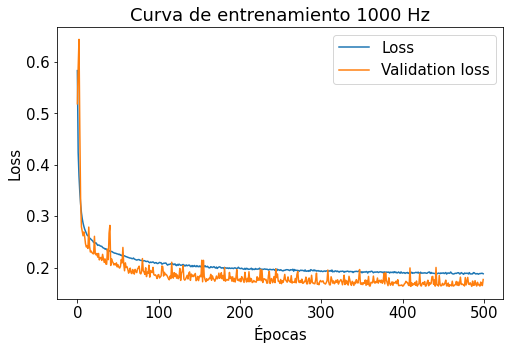

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([  118.,  1852., 16486., 13166.,  5301.,  1549.,   167.,    21.]),
 array([-0.58  , -0.3825, -0.185 ,  0.0125,  0.21  ,  0.4075,  0.605 ,
         0.8025,  1.    ]),
 <a list of 8 Patch objects>)

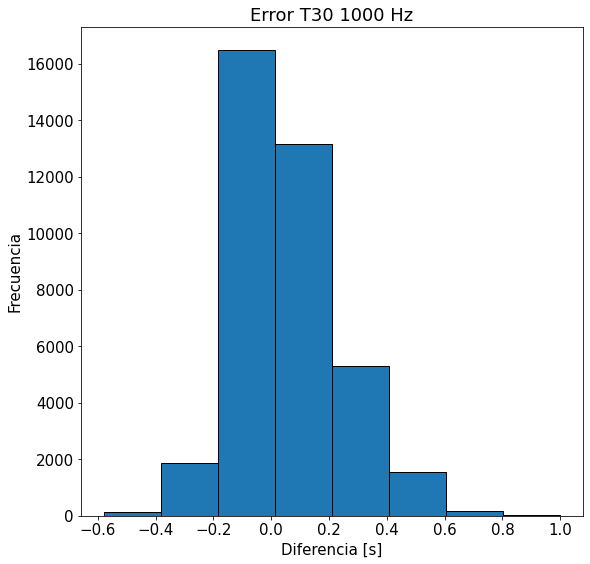

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([1.6000e+01, 1.9700e+02, 4.0650e+03, 3.3307e+04, 6.6100e+02,
        2.6100e+02, 9.6000e+01, 5.7000e+01]),
 array([-5.77   , -4.04625, -2.3225 , -0.59875,  1.125  ,  2.84875,
         4.5725 ,  6.29625,  8.02   ]),
 <a list of 8 Patch objects>)

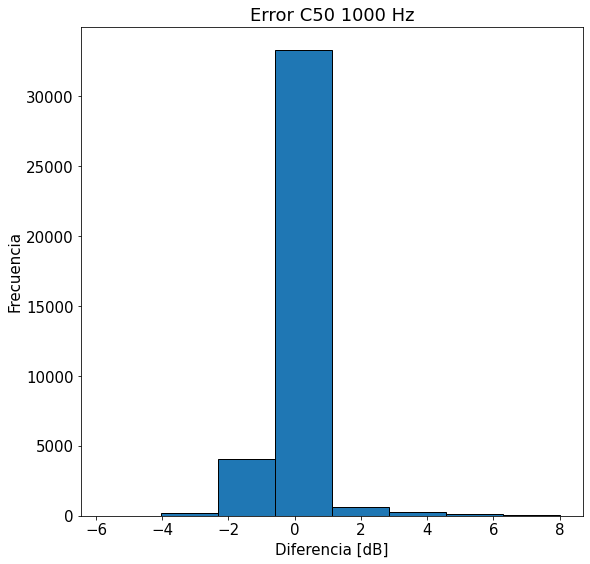

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([9.0000e+00, 5.4000e+01, 5.0100e+02, 3.0933e+04, 6.8690e+03,
        1.9500e+02, 8.6000e+01, 1.3000e+01]),
 array([-3.6    , -2.69375, -1.7875 , -0.88125,  0.025  ,  0.93125,
         1.8375 ,  2.74375,  3.65   ]),
 <a list of 8 Patch objects>)

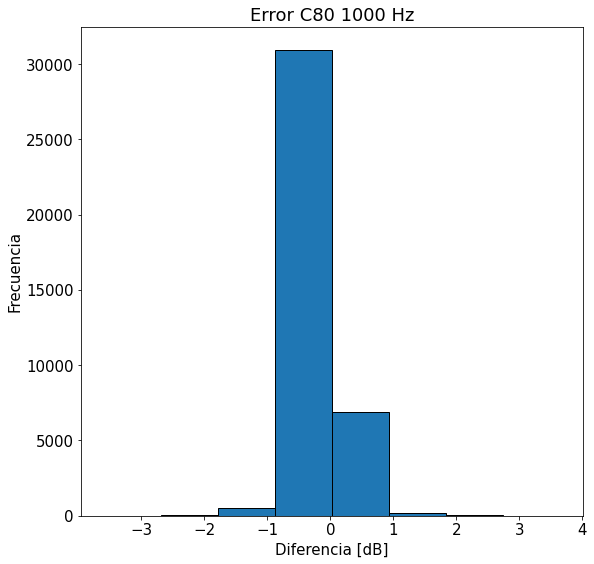

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([1.6000e+01, 1.8900e+02, 2.0090e+03, 1.6474e+04, 1.7370e+04,
        2.2940e+03, 2.8000e+02, 2.8000e+01]),
 array([-0.94, -0.72, -0.5 , -0.28, -0.06,  0.16,  0.38,  0.6 ,  0.82]),
 <a list of 8 Patch objects>)

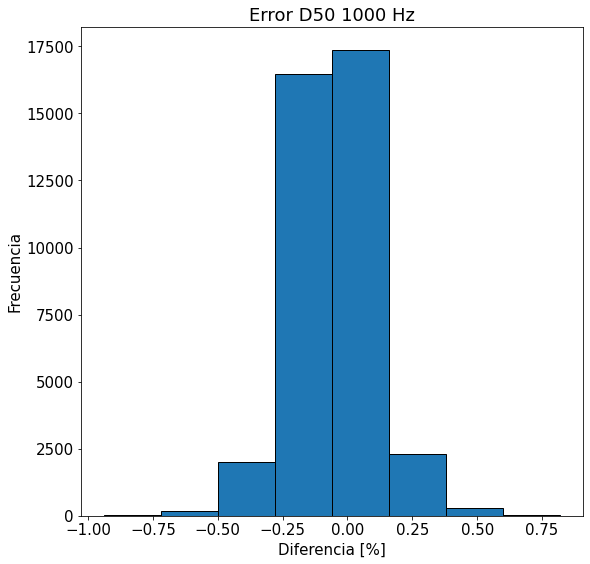

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

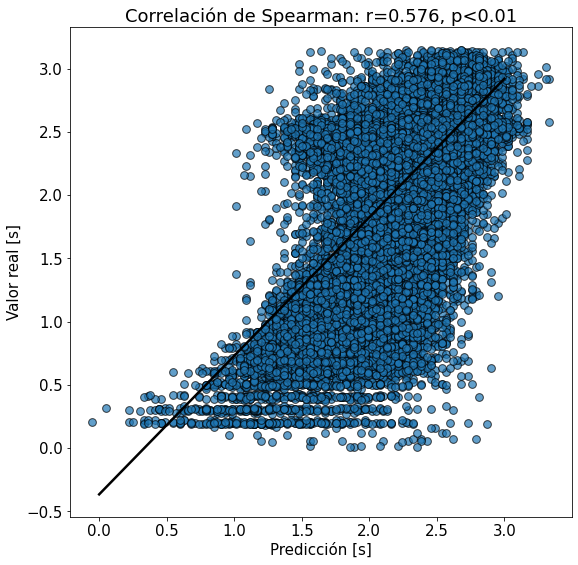

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

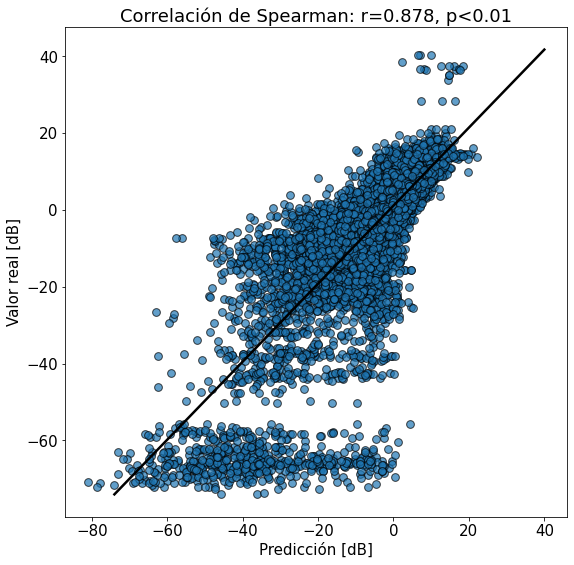

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

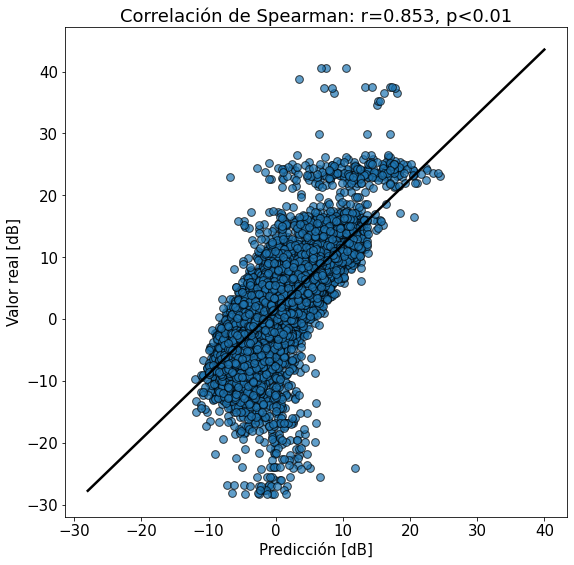

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

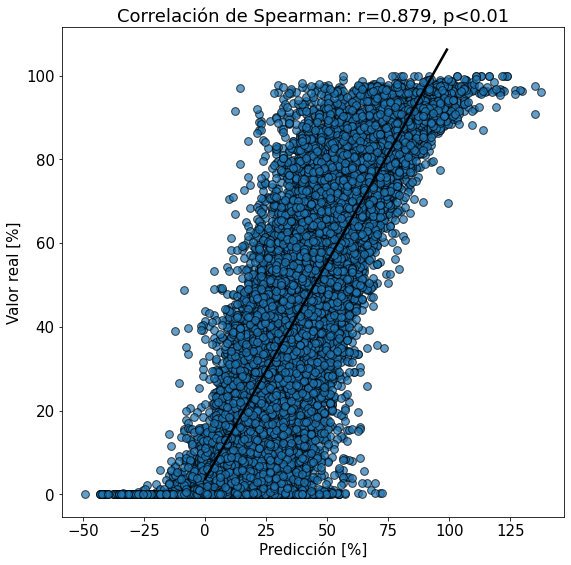

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

2000 Hz

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE con ruido')

band = 2000

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-7.970324923800044
2.3733376538814372


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

2.6319331967287463
9.348345410975046
10.804823883449954
89.59055261587143


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.09594434226675805
Máximo y_train: 2.3733376538814372
Mínimo y_train: -7.970324923800044


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
136/136 [==============================] - 3s 14ms/step - loss: 0.6168 - val_loss: 0.5344
Epoch 2/500
136/136 [==============================] - 2s 12ms/step - loss: 0.3557 - val_loss: 0.4263
Epoch 3/500
136/136 [==============================] - 2s 13ms/step - loss: 0.3077 - val_loss: 0.3542
Epoch 4/500
136/136 [==============================] - 2s 12ms/step - loss: 0.2801 - val_loss: 0.3039
Epoch 5/500
136/136 [==============================] - 2s 13ms/step - loss: 0.2613 - val_loss: 0.2615
Epoch 6/500
136/136 [==============================] - 2s 12ms/step - loss: 0.2487 - val_loss: 0.2338
Epoch 7/500
136/136 [==============================] - 2s 13ms/step - loss: 0.2394 - val_loss: 0.2294
Epoch 8/500
136/136 [==============================] - 2s 13ms/step - loss: 0.2313 - val_loss: 0.2234
Epoch 9/500
136/136 [==============================] - 2s 13ms/step - loss: 0.2250 - val_loss: 0.2076
Epoch 10/500
136/136 [==============================] - 2s 12ms/step - loss: 0.219

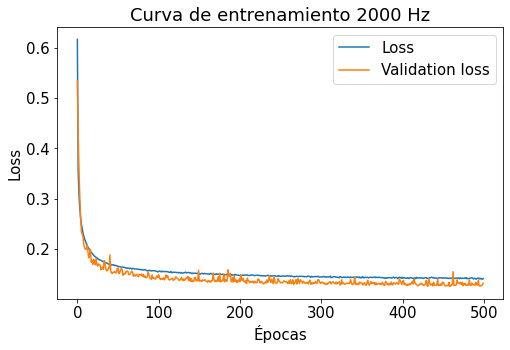

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([   76.,  1686., 15690., 12290.,  5642.,  2811.,   442.,    23.]),
 array([-0.66   , -0.46875, -0.2775 , -0.08625,  0.105  ,  0.29625,
         0.4875 ,  0.67875,  0.87   ]),
 <a list of 8 Patch objects>)

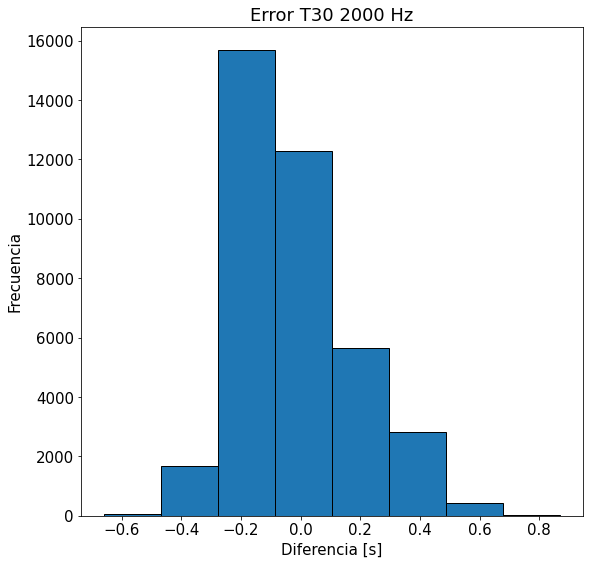

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([4.0000e+00, 1.5200e+02, 1.9555e+04, 1.8358e+04, 3.0000e+02,
        1.6900e+02, 9.4000e+01, 2.8000e+01]),
 array([-4.97  , -3.2875, -1.605 ,  0.0775,  1.76  ,  3.4425,  5.125 ,
         6.8075,  8.49  ]),
 <a list of 8 Patch objects>)

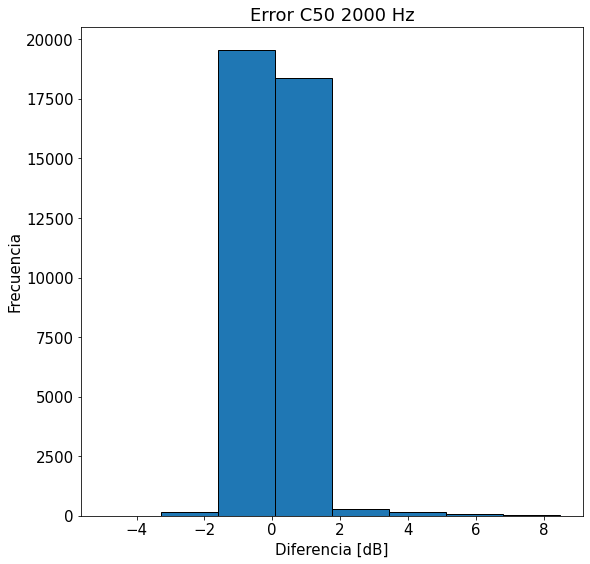

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([2.9000e+01, 9.3000e+01, 2.5200e+03, 3.2561e+04, 3.1210e+03,
        2.2900e+02, 8.1000e+01, 2.6000e+01]),
 array([-2.09   , -1.47625, -0.8625 , -0.24875,  0.365  ,  0.97875,
         1.5925 ,  2.20625,  2.82   ]),
 <a list of 8 Patch objects>)

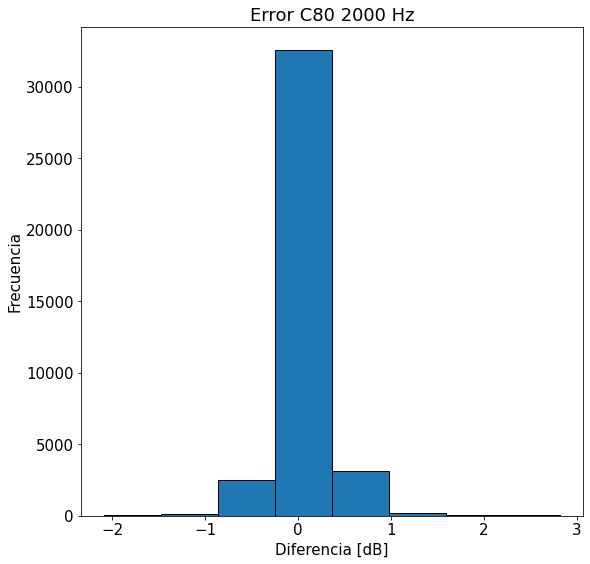

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([1.1300e+02, 1.0700e+03, 7.1210e+03, 2.3392e+04, 5.7410e+03,
        1.0090e+03, 1.9700e+02, 1.7000e+01]),
 array([-0.65   , -0.44875, -0.2475 , -0.04625,  0.155  ,  0.35625,
         0.5575 ,  0.75875,  0.96   ]),
 <a list of 8 Patch objects>)

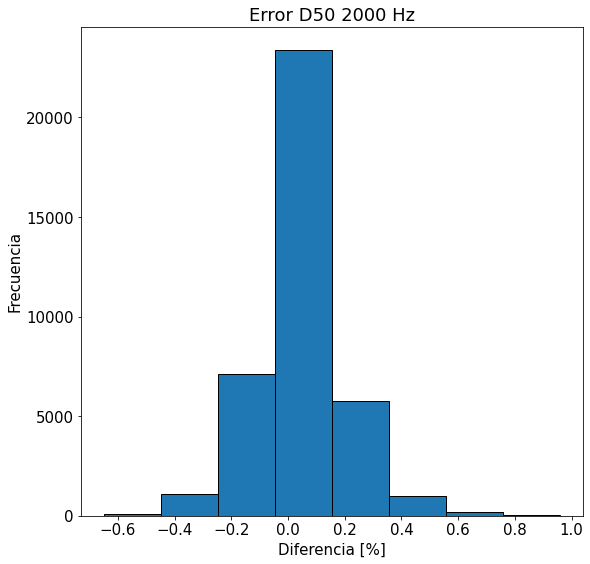

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

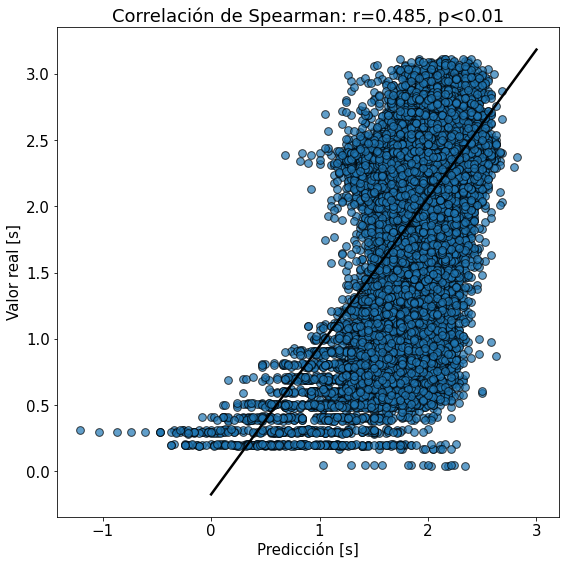

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

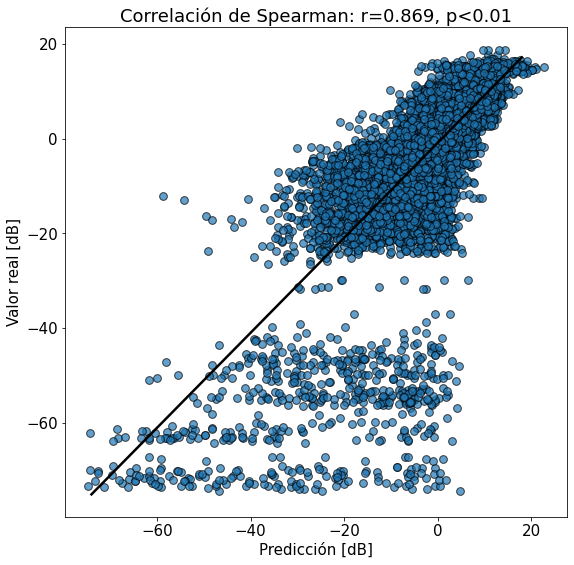

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

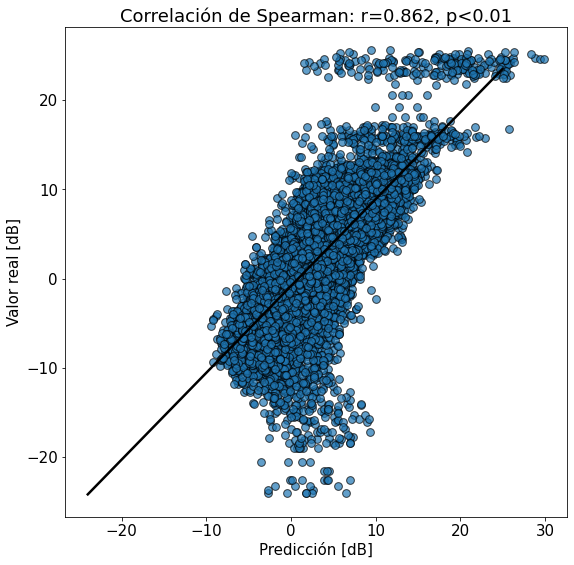

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

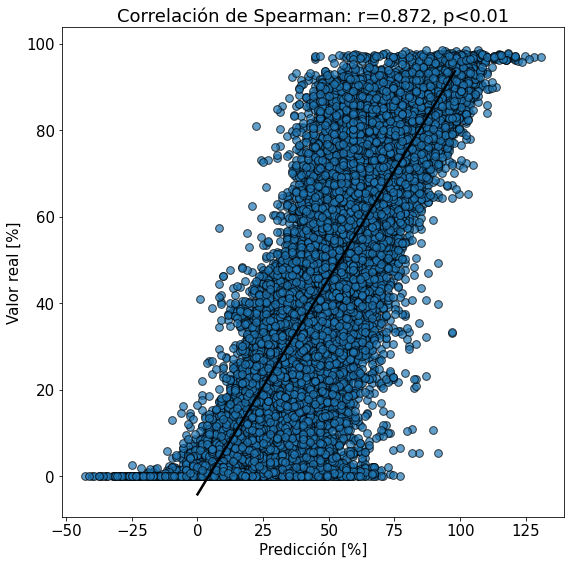

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

4000 Hz

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE con ruido')

band = 4000

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-6.824801785028173
2.0347961885151857


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

2.4081225952401293
11.115743682982714
12.452086884420964
92.82087845794149


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.10855698445501018
Máximo y_train: 2.0347961885151857
Mínimo y_train: -6.824801785028173


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
136/136 [==============================] - 3s 15ms/step - loss: 0.4656 - val_loss: 0.3588
Epoch 2/500
136/136 [==============================] - 2s 13ms/step - loss: 0.2280 - val_loss: 0.2955
Epoch 3/500
136/136 [==============================] - 2s 13ms/step - loss: 0.1947 - val_loss: 0.2567
Epoch 4/500
136/136 [==============================] - 2s 13ms/step - loss: 0.1772 - val_loss: 0.2128
Epoch 5/500
136/136 [==============================] - 2s 13ms/step - loss: 0.1643 - val_loss: 0.1698
Epoch 6/500
136/136 [==============================] - 2s 13ms/step - loss: 0.1543 - val_loss: 0.1463
Epoch 7/500
136/136 [==============================] - 2s 12ms/step - loss: 0.1465 - val_loss: 0.1318
Epoch 8/500
136/136 [==============================] - 2s 12ms/step - loss: 0.1399 - val_loss: 0.1233
Epoch 9/500
136/136 [==============================] - 2s 13ms/step - loss: 0.1344 - val_loss: 0.1204
Epoch 10/500
136/136 [==============================] - 2s 13ms/step - loss: 0.130

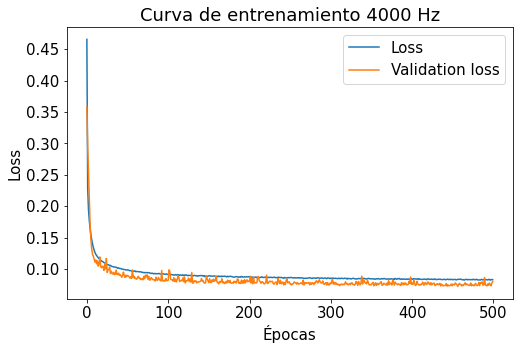

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([   53.,   602.,  5339., 18984.,  8860.,  3967.,   803.,    52.]),
 array([-0.61   , -0.43375, -0.2575 , -0.08125,  0.095  ,  0.27125,
         0.4475 ,  0.62375,  0.8    ]),
 <a list of 8 Patch objects>)

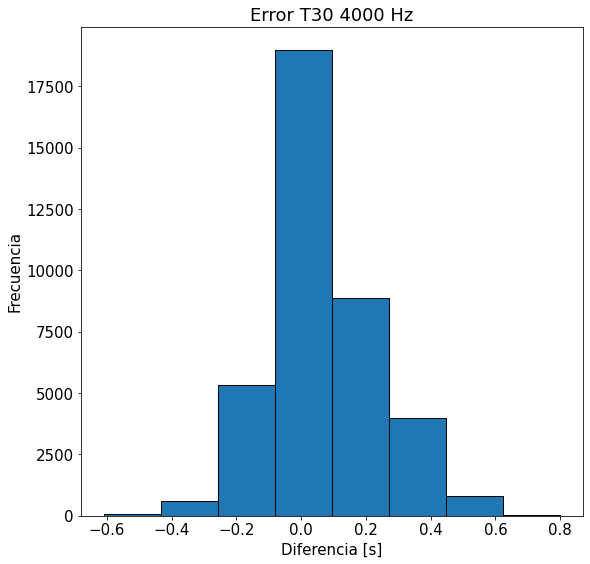

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([5.0000e+00, 1.0600e+02, 1.8420e+03, 3.5955e+04, 5.1000e+02,
        1.5100e+02, 6.9000e+01, 2.2000e+01]),
 array([-5.03  , -3.5725, -2.115 , -0.6575,  0.8   ,  2.2575,  3.715 ,
         5.1725,  6.63  ]),
 <a list of 8 Patch objects>)

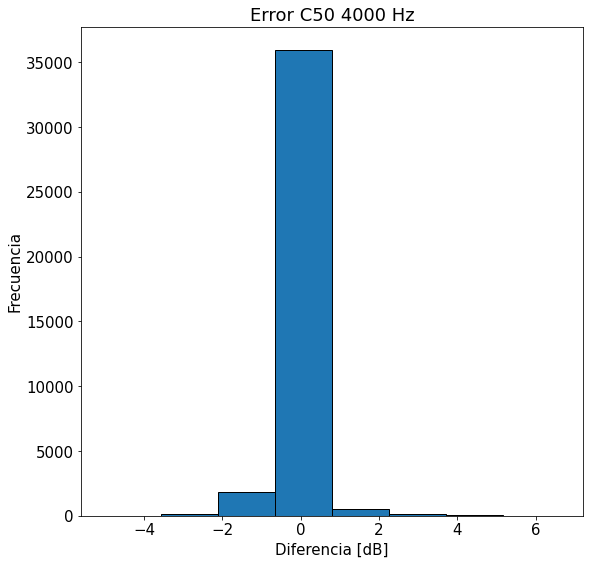

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([2.2000e+01, 5.4000e+01, 9.2500e+02, 2.4275e+04, 1.2885e+04,
        3.9400e+02, 8.3000e+01, 2.2000e+01]),
 array([-2.03   , -1.52625, -1.0225 , -0.51875, -0.015  ,  0.48875,
         0.9925 ,  1.49625,  2.     ]),
 <a list of 8 Patch objects>)

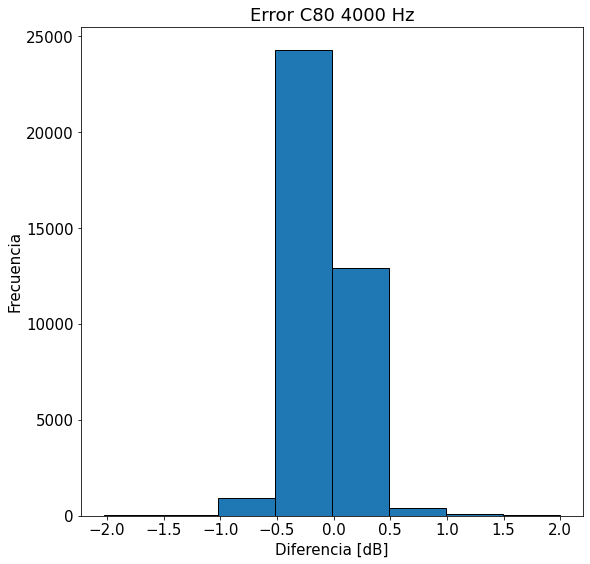

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([6.0000e+00, 1.5200e+02, 2.0830e+03, 2.3535e+04, 1.1807e+04,
        9.2200e+02, 1.4700e+02, 8.0000e+00]),
 array([-0.97   , -0.72875, -0.4875 , -0.24625, -0.005  ,  0.23625,
         0.4775 ,  0.71875,  0.96   ]),
 <a list of 8 Patch objects>)

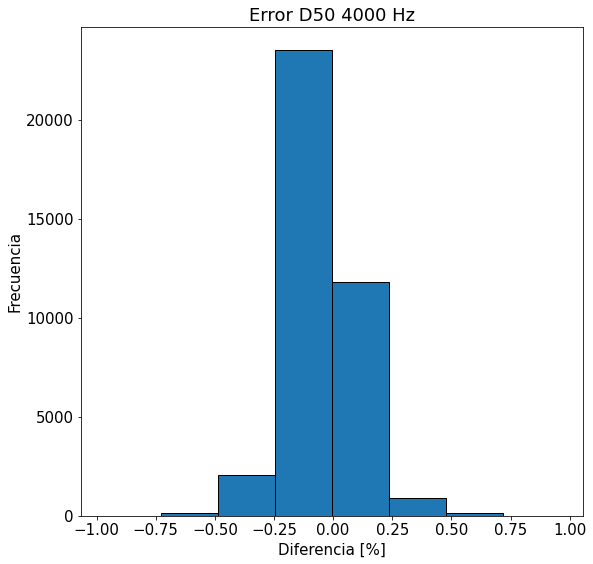

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

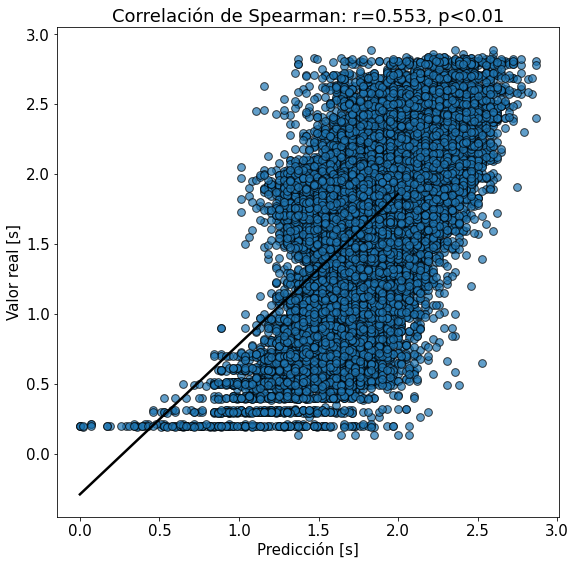

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

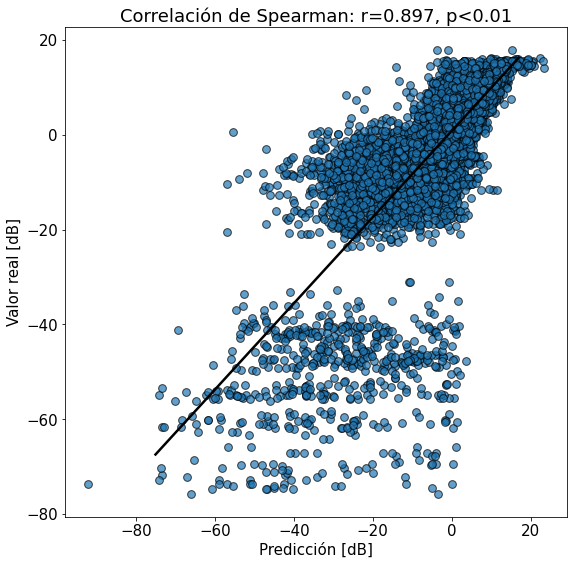

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

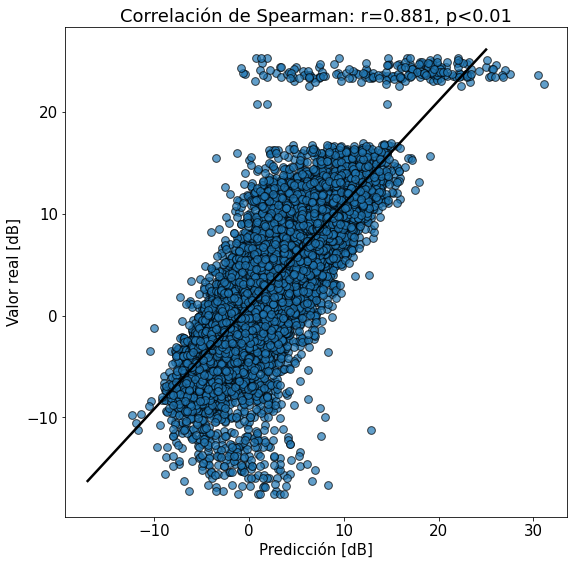

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

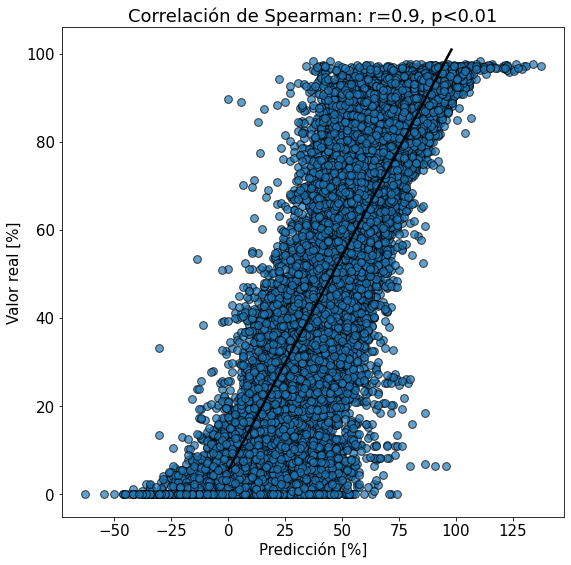

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

8000 Hz

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE con ruido')

band = 8000

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-5.43790081179957
1.9304881697235845


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

2.3880844774815806
11.887504200040834
13.17665504955691
93.91863129562579


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.1489243031899763
Máximo y_train: 1.9304881697235845
Mínimo y_train: -5.43790081179957


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
136/136 [==============================] - 5s 23ms/step - loss: 0.4717 - val_loss: 0.2188
Epoch 2/500
136/136 [==============================] - 2s 16ms/step - loss: 0.1968 - val_loss: 0.1806
Epoch 3/500
136/136 [==============================] - 2s 16ms/step - loss: 0.1618 - val_loss: 0.1712
Epoch 4/500
136/136 [==============================] - 2s 16ms/step - loss: 0.1425 - val_loss: 0.1495
Epoch 5/500
136/136 [==============================] - 2s 16ms/step - loss: 0.1300 - val_loss: 0.1247
Epoch 6/500
136/136 [==============================] - 2s 16ms/step - loss: 0.1208 - val_loss: 0.1074
Epoch 7/500
136/136 [==============================] - 2s 15ms/step - loss: 0.1138 - val_loss: 0.0987
Epoch 8/500
136/136 [==============================] - 2s 16ms/step - loss: 0.1079 - val_loss: 0.0929
Epoch 9/500
136/136 [==============================] - 2s 16ms/step - loss: 0.1033 - val_loss: 0.0891
Epoch 10/500
136/136 [==============================] - 2s 15ms/step - loss: 0.099

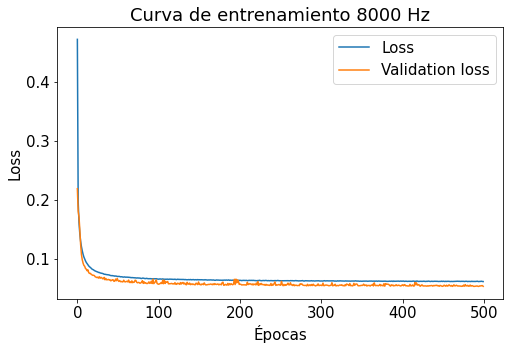

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([  129.,  1102.,  8993., 17873.,  7215.,  2925.,   391.,    32.]),
 array([-0.6 , -0.43, -0.26, -0.09,  0.08,  0.25,  0.42,  0.59,  0.76]),
 <a list of 8 Patch objects>)

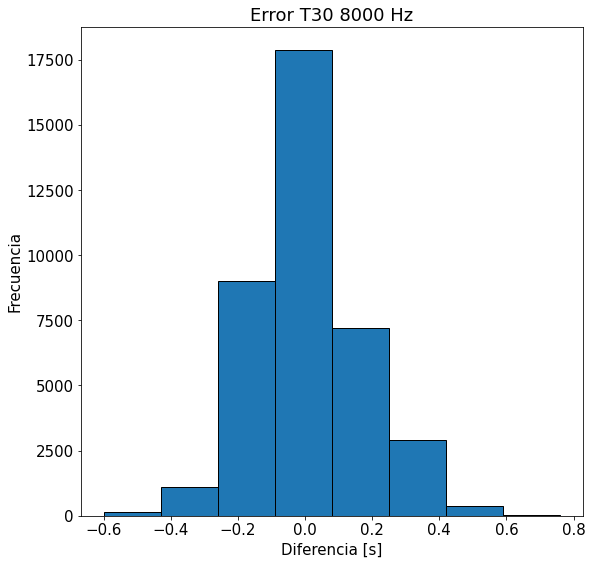

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([1.1000e+01, 3.4200e+02, 2.8428e+04, 9.3980e+03, 3.2200e+02,
        1.1300e+02, 3.4000e+01, 1.2000e+01]),
 array([-3.07  , -2.0075, -0.945 ,  0.1175,  1.18  ,  2.2425,  3.305 ,
         4.3675,  5.43  ]),
 <a list of 8 Patch objects>)

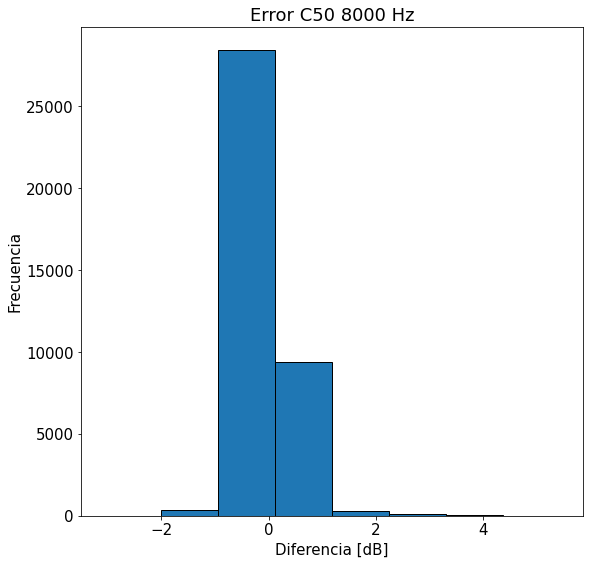

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([2.5000e+01, 1.1700e+02, 1.5890e+03, 2.8289e+04, 8.3180e+03,
        2.3500e+02, 7.5000e+01, 1.2000e+01]),
 array([-1.69 , -1.235, -0.78 , -0.325,  0.13 ,  0.585,  1.04 ,  1.495,
         1.95 ]),
 <a list of 8 Patch objects>)

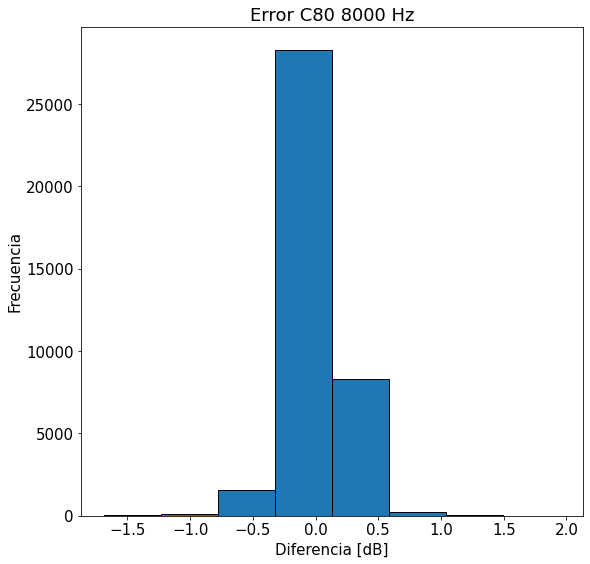

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([9.0000e+00, 5.0000e+01, 1.1140e+03, 1.4453e+04, 2.1296e+04,
        1.5430e+03, 1.8000e+02, 1.5000e+01]),
 array([-1.02   , -0.77125, -0.5225 , -0.27375, -0.025  ,  0.22375,
         0.4725 ,  0.72125,  0.97   ]),
 <a list of 8 Patch objects>)

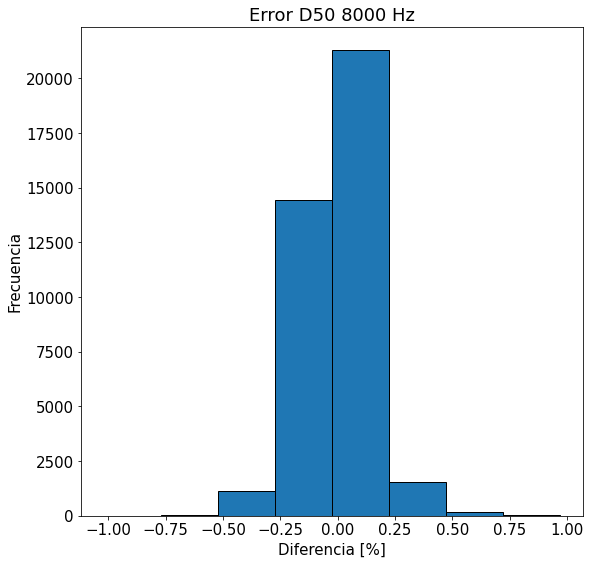

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

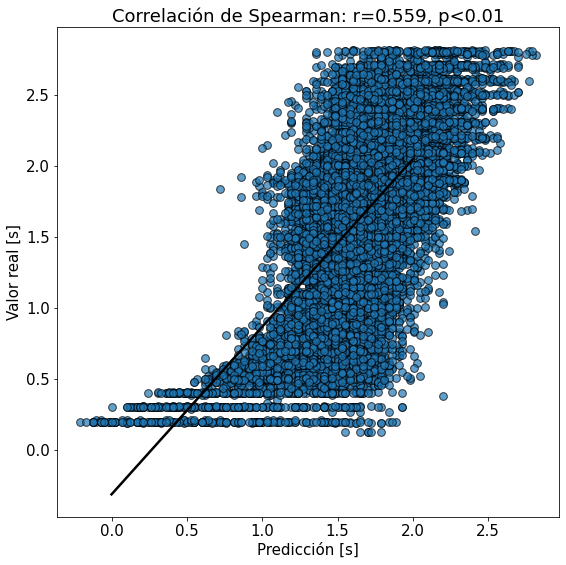

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

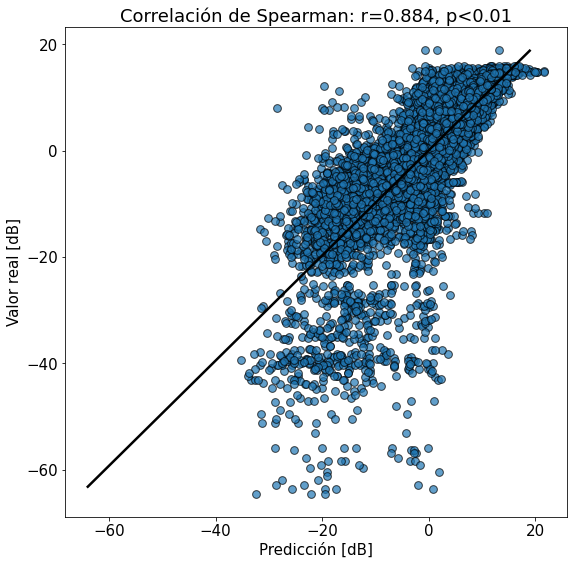

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

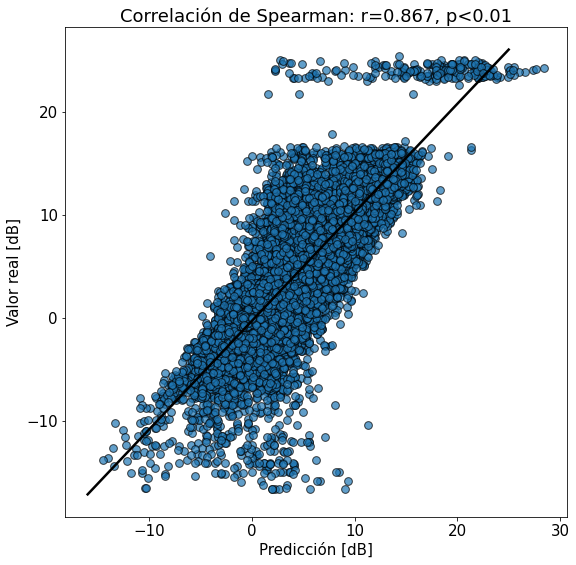

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

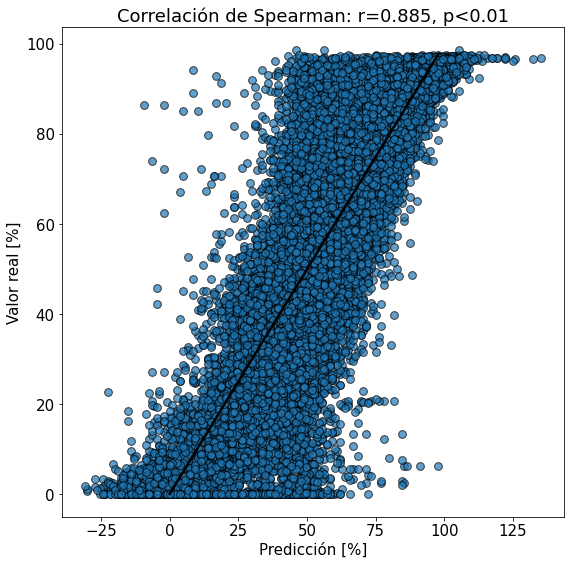

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

# Entrenamiento RIRs reales y valores normalizados: Tr entre 1 y 1.5 [s]

En este caso, además de normalizar todo con el percentil 95, paso todos los valores a su escala sin dB ni %

In [ ]:
#Librerías necesarias:
import sys 
sys.path.append('/content/drive/My Drive/Tesis/Notebooks/scripts')
from model_2 import modelo
from scipy import stats

import numpy as np
import os
from librosa import load
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

!pip install pickle5
import pickle5 as pickle
import matplotlib.pyplot as plt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


Outliers:

In [ ]:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE sinteticos y reales')
with open('outliers_1_1.5.pickle', 'rb') as handle:
  outliers = list(set(pickle.load(handle)))

125 Hz:

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE sinteticos y reales')

band = 125

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

In [ ]:
print(list(tae_dic.keys())[10000])
print(list(params_dic.keys())[10000])

F1s3-Xx01y01_1.2s
F1s3-sintetica_Seed2295707925_Tr0.2


In [ ]:
print(len(list(tae_dic.keys())))
print(len(list(params_dic.keys())))

216940
216940


In [ ]:
print(list(tae_dic.keys())[0:5])
print(list(params_dic.keys())[0:5])

['F1s3-sintetica_Seed1000489356_Tr0.8', 'F1s3-sintetica_Seed1001447394_Tr1.0', 'F1s3-sintetica_Seed1001731511_Tr0.3', 'F1s3-sintetica_Seed1002861871_Tr1.2', 'F1s3-sintetica_Seed100337391_Tr0.8']
['F1s3-sintetica_Seed1000489356_Tr0.8', 'F2s3-sintetica_Seed1000489356_Tr0.8', 'F3s3-sintetica_Seed1000489356_Tr0.8', 'F4s3-sintetica_Seed1000489356_Tr0.8', 'F5s3-sintetica_Seed1000489356_Tr0.8']


In [ ]:
print(params_dic['F1s3-sintetica_Seed1807110498_Tr3.0'])

[3.3177340165539593, -7.817570784307723, -3.0913787381216657, 14.184349409610135]


In [ ]:
#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

In [ ]:
#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
print(len(y))

18290


In [ ]:
#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-30.248998011387723
7.320084453228062


In [ ]:
print(T30_perc_95) 
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

1.555999341902073
1.9532003261867743
3.98622189074735
61.05776515374002


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
print(X_train.shape)
print(y_train.shape)

(14632, 200, 1)
(14632, 4, 1)


In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.14783391140718255


In [ ]:
assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo y_train: 7.320084453228062
Mínimo y_train: -30.248998011387723


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
13/13 [==============================] - 17s 132ms/step - loss: 16.9408 - val_loss: 18.2488
Epoch 2/500
13/13 [==============================] - 0s 17ms/step - loss: 14.6988 - val_loss: 17.5834
Epoch 3/500
13/13 [==============================] - 0s 16ms/step - loss: 13.0417 - val_loss: 16.7083
Epoch 4/500
13/13 [==============================] - 0s 16ms/step - loss: 11.7750 - val_loss: 15.7501
Epoch 5/500
13/13 [==============================] - 0s 16ms/step - loss: 10.9323 - val_loss: 15.0415
Epoch 6/500
13/13 [==============================] - 0s 16ms/step - loss: 10.4601 - val_loss: 14.6561
Epoch 7/500
13/13 [==============================] - 0s 16ms/step - loss: 10.0702 - val_loss: 14.4560
Epoch 8/500
13/13 [==============================] - 0s 18ms/step - loss: 9.7677 - val_loss: 14.3411
Epoch 9/500
13/13 [==============================] - 0s 16ms/step - loss: 9.4696 - val_loss: 14.2355
Epoch 10/500
13/13 [==============================] - 0s 17ms/step - loss: 9.2672 

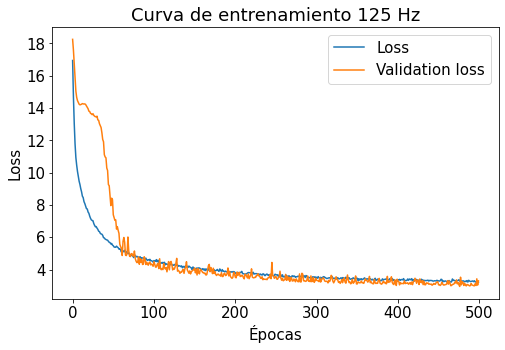

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
blind_estimation_model.predict(X_test[5,:,0].reshape(1,-1,1))[0]

array([ 0.8217931 , -1.5491089 , -0.3667574 ,  0.44485778], dtype=float32)

In [ ]:
np.round(y_test[0,:,0].reshape(1,-1,1),1)

array([[[ 0.7],
        [-2.4],
        [-0.4],
        [ 0.4]]])

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
prediction[0]

array([ 0.8 , -4.58, -0.67,  0.35], dtype=float32)

In [ ]:
np.round(prediction[1] - np.round(y_test[1,:,0].reshape(1,-1,1),2).flatten(),2)

array([0.02, 0.98, 0.24, 0.1 ])

In [ ]:
np.round(prediction[1][0] - np.round(y_test[1,:,0].reshape(1,-1,1),2).flatten()[0],2)

0.02

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([   6.,   16.,   55.,  214.,  902., 1445.,  892.,  128.]),
 array([-0.69   , -0.55875, -0.4275 , -0.29625, -0.165  , -0.03375,
         0.0975 ,  0.22875,  0.36   ]),
 <a list of 8 Patch objects>)

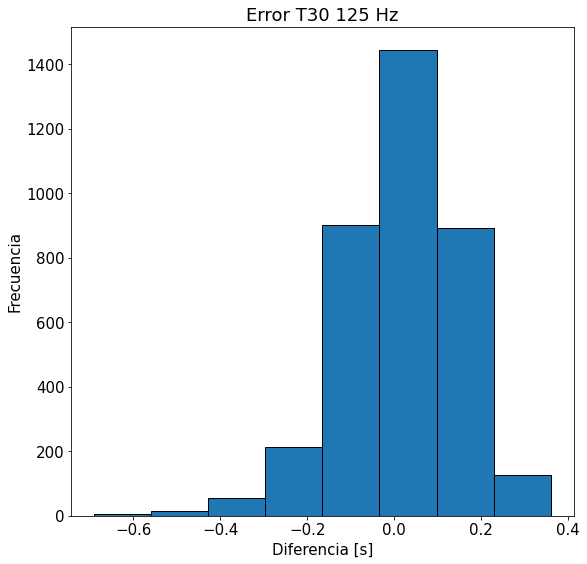

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([   7.,   65.,  483., 2409.,  520.,  130.,   38.,    6.]),
 array([-15.77  , -11.2075,  -6.645 ,  -2.0825,   2.48  ,   7.0425,
         11.605 ,  16.1675,  20.73  ]),
 <a list of 8 Patch objects>)

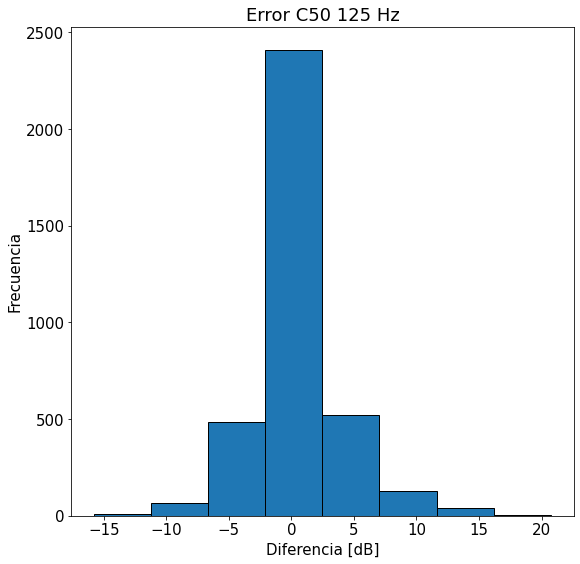

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([  56.,  505., 1608., 1097.,  270.,   95.,   19.,    8.]),
 array([-2.73, -1.78, -0.83,  0.12,  1.07,  2.02,  2.97,  3.92,  4.87]),
 <a list of 8 Patch objects>)

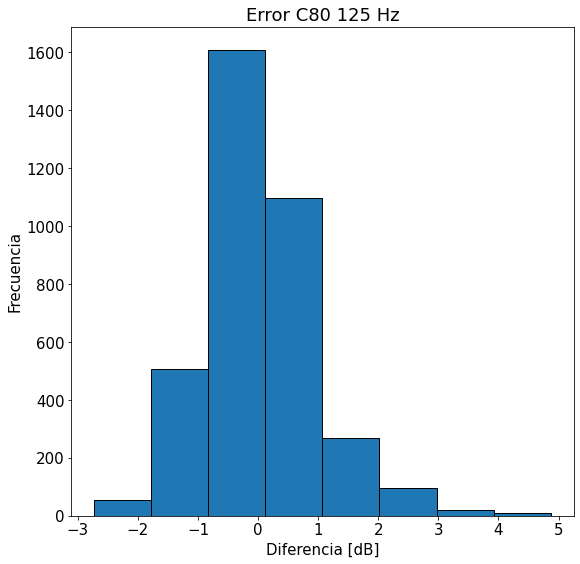

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([   3.,   43.,  196.,  489.,  796., 1325.,  734.,   72.]),
 array([-0.99, -0.8 , -0.61, -0.42, -0.23, -0.04,  0.15,  0.34,  0.53]),
 <a list of 8 Patch objects>)

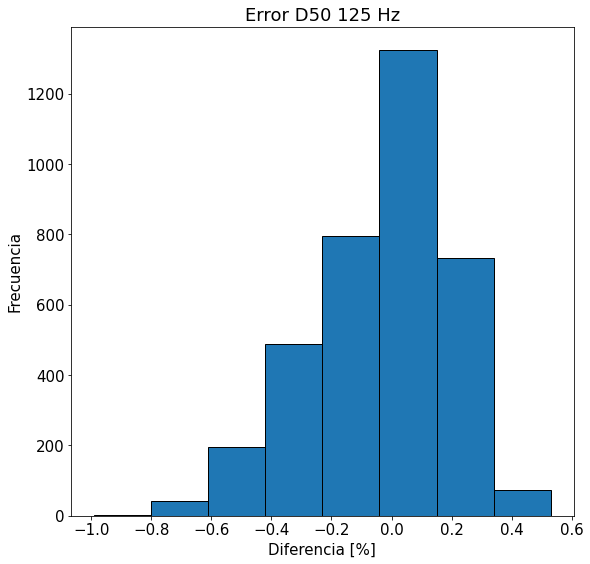

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

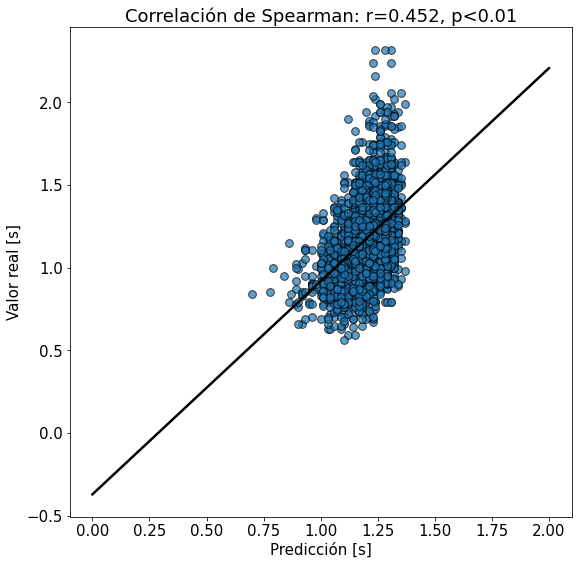

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

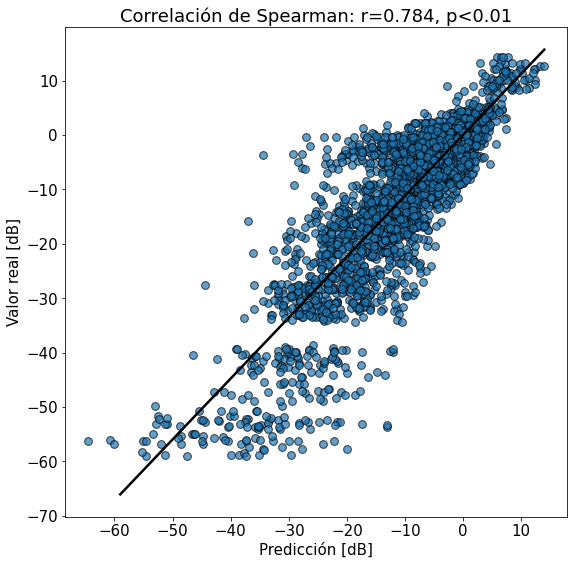

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

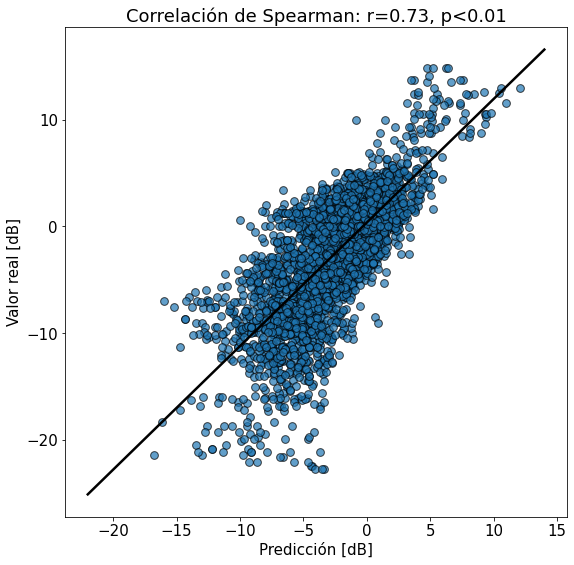

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

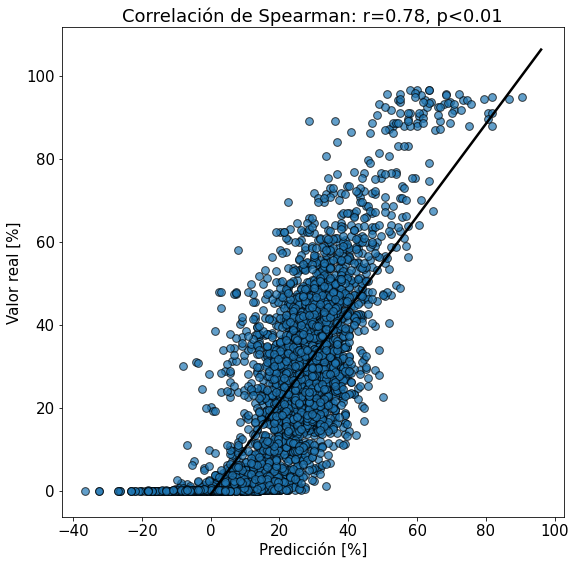

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

250 Hz:

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE sinteticos y reales')

band = 250

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-11.667861202158885
1.980210887842137


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

1.440991943939145
5.255139195885238
5.911950686366424
77.03061180561383


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.16446992518993542
Máximo y_train: 1.980210887842137
Mínimo y_train: -11.667861202158885


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
13/13 [==============================] - 2s 45ms/step - loss: 2.2593 - val_loss: 1.7940
Epoch 2/500
13/13 [==============================] - 0s 18ms/step - loss: 1.6907 - val_loss: 1.7738
Epoch 3/500
13/13 [==============================] - 0s 17ms/step - loss: 1.4972 - val_loss: 1.7290
Epoch 4/500
13/13 [==============================] - 0s 16ms/step - loss: 1.4061 - val_loss: 1.6536
Epoch 5/500
13/13 [==============================] - 0s 16ms/step - loss: 1.3446 - val_loss: 1.5986
Epoch 6/500
13/13 [==============================] - 0s 16ms/step - loss: 1.3011 - val_loss: 1.5663
Epoch 7/500
13/13 [==============================] - 0s 17ms/step - loss: 1.2649 - val_loss: 1.5365
Epoch 8/500
13/13 [==============================] - 0s 16ms/step - loss: 1.2289 - val_loss: 1.5124
Epoch 9/500
13/13 [==============================] - 0s 16ms/step - loss: 1.2007 - val_loss: 1.5102
Epoch 10/500
13/13 [==============================] - 0s 16ms/step - loss: 1.1615 - val_loss: 1.5012

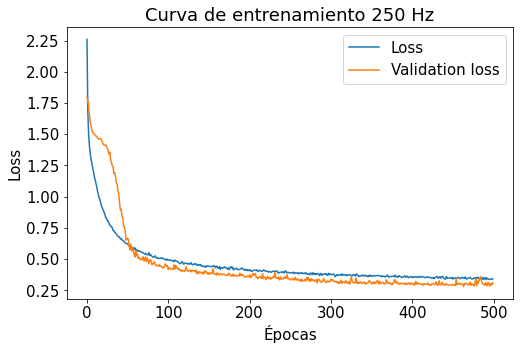

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([  28.,  143.,  450.,  752., 1038.,  857.,  343.,   47.]),
 array([-0.33  , -0.2525, -0.175 , -0.0975, -0.02  ,  0.0575,  0.135 ,
         0.2125,  0.29  ]),
 <a list of 8 Patch objects>)

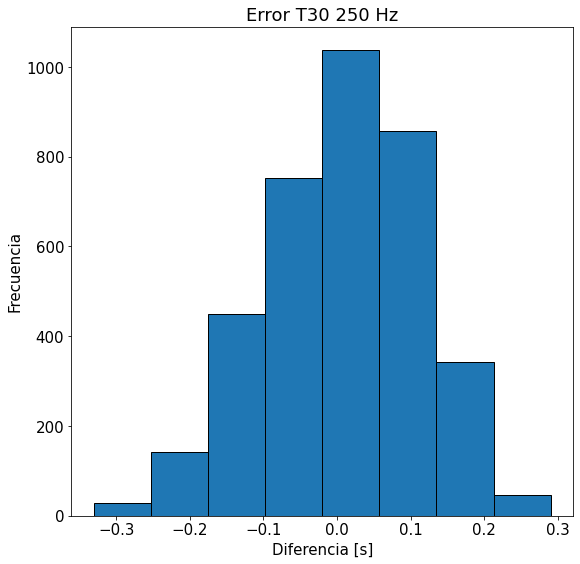

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([2.000e+00, 2.700e+01, 4.200e+02, 2.945e+03, 1.990e+02, 4.800e+01,
        1.600e+01, 1.000e+00]),
 array([-6.52  , -4.5575, -2.595 , -0.6325,  1.33  ,  3.2925,  5.255 ,
         7.2175,  9.18  ]),
 <a list of 8 Patch objects>)

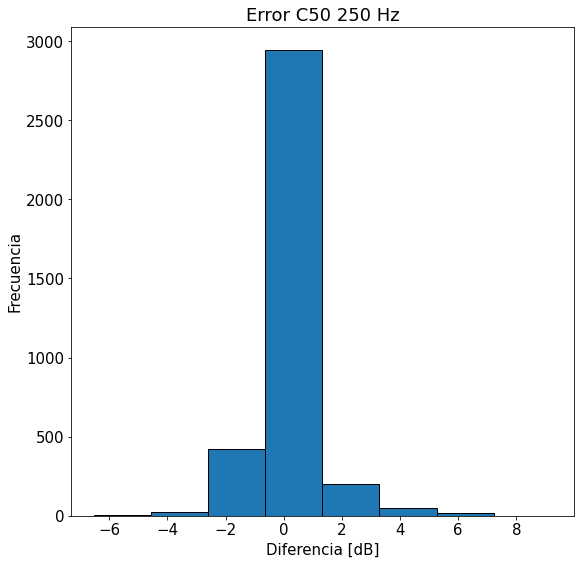

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([  14.,  135.,  577., 1704.,  966.,  189.,   53.,   20.]),
 array([-1.88   , -1.36375, -0.8475 , -0.33125,  0.185  ,  0.70125,
         1.2175 ,  1.73375,  2.25   ]),
 <a list of 8 Patch objects>)

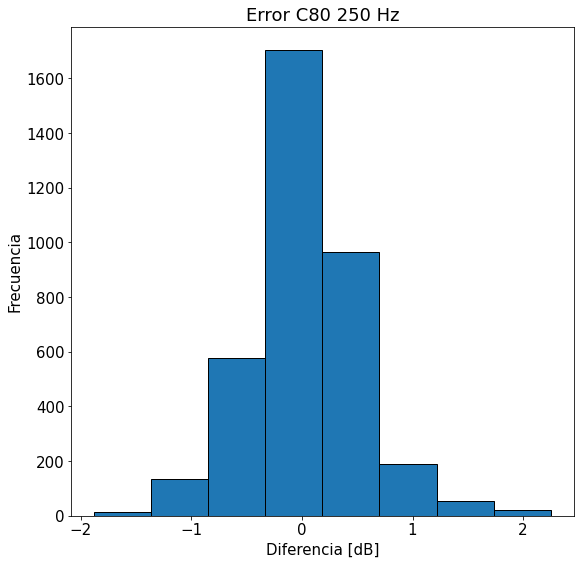

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([   4.,   33.,  167.,  801., 1326., 1000.,  299.,   28.]),
 array([-0.67   , -0.52375, -0.3775 , -0.23125, -0.085  ,  0.06125,
         0.2075 ,  0.35375,  0.5    ]),
 <a list of 8 Patch objects>)

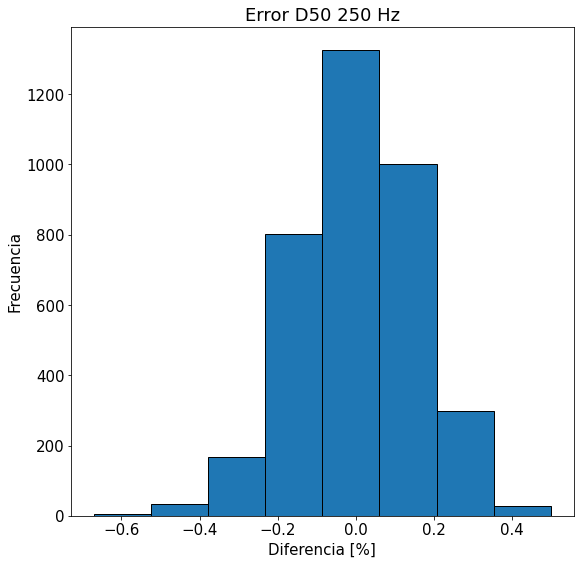

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

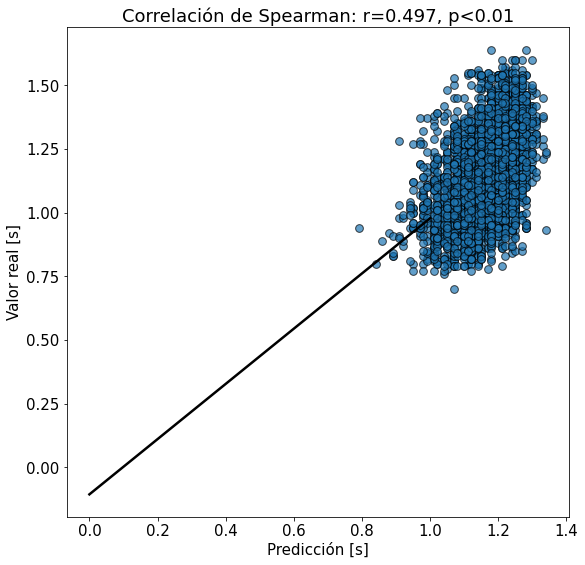

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

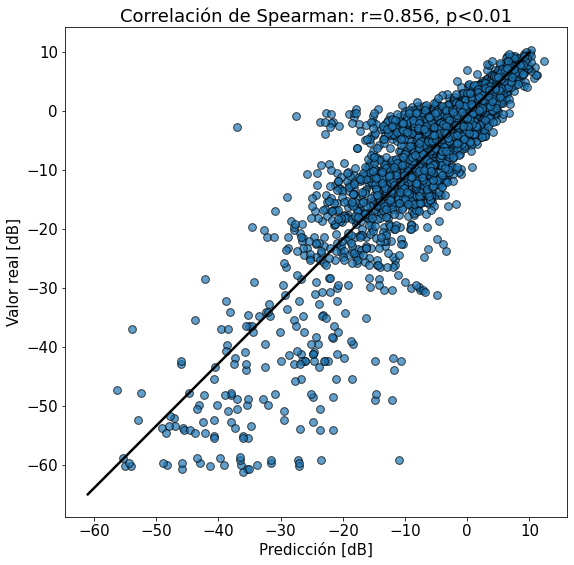

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

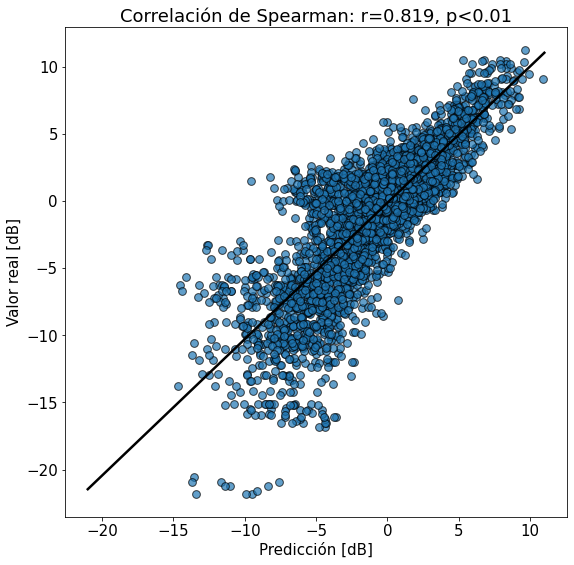

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

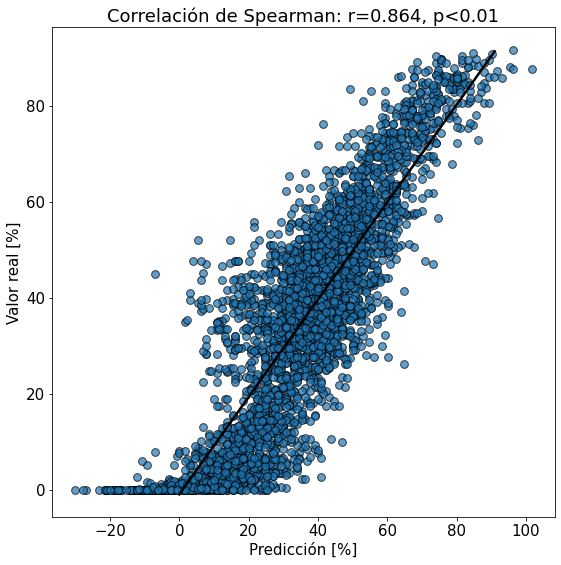

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

500 Hz

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE sinteticos y reales')

band = 500

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-11.348134306590609
3.8566455899283727


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

1.4595872868150725
5.757618368610926
6.514434790578267
79.01352110224263


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.11868529180605032
Máximo y_train: 3.8566455899283727
Mínimo y_train: -11.348134306590609


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
13/13 [==============================] - 2s 34ms/step - loss: 1.5702 - val_loss: 1.1480
Epoch 2/500
13/13 [==============================] - 0s 16ms/step - loss: 1.1470 - val_loss: 1.1029
Epoch 3/500
13/13 [==============================] - 0s 14ms/step - loss: 0.9998 - val_loss: 1.0680
Epoch 4/500
13/13 [==============================] - 0s 14ms/step - loss: 0.9236 - val_loss: 1.0294
Epoch 5/500
13/13 [==============================] - 0s 14ms/step - loss: 0.8750 - val_loss: 1.0029
Epoch 6/500
13/13 [==============================] - 0s 14ms/step - loss: 0.8360 - val_loss: 0.9824
Epoch 7/500
13/13 [==============================] - 0s 14ms/step - loss: 0.8005 - val_loss: 0.9674
Epoch 8/500
13/13 [==============================] - 0s 14ms/step - loss: 0.7755 - val_loss: 0.9502
Epoch 9/500
13/13 [==============================] - 0s 14ms/step - loss: 0.7580 - val_loss: 0.9435
Epoch 10/500
13/13 [==============================] - 0s 14ms/step - loss: 0.7331 - val_loss: 0.9283

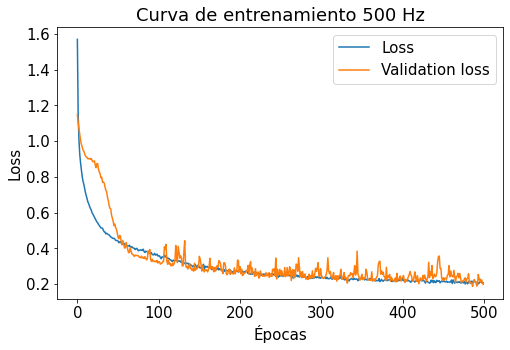

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([ 28., 215., 626., 876., 841., 721., 322.,  29.]),
 array([-0.29, -0.22, -0.15, -0.08, -0.01,  0.06,  0.13,  0.2 ,  0.27]),
 <a list of 8 Patch objects>)

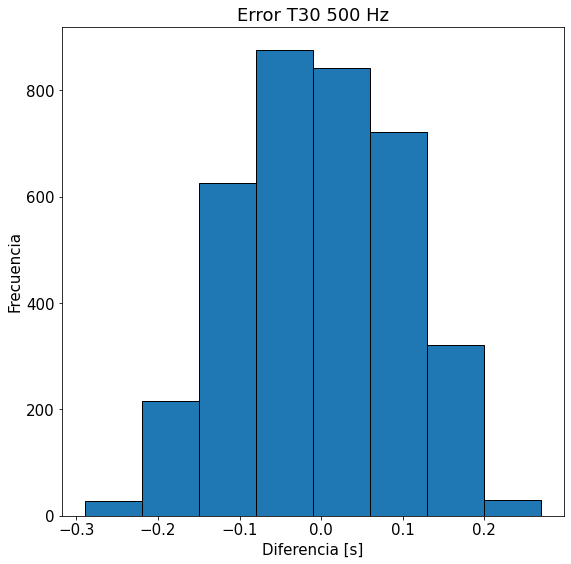

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([2.000e+00, 5.000e+00, 6.200e+01, 2.863e+03, 6.640e+02, 4.000e+01,
        1.200e+01, 1.000e+01]),
 array([-7.24, -5.33, -3.42, -1.51,  0.4 ,  2.31,  4.22,  6.13,  8.04]),
 <a list of 8 Patch objects>)

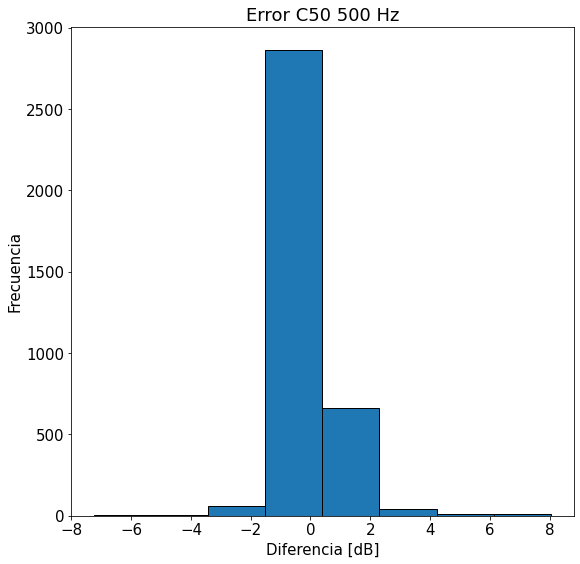

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([  11.,   86.,  584., 1986.,  826.,  129.,   24.,   12.]),
 array([-1.53   , -1.09375, -0.6575 , -0.22125,  0.215  ,  0.65125,
         1.0875 ,  1.52375,  1.96   ]),
 <a list of 8 Patch objects>)

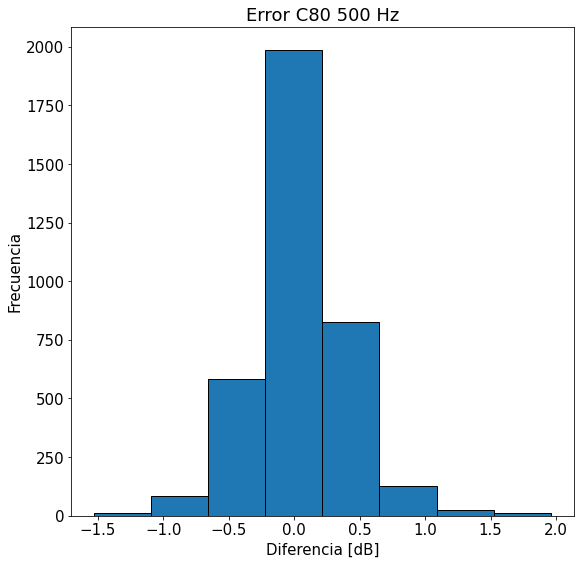

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([2.000e+00, 2.700e+01, 3.570e+02, 2.170e+03, 1.009e+03, 8.400e+01,
        7.000e+00, 2.000e+00]),
 array([-0.75   , -0.54375, -0.3375 , -0.13125,  0.075  ,  0.28125,
         0.4875 ,  0.69375,  0.9    ]),
 <a list of 8 Patch objects>)

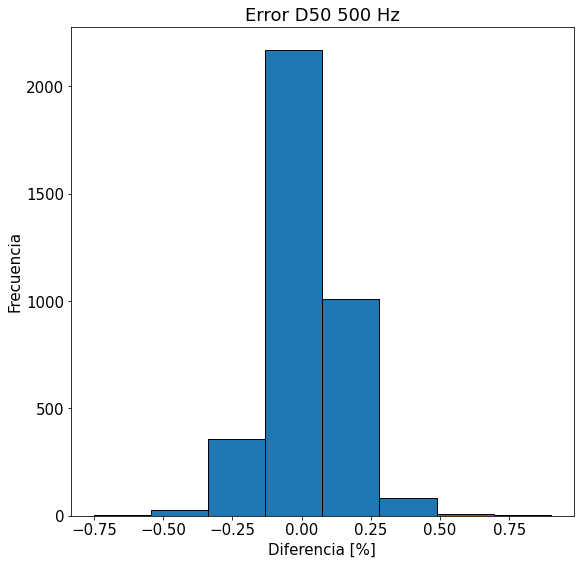

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

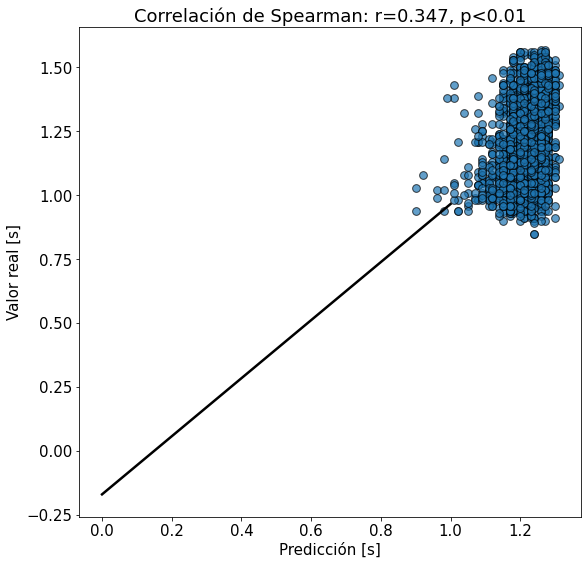

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

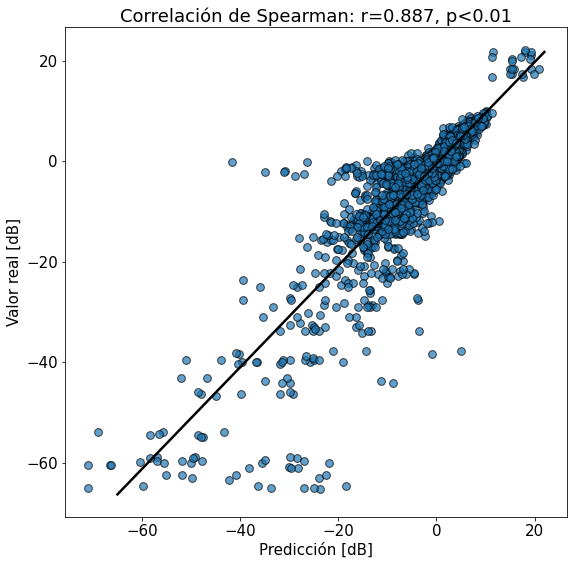

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

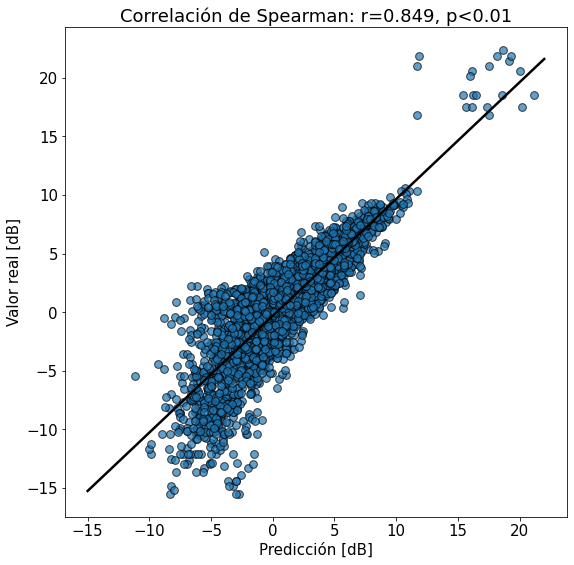

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

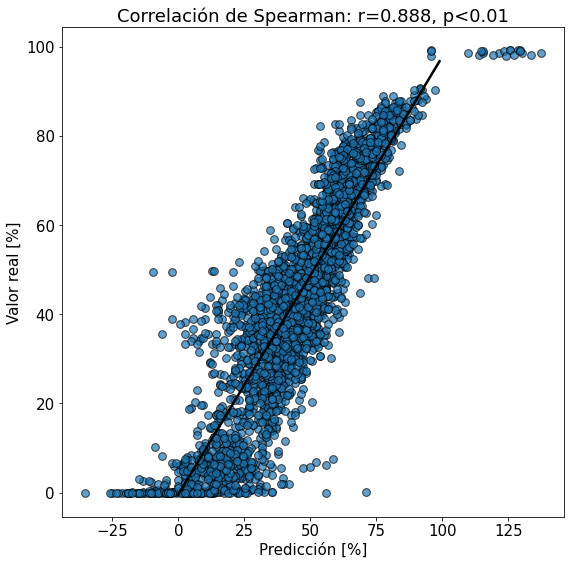

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

1000 Hz

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE sinteticos y reales')

band = 1000

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-9.86411285585978
2.761482878971006


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

1.4777293644501766
6.815156886158982
7.125478100278967
82.76763590749243


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.12059354338595124
Máximo y_train: 2.761482878971006
Mínimo y_train: -9.86411285585978


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
13/13 [==============================] - 2s 34ms/step - loss: 1.6792 - val_loss: 0.8506
Epoch 2/500
13/13 [==============================] - 0s 15ms/step - loss: 0.9490 - val_loss: 0.8087
Epoch 3/500
13/13 [==============================] - 0s 14ms/step - loss: 0.7650 - val_loss: 0.7677
Epoch 4/500
13/13 [==============================] - 0s 15ms/step - loss: 0.6856 - val_loss: 0.7424
Epoch 5/500
13/13 [==============================] - 0s 14ms/step - loss: 0.6491 - val_loss: 0.7216
Epoch 6/500
13/13 [==============================] - 0s 14ms/step - loss: 0.6238 - val_loss: 0.7049
Epoch 7/500
13/13 [==============================] - 0s 14ms/step - loss: 0.6046 - val_loss: 0.6912
Epoch 8/500
13/13 [==============================] - 0s 15ms/step - loss: 0.5891 - val_loss: 0.6830
Epoch 9/500
13/13 [==============================] - 0s 14ms/step - loss: 0.5748 - val_loss: 0.6773
Epoch 10/500
13/13 [==============================] - 0s 14ms/step - loss: 0.5650 - val_loss: 0.6705

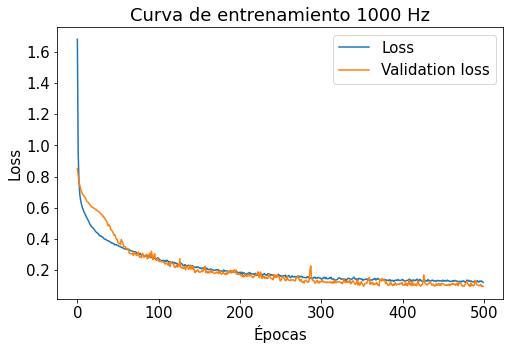

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([ 27., 303., 538., 749., 714., 606., 589., 132.]),
 array([-0.25   , -0.19375, -0.1375 , -0.08125, -0.025  ,  0.03125,
         0.0875 ,  0.14375,  0.2    ]),
 <a list of 8 Patch objects>)

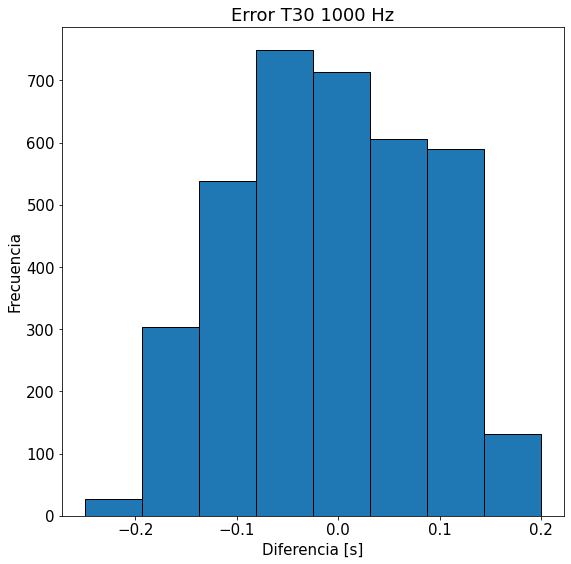

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([   4.,    6.,   93., 3147.,  345.,   43.,   14.,    6.]),
 array([-4.42  , -3.1975, -1.975 , -0.7525,  0.47  ,  1.6925,  2.915 ,
         4.1375,  5.36  ]),
 <a list of 8 Patch objects>)

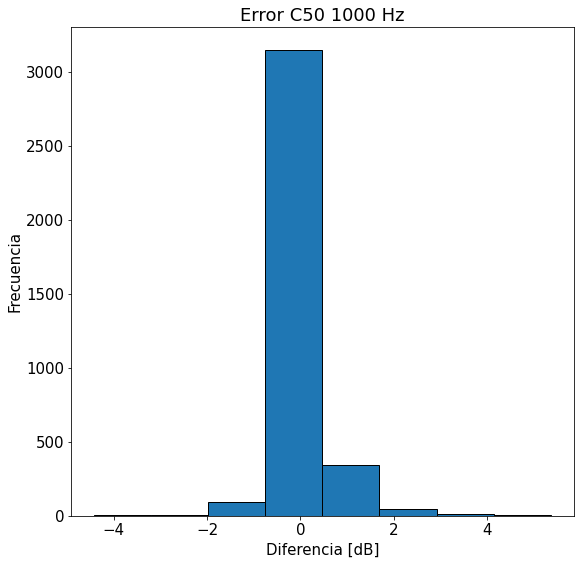

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([   3.,   28.,  291., 1127., 1561.,  500.,  100.,   48.]),
 array([-1.24 , -0.935, -0.63 , -0.325, -0.02 ,  0.285,  0.59 ,  0.895,
         1.2  ]),
 <a list of 8 Patch objects>)

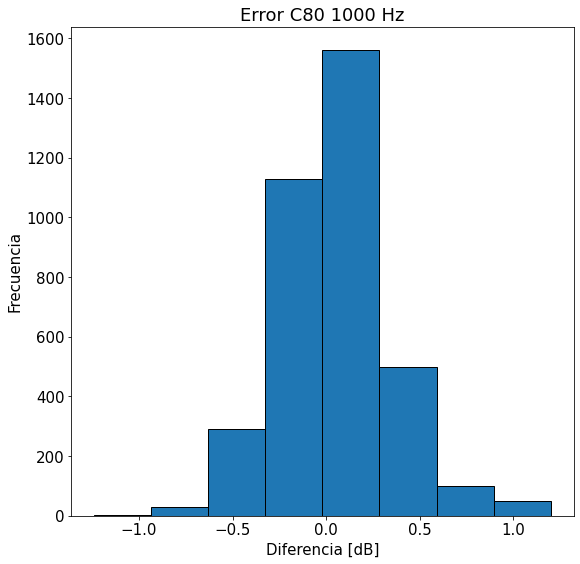

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([1.000e+00, 9.000e+00, 1.140e+02, 1.011e+03, 1.716e+03, 6.780e+02,
        1.180e+02, 1.100e+01]),
 array([-0.63  , -0.4825, -0.335 , -0.1875, -0.04  ,  0.1075,  0.255 ,
         0.4025,  0.55  ]),
 <a list of 8 Patch objects>)

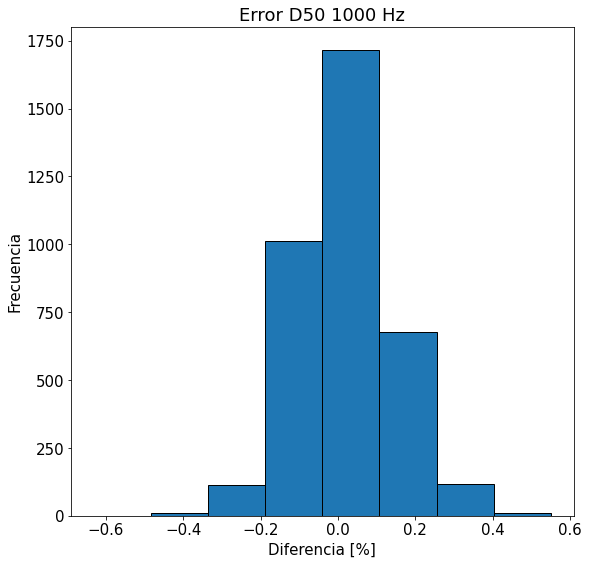

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

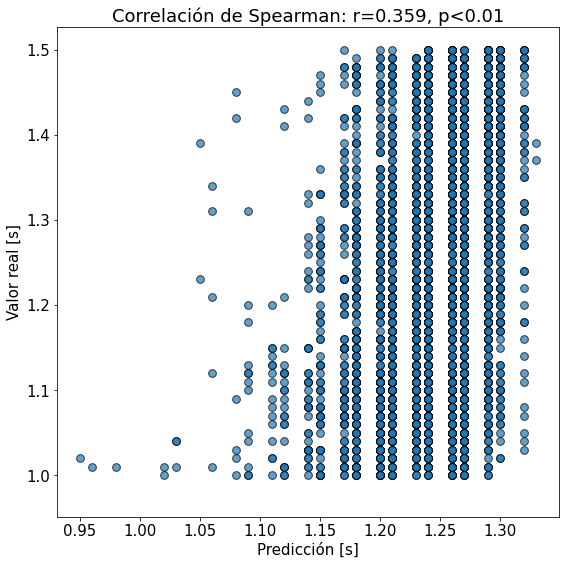

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

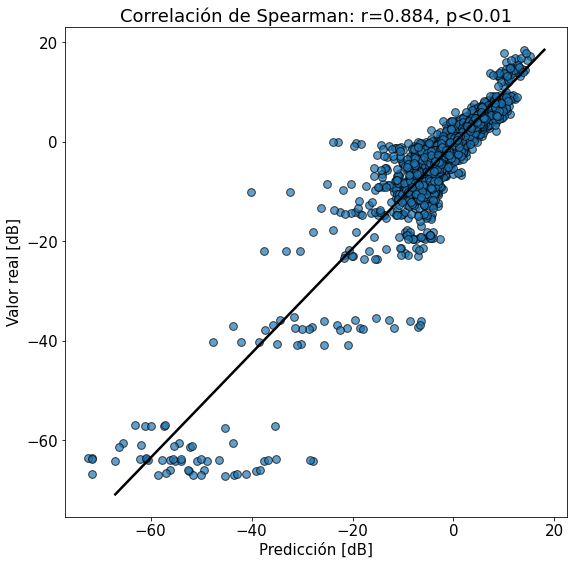

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

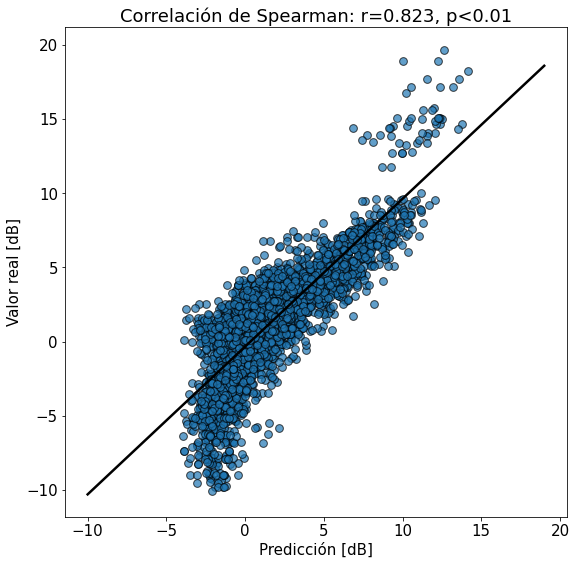

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

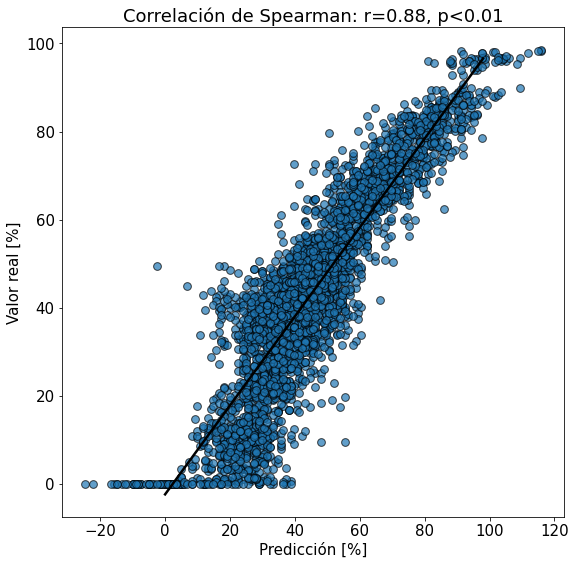

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

2000 Hz

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE sinteticos y reales')

band = 2000

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-12.835900606481445
2.8821536781103543


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

1.4063166220670762
5.562196411168992
6.256652415332454
78.25762341181859


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.08582047785387037
Máximo y_train: 2.8821536781103543
Mínimo y_train: -12.835900606481445


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
13/13 [==============================] - 2s 34ms/step - loss: 1.2365 - val_loss: 0.8522
Epoch 2/500
13/13 [==============================] - 0s 18ms/step - loss: 0.8387 - val_loss: 0.7495
Epoch 3/500
13/13 [==============================] - 0s 15ms/step - loss: 0.7080 - val_loss: 0.6926
Epoch 4/500
13/13 [==============================] - 0s 14ms/step - loss: 0.6438 - val_loss: 0.6628
Epoch 5/500
13/13 [==============================] - 0s 15ms/step - loss: 0.6050 - val_loss: 0.6450
Epoch 6/500
13/13 [==============================] - 0s 15ms/step - loss: 0.5790 - val_loss: 0.6377
Epoch 7/500
13/13 [==============================] - 0s 14ms/step - loss: 0.5539 - val_loss: 0.6328
Epoch 8/500
13/13 [==============================] - 0s 14ms/step - loss: 0.5316 - val_loss: 0.6336
Epoch 9/500
13/13 [==============================] - 0s 14ms/step - loss: 0.5152 - val_loss: 0.6356
Epoch 10/500
13/13 [==============================] - 0s 14ms/step - loss: 0.4965 - val_loss: 0.6382

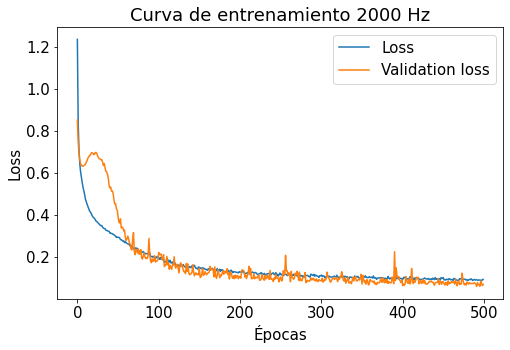

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([ 36., 230., 665., 726., 797., 808., 337.,  59.]),
 array([-0.28   , -0.21625, -0.1525 , -0.08875, -0.025  ,  0.03875,
         0.1025 ,  0.16625,  0.23   ]),
 <a list of 8 Patch objects>)

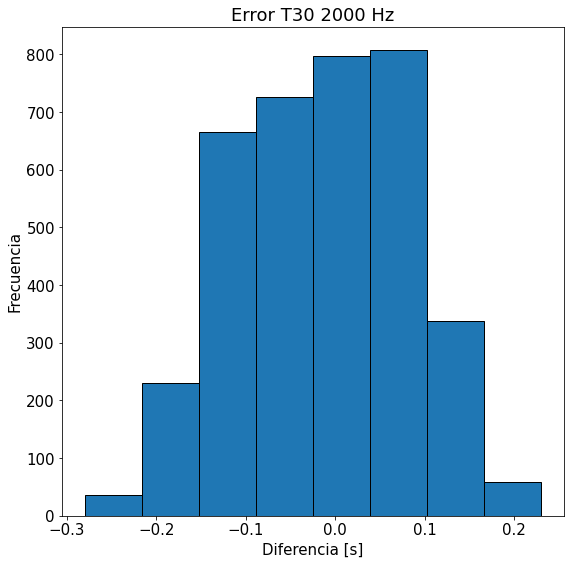

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([2.000e+00, 1.500e+01, 1.780e+02, 3.301e+03, 1.250e+02, 2.900e+01,
        5.000e+00, 3.000e+00]),
 array([-3.65   , -2.56875, -1.4875 , -0.40625,  0.675  ,  1.75625,
         2.8375 ,  3.91875,  5.     ]),
 <a list of 8 Patch objects>)

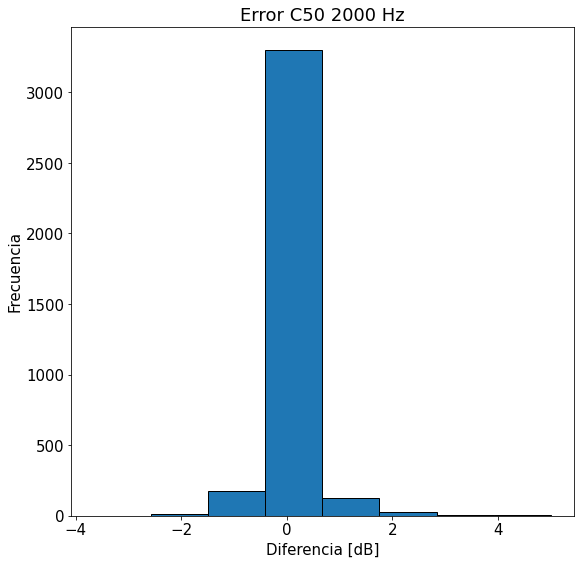

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([  24.,  368., 1778., 1203.,  221.,   48.,   14.,    2.]),
 array([-0.73  , -0.4475, -0.165 ,  0.1175,  0.4   ,  0.6825,  0.965 ,
         1.2475,  1.53  ]),
 <a list of 8 Patch objects>)

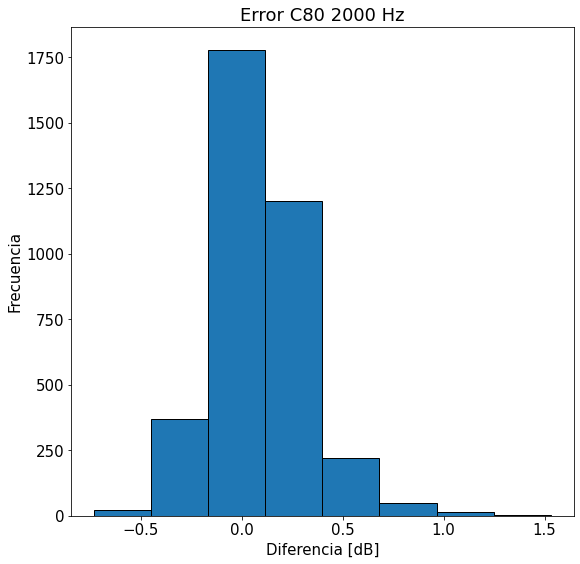

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([  30.,  163., 1257., 1730.,  427.,   43.,    5.,    3.]),
 array([-0.34 , -0.225, -0.11 ,  0.005,  0.12 ,  0.235,  0.35 ,  0.465,
         0.58 ]),
 <a list of 8 Patch objects>)

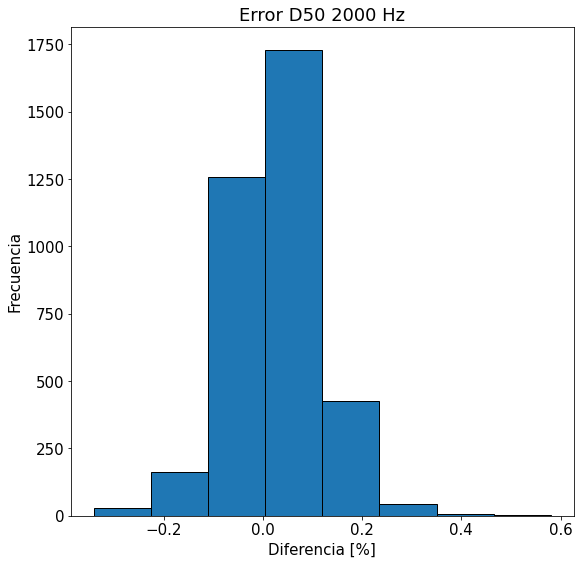

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

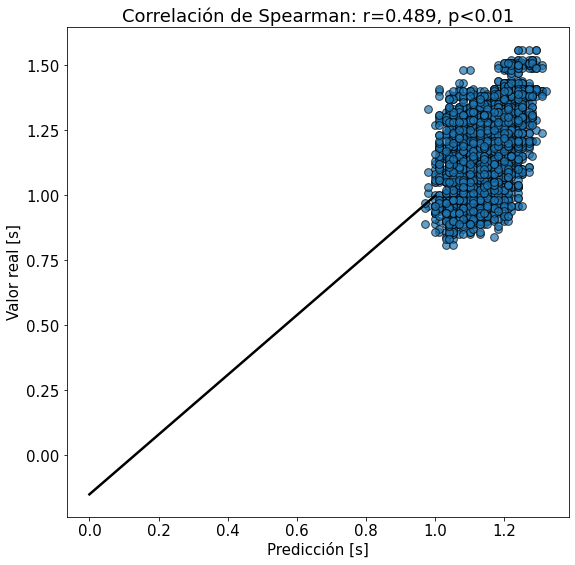

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

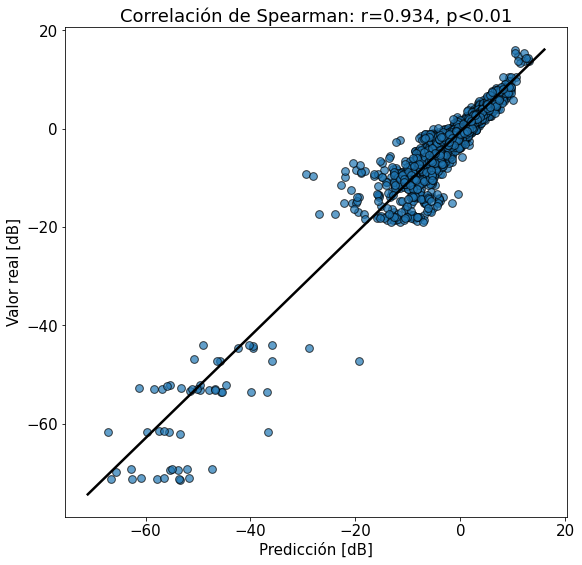

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

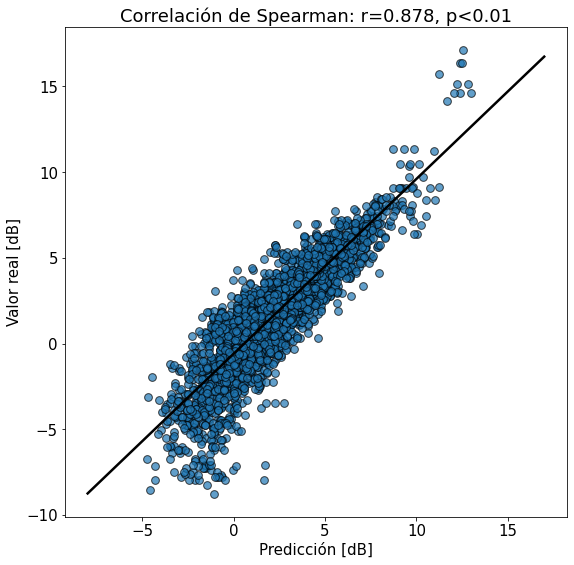

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

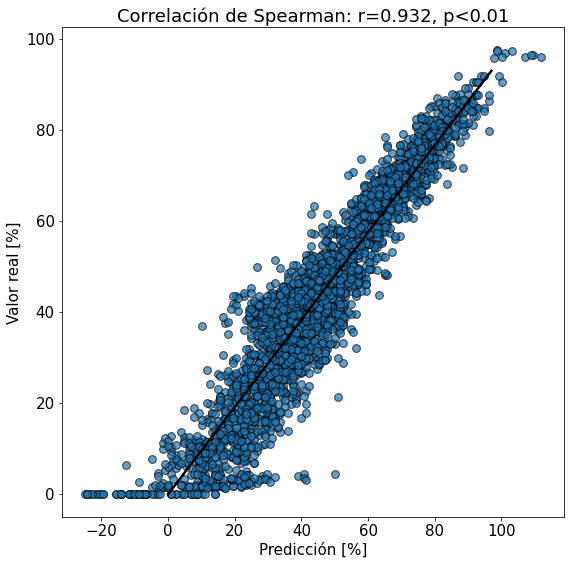

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

4000 Hz

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE sinteticos y reales')

band = 4000

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-10.091153775630458
1.7087258585714278


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

1.3990636362642093
6.180056344256486
6.911722220942982
80.5809943625296


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.09019470247956378
Máximo y_train: 1.7087258585714278
Mínimo y_train: -10.091153775630458


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
13/13 [==============================] - 2s 34ms/step - loss: 0.9334 - val_loss: 0.6510
Epoch 2/500
13/13 [==============================] - 0s 16ms/step - loss: 0.6087 - val_loss: 0.6229
Epoch 3/500
13/13 [==============================] - 0s 14ms/step - loss: 0.4809 - val_loss: 0.6011
Epoch 4/500
13/13 [==============================] - 0s 14ms/step - loss: 0.4230 - val_loss: 0.5874
Epoch 5/500
13/13 [==============================] - 0s 13ms/step - loss: 0.3875 - val_loss: 0.5779
Epoch 6/500
13/13 [==============================] - 0s 14ms/step - loss: 0.3661 - val_loss: 0.5761
Epoch 7/500
13/13 [==============================] - 0s 14ms/step - loss: 0.3477 - val_loss: 0.5756
Epoch 8/500
13/13 [==============================] - 0s 14ms/step - loss: 0.3287 - val_loss: 0.5776
Epoch 9/500
13/13 [==============================] - 0s 14ms/step - loss: 0.3164 - val_loss: 0.5816
Epoch 10/500
13/13 [==============================] - 0s 13ms/step - loss: 0.3125 - val_loss: 0.5871

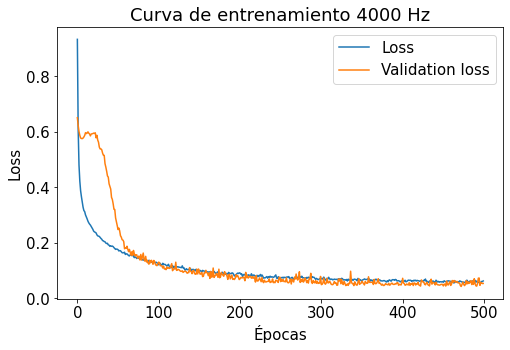

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([  62.,  227.,  577., 1001.,  961.,  670.,  146.,   14.]),
 array([-0.24 , -0.175, -0.11 , -0.045,  0.02 ,  0.085,  0.15 ,  0.215,
         0.28 ]),
 <a list of 8 Patch objects>)

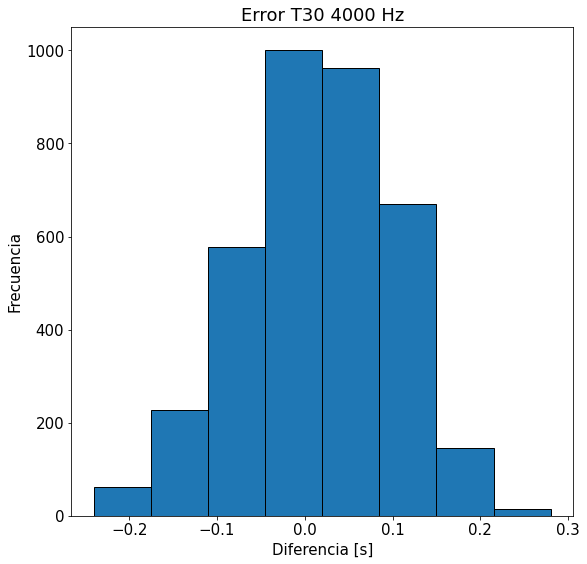

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([1.000e+00, 4.000e+00, 2.200e+01, 3.177e+03, 4.280e+02, 1.400e+01,
        7.000e+00, 5.000e+00]),
 array([-5.23  , -3.8725, -2.515 , -1.1575,  0.2   ,  1.5575,  2.915 ,
         4.2725,  5.63  ]),
 <a list of 8 Patch objects>)

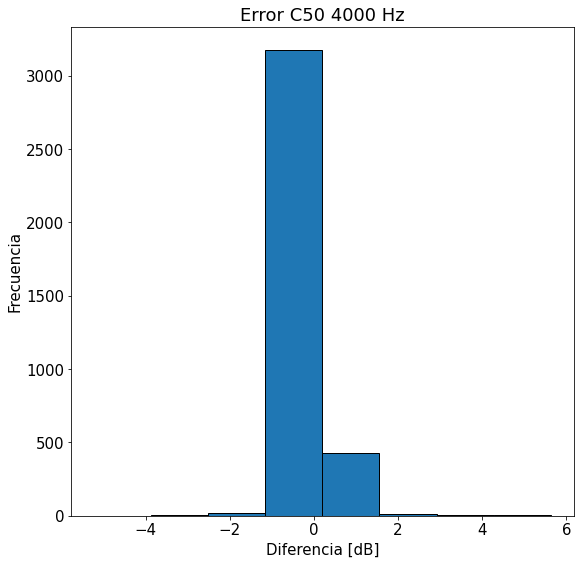

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([  14.,  238., 1368., 1560.,  357.,   72.,   39.,   10.]),
 array([-0.74  , -0.5225, -0.305 , -0.0875,  0.13  ,  0.3475,  0.565 ,
         0.7825,  1.    ]),
 <a list of 8 Patch objects>)

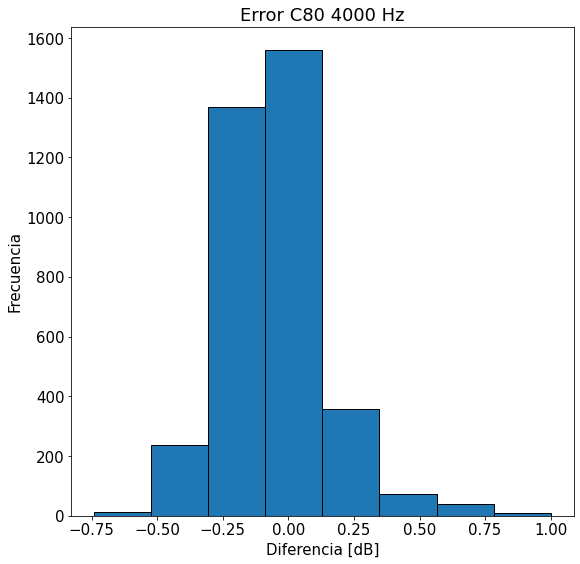

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([  13.,  180., 1153., 1738.,  459.,   84.,   28.,    3.]),
 array([-0.32   , -0.22875, -0.1375 , -0.04625,  0.045  ,  0.13625,
         0.2275 ,  0.31875,  0.41   ]),
 <a list of 8 Patch objects>)

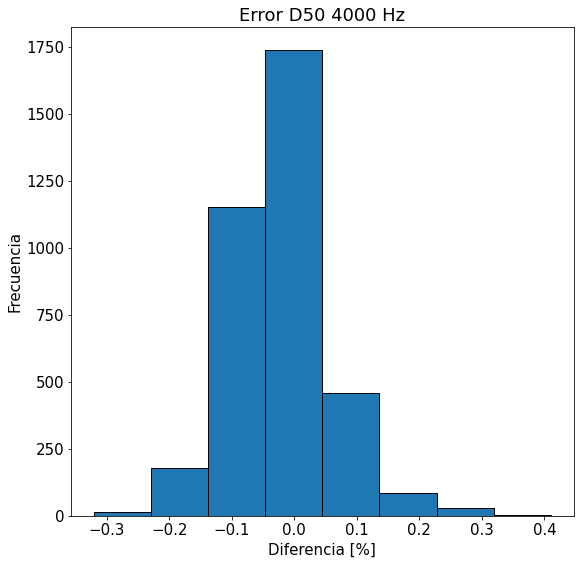

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

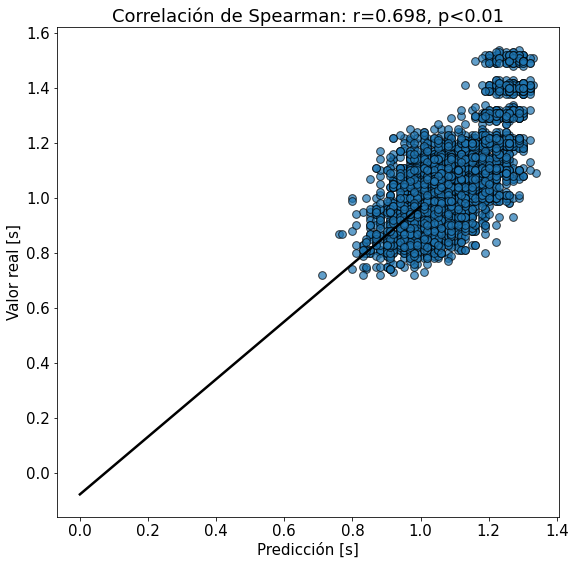

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

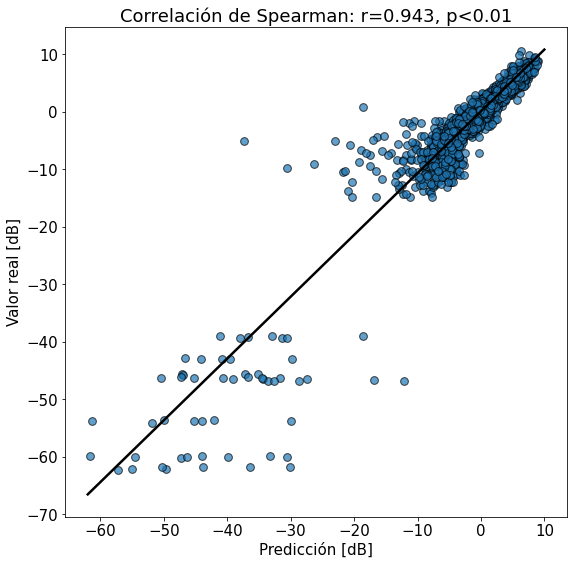

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

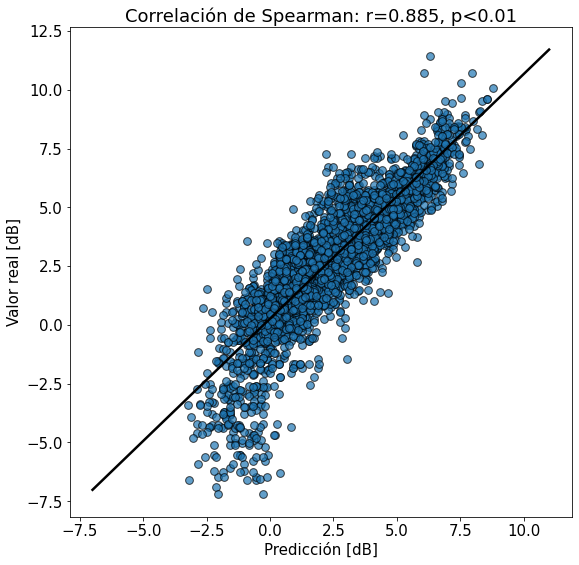

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

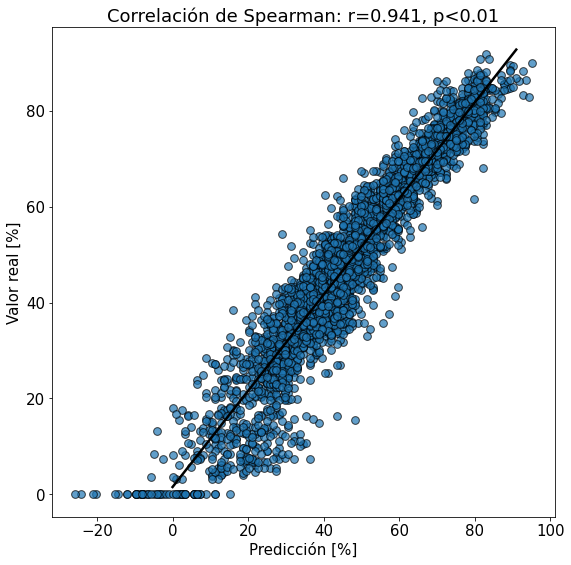

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

8000 Hz

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE sinteticos y reales')

band = 8000

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-5.6810304897564965
1.568063076239722


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

1.4000104352245661
7.567689973750702
8.268313237301742
85.10075050221059


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.13319784494256595
Máximo y_train: 1.568063076239722
Mínimo y_train: -5.6810304897564965


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
13/13 [==============================] - 3s 102ms/step - loss: 1.1563 - val_loss: 0.4616
Epoch 2/500
13/13 [==============================] - 0s 18ms/step - loss: 0.5700 - val_loss: 0.4347
Epoch 3/500
13/13 [==============================] - 0s 20ms/step - loss: 0.3989 - val_loss: 0.3982
Epoch 4/500
13/13 [==============================] - 0s 18ms/step - loss: 0.3179 - val_loss: 0.3759
Epoch 5/500
13/13 [==============================] - 0s 18ms/step - loss: 0.2744 - val_loss: 0.3540
Epoch 6/500
13/13 [==============================] - 0s 19ms/step - loss: 0.2458 - val_loss: 0.3327
Epoch 7/500
13/13 [==============================] - 0s 21ms/step - loss: 0.2252 - val_loss: 0.3190
Epoch 8/500
13/13 [==============================] - 0s 19ms/step - loss: 0.2091 - val_loss: 0.3134
Epoch 9/500
13/13 [==============================] - 0s 19ms/step - loss: 0.1966 - val_loss: 0.3122
Epoch 10/500
13/13 [==============================] - 0s 17ms/step - loss: 0.1833 - val_loss: 0.315

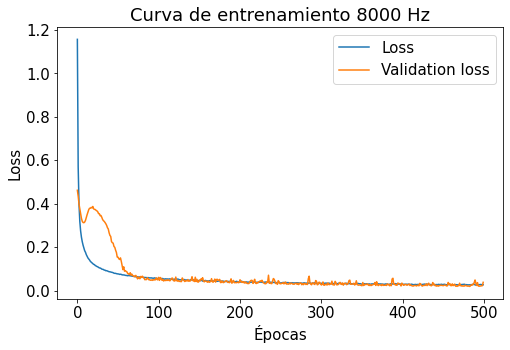

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([ 58., 242., 586., 676., 874., 796., 365.,  61.]),
 array([-0.2   , -0.1425, -0.085 , -0.0275,  0.03  ,  0.0875,  0.145 ,
         0.2025,  0.26  ]),
 <a list of 8 Patch objects>)

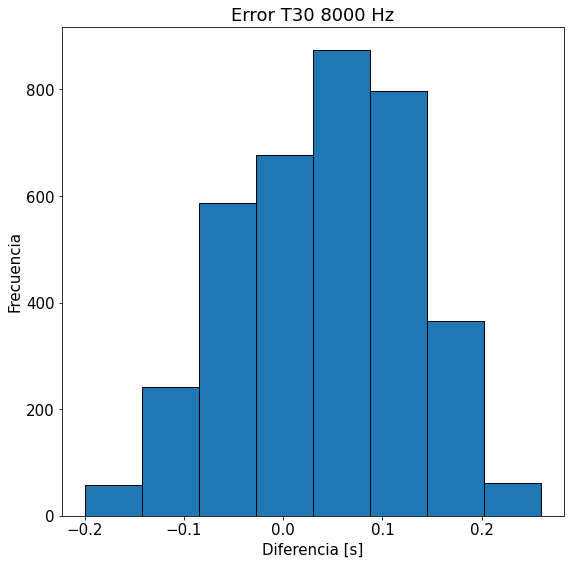

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([  32., 2630.,  921.,   37.,    6.,   15.,   13.,    4.]),
 array([-1.14  , -0.5625,  0.015 ,  0.5925,  1.17  ,  1.7475,  2.325 ,
         2.9025,  3.48  ]),
 <a list of 8 Patch objects>)

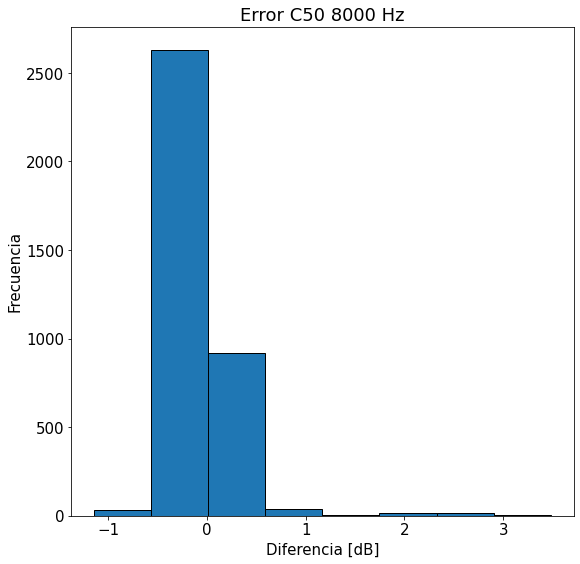

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([  31.,  210.,  752., 1632.,  861.,  141.,   25.,    6.]),
 array([-0.73, -0.55, -0.37, -0.19, -0.01,  0.17,  0.35,  0.53,  0.71]),
 <a list of 8 Patch objects>)

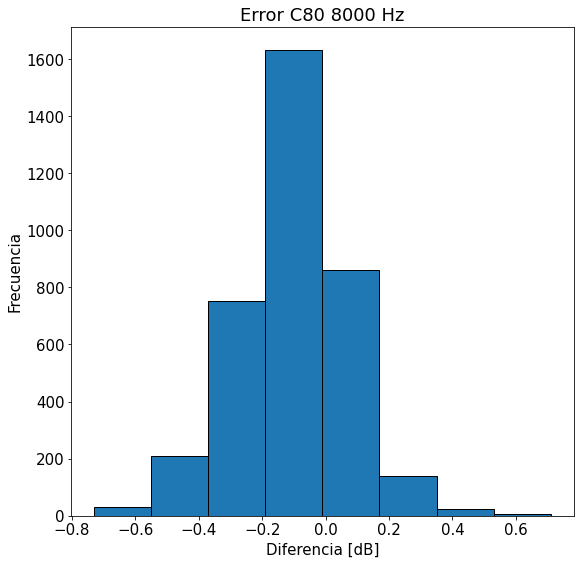

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([8.100e+01, 4.040e+02, 1.478e+03, 1.329e+03, 2.630e+02, 8.500e+01,
        1.700e+01, 1.000e+00]),
 array([-0.28   , -0.19625, -0.1125 , -0.02875,  0.055  ,  0.13875,
         0.2225 ,  0.30625,  0.39   ]),
 <a list of 8 Patch objects>)

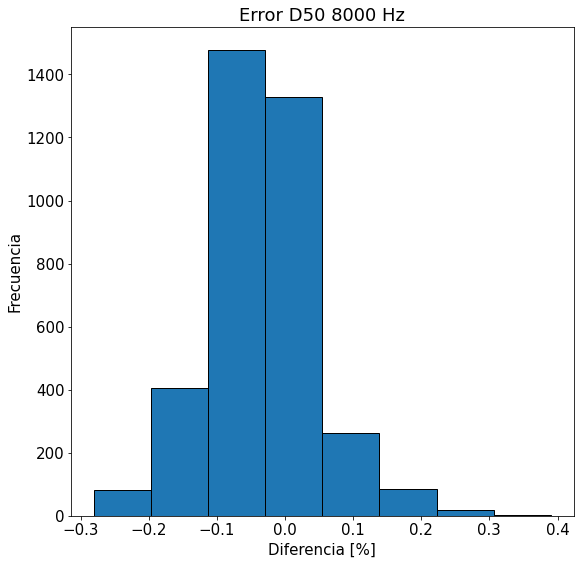

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

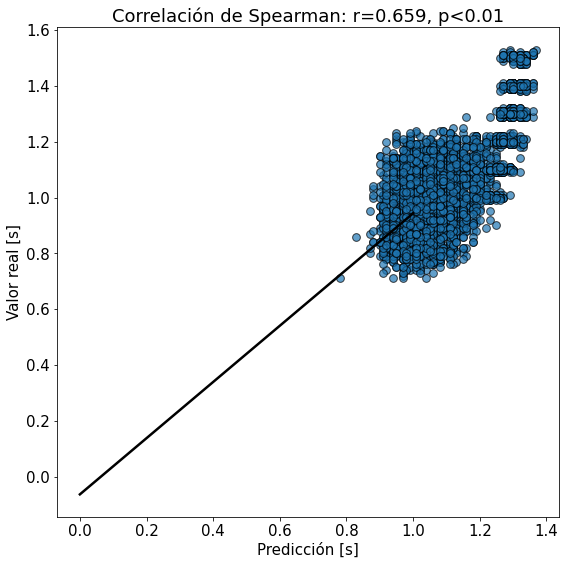

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

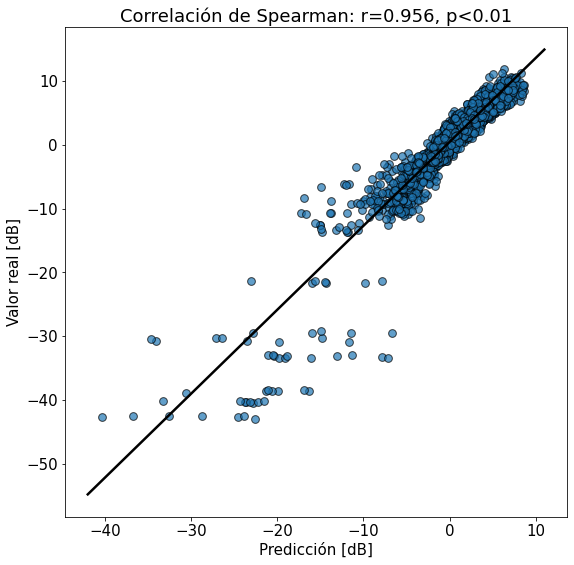

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

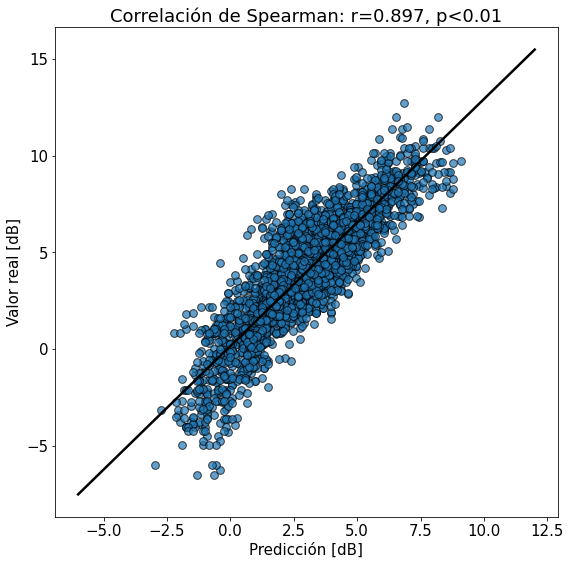

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

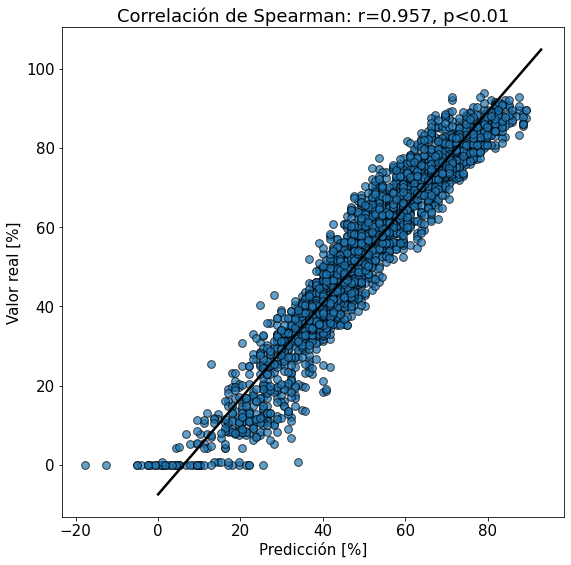

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

# Entrenamiento RIRs reales y sintéticas con ruido: Tr entre 1 y 1.5 [s]

En este caso, además de normalizar todo con el percentil 95, paso todos los valores a su escala sin dB ni %

In [ ]:
#Librerías necesarias:
import sys 
sys.path.append('/content/drive/My Drive/Tesis/Notebooks/scripts')
from model_2 import modelo
from scipy import stats

import numpy as np
import os
from librosa import load
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

!pip install pickle5
import pickle5 as pickle
import matplotlib.pyplot as plt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 256 kB 7.8 MB/s 


Outliers:

In [ ]:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE con ruido')
with open('outliers_1_1.5.pickle', 'rb') as handle:
  outliers = list(set(pickle.load(handle)))

125 Hz:

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE con ruido')

band = 125

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

In [ ]:
print(list(tae_dic.keys())[10000])
print(list(params_dic.keys())[10000])

F1s3--Single_EE_lobby_1_Noise_Ambient_26_10.661dB--sintetica_Seed393668712_Tr0.2
F1s3--Single_EE_lobby_2_Noise_Ambient_19_9.104dB--sintetica_Seed2295707925_Tr0.2


In [ ]:
print(len(list(tae_dic.keys())))
print(len(list(params_dic.keys())))

216940
216940


In [ ]:
print(list(tae_dic.keys())[0:5])
print(list(params_dic.keys())[0:5])

['F1s3--Single_502_1_Noise_Ambient_0_-0.251dB--Zx12y07_4dB', 'F1s3--Single_502_1_Noise_Ambient_0_-0.506dB--Zx00y04_10dB', 'F1s3--Single_502_1_Noise_Ambient_0_-1.54dB--sintetica_Seed1272325897_Tr2.9', 'F1s3--Single_502_1_Noise_Ambient_0_-1.865dB--Xx03y11_2.6s', 'F1s3--Single_502_1_Noise_Ambient_0_-2.983dB--Xx09y10_2.3s']
['F1s3--Single_502_1_Noise_Ambient_25_6.051dB--sintetica_Seed1000489356_Tr0.8', 'F2s3--Single_502_2_Noise_Ambient_30_-3.524dB--sintetica_Seed1000489356_Tr0.8', 'F3s3--Single_EE_lobby_1_Noise_Fan_46_7.023dB--sintetica_Seed1000489356_Tr0.8', 'F4s3--Single_EE_lobby_1_Noise_Fan_44_18.522dB--sintetica_Seed1000489356_Tr0.8', 'F5s3--Single_EE_lobby_2_Noise_Fan_28_16.887dB--sintetica_Seed1000489356_Tr0.8']


In [ ]:
#print(params_dic['F1s3-sintetica_Seed1807110498_Tr3.0'])

In [ ]:
#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

In [ ]:
#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
print(len(y))

18230


In [ ]:
#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-23.244287245893542
5.624984524478361


In [ ]:
print(T30_perc_95) 
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

1.56165630986904
2.541801009325566
4.609460736215053
64.2279430925249


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
print(X_train.shape)
print(y_train.shape)

(14584, 200, 1)
(14584, 4, 1)


In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.1503579207530285


In [ ]:
assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo y_train: 5.624984524478361
Mínimo y_train: -23.244287245893542


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
13/13 [==============================] - 2s 98ms/step - loss: 11.8090 - val_loss: 10.9103
Epoch 2/500
13/13 [==============================] - 0s 14ms/step - loss: 10.2394 - val_loss: 10.8377
Epoch 3/500
13/13 [==============================] - 0s 15ms/step - loss: 9.1632 - val_loss: 10.7396
Epoch 4/500
13/13 [==============================] - 0s 14ms/step - loss: 8.3542 - val_loss: 10.5081
Epoch 5/500
13/13 [==============================] - 0s 14ms/step - loss: 7.7495 - val_loss: 9.6584
Epoch 6/500
13/13 [==============================] - 0s 14ms/step - loss: 7.3293 - val_loss: 8.2576
Epoch 7/500
13/13 [==============================] - 0s 14ms/step - loss: 7.0405 - val_loss: 7.3755
Epoch 8/500
13/13 [==============================] - 0s 14ms/step - loss: 6.8763 - val_loss: 7.1685
Epoch 9/500
13/13 [==============================] - 0s 14ms/step - loss: 6.7182 - val_loss: 7.1238
Epoch 10/500
13/13 [==============================] - 0s 20ms/step - loss: 6.5650 - val_loss: 

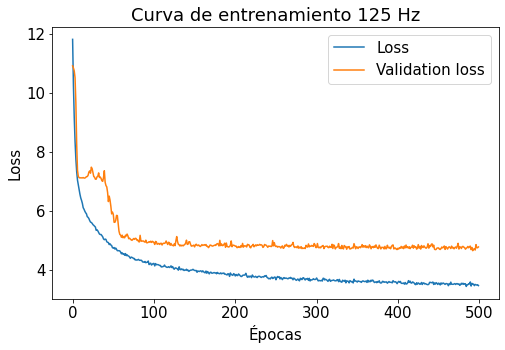

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
blind_estimation_model.predict(X_test[5,:,0].reshape(1,-1,1))[0]

array([ 0.8237501 , -1.6382105 , -0.31120187,  0.464072  ], dtype=float32)

In [ ]:
np.round(y_test[0,:,0].reshape(1,-1,1),1)

array([[[0.6],
        [3.6],
        [2. ],
        [1.4]]])

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
prediction[0]

array([ 0.79, -2.54, -0.28,  0.47], dtype=float32)

In [ ]:
np.round(prediction[1] - np.round(y_test[1,:,0].reshape(1,-1,1),2).flatten(),2)

array([ 0.1 , -4.9 , -1.99, -0.84])

In [ ]:
np.round(prediction[1][0] - np.round(y_test[1,:,0].reshape(1,-1,1),2).flatten()[0],2)

0.1

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([   5.,   32.,   66.,  297.,  992., 1397.,  771.,   86.]),
 array([-0.7 , -0.56, -0.42, -0.28, -0.14,  0.  ,  0.14,  0.28,  0.42]),
 <a list of 8 Patch objects>)

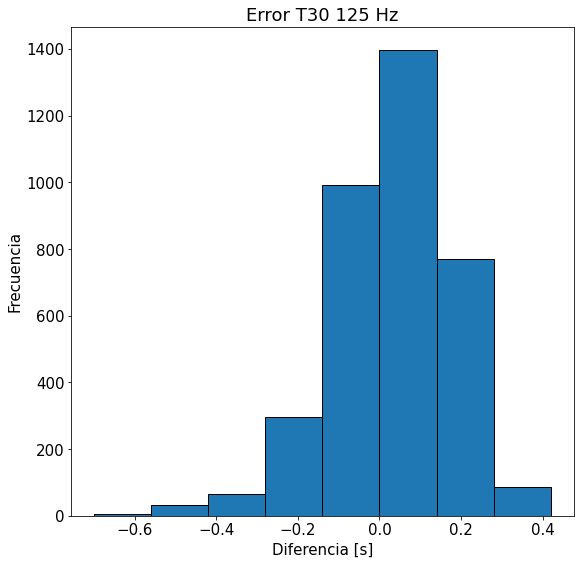

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([  26.,  386., 1706., 1095.,  243.,   99.,   67.,   24.]),
 array([-11.41  ,  -7.5225,  -3.635 ,   0.2525,   4.14  ,   8.0275,
         11.915 ,  15.8025,  19.69  ]),
 <a list of 8 Patch objects>)

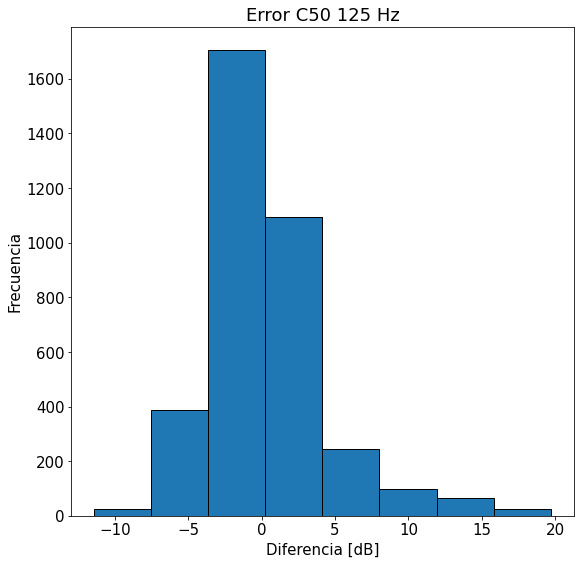

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([  17.,  132.,  868., 1714.,  674.,  186.,   45.,   10.]),
 array([-3.71   , -2.66125, -1.6125 , -0.56375,  0.485  ,  1.53375,
         2.5825 ,  3.63125,  4.68   ]),
 <a list of 8 Patch objects>)

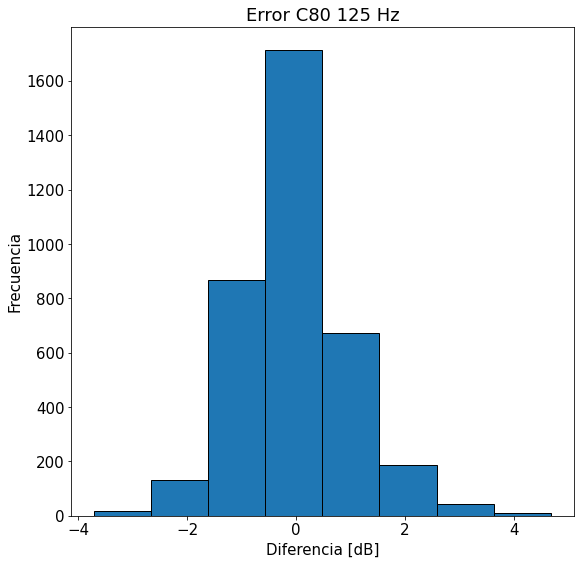

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([  10.,   66.,  156.,  457.,  878., 1411.,  634.,   34.]),
 array([-1.21   , -0.96625, -0.7225 , -0.47875, -0.235  ,  0.00875,
         0.2525 ,  0.49625,  0.74   ]),
 <a list of 8 Patch objects>)

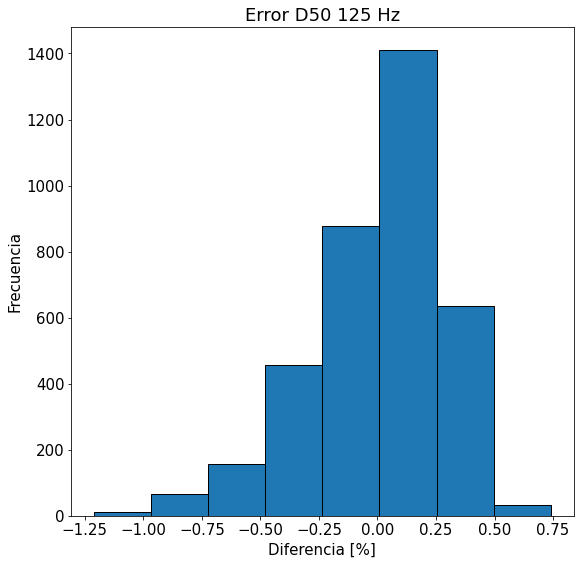

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

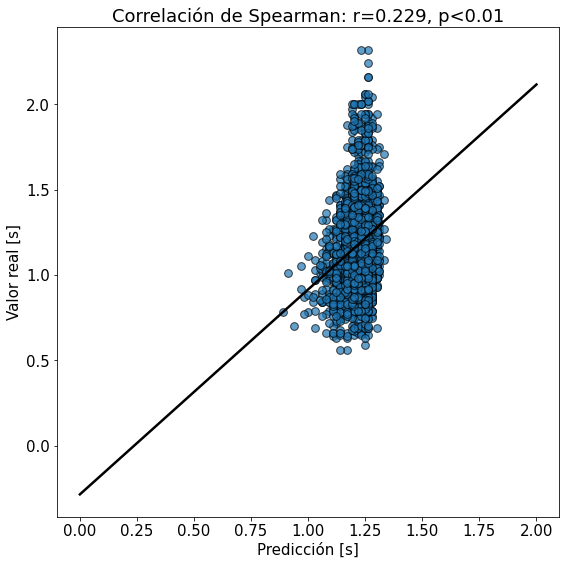

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

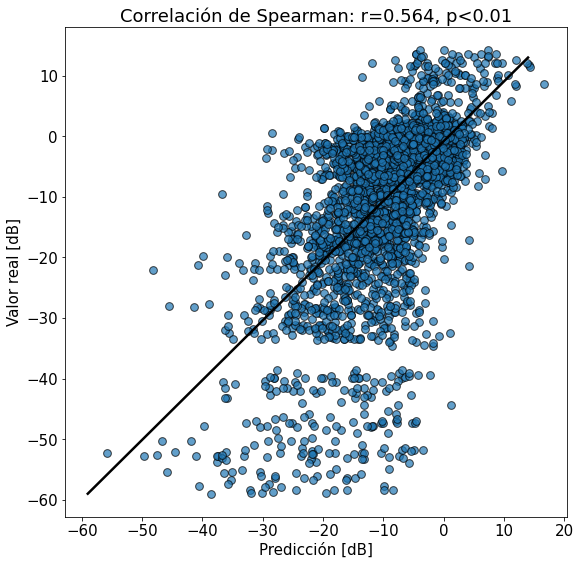

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

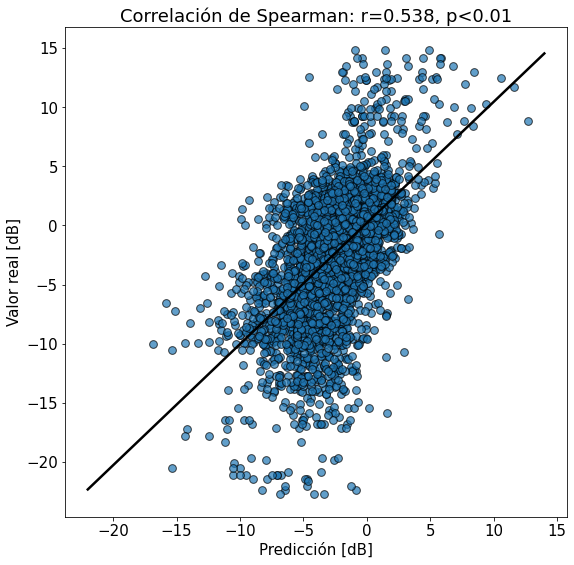

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

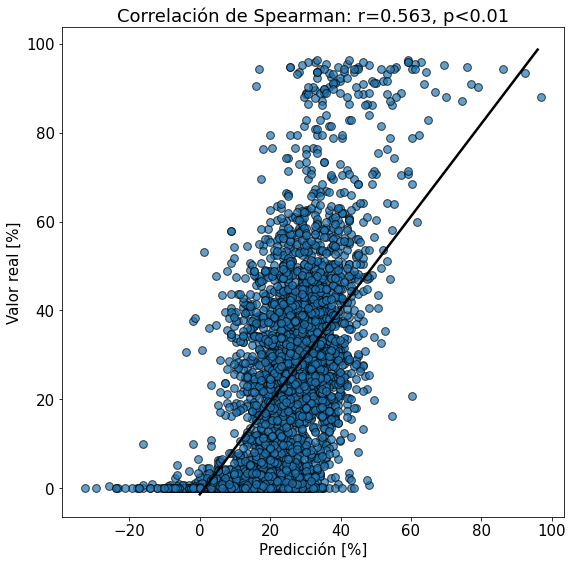

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

250 Hz:

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE con ruido')

band = 250

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-11.387208402641345
1.9512646691964195


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

1.440991943939145
5.333097050900579
5.993945266662576
77.34667548169891


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.16955125804432783
Máximo y_train: 1.9512646691964195
Mínimo y_train: -11.387208402641345


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
13/13 [==============================] - 2s 45ms/step - loss: 2.6284 - val_loss: 1.8100
Epoch 2/500
13/13 [==============================] - 0s 19ms/step - loss: 1.8196 - val_loss: 1.7784
Epoch 3/500
13/13 [==============================] - 0s 18ms/step - loss: 1.5947 - val_loss: 1.7502
Epoch 4/500
13/13 [==============================] - 0s 17ms/step - loss: 1.4651 - val_loss: 1.7145
Epoch 5/500
13/13 [==============================] - 0s 17ms/step - loss: 1.3984 - val_loss: 1.6570
Epoch 6/500
13/13 [==============================] - 0s 17ms/step - loss: 1.3505 - val_loss: 1.5984
Epoch 7/500
13/13 [==============================] - 0s 16ms/step - loss: 1.3042 - val_loss: 1.5487
Epoch 8/500
13/13 [==============================] - 0s 15ms/step - loss: 1.2811 - val_loss: 1.5032
Epoch 9/500
13/13 [==============================] - 0s 17ms/step - loss: 1.2516 - val_loss: 1.4650
Epoch 10/500
13/13 [==============================] - 0s 16ms/step - loss: 1.2194 - val_loss: 1.4450

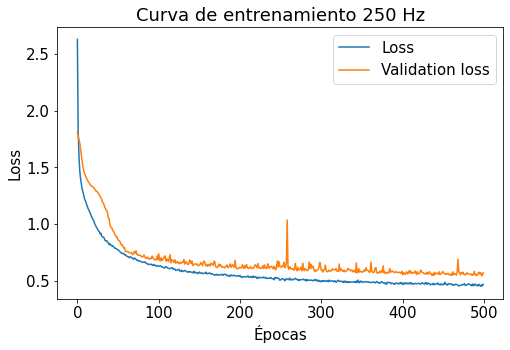

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([ 32., 170., 531., 842., 939., 753., 340.,  39.]),
 array([-0.33   , -0.24875, -0.1675 , -0.08625, -0.005  ,  0.07625,
         0.1575 ,  0.23875,  0.32   ]),
 <a list of 8 Patch objects>)

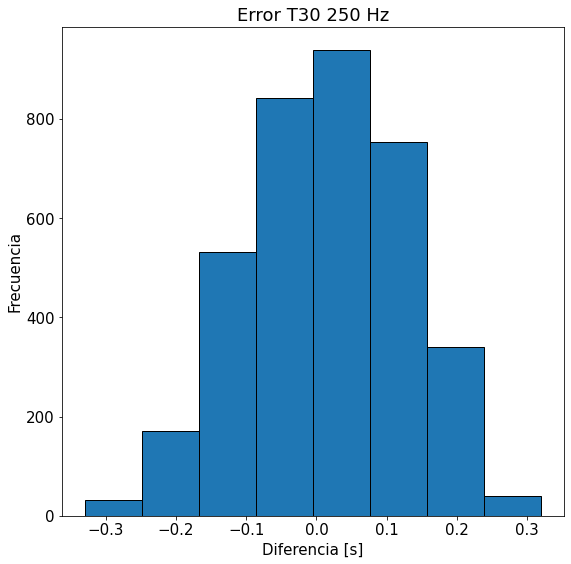

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([1.000e+00, 9.000e+00, 2.340e+02, 2.937e+03, 3.380e+02, 8.500e+01,
        3.400e+01, 8.000e+00]),
 array([-8.04   , -5.78125, -3.5225 , -1.26375,  0.995  ,  3.25375,
         5.5125 ,  7.77125, 10.03   ]),
 <a list of 8 Patch objects>)

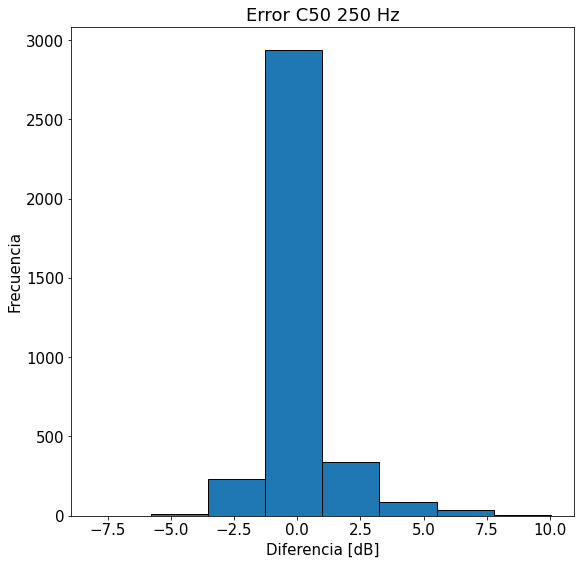

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([1.000e+00, 3.700e+01, 7.570e+02, 2.163e+03, 5.660e+02, 1.040e+02,
        1.600e+01, 2.000e+00]),
 array([-2.92  , -2.1025, -1.285 , -0.4675,  0.35  ,  1.1675,  1.985 ,
         2.8025,  3.62  ]),
 <a list of 8 Patch objects>)

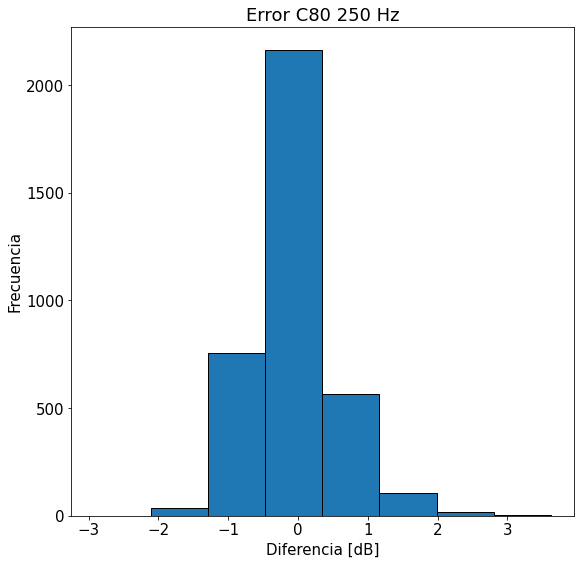

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([1.000e+00, 1.300e+01, 9.100e+01, 6.930e+02, 1.399e+03, 1.068e+03,
        3.620e+02, 1.900e+01]),
 array([-0.98  , -0.7775, -0.575 , -0.3725, -0.17  ,  0.0325,  0.235 ,
         0.4375,  0.64  ]),
 <a list of 8 Patch objects>)

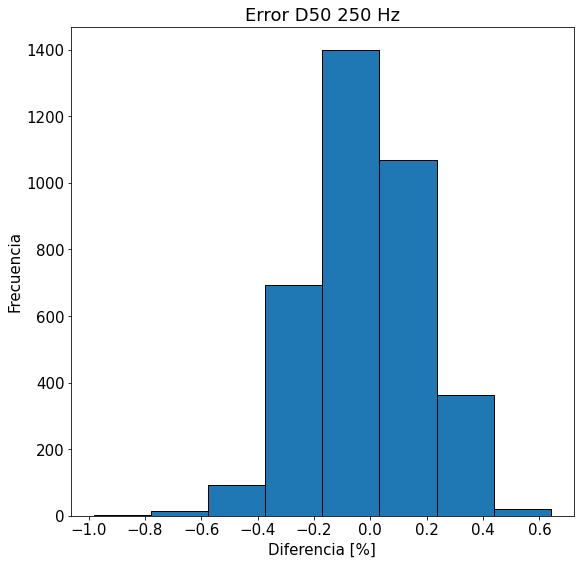

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

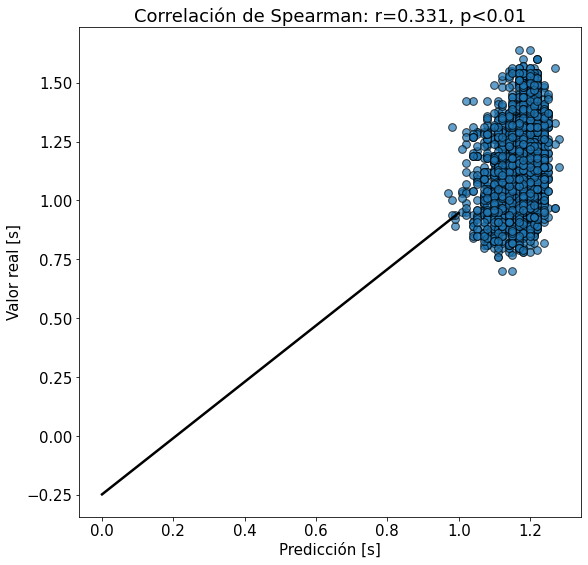

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

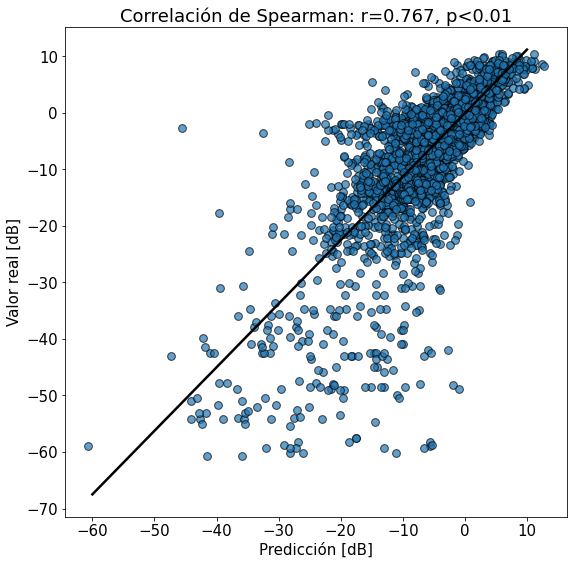

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

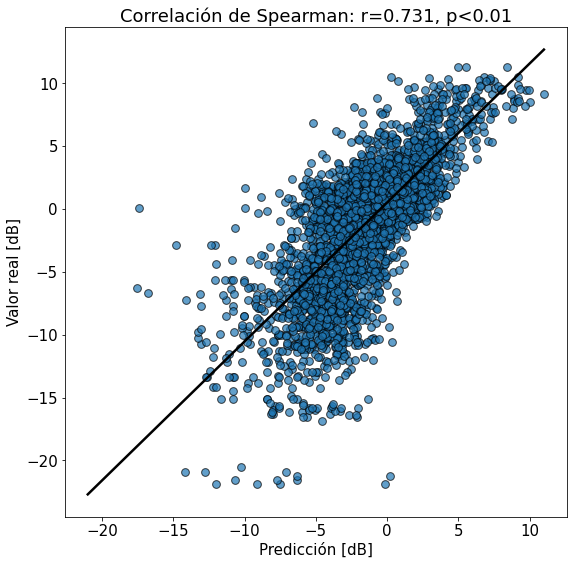

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

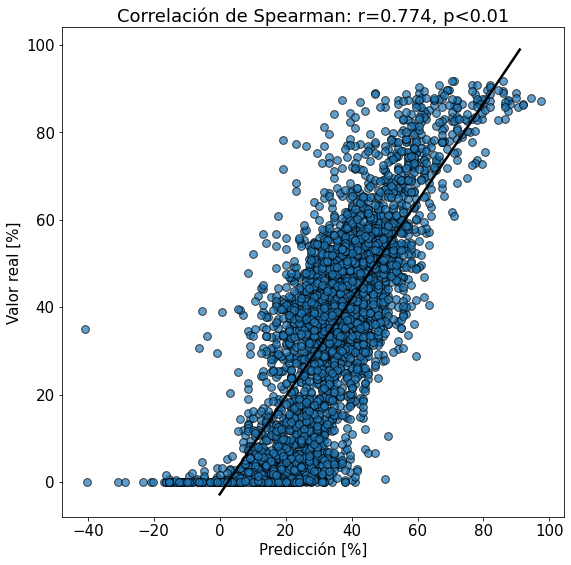

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

500 Hz

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE con ruido')

band = 500

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-11.340533679393431
3.854062528733577


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

1.4603480905658175
5.76147722675646
6.537627111029476
79.02825112860681


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.12279797291595138
Máximo y_train: 3.854062528733577
Mínimo y_train: -11.340533679393431


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
13/13 [==============================] - 2s 34ms/step - loss: 1.5813 - val_loss: 1.2229
Epoch 2/500
13/13 [==============================] - 0s 17ms/step - loss: 1.1644 - val_loss: 1.1941
Epoch 3/500
13/13 [==============================] - 0s 14ms/step - loss: 1.0308 - val_loss: 1.1577
Epoch 4/500
13/13 [==============================] - 0s 14ms/step - loss: 0.9529 - val_loss: 1.1174
Epoch 5/500
13/13 [==============================] - 0s 14ms/step - loss: 0.9140 - val_loss: 1.0811
Epoch 6/500
13/13 [==============================] - 0s 14ms/step - loss: 0.8851 - val_loss: 1.0509
Epoch 7/500
13/13 [==============================] - 0s 14ms/step - loss: 0.8605 - val_loss: 1.0254
Epoch 8/500
13/13 [==============================] - 0s 14ms/step - loss: 0.8447 - val_loss: 1.0087
Epoch 9/500
13/13 [==============================] - 0s 14ms/step - loss: 0.8264 - val_loss: 0.9999
Epoch 10/500
13/13 [==============================] - 0s 14ms/step - loss: 0.8121 - val_loss: 0.9924

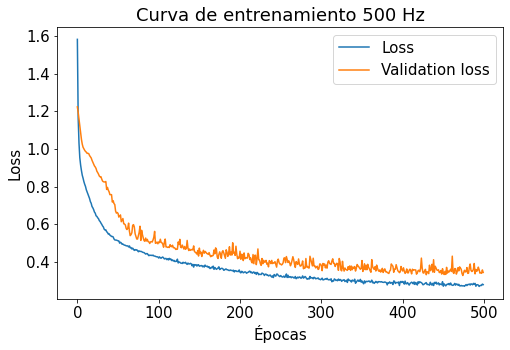

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([ 43., 323., 636., 837., 756., 627., 382.,  42.]),
 array([-0.27   , -0.20375, -0.1375 , -0.07125, -0.005  ,  0.06125,
         0.1275 ,  0.19375,  0.26   ]),
 <a list of 8 Patch objects>)

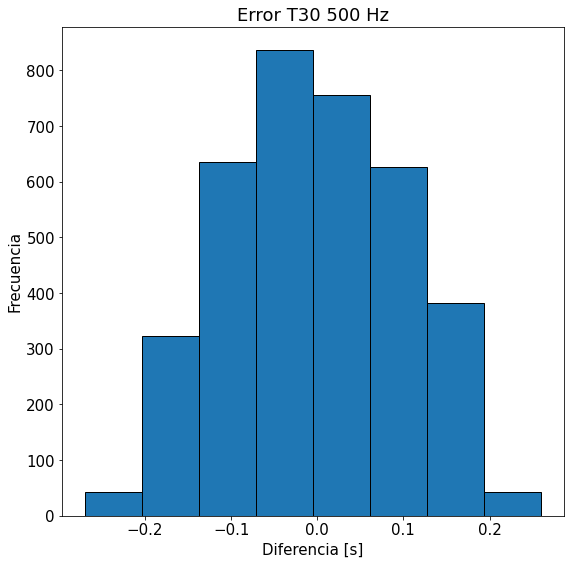

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([  17.,  191., 3131.,  217.,   51.,   26.,    6.,    7.]),
 array([-4.58   , -2.74875, -0.9175 ,  0.91375,  2.745  ,  4.57625,
         6.4075 ,  8.23875, 10.07   ]),
 <a list of 8 Patch objects>)

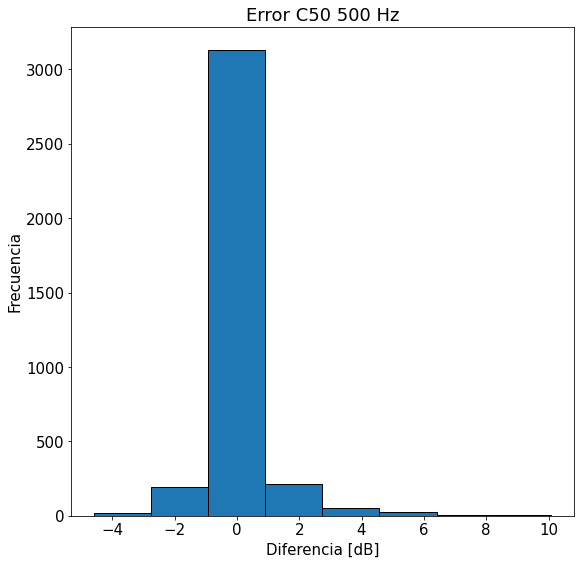

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([   2.,    8.,  268., 1926., 1215.,  180.,   40.,    7.]),
 array([-2.39   , -1.77625, -1.1625 , -0.54875,  0.065  ,  0.67875,
         1.2925 ,  1.90625,  2.52   ]),
 <a list of 8 Patch objects>)

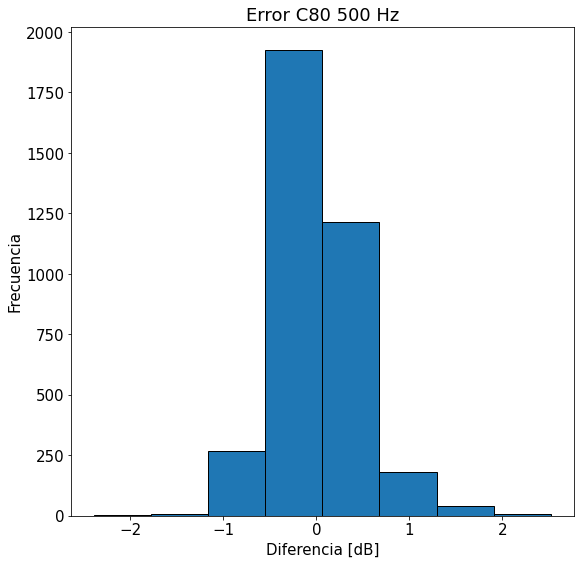

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([   9.,   57.,  320., 1188., 1378.,  514.,  154.,   26.]),
 array([-0.66   , -0.50125, -0.3425 , -0.18375, -0.025  ,  0.13375,
         0.2925 ,  0.45125,  0.61   ]),
 <a list of 8 Patch objects>)

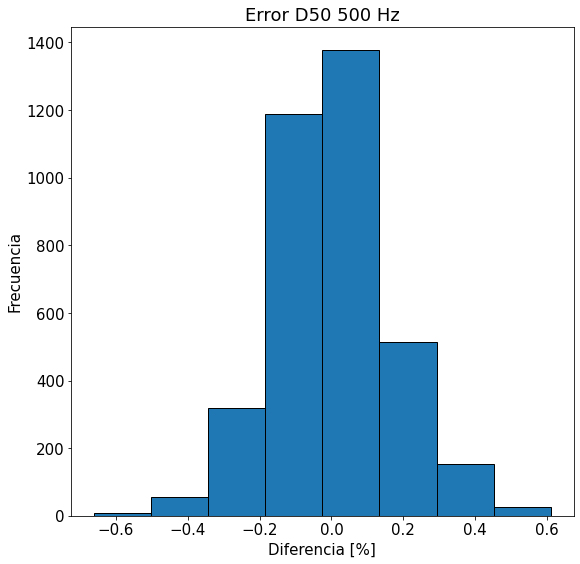

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

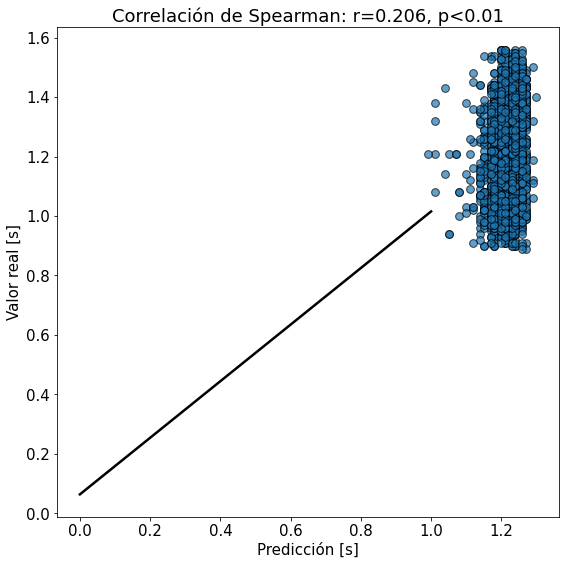

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

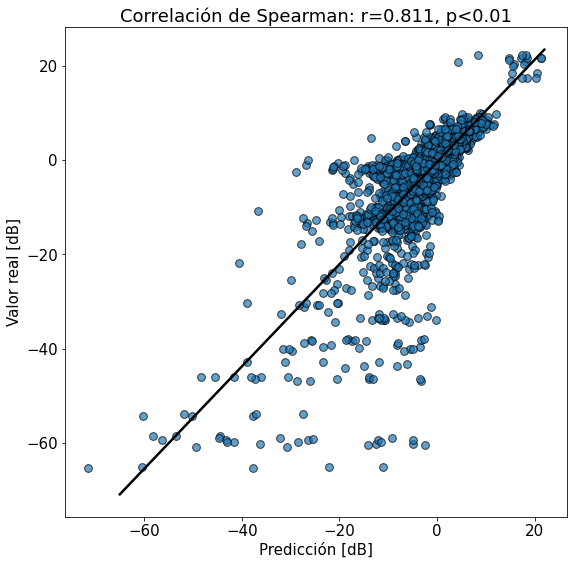

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

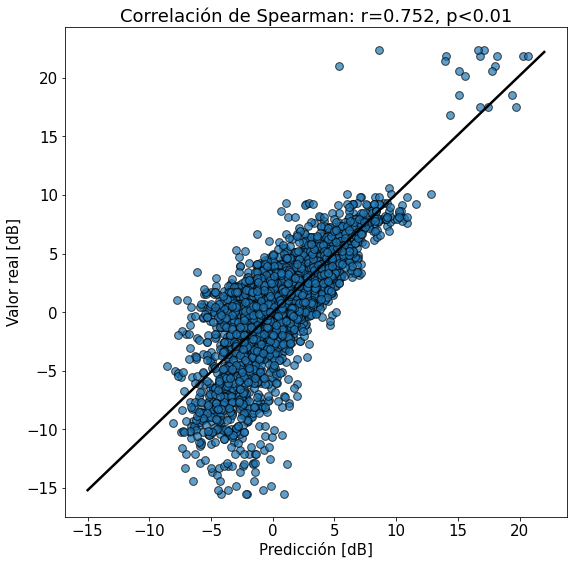

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

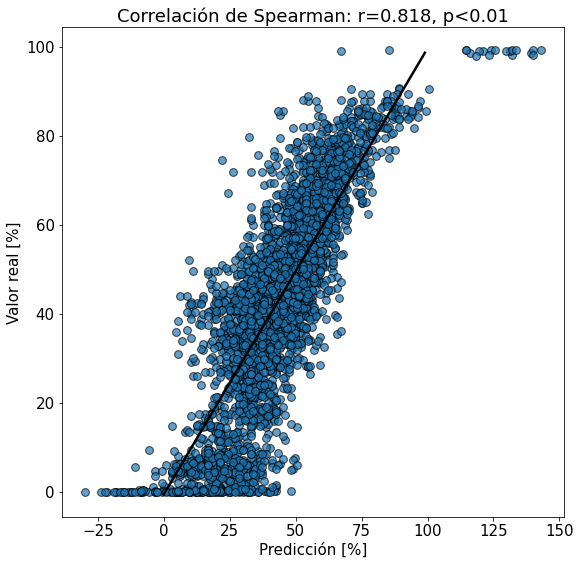

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

1000 Hz

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE con ruido')

band = 1000

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-9.858522749630616
2.7605420662293785


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

1.4779763876297394
6.819021303975888
7.127906514853387
82.78032348005445


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.11204973497770113
Máximo y_train: 2.7605420662293785
Mínimo y_train: -9.858522749630616


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
13/13 [==============================] - 2s 34ms/step - loss: 1.6003 - val_loss: 0.8895
Epoch 2/500
13/13 [==============================] - 0s 15ms/step - loss: 0.9541 - val_loss: 0.8038
Epoch 3/500
13/13 [==============================] - 0s 14ms/step - loss: 0.7948 - val_loss: 0.7470
Epoch 4/500
13/13 [==============================] - 0s 14ms/step - loss: 0.7248 - val_loss: 0.7159
Epoch 5/500
13/13 [==============================] - 0s 14ms/step - loss: 0.6778 - val_loss: 0.6819
Epoch 6/500
13/13 [==============================] - 0s 14ms/step - loss: 0.6423 - val_loss: 0.6574
Epoch 7/500
13/13 [==============================] - 0s 14ms/step - loss: 0.6248 - val_loss: 0.6495
Epoch 8/500
13/13 [==============================] - 0s 14ms/step - loss: 0.6055 - val_loss: 0.6463
Epoch 9/500
13/13 [==============================] - 0s 13ms/step - loss: 0.5935 - val_loss: 0.6452
Epoch 10/500
13/13 [==============================] - 0s 16ms/step - loss: 0.5765 - val_loss: 0.6469

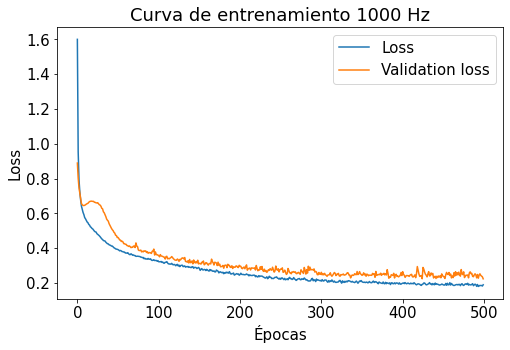

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([230., 554., 520., 493., 506., 544., 543., 256.]),
 array([-0.19  , -0.1425, -0.095 , -0.0475,  0.    ,  0.0475,  0.095 ,
         0.1425,  0.19  ]),
 <a list of 8 Patch objects>)

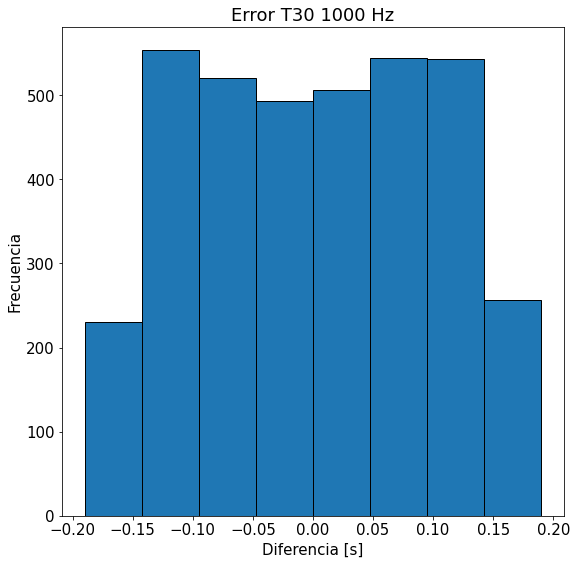

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([   4.,   21., 2147., 1396.,   48.,   16.,    7.,    7.]),
 array([-5.61   , -3.73125, -1.8525 ,  0.02625,  1.905  ,  3.78375,
         5.6625 ,  7.54125,  9.42   ]),
 <a list of 8 Patch objects>)

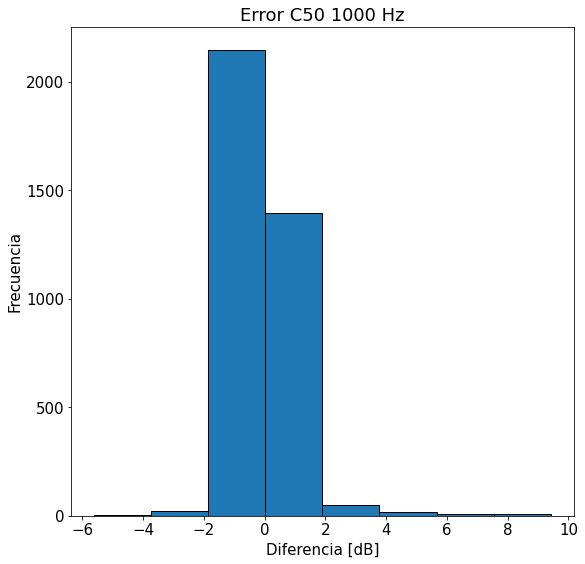

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([1.000e+00, 5.000e+00, 2.300e+01, 4.350e+02, 2.325e+03, 7.290e+02,
        1.190e+02, 9.000e+00]),
 array([-2.59   , -2.04625, -1.5025 , -0.95875, -0.415  ,  0.12875,
         0.6725 ,  1.21625,  1.76   ]),
 <a list of 8 Patch objects>)

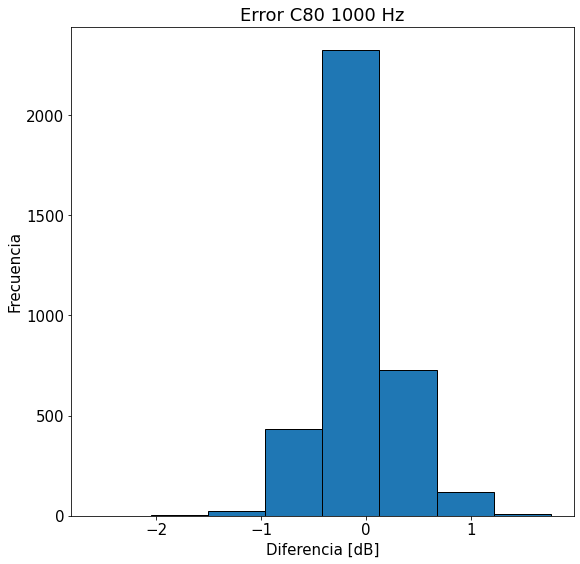

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([   5.,   35.,  209., 1130., 1540.,  554.,  151.,   22.]),
 array([-0.74  , -0.5725, -0.405 , -0.2375, -0.07  ,  0.0975,  0.265 ,
         0.4325,  0.6   ]),
 <a list of 8 Patch objects>)

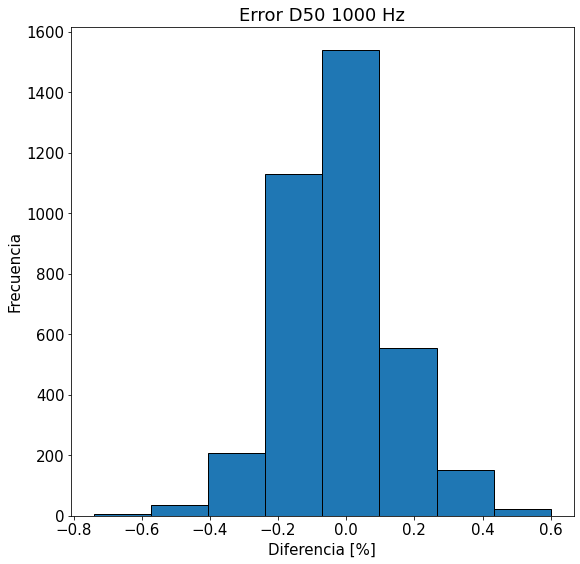

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

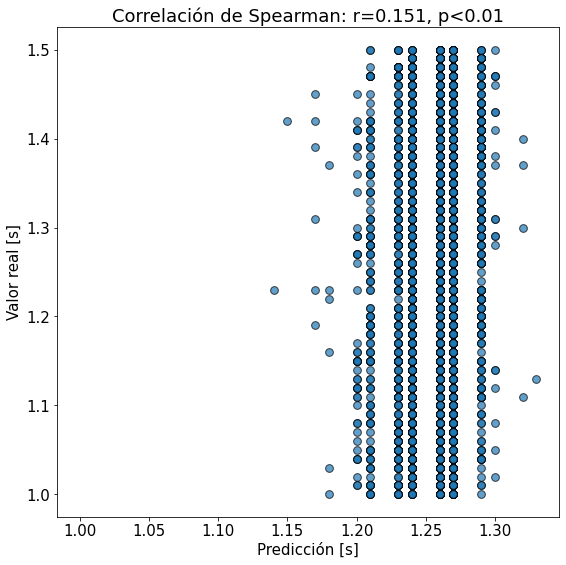

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

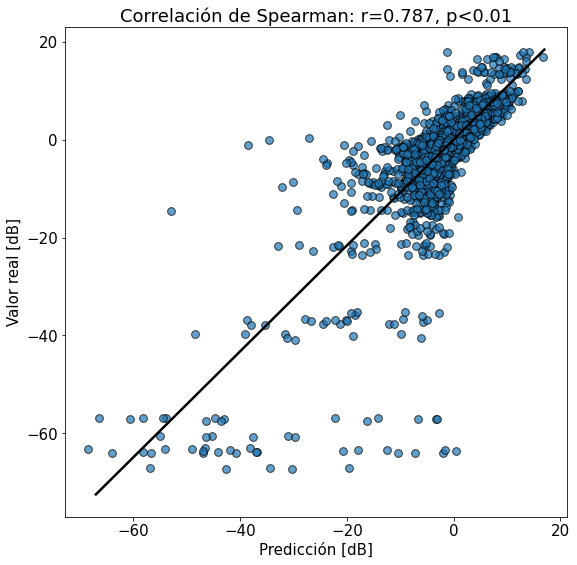

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

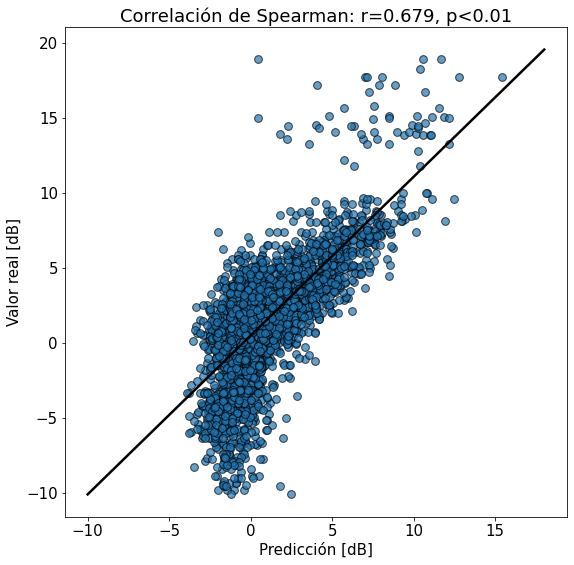

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

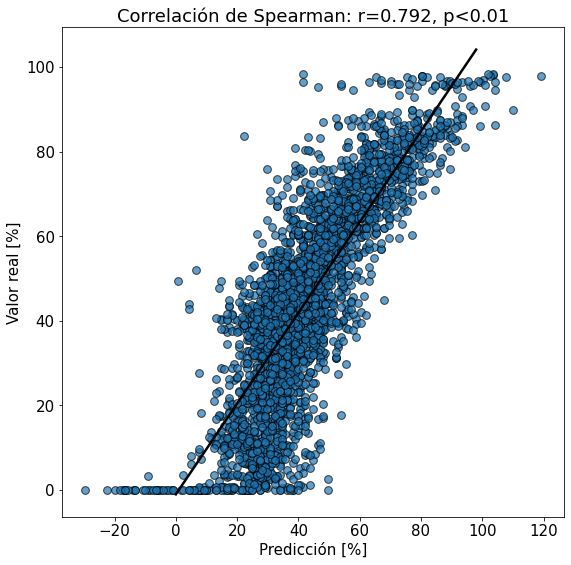

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

2000 Hz

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE con ruido')

band = 2000

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-12.654755036576223
2.8414795262466273


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

1.4063960570701581
5.641816066856819
6.359072382814842
78.56794607711058


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.0726310499188703
Máximo y_train: 2.8414795262466273
Mínimo y_train: -12.654755036576223


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
13/13 [==============================] - 2s 33ms/step - loss: 1.2419 - val_loss: 0.8691
Epoch 2/500
13/13 [==============================] - 0s 16ms/step - loss: 0.8907 - val_loss: 0.8168
Epoch 3/500
13/13 [==============================] - 0s 15ms/step - loss: 0.7581 - val_loss: 0.7791
Epoch 4/500
13/13 [==============================] - 0s 14ms/step - loss: 0.6937 - val_loss: 0.7507
Epoch 5/500
13/13 [==============================] - 0s 14ms/step - loss: 0.6446 - val_loss: 0.7334
Epoch 6/500
13/13 [==============================] - 0s 14ms/step - loss: 0.6172 - val_loss: 0.7193
Epoch 7/500
13/13 [==============================] - 0s 14ms/step - loss: 0.5933 - val_loss: 0.6979
Epoch 8/500
13/13 [==============================] - 0s 14ms/step - loss: 0.5808 - val_loss: 0.6739
Epoch 9/500
13/13 [==============================] - 0s 14ms/step - loss: 0.5668 - val_loss: 0.6561
Epoch 10/500
13/13 [==============================] - 0s 14ms/step - loss: 0.5527 - val_loss: 0.6503

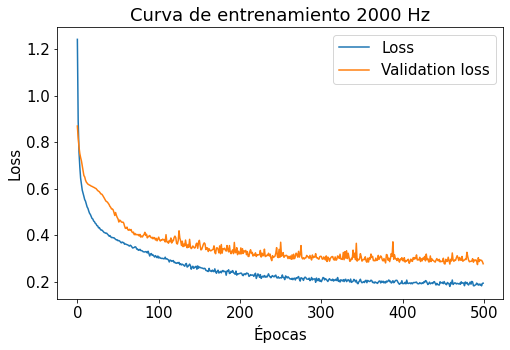

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([ 77., 276., 742., 689., 763., 731., 315.,  53.]),
 array([-0.27  , -0.2025, -0.135 , -0.0675,  0.    ,  0.0675,  0.135 ,
         0.2025,  0.27  ]),
 <a list of 8 Patch objects>)

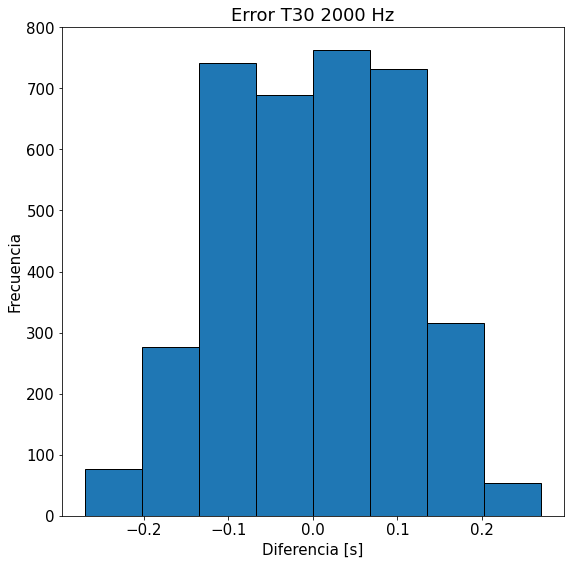

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([2.000e+00, 2.600e+01, 2.691e+03, 8.770e+02, 2.600e+01, 8.000e+00,
        1.000e+01, 6.000e+00]),
 array([-6.06  , -3.9775, -1.895 ,  0.1875,  2.27  ,  4.3525,  6.435 ,
         8.5175, 10.6   ]),
 <a list of 8 Patch objects>)

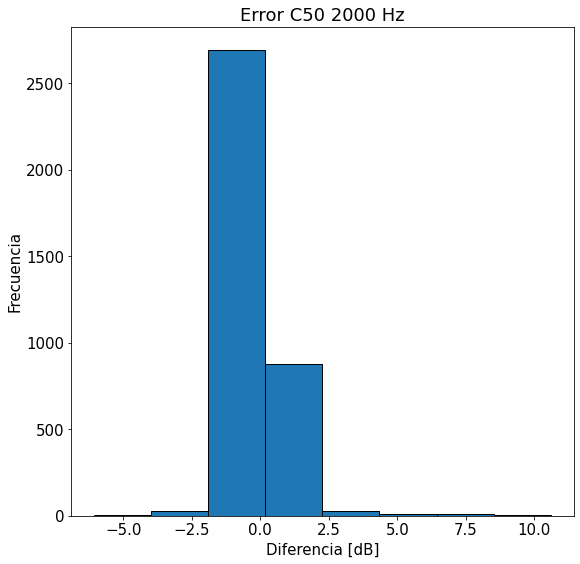

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([1.000e+00, 6.000e+00, 1.200e+01, 9.900e+01, 1.605e+03, 1.665e+03,
        2.150e+02, 4.300e+01]),
 array([-2.59  , -2.0875, -1.585 , -1.0825, -0.58  , -0.0775,  0.425 ,
         0.9275,  1.43  ]),
 <a list of 8 Patch objects>)

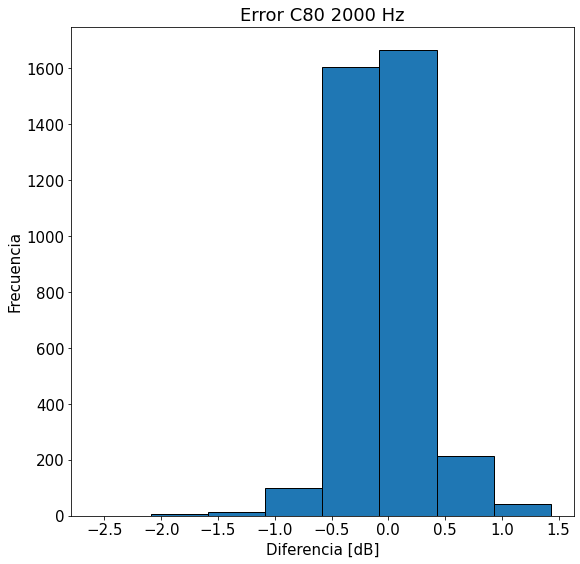

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([   4.,   29.,  118.,  859., 1927.,  576.,  117.,   16.]),
 array([-0.8    , -0.62125, -0.4425 , -0.26375, -0.085  ,  0.09375,
         0.2725 ,  0.45125,  0.63   ]),
 <a list of 8 Patch objects>)

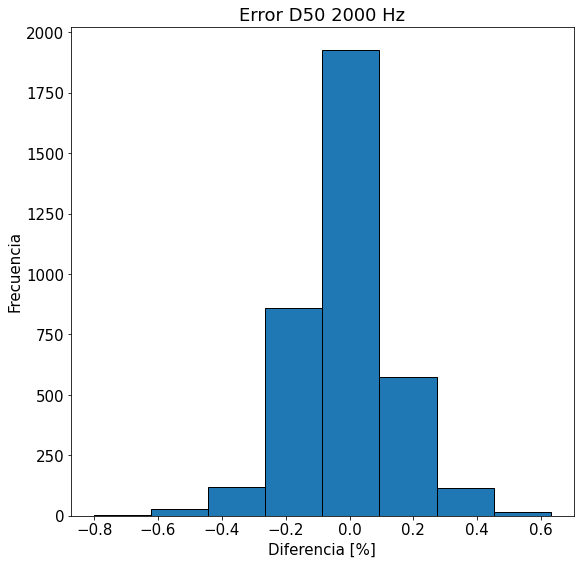

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

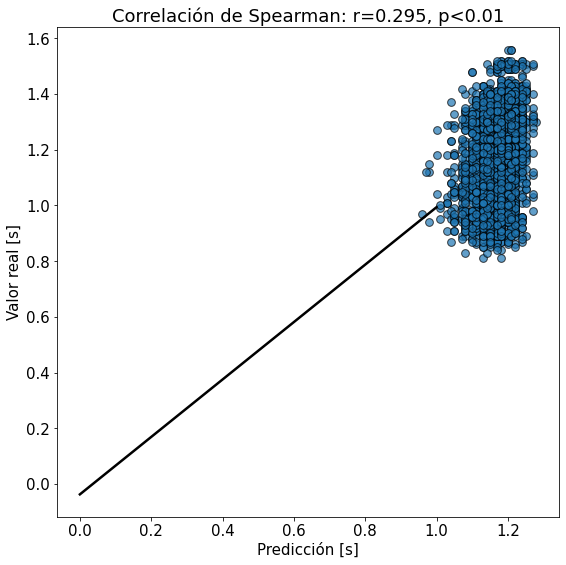

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

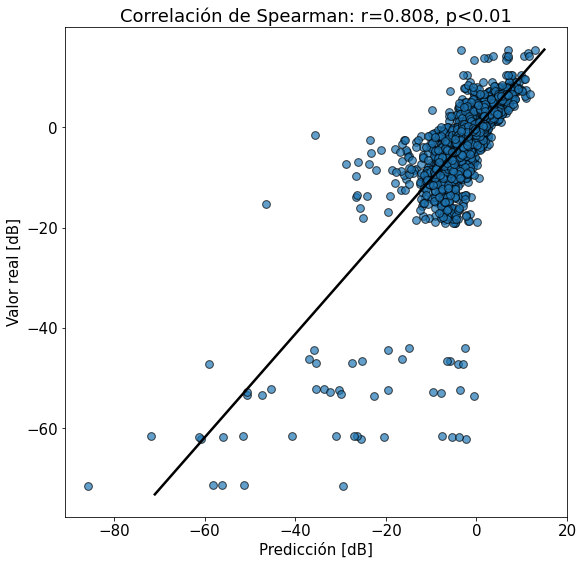

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

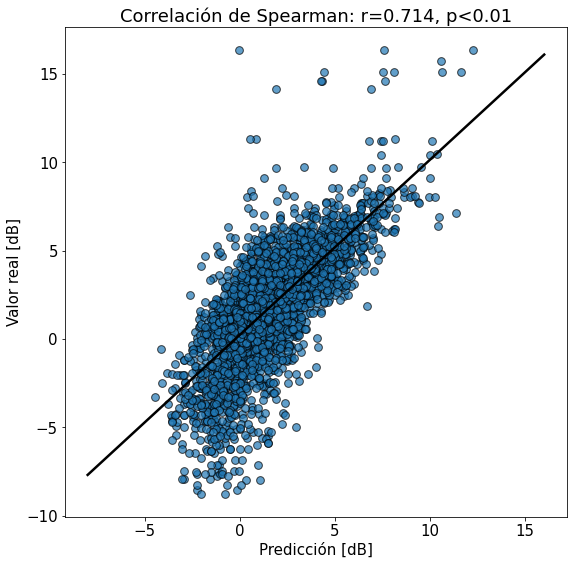

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

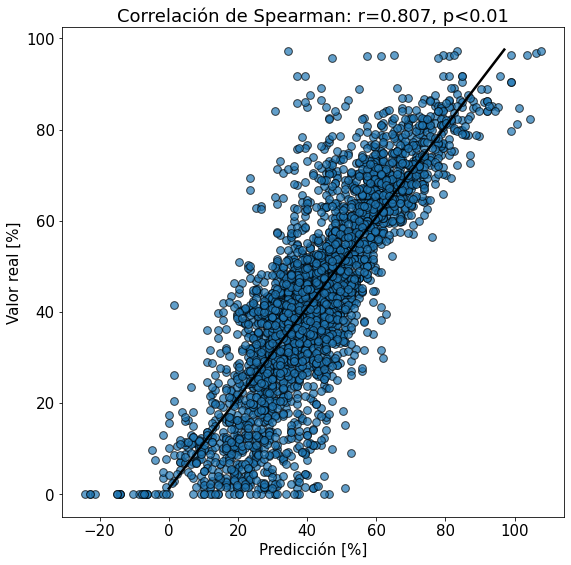

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

4000 Hz

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE con ruido')

band = 4000

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-9.51659164916318
1.667242357381085


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

1.3990636362642093
6.333825455014958
7.059266361344854
81.12904714124497


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.0882076021813779
Máximo y_train: 1.667242357381085
Mínimo y_train: -9.51659164916318


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
13/13 [==============================] - 2s 33ms/step - loss: 1.5022 - val_loss: 0.6533
Epoch 2/500
13/13 [==============================] - 0s 15ms/step - loss: 0.8316 - val_loss: 0.6190
Epoch 3/500
13/13 [==============================] - 0s 15ms/step - loss: 0.6202 - val_loss: 0.5940
Epoch 4/500
13/13 [==============================] - 0s 14ms/step - loss: 0.5361 - val_loss: 0.5768
Epoch 5/500
13/13 [==============================] - 0s 14ms/step - loss: 0.4908 - val_loss: 0.5598
Epoch 6/500
13/13 [==============================] - 0s 14ms/step - loss: 0.4541 - val_loss: 0.5471
Epoch 7/500
13/13 [==============================] - 0s 14ms/step - loss: 0.4392 - val_loss: 0.5347
Epoch 8/500
13/13 [==============================] - 0s 14ms/step - loss: 0.4178 - val_loss: 0.5242
Epoch 9/500
13/13 [==============================] - 0s 14ms/step - loss: 0.4031 - val_loss: 0.5159
Epoch 10/500
13/13 [==============================] - 0s 14ms/step - loss: 0.3911 - val_loss: 0.5080

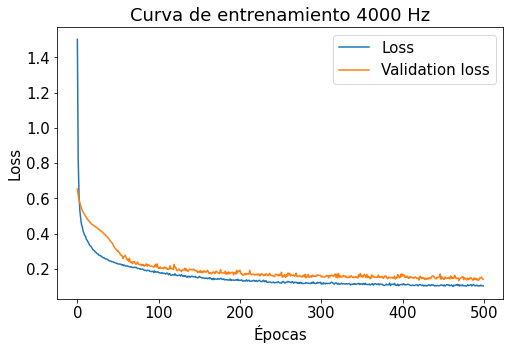

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([ 55., 171., 463., 854., 995., 768., 311.,  29.]),
 array([-0.33, -0.25, -0.17, -0.09, -0.01,  0.07,  0.15,  0.23,  0.31]),
 <a list of 8 Patch objects>)

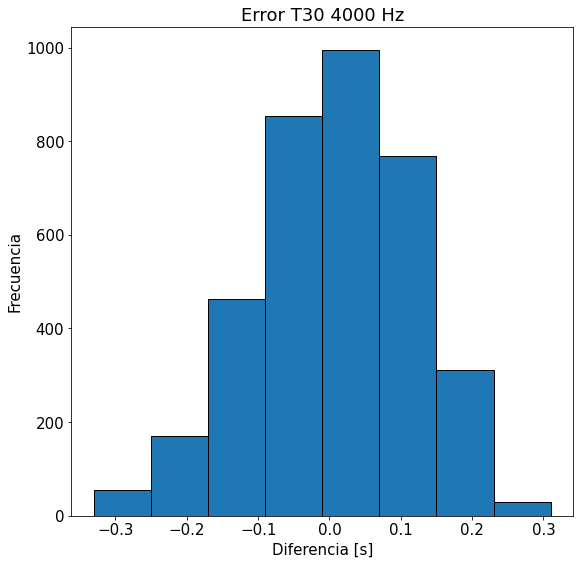

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([   6.,   25., 1061., 2512.,   24.,    7.,    8.,    3.]),
 array([-5.33  , -3.6025, -1.875 , -0.1475,  1.58  ,  3.3075,  5.035 ,
         6.7625,  8.49  ]),
 <a list of 8 Patch objects>)

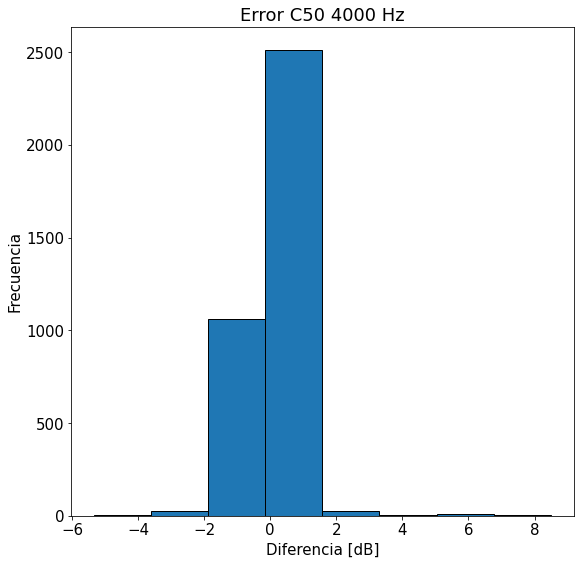

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([   5.,   65.,  433., 1823., 1061.,  198.,   38.,   23.]),
 array([-1.18 , -0.875, -0.57 , -0.265,  0.04 ,  0.345,  0.65 ,  0.955,
         1.26 ]),
 <a list of 8 Patch objects>)

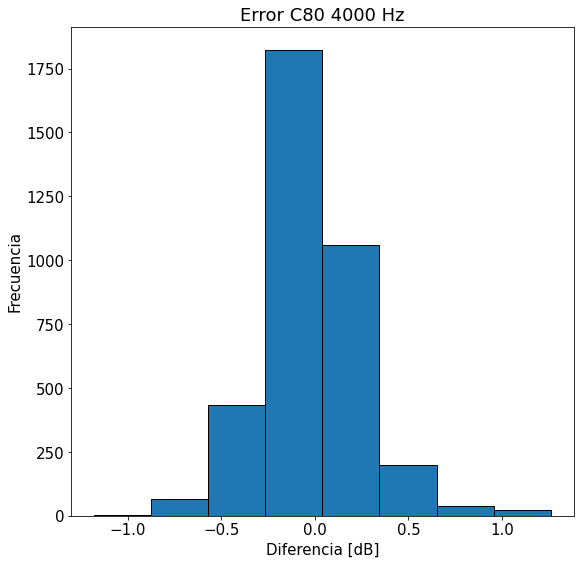

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([   4.,   40.,  116., 1231., 1876.,  306.,   61.,   12.]),
 array([-0.71   , -0.54375, -0.3775 , -0.21125, -0.045  ,  0.12125,
         0.2875 ,  0.45375,  0.62   ]),
 <a list of 8 Patch objects>)

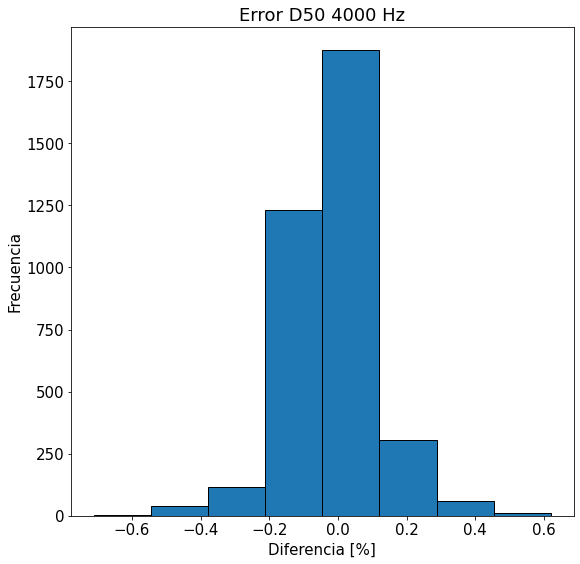

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

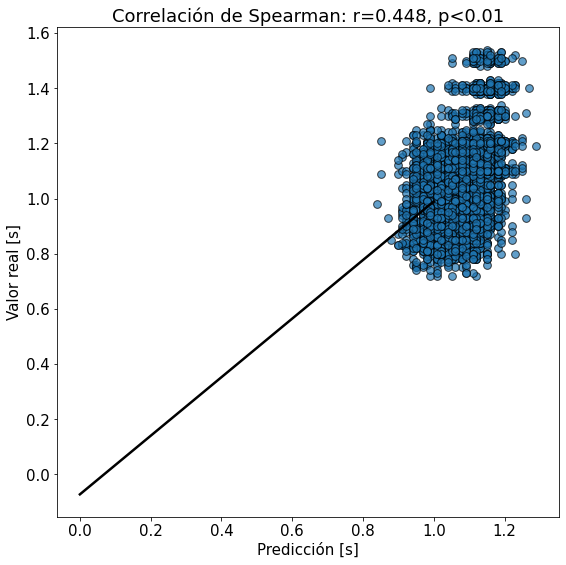

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

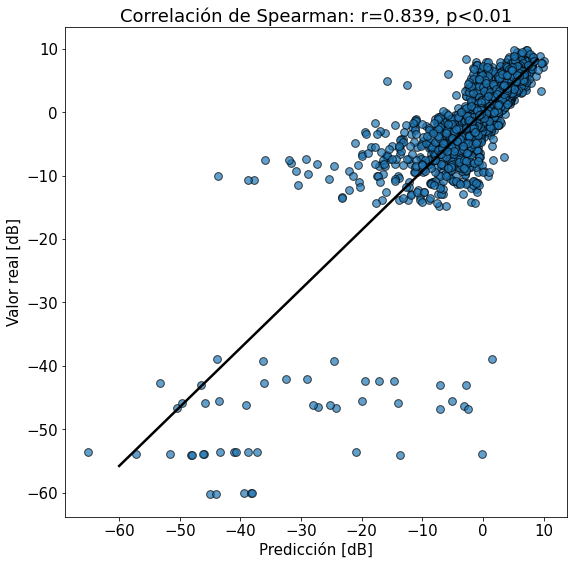

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

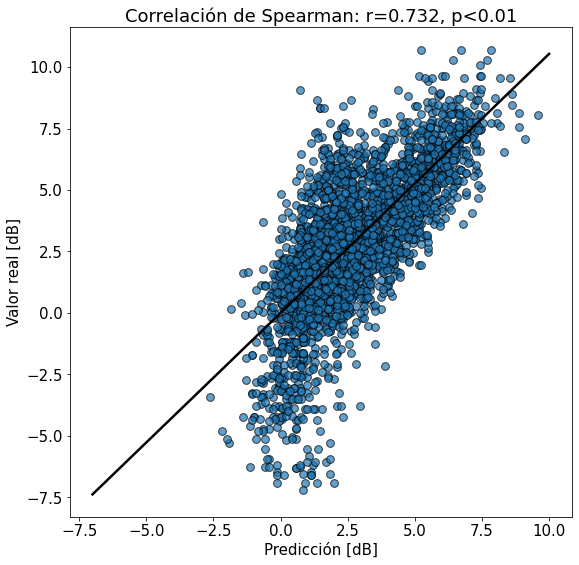

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

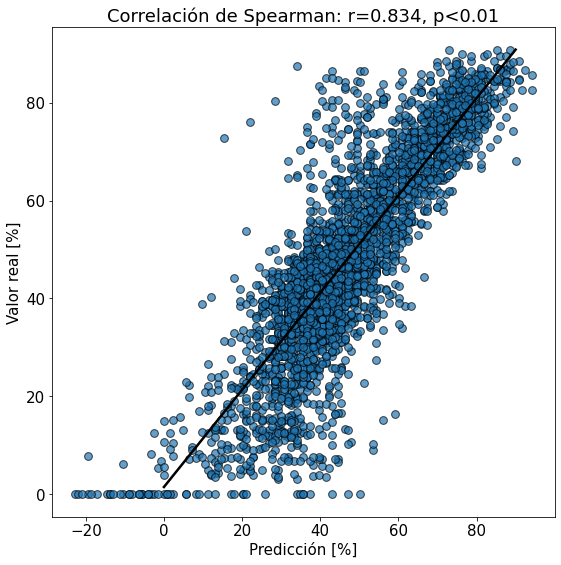

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

8000 Hz

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE con ruido')

band = 8000

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-5.284433437621532
1.5480790000093614


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

1.4000104352245661
7.665380914149903
8.416558292616171
85.3837163581236


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.12861800436238865
Máximo y_train: 1.5480790000093614
Mínimo y_train: -5.284433437621532


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
13/13 [==============================] - 14s 91ms/step - loss: 1.0417 - val_loss: 0.4368
Epoch 2/500
13/13 [==============================] - 0s 14ms/step - loss: 0.5211 - val_loss: 0.3616
Epoch 3/500
13/13 [==============================] - 0s 14ms/step - loss: 0.3764 - val_loss: 0.3184
Epoch 4/500
13/13 [==============================] - 0s 14ms/step - loss: 0.3044 - val_loss: 0.2911
Epoch 5/500
13/13 [==============================] - 0s 13ms/step - loss: 0.2682 - val_loss: 0.2782
Epoch 6/500
13/13 [==============================] - 0s 16ms/step - loss: 0.2431 - val_loss: 0.2724
Epoch 7/500
13/13 [==============================] - 0s 14ms/step - loss: 0.2270 - val_loss: 0.2684
Epoch 8/500
13/13 [==============================] - 0s 14ms/step - loss: 0.2139 - val_loss: 0.2679
Epoch 9/500
13/13 [==============================] - 0s 15ms/step - loss: 0.2028 - val_loss: 0.2674
Epoch 10/500
13/13 [==============================] - 0s 15ms/step - loss: 0.1930 - val_loss: 0.266

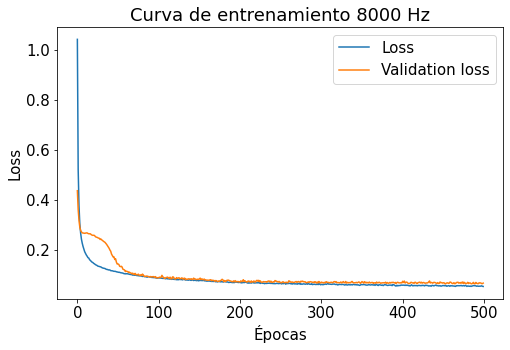

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([   6.,   96.,  332.,  714., 1005.,  948.,  457.,   88.]),
 array([-0.39   , -0.30875, -0.2275 , -0.14625, -0.065  ,  0.01625,
         0.0975 ,  0.17875,  0.26   ]),
 <a list of 8 Patch objects>)

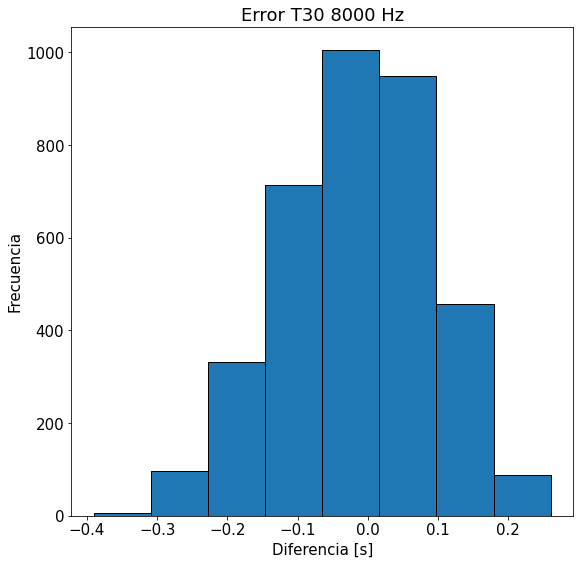

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([1.000e+00, 4.200e+01, 2.229e+03, 1.316e+03, 3.300e+01, 1.600e+01,
        7.000e+00, 2.000e+00]),
 array([-3.14 , -2.085, -1.03 ,  0.025,  1.08 ,  2.135,  3.19 ,  4.245,
         5.3  ]),
 <a list of 8 Patch objects>)

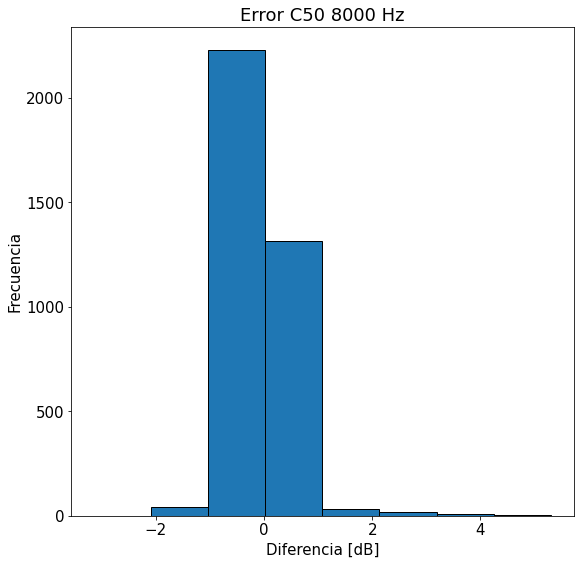

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([  24.,  128.,  500., 2012.,  812.,  139.,   23.,    8.]),
 array([-0.94  , -0.6875, -0.435 , -0.1825,  0.07  ,  0.3225,  0.575 ,
         0.8275,  1.08  ]),
 <a list of 8 Patch objects>)

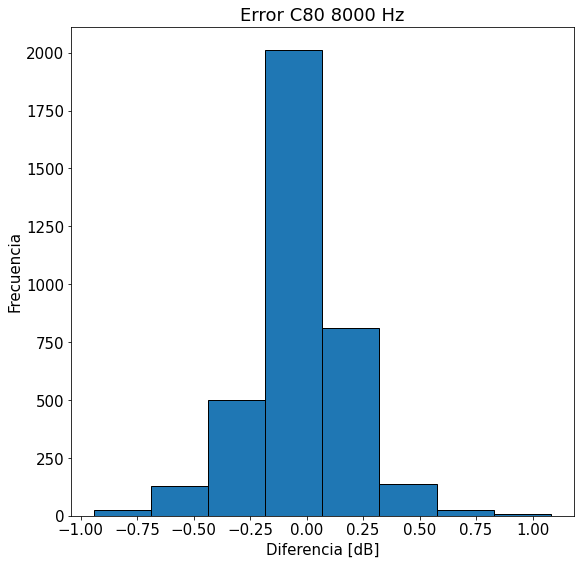

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([3.800e+01, 1.360e+02, 9.800e+02, 2.098e+03, 3.310e+02, 4.300e+01,
        1.900e+01, 1.000e+00]),
 array([-0.53   , -0.37125, -0.2125 , -0.05375,  0.105  ,  0.26375,
         0.4225 ,  0.58125,  0.74   ]),
 <a list of 8 Patch objects>)

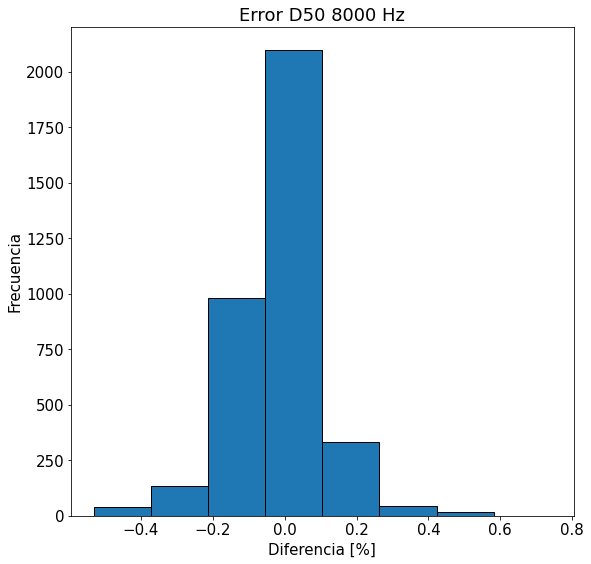

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

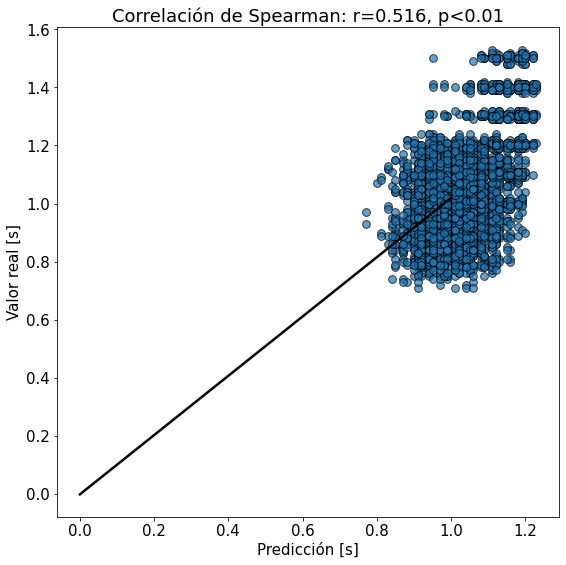

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

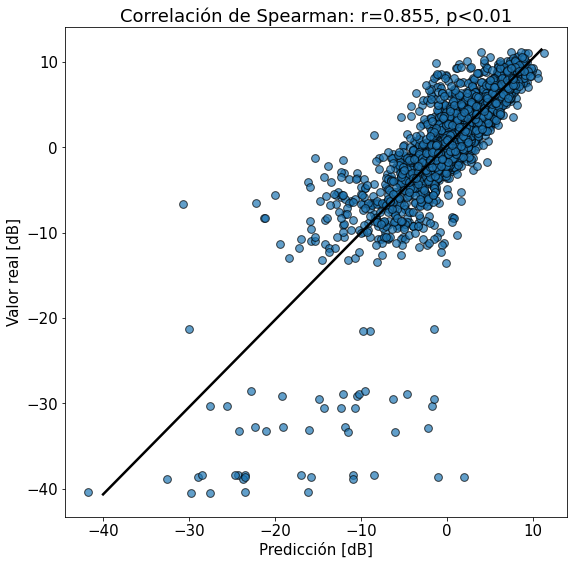

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

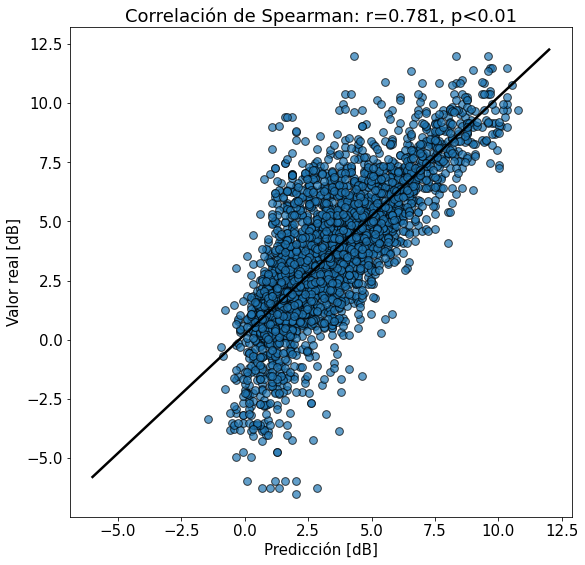

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

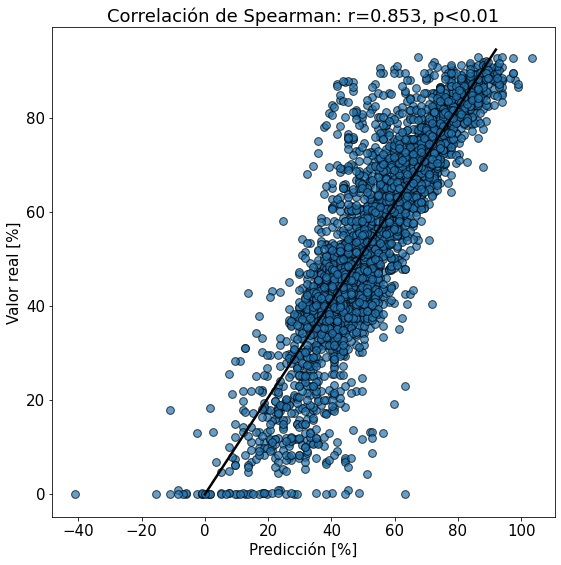

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

# Nueva Base de datos:

Generé una nueva base de datos que solo tiene valores de RIRs entre 1 y 1.5 s, a diferencia de los casos anteriores que separaba entre estos valores de TRs de una base de datos mucho mayor.

Además de esto, los pasos en la generación de estas RIRs son de 0.01 y no de 0.1 como en la base de datos anterior

# Entrenamiento RIRs reales y valores normalizados: Tr entre 1 y 1.5 [s]

En este caso, además de normalizar todo con el percentil 95, paso todos los valores a su escala sin dB ni %

In [ ]:
#Librerías necesarias:
import sys 
sys.path.append('/content/drive/My Drive/Tesis/Notebooks/scripts')
from model_2 import modelo
from scipy import stats

import numpy as np
import os
from librosa import load
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

!pip install pickle5
import pickle5 as pickle
import matplotlib.pyplot as plt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


Outliers:

In [ ]:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE sinteticos y reales - 1 a 1.5s')
with open('outliers_1_1.5.pickle', 'rb') as handle:
  outliers = list(set(pickle.load(handle)))

125 Hz:

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE sinteticos y reales - 1 a 1.5s')

band = 125

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

In [ ]:
print(list(tae_dic.keys())[10000])
print(list(params_dic.keys())[10000])

F1s3-sintetica_Seed917223992_Tr1.41
F1s3-sintetica_Seed1397686503_Tr1.12


In [ ]:
print(len(list(tae_dic.keys())))
print(len(list(params_dic.keys())))

309250
309250


In [ ]:
print(list(tae_dic.keys())[0:5])
print(list(params_dic.keys())[0:5])

['F1s3-sintetica_Seed100001509_Tr1.42', 'F1s3-sintetica_Seed1000298131_Tr1.05', 'F1s3-sintetica_Seed1000302612_Tr1.35', 'F1s3-sintetica_Seed1000329105_Tr1.02', 'F1s3-sintetica_Seed1000399819_Tr1.21']
['F1s3-sintetica_Seed100001509_Tr1.42', 'F2s3-sintetica_Seed100001509_Tr1.42', 'F3s3-sintetica_Seed100001509_Tr1.42', 'F4s3-sintetica_Seed100001509_Tr1.42', 'F5s3-sintetica_Seed100001509_Tr1.42']


In [ ]:
#print(params_dic['F1s3-sintetica_Seed1807110498_Tr3.0'])

In [ ]:
#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

In [ ]:
#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
print(len(y))

103360


In [ ]:
#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-73.39020654455067
16.54624787546935


In [ ]:
print(T30_perc_95) 
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

1.51293363316404
0.8068721059733104
3.737603465628958
54.63141474979049


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
print(X_train.shape)
print(y_train.shape)

(82688, 200, 1)
(82688, 4, 1)


In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.16345087958032295


In [ ]:
assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo y_train: 16.54624787546935
Mínimo y_train: -73.39020654455067


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
73/73 [==============================] - 18s 31ms/step - loss: 8.9329 - val_loss: 8.5434
Epoch 2/500
73/73 [==============================] - 1s 15ms/step - loss: 6.2317 - val_loss: 6.4214
Epoch 3/500
73/73 [==============================] - 1s 17ms/step - loss: 5.8850 - val_loss: 5.8753
Epoch 4/500
73/73 [==============================] - 1s 17ms/step - loss: 5.7479 - val_loss: 5.7024
Epoch 5/500
73/73 [==============================] - 1s 15ms/step - loss: 5.6652 - val_loss: 5.6713
Epoch 6/500
73/73 [==============================] - 1s 15ms/step - loss: 5.5875 - val_loss: 5.7862
Epoch 7/500
73/73 [==============================] - 1s 15ms/step - loss: 5.5346 - val_loss: 5.5999
Epoch 8/500
73/73 [==============================] - 1s 15ms/step - loss: 5.4914 - val_loss: 5.4075
Epoch 9/500
73/73 [==============================] - 1s 15ms/step - loss: 5.4567 - val_loss: 5.3116
Epoch 10/500
73/73 [==============================] - 1s 16ms/step - loss: 5.4227 - val_loss: 5.290

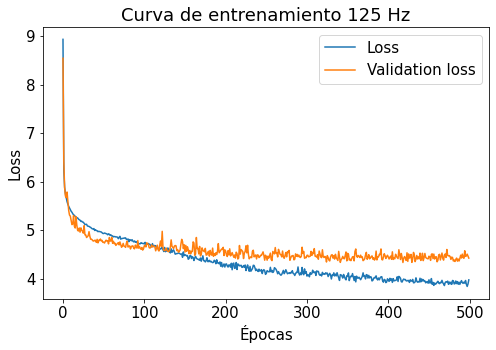

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
blind_estimation_model.predict(X_test[5,:,0].reshape(1,-1,1))[0]

array([ 0.8607886, -5.367636 , -0.2559123,  0.5120915], dtype=float32)

In [ ]:
np.round(y_test[0,:,0].reshape(1,-1,1),1)

array([[[0.7],
        [3.9],
        [1.1],
        [1.2]]])

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
prediction[0]

array([ 0.82, -2.45,  0.32,  0.74], dtype=float32)

In [ ]:
np.round(prediction[1] - np.round(y_test[1,:,0].reshape(1,-1,1),2).flatten(),2)

array([0.12, 0.84, 0.28, 0.08])

In [ ]:
np.round(prediction[1][0] - np.round(y_test[1,:,0].reshape(1,-1,1),2).flatten()[0],2)

0.12

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([  13.,   34.,  105., 1872., 9482., 7633., 1458.,   75.]),
 array([-0.55  , -0.4375, -0.325 , -0.2125, -0.1   ,  0.0125,  0.125 ,
         0.2375,  0.35  ]),
 <a list of 8 Patch objects>)

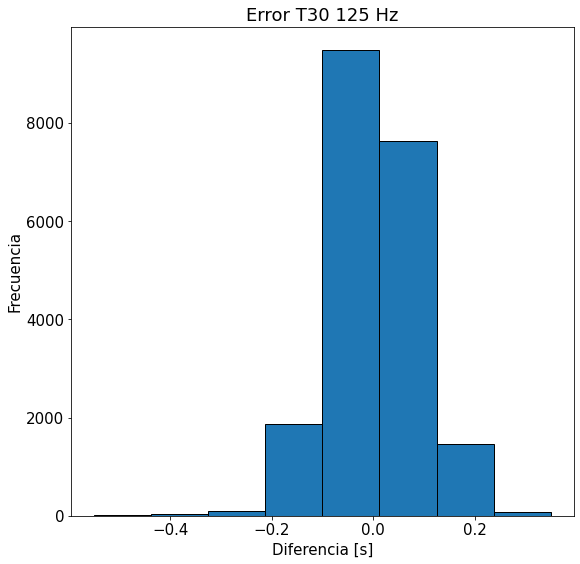

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([4.0000e+00, 2.2300e+02, 1.9675e+04, 6.0900e+02, 9.0000e+01,
        3.0000e+01, 2.3000e+01, 1.8000e+01]),
 array([-32.02   , -19.58625,  -7.1525 ,   5.28125,  17.715  ,  30.14875,
         42.5825 ,  55.01625,  67.45   ]),
 <a list of 8 Patch objects>)

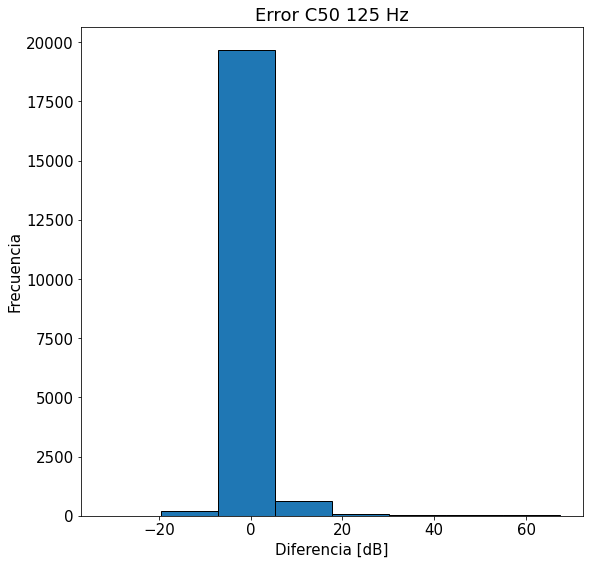

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([6.100e+01, 4.457e+03, 1.391e+04, 2.001e+03, 1.230e+02, 9.100e+01,
        1.900e+01, 1.000e+01]),
 array([-2.66   , -1.60375, -0.5475 ,  0.50875,  1.565  ,  2.62125,
         3.6775 ,  4.73375,  5.79   ]),
 <a list of 8 Patch objects>)

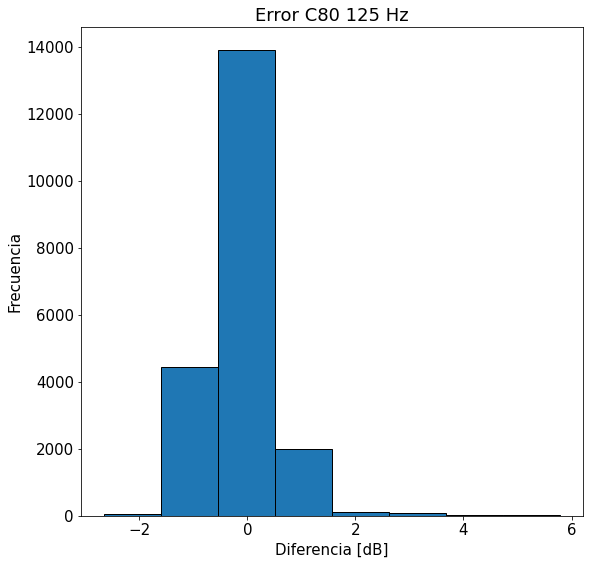

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([  14.,  241., 1988., 6628., 7966., 3362.,  463.,   10.]),
 array([-0.97   , -0.74875, -0.5275 , -0.30625, -0.085  ,  0.13625,
         0.3575 ,  0.57875,  0.8    ]),
 <a list of 8 Patch objects>)

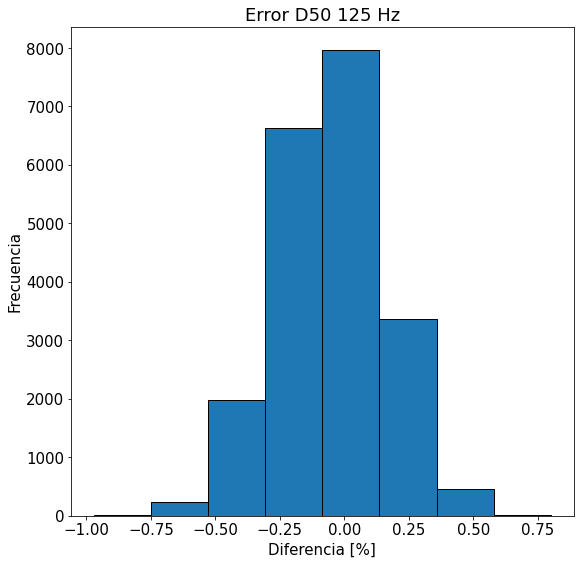

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

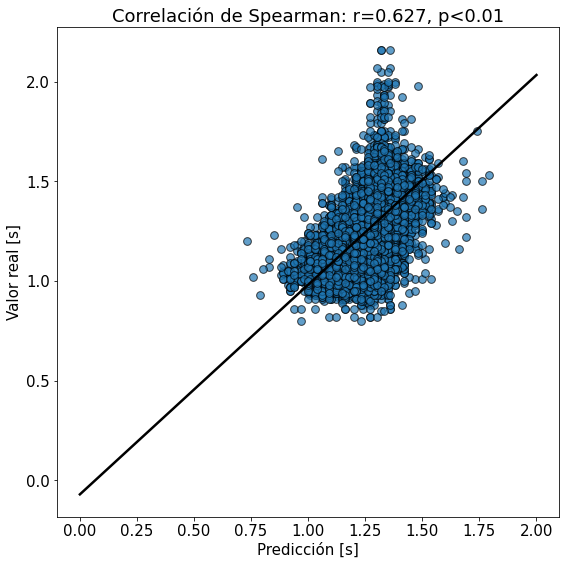

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

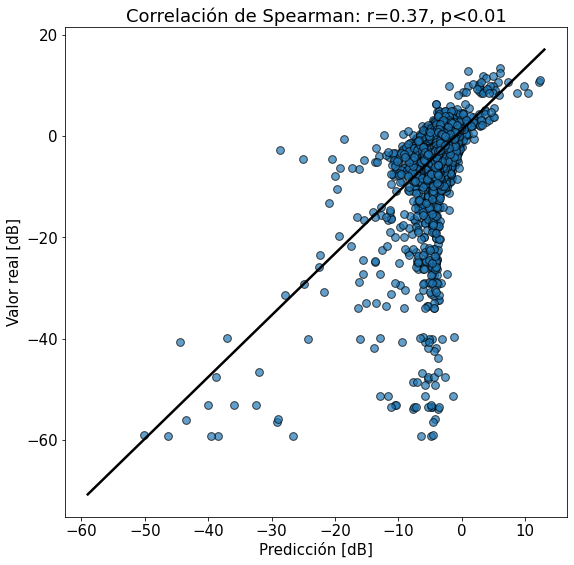

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

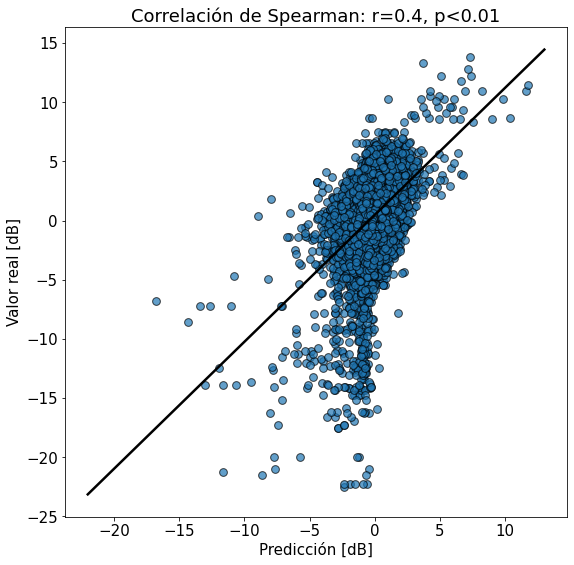

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

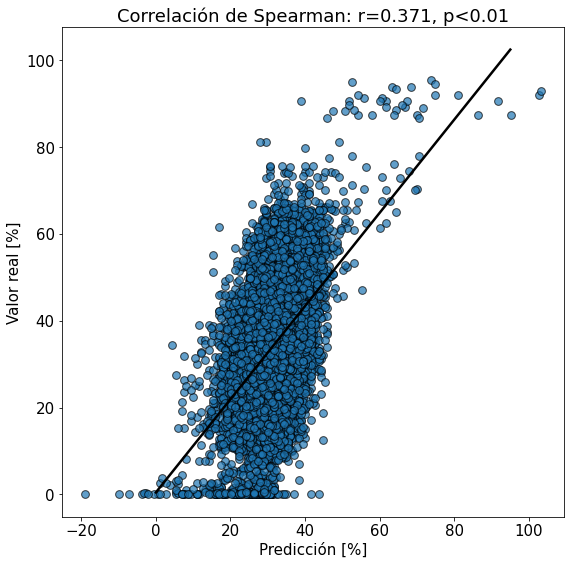

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

250 Hz:

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE sinteticos y reales - 1 a 1.5s')

band = 250

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-53.956341431325946
10.324961435516638


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

1.4886187501576005
1.0022244589752651
3.714696605843349
55.743799781593395


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.1589202471316584
Máximo y_train: 10.324961435516638
Mínimo y_train: -53.956341431325946


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
73/73 [==============================] - 2s 16ms/step - loss: 2.9227 - val_loss: 2.4813
Epoch 2/500
73/73 [==============================] - 1s 13ms/step - loss: 2.2885 - val_loss: 2.1244
Epoch 3/500
73/73 [==============================] - 1s 12ms/step - loss: 2.1949 - val_loss: 2.0287
Epoch 4/500
73/73 [==============================] - 1s 13ms/step - loss: 2.1385 - val_loss: 2.0569
Epoch 5/500
73/73 [==============================] - 1s 13ms/step - loss: 2.0994 - val_loss: 2.1724
Epoch 6/500
73/73 [==============================] - 1s 12ms/step - loss: 2.0490 - val_loss: 2.2134
Epoch 7/500
73/73 [==============================] - 1s 13ms/step - loss: 2.0063 - val_loss: 2.1999
Epoch 8/500
73/73 [==============================] - 1s 12ms/step - loss: 1.9719 - val_loss: 2.3075
Epoch 9/500
73/73 [==============================] - 1s 13ms/step - loss: 1.9477 - val_loss: 1.9711
Epoch 10/500
73/73 [==============================] - 1s 13ms/step - loss: 1.9256 - val_loss: 1.8529

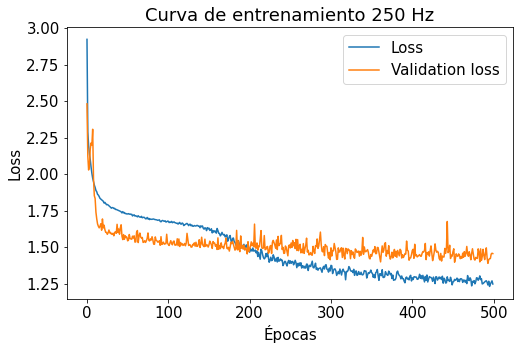

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([  35.,  562., 3857., 9226., 6173.,  727.,   81.,   11.]),
 array([-0.29  , -0.2075, -0.125 , -0.0425,  0.04  ,  0.1225,  0.205 ,
         0.2875,  0.37  ]),
 <a list of 8 Patch objects>)

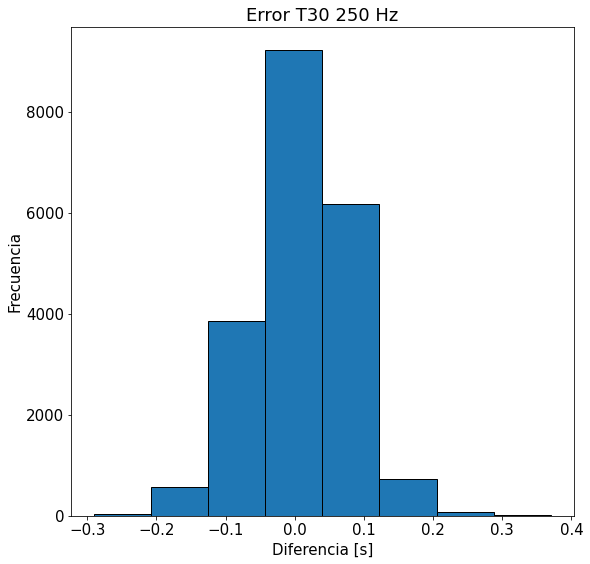

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([2.6700e+02, 2.0059e+04, 2.4700e+02, 4.9000e+01, 2.2000e+01,
        1.0000e+01, 7.0000e+00, 1.1000e+01]),
 array([-11.21   ,  -3.34375,   4.5225 ,  12.38875,  20.255  ,  28.12125,
         35.9875 ,  43.85375,  51.72   ]),
 <a list of 8 Patch objects>)

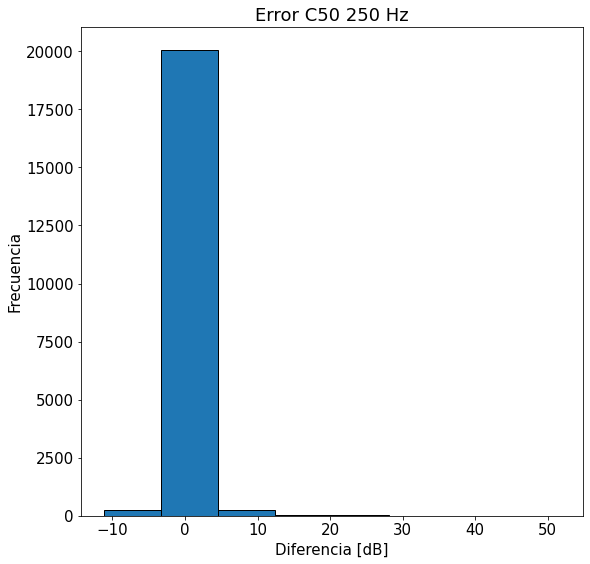

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([3.0000e+00, 2.1280e+03, 1.7577e+04, 7.6600e+02, 1.2400e+02,
        5.1000e+01, 2.0000e+01, 3.0000e+00]),
 array([-2.64   , -1.54625, -0.4525 ,  0.64125,  1.735  ,  2.82875,
         3.9225 ,  5.01625,  6.11   ]),
 <a list of 8 Patch objects>)

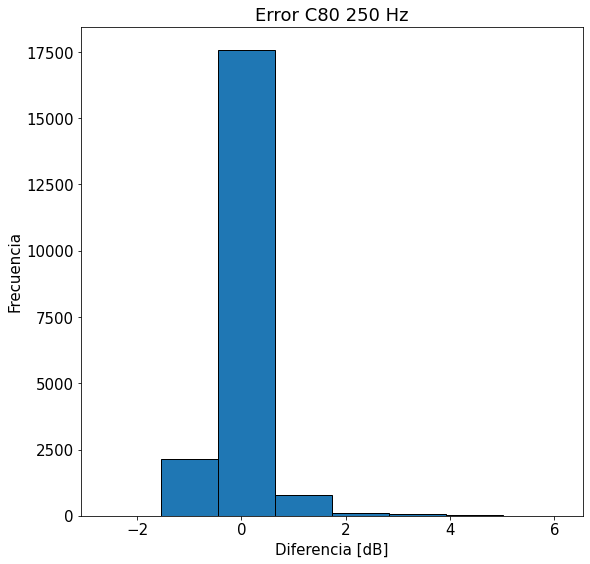

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([  60., 1278., 6640., 8992., 3184.,  396.,  104.,   18.]),
 array([-0.57   , -0.39125, -0.2125 , -0.03375,  0.145  ,  0.32375,
         0.5025 ,  0.68125,  0.86   ]),
 <a list of 8 Patch objects>)

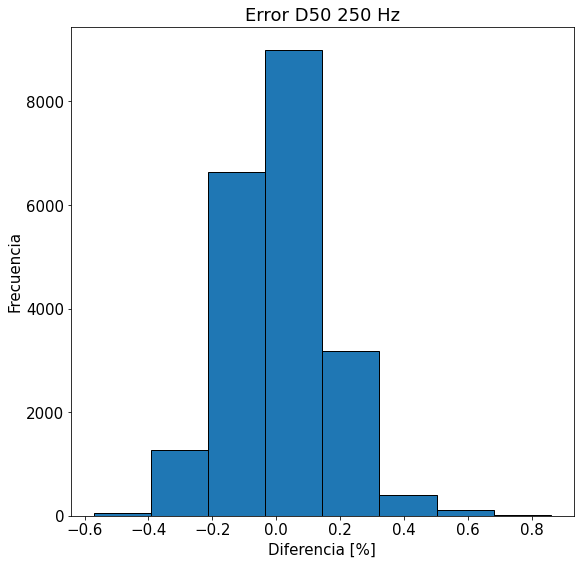

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

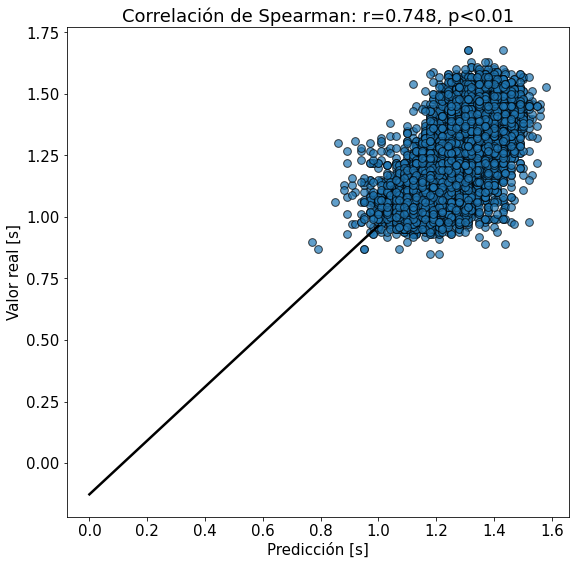

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

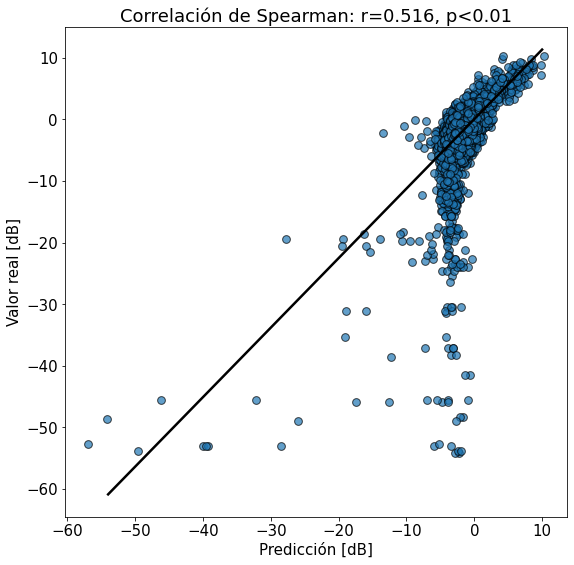

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

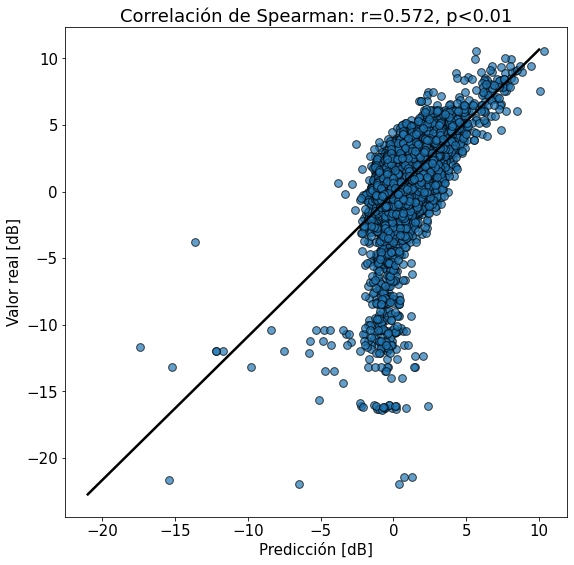

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

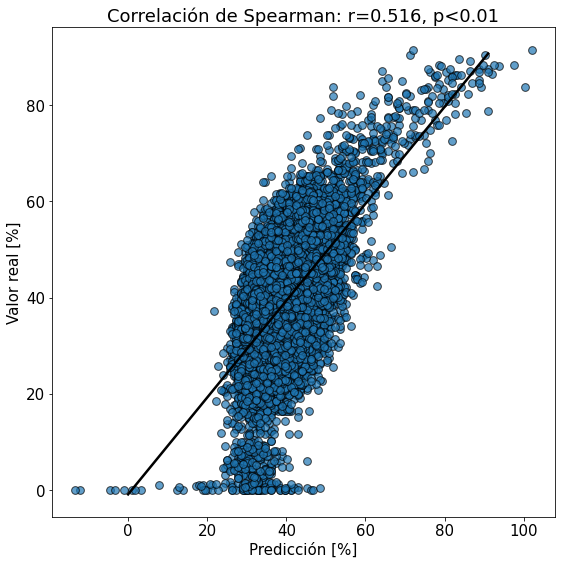

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

500 Hz

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE sinteticos y reales - 1 a 1.5s')

band = 500

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-69.4803572609809
26.253356293375774


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

1.4756405727053454
0.856727175032326
3.5049046246613162
54.91578691842963


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.14023290629132645
Máximo y_train: 26.253356293375774
Mínimo y_train: -69.4803572609809


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
73/73 [==============================] - 2s 16ms/step - loss: 3.1907 - val_loss: 1.9001
Epoch 2/500
73/73 [==============================] - 1s 13ms/step - loss: 2.1519 - val_loss: 2.2989
Epoch 3/500
73/73 [==============================] - 1s 13ms/step - loss: 2.0064 - val_loss: 2.7059
Epoch 4/500
73/73 [==============================] - 1s 12ms/step - loss: 1.9177 - val_loss: 2.9780
Epoch 5/500
73/73 [==============================] - 1s 12ms/step - loss: 1.8254 - val_loss: 3.7222
Epoch 6/500
73/73 [==============================] - 1s 13ms/step - loss: 1.7200 - val_loss: 3.7444
Epoch 7/500
73/73 [==============================] - 1s 13ms/step - loss: 1.6305 - val_loss: 2.9815
Epoch 8/500
73/73 [==============================] - 1s 12ms/step - loss: 1.5864 - val_loss: 2.6751
Epoch 9/500
73/73 [==============================] - 1s 13ms/step - loss: 1.5524 - val_loss: 1.7234
Epoch 10/500
73/73 [==============================] - 1s 13ms/step - loss: 1.5301 - val_loss: 1.4576

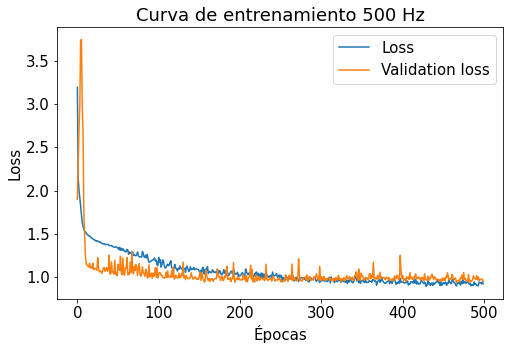

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([  26.,  367., 3133., 8627., 7204., 1244.,   58.,   13.]),
 array([-0.27   , -0.19625, -0.1225 , -0.04875,  0.025  ,  0.09875,
         0.1725 ,  0.24625,  0.32   ]),
 <a list of 8 Patch objects>)

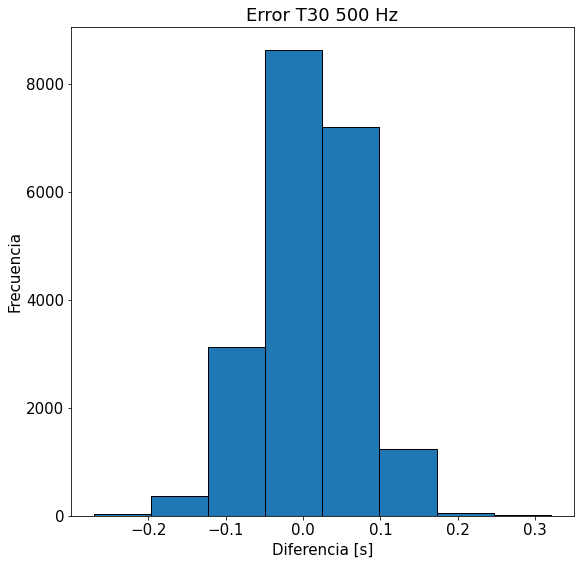

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([1.0000e+00, 3.0000e+00, 1.9782e+04, 8.3800e+02, 2.6000e+01,
        1.3000e+01, 5.0000e+00, 4.0000e+00]),
 array([-36.06   , -23.32125, -10.5825 ,   2.15625,  14.895  ,  27.63375,
         40.3725 ,  53.11125,  65.85   ]),
 <a list of 8 Patch objects>)

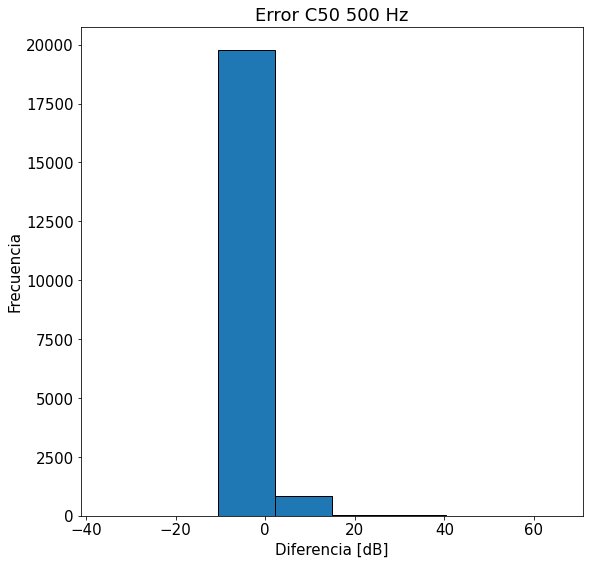

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([2.0000e+00, 5.0000e+00, 4.4400e+02, 1.9372e+04, 6.6700e+02,
        1.1900e+02, 5.4000e+01, 9.0000e+00]),
 array([-3.64  , -2.6075, -1.575 , -0.5425,  0.49  ,  1.5225,  2.555 ,
         3.5875,  4.62  ]),
 <a list of 8 Patch objects>)

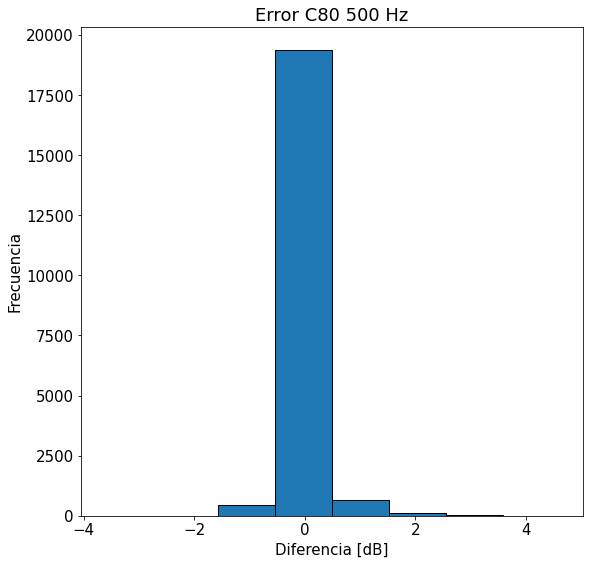

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([1.0000e+00, 3.0000e+00, 5.8100e+02, 1.0236e+04, 9.1270e+03,
        5.5900e+02, 1.1000e+02, 5.5000e+01]),
 array([-0.81   , -0.60875, -0.4075 , -0.20625, -0.005  ,  0.19625,
         0.3975 ,  0.59875,  0.8    ]),
 <a list of 8 Patch objects>)

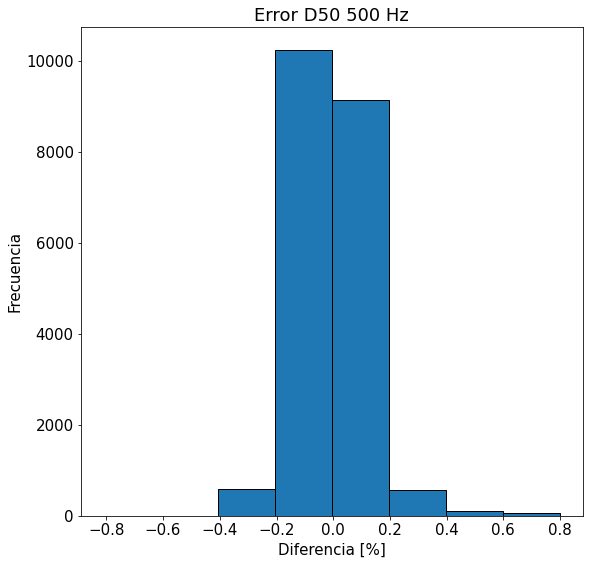

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

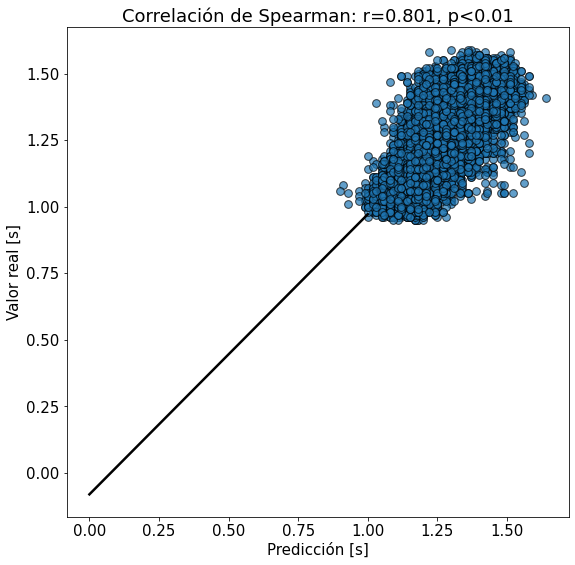

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

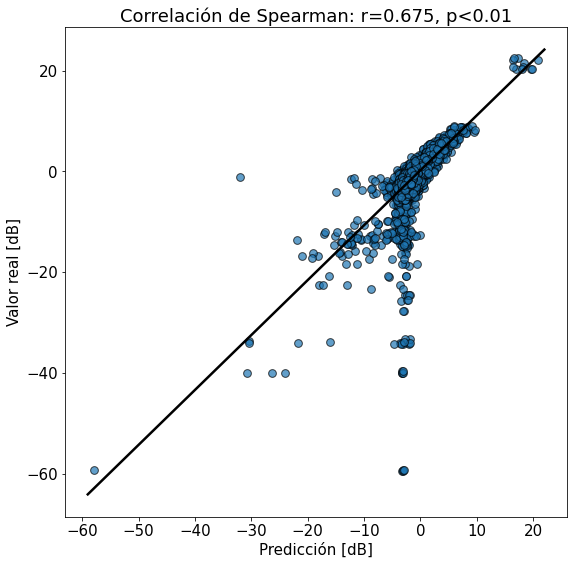

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

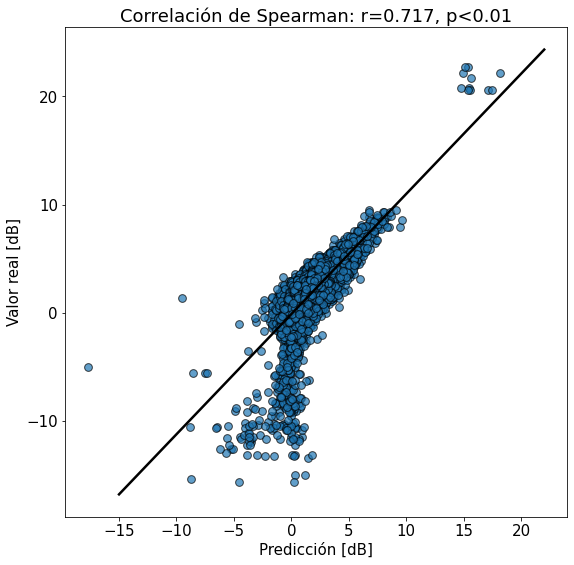

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

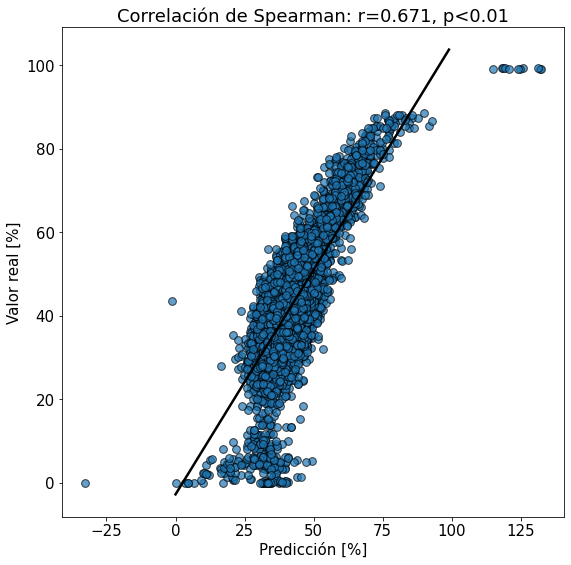

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

1000 Hz

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE sinteticos y reales - 1 a 1.5s')

band = 1000

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-110.52897512969353
31.443498870450256


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

1.4716634798495152
0.5785802084509579
3.296461511885122
53.32565811062243


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.1436011584390276
Máximo y_train: 31.443498870450256
Mínimo y_train: -110.52897512969353


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
73/73 [==============================] - 2s 17ms/step - loss: 4.2540 - val_loss: 4.4049
Epoch 2/500
73/73 [==============================] - 1s 13ms/step - loss: 3.6017 - val_loss: 4.3857
Epoch 3/500
73/73 [==============================] - 1s 13ms/step - loss: 3.4052 - val_loss: 4.4402
Epoch 4/500
73/73 [==============================] - 1s 12ms/step - loss: 3.2372 - val_loss: 4.8431
Epoch 5/500
73/73 [==============================] - 1s 13ms/step - loss: 2.9906 - val_loss: 4.8206
Epoch 6/500
73/73 [==============================] - 1s 13ms/step - loss: 2.7598 - val_loss: 4.1527
Epoch 7/500
73/73 [==============================] - 1s 13ms/step - loss: 2.6401 - val_loss: 3.1223
Epoch 8/500
73/73 [==============================] - 1s 12ms/step - loss: 2.5884 - val_loss: 3.3489
Epoch 9/500
73/73 [==============================] - 1s 12ms/step - loss: 2.5377 - val_loss: 3.7912
Epoch 10/500
73/73 [==============================] - 1s 12ms/step - loss: 2.5020 - val_loss: 2.9713

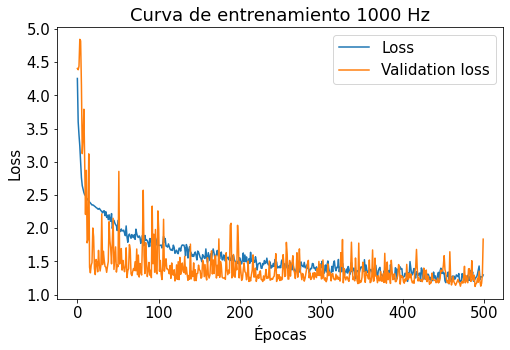

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([3.0000e+00, 2.0000e+00, 3.0000e+00, 2.1700e+02, 1.1493e+04,
        8.8260e+03, 1.1600e+02, 1.2000e+01]),
 array([-0.77 , -0.625, -0.48 , -0.335, -0.19 , -0.045,  0.1  ,  0.245,
         0.39 ]),
 <a list of 8 Patch objects>)

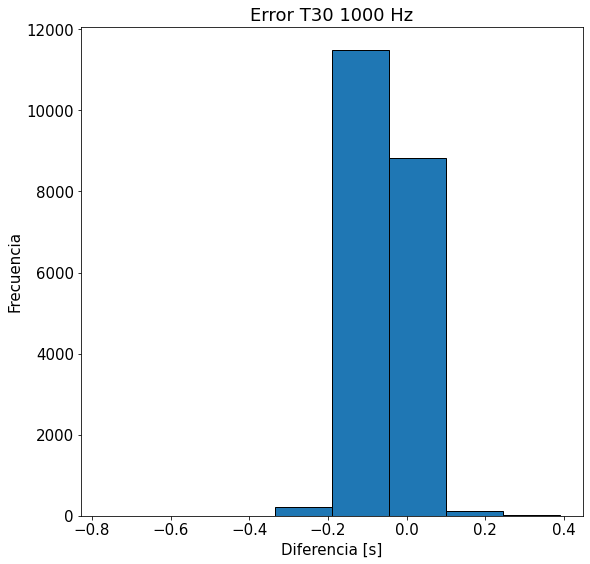

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([4.0000e+00, 7.0000e+00, 1.4500e+03, 1.9111e+04, 7.4000e+01,
        1.5000e+01, 1.0000e+00, 1.0000e+01]),
 array([-44.44 , -29.855, -15.27 ,  -0.685,  13.9  ,  28.485,  43.07 ,
         57.655,  72.24 ]),
 <a list of 8 Patch objects>)

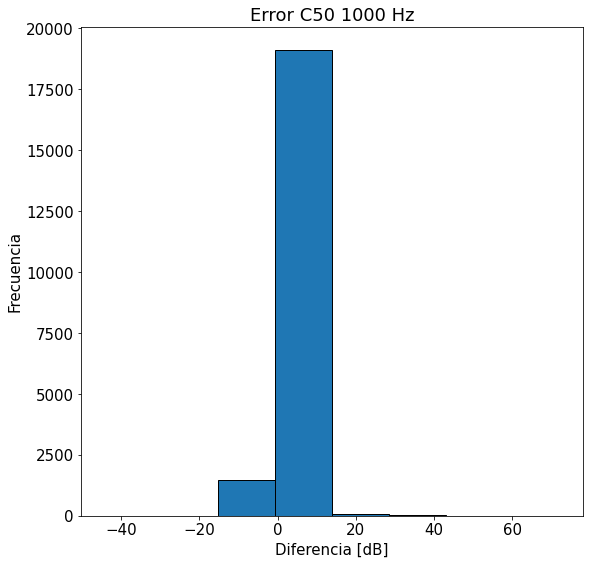

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([5.0000e+00, 1.2000e+01, 4.5700e+02, 1.7749e+04, 2.1410e+03,
        1.9600e+02, 7.4000e+01, 3.8000e+01]),
 array([-2.44   , -1.70625, -0.9725 , -0.23875,  0.495  ,  1.22875,
         1.9625 ,  2.69625,  3.43   ]),
 <a list of 8 Patch objects>)

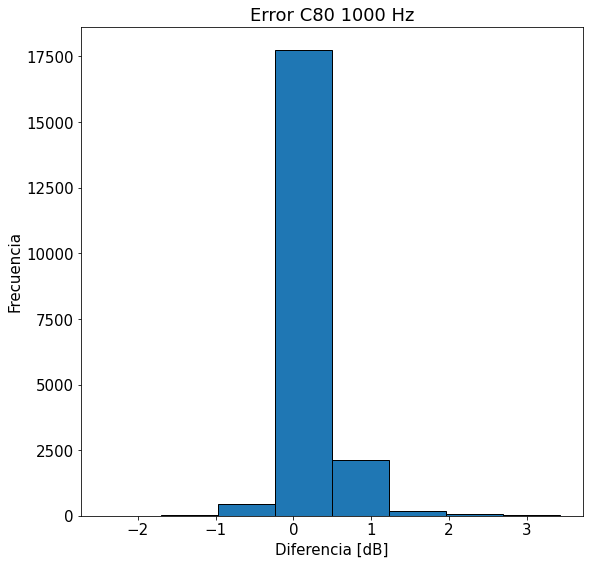

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([9.0000e+00, 1.1700e+02, 6.3490e+03, 1.3186e+04, 7.8400e+02,
        1.3400e+02, 7.5000e+01, 1.8000e+01]),
 array([-0.52   , -0.33125, -0.1425 ,  0.04625,  0.235  ,  0.42375,
         0.6125 ,  0.80125,  0.99   ]),
 <a list of 8 Patch objects>)

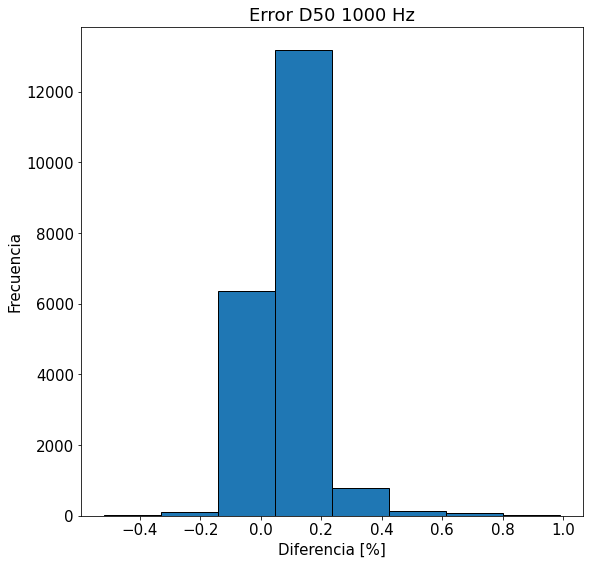

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

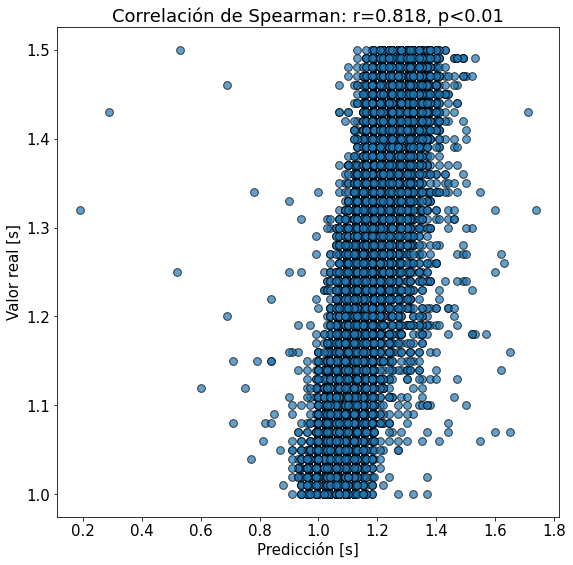

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

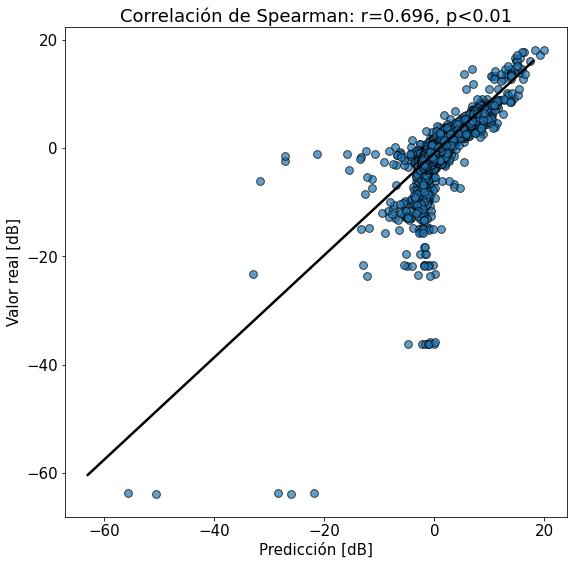

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

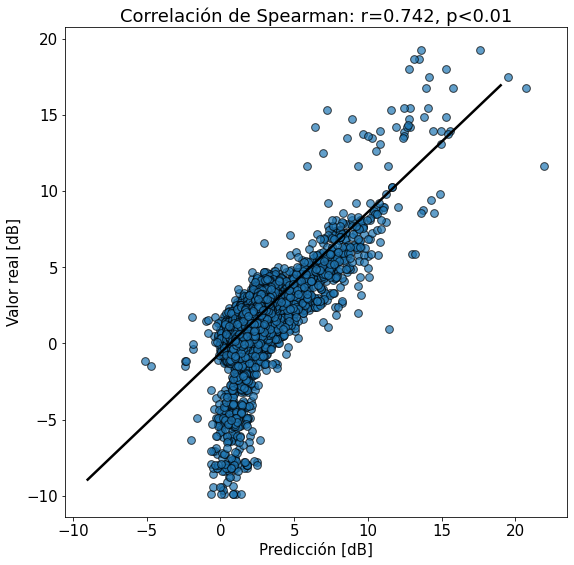

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

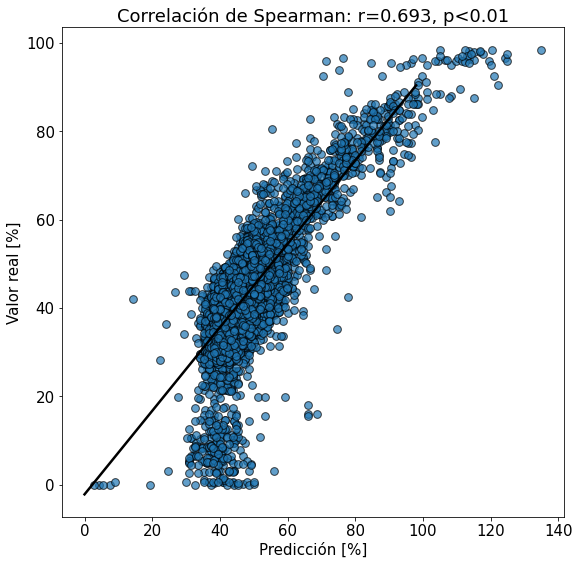

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

2000 Hz

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE sinteticos y reales - 1 a 1.5s')

band = 2000

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-131.95518607298595
38.746548989089625


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

1.4689335620227564
0.40496638532321694
3.18341437748207
52.329486243671376


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.09304130423144368
Máximo y_train: 38.746548989089625
Mínimo y_train: -131.95518607298595


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
73/73 [==============================] - 2s 17ms/step - loss: 6.2220 - val_loss: 4.5586
Epoch 2/500
73/73 [==============================] - 1s 12ms/step - loss: 4.7487 - val_loss: 3.8301
Epoch 3/500
73/73 [==============================] - 1s 13ms/step - loss: 4.0990 - val_loss: 4.1119
Epoch 4/500
73/73 [==============================] - 1s 12ms/step - loss: 3.5489 - val_loss: 3.7984
Epoch 5/500
73/73 [==============================] - 1s 12ms/step - loss: 3.3794 - val_loss: 3.6601
Epoch 6/500
73/73 [==============================] - 1s 12ms/step - loss: 3.2989 - val_loss: 3.5517
Epoch 7/500
73/73 [==============================] - 1s 12ms/step - loss: 3.2445 - val_loss: 3.0077
Epoch 8/500
73/73 [==============================] - 1s 12ms/step - loss: 3.1847 - val_loss: 2.9734
Epoch 9/500
73/73 [==============================] - 1s 12ms/step - loss: 3.1436 - val_loss: 2.3109
Epoch 10/500
73/73 [==============================] - 1s 13ms/step - loss: 3.1158 - val_loss: 2.0887

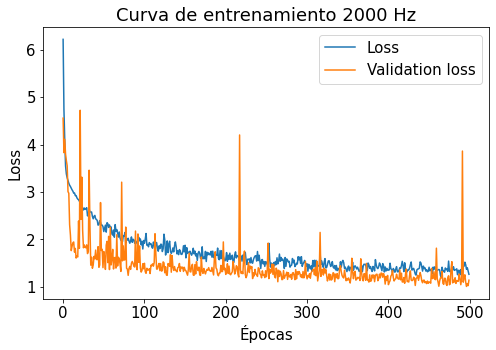

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([7.1000e+01, 6.5920e+03, 1.3655e+04, 3.3600e+02, 1.3000e+01,
        3.0000e+00, 0.0000e+00, 2.0000e+00]),
 array([-0.24  , -0.1275, -0.015 ,  0.0975,  0.21  ,  0.3225,  0.435 ,
         0.5475,  0.66  ]),
 <a list of 8 Patch objects>)

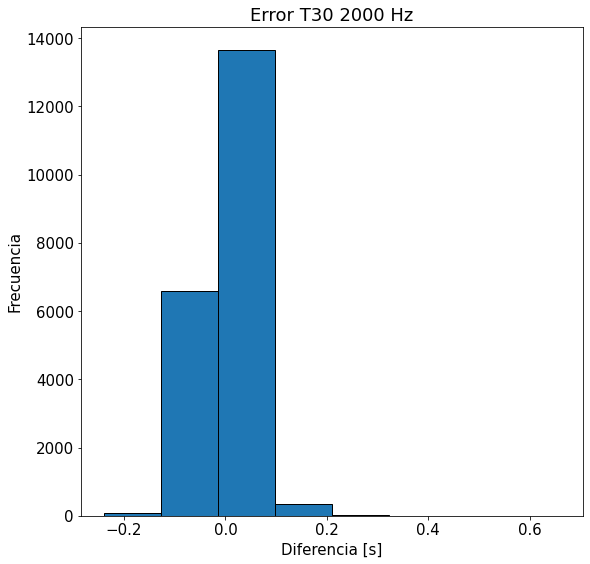

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([5.0000e+00, 4.7000e+01, 2.0257e+04, 2.7700e+02, 5.9000e+01,
        1.9000e+01, 7.0000e+00, 1.0000e+00]),
 array([-26.83   , -16.78125,  -6.7325 ,   3.31625,  13.365  ,  23.41375,
         33.4625 ,  43.51125,  53.56   ]),
 <a list of 8 Patch objects>)

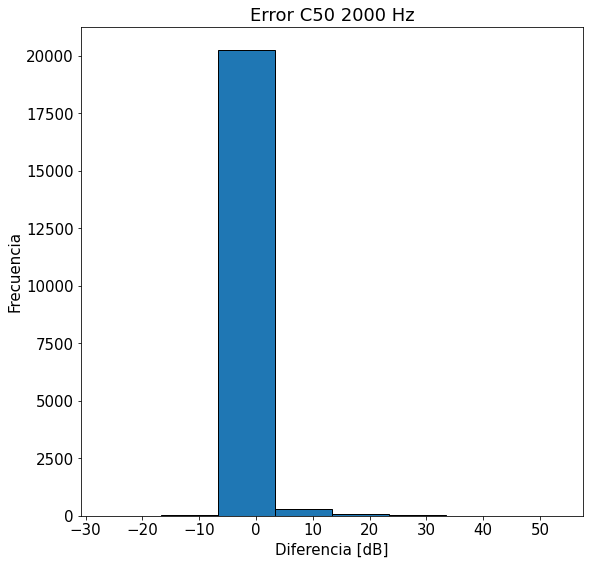

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([6.0000e+00, 5.0000e+00, 2.0930e+03, 1.7996e+04, 4.0300e+02,
        9.7000e+01, 5.1000e+01, 2.1000e+01]),
 array([-1.98 , -1.395, -0.81 , -0.225,  0.36 ,  0.945,  1.53 ,  2.115,
         2.7  ]),
 <a list of 8 Patch objects>)

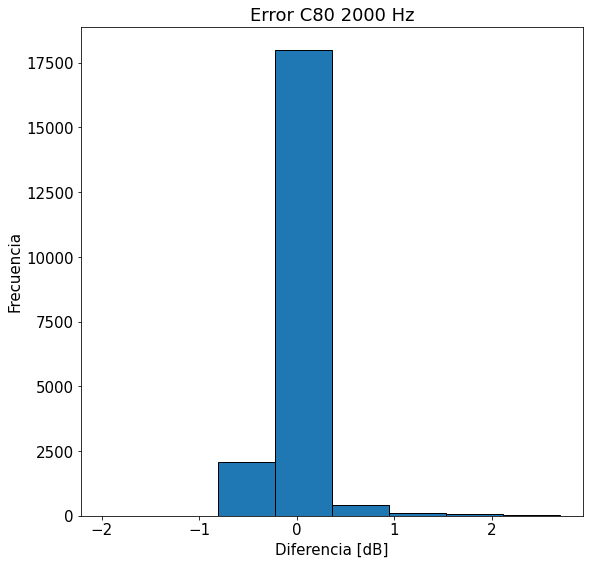

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([1.000e+00, 7.700e+01, 4.766e+03, 1.483e+04, 7.630e+02, 1.270e+02,
        8.700e+01, 2.100e+01]),
 array([-0.52 , -0.365, -0.21 , -0.055,  0.1  ,  0.255,  0.41 ,  0.565,
         0.72 ]),
 <a list of 8 Patch objects>)

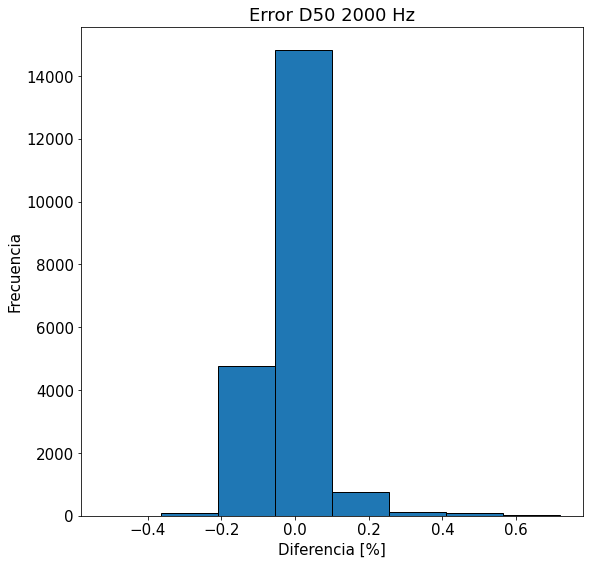

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

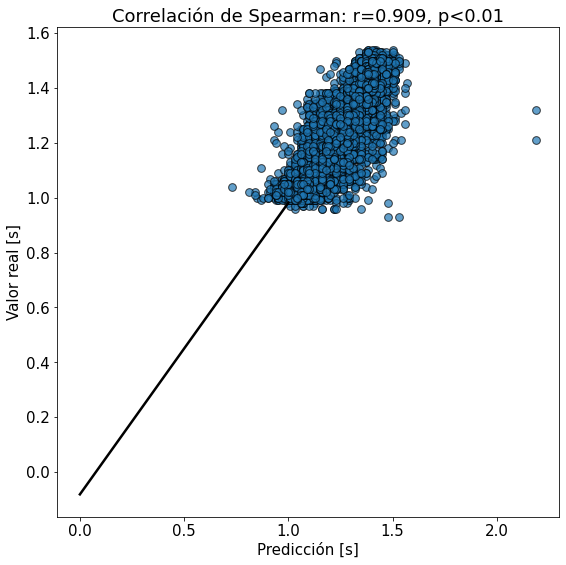

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

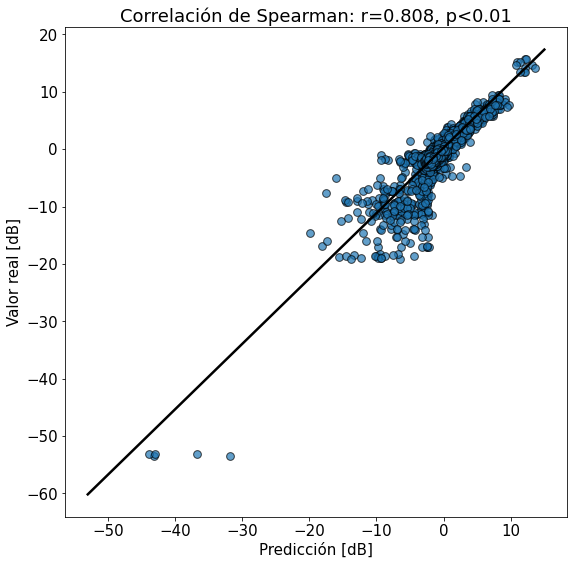

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

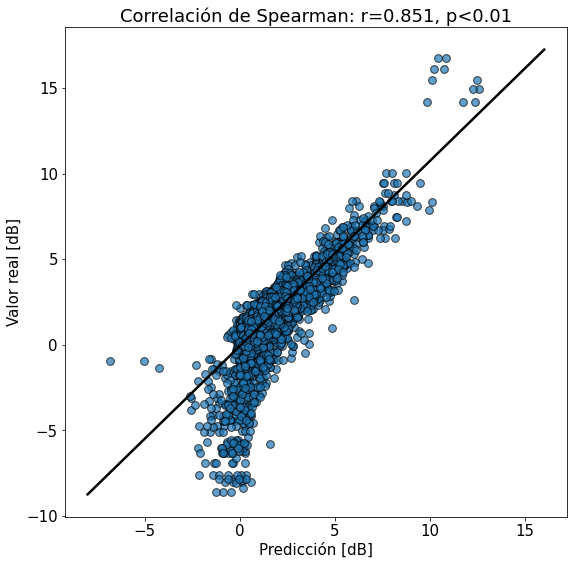

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

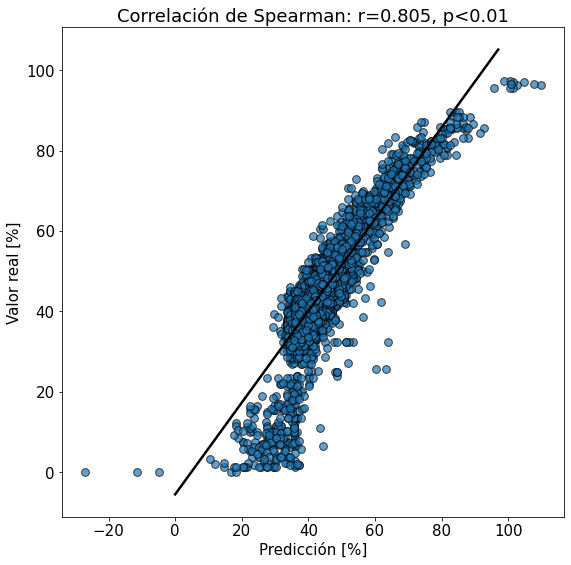

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

4000 Hz

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE sinteticos y reales - 1 a 1.5s')

band = 4000

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-137.09293766452555
29.95493467204737


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

1.4689253622585088
0.341185405408485
3.1825267661381136
51.96301156438794


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.0900326021627184
Máximo y_train: 29.95493467204737
Mínimo y_train: -137.09293766452555


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
73/73 [==============================] - 2s 16ms/step - loss: 6.7161 - val_loss: 5.0368
Epoch 2/500
73/73 [==============================] - 1s 13ms/step - loss: 4.2833 - val_loss: 4.7432
Epoch 3/500
73/73 [==============================] - 1s 13ms/step - loss: 3.5114 - val_loss: 5.0018
Epoch 4/500
73/73 [==============================] - 1s 12ms/step - loss: 3.2897 - val_loss: 5.2259
Epoch 5/500
73/73 [==============================] - 1s 12ms/step - loss: 3.1611 - val_loss: 5.2305
Epoch 6/500
73/73 [==============================] - 1s 13ms/step - loss: 3.0590 - val_loss: 4.9135
Epoch 7/500
73/73 [==============================] - 1s 13ms/step - loss: 2.9591 - val_loss: 4.5927
Epoch 8/500
73/73 [==============================] - 1s 13ms/step - loss: 2.9012 - val_loss: 3.4056
Epoch 9/500
73/73 [==============================] - 1s 13ms/step - loss: 2.8642 - val_loss: 2.1565
Epoch 10/500
73/73 [==============================] - 1s 12ms/step - loss: 2.7943 - val_loss: 1.5594

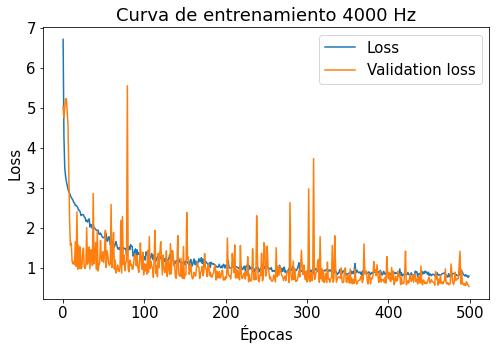

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([4.0000e+00, 5.0000e+01, 1.8890e+03, 1.5401e+04, 3.1020e+03,
        1.7700e+02, 4.1000e+01, 8.0000e+00]),
 array([-0.25, -0.18, -0.11, -0.04,  0.03,  0.1 ,  0.17,  0.24,  0.31]),
 <a list of 8 Patch objects>)

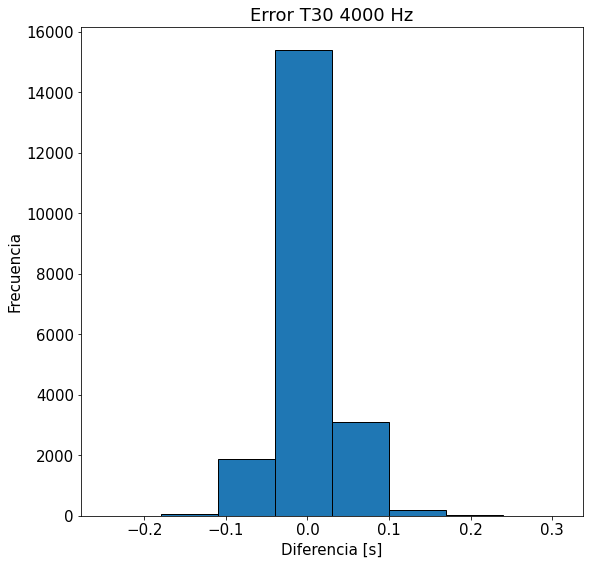

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([1.5000e+01, 2.0238e+04, 3.9500e+02, 2.1000e+01, 0.0000e+00,
        2.0000e+00, 0.0000e+00, 1.0000e+00]),
 array([-16.99   ,  -7.16125,   2.6675 ,  12.49625,  22.325  ,  32.15375,
         41.9825 ,  51.81125,  61.64   ]),
 <a list of 8 Patch objects>)

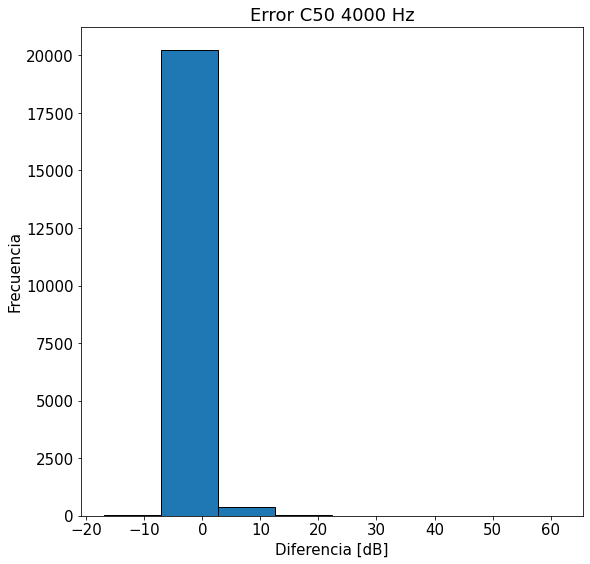

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([2.000e+00, 1.000e+00, 6.000e+00, 8.100e+01, 1.994e+04, 5.610e+02,
        5.900e+01, 2.200e+01]),
 array([-3.1   , -2.4325, -1.765 , -1.0975, -0.43  ,  0.2375,  0.905 ,
         1.5725,  2.24  ]),
 <a list of 8 Patch objects>)

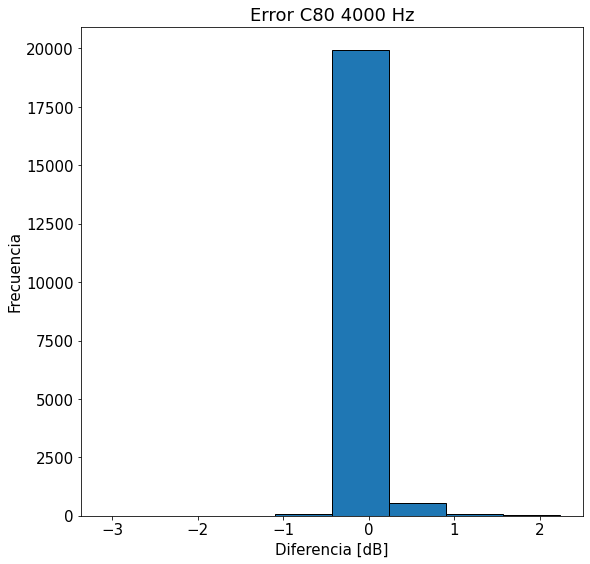

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([2.0000e+00, 1.0000e+00, 1.0000e+00, 1.0000e+01, 9.7670e+03,
        1.0755e+04, 1.0800e+02, 2.8000e+01]),
 array([-1.01   , -0.81125, -0.6125 , -0.41375, -0.215  , -0.01625,
         0.1825 ,  0.38125,  0.58   ]),
 <a list of 8 Patch objects>)

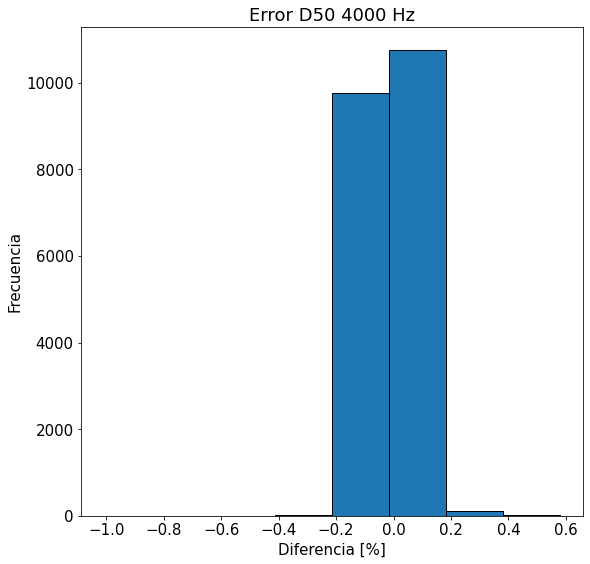

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

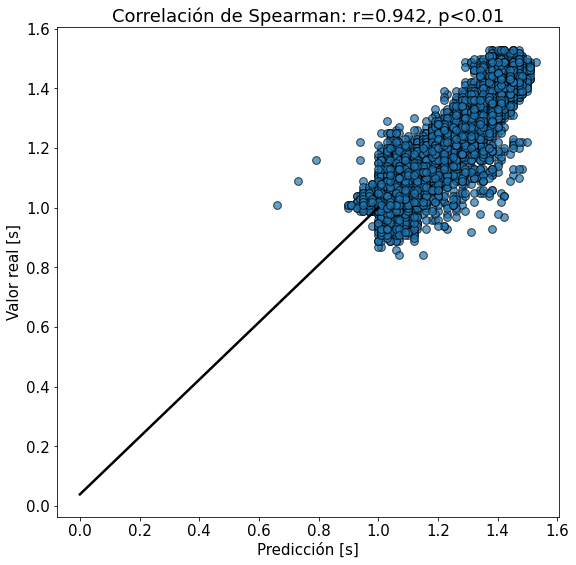

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

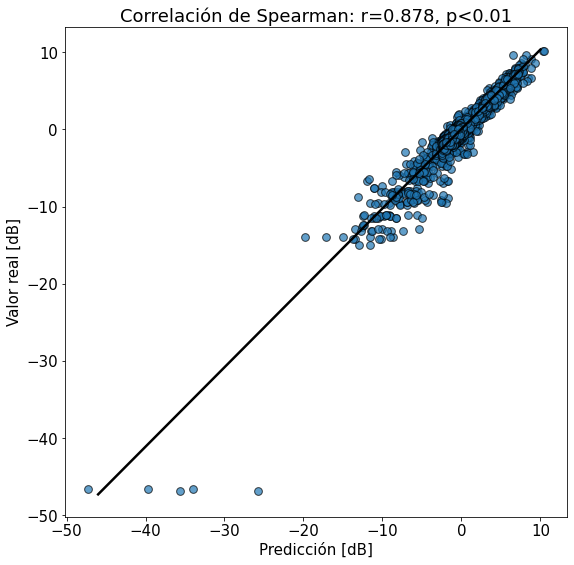

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

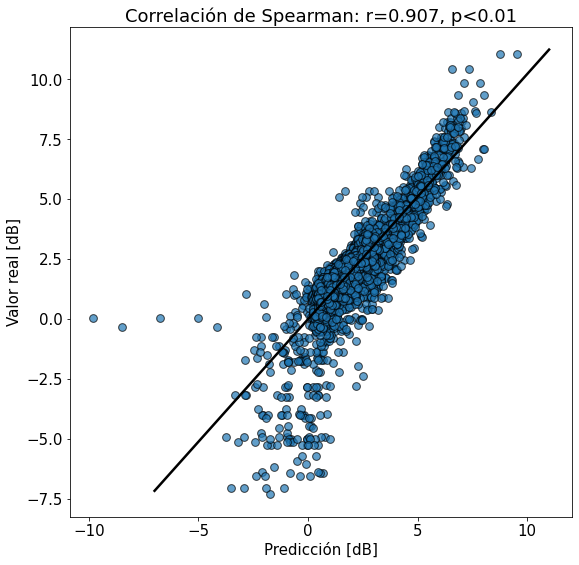

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

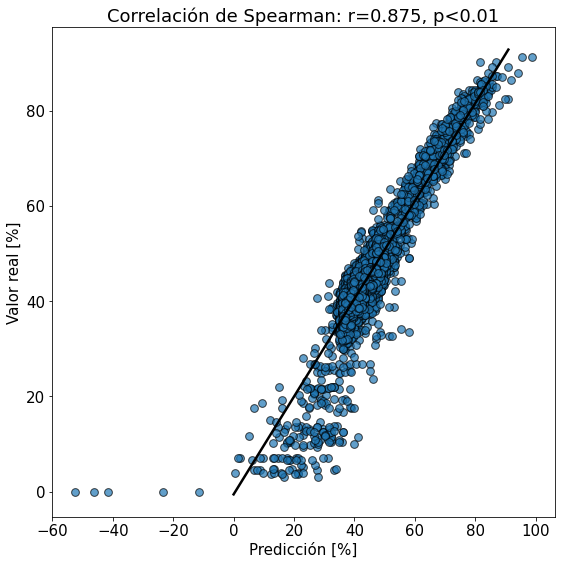

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

8000 Hz

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE sinteticos y reales - 1 a 1.5s')

band = 8000

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-95.57132453778745
33.06299183388259


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

1.4682592215034995
0.34866291368204394
3.189312549518898
52.005987752411436


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.13061156927452705
Máximo y_train: 33.06299183388259
Mínimo y_train: -95.57132453778745


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
73/73 [==============================] - 3s 20ms/step - loss: 7.2016 - val_loss: 5.5649
Epoch 2/500
73/73 [==============================] - 1s 15ms/step - loss: 3.0925 - val_loss: 6.6799
Epoch 3/500
73/73 [==============================] - 1s 15ms/step - loss: 2.2666 - val_loss: 7.6111
Epoch 4/500
73/73 [==============================] - 1s 15ms/step - loss: 2.0538 - val_loss: 7.6329
Epoch 5/500
73/73 [==============================] - 1s 15ms/step - loss: 1.9212 - val_loss: 7.0594
Epoch 6/500
73/73 [==============================] - 1s 15ms/step - loss: 1.8021 - val_loss: 6.2884
Epoch 7/500
73/73 [==============================] - 1s 15ms/step - loss: 1.6978 - val_loss: 5.5633
Epoch 8/500
73/73 [==============================] - 1s 15ms/step - loss: 1.6259 - val_loss: 4.0413
Epoch 9/500
73/73 [==============================] - 1s 15ms/step - loss: 1.5271 - val_loss: 2.8528
Epoch 10/500
73/73 [==============================] - 1s 15ms/step - loss: 1.4476 - val_loss: 1.8689

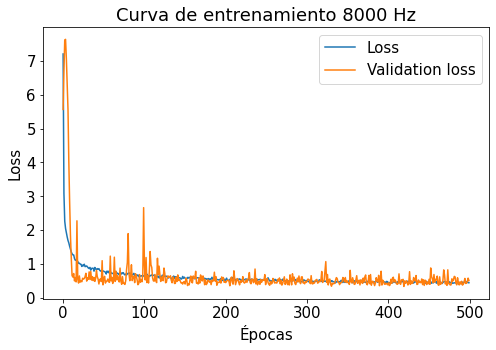

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([4.0000e+00, 6.7000e+01, 5.4810e+03, 1.4966e+04, 1.3000e+02,
        2.0000e+01, 3.0000e+00, 1.0000e+00]),
 array([-0.33 , -0.225, -0.12 , -0.015,  0.09 ,  0.195,  0.3  ,  0.405,
         0.51 ]),
 <a list of 8 Patch objects>)

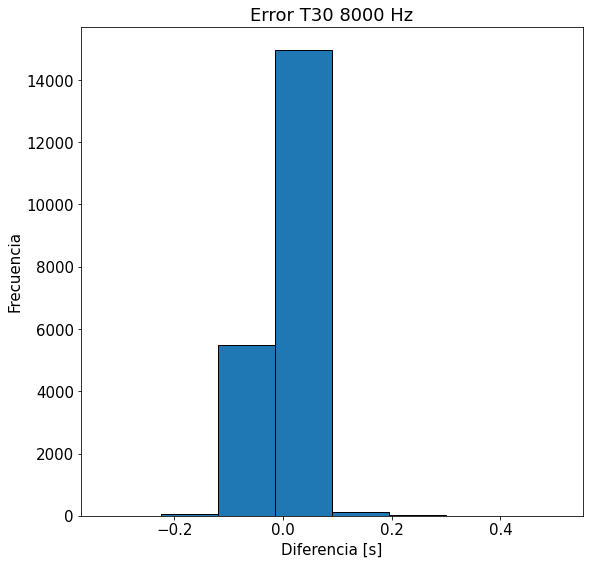

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([2.0000e+00, 1.0000e+00, 3.0000e+00, 2.0000e+00, 2.9000e+01,
        2.0595e+04, 3.8000e+01, 2.0000e+00]),
 array([-72.63   , -59.44125, -46.2525 , -33.06375, -19.875  ,  -6.68625,
          6.5025 ,  19.69125,  32.88   ]),
 <a list of 8 Patch objects>)

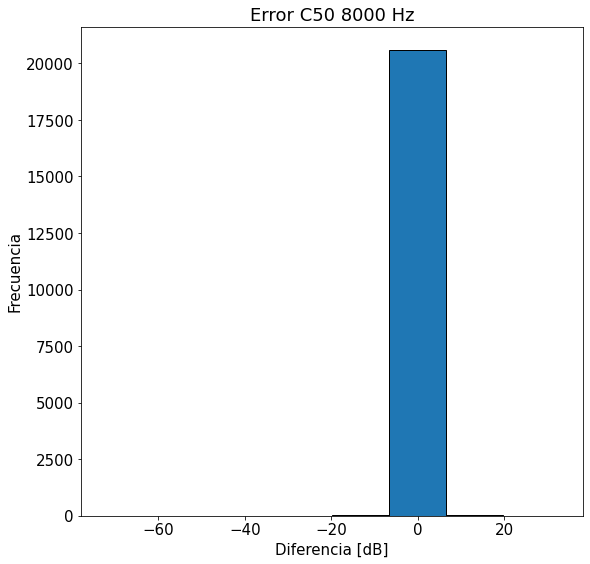

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([5.000e+00, 7.000e+00, 5.000e+01, 3.604e+03, 1.687e+04, 1.200e+02,
        1.200e+01, 4.000e+00]),
 array([-2.7    , -2.04875, -1.3975 , -0.74625, -0.095  ,  0.55625,
         1.2075 ,  1.85875,  2.51   ]),
 <a list of 8 Patch objects>)

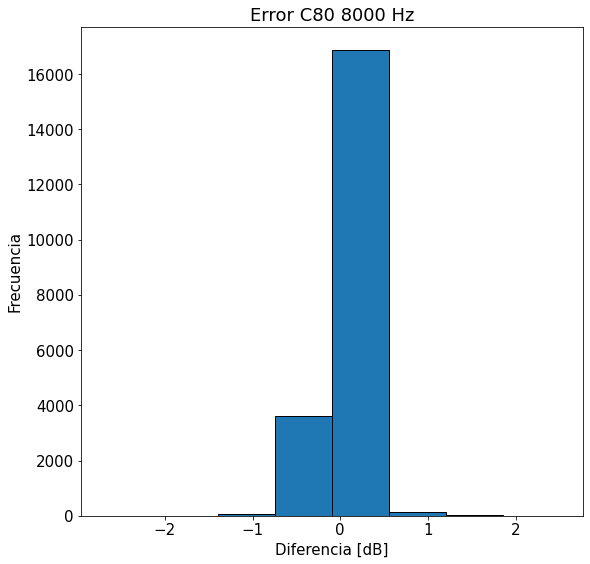

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([3.0000e+00, 1.0000e+00, 1.0000e+00, 2.0000e+00, 5.7000e+01,
        2.0233e+04, 3.5800e+02, 1.7000e+01]),
 array([-1.27   , -1.04375, -0.8175 , -0.59125, -0.365  , -0.13875,
         0.0875 ,  0.31375,  0.54   ]),
 <a list of 8 Patch objects>)

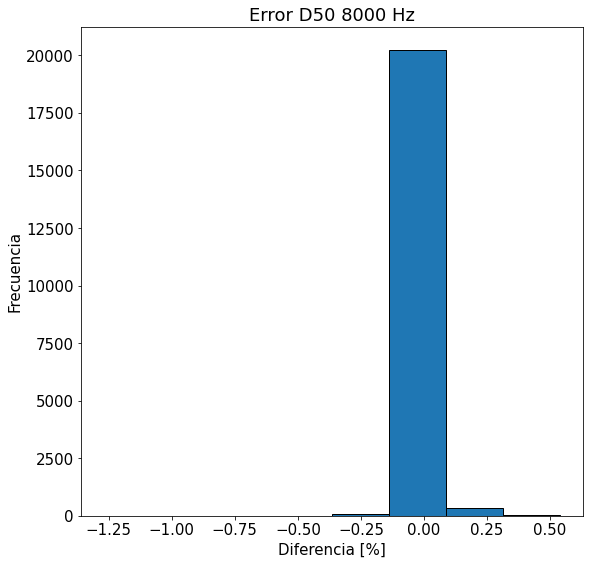

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

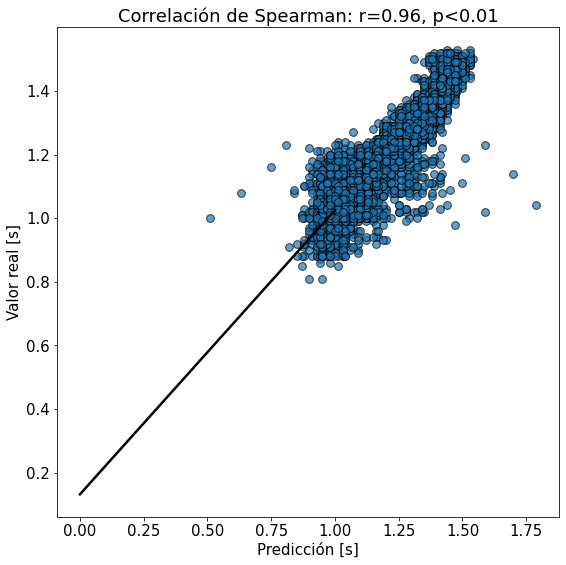

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

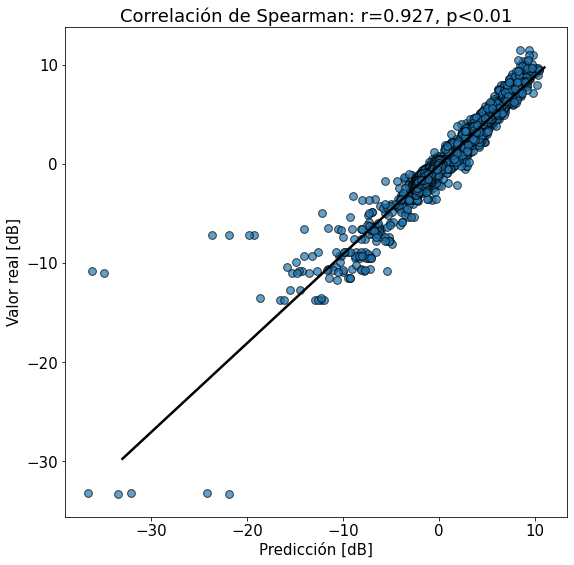

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

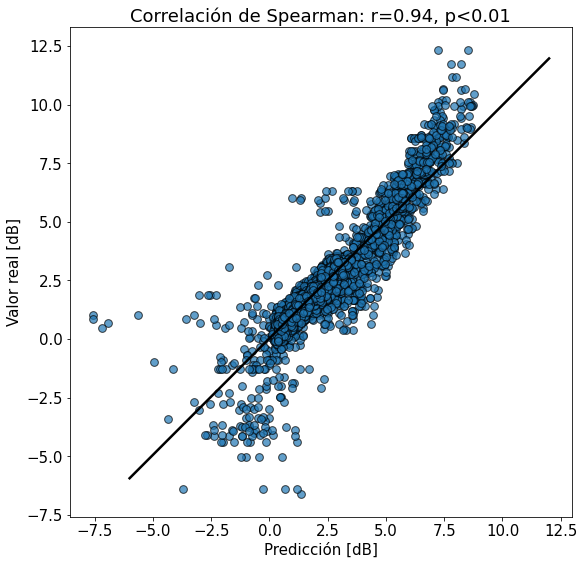

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

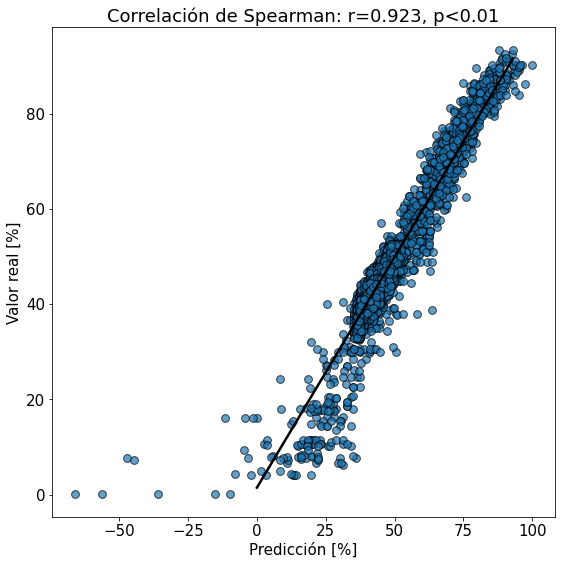

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

# Entrenamiento RIRs reales y sintéticas con ruido: Tr entre 1 y 1.5 [s]

En este caso, además de normalizar todo con el percentil 95, paso todos los valores a su escala sin dB ni %

In [ ]:
#Librerías necesarias:
import sys 
sys.path.append('/content/drive/My Drive/Tesis/Notebooks/scripts')
from model_2 import modelo
from scipy import stats

import numpy as np
import os
from librosa import load
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

!pip install pickle5
import pickle5 as pickle
import matplotlib.pyplot as plt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


Outliers:

In [ ]:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE con ruido - 1 a 1.5s')
with open('outliers_1_1.5.pickle', 'rb') as handle:
  outliers = list(set(pickle.load(handle)))

125 Hz:

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE con ruido - 1 a 1.5s')

band = 125

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

In [ ]:
print(list(tae_dic.keys())[10000])
print(list(params_dic.keys())[10000])

F1s3--Single_502_2_Noise_Babble_29_14.505dB--Wx12y10_1.3s
F1s3--Single_EE_lobby_2_Noise_Babble_35_14.468dB--sintetica_Seed1397686503_Tr1.12


In [ ]:
print(len(list(tae_dic.keys())))
print(len(list(params_dic.keys())))

309250
309250


In [ ]:
print(list(tae_dic.keys())[0:5])
print(list(params_dic.keys())[0:5])

['F1s3--Single_502_1_Noise_Ambient_0_-0.194dB--x04y03_6dB', 'F1s3--Single_502_1_Noise_Ambient_0_-0.334dB--Wx03y02_6dB', 'F1s3--Single_502_1_Noise_Ambient_0_-0.345dB--sintetica_Seed3940126130_Tr1.16', 'F1s3--Single_502_1_Noise_Ambient_0_-1.407dB--Zx12y05_16dB', 'F1s3--Single_502_1_Noise_Ambient_0_-1.419dB--Zx07y11_-4dB']
['F1s3--Single_EE_lobby_2_Noise_Ambient_21_2.475dB--sintetica_Seed100001509_Tr1.42', 'F2s3--Single_EE_lobby_2_Noise_Ambient_34_18.674dB--sintetica_Seed100001509_Tr1.42', 'F3s3--Single_EE_lobby_2_Noise_Fan_39_17.12dB--sintetica_Seed100001509_Tr1.42', 'F4s3--Single_502_2_Noise_Babble_27_6.931dB--sintetica_Seed100001509_Tr1.42', 'F5s3--Single_502_1_Noise_Ambient_9_3.383dB--sintetica_Seed100001509_Tr1.42']


In [ ]:
#print(params_dic['F1s3-sintetica_Seed1807110498_Tr3.0'])

In [ ]:
#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

In [ ]:
#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
print(len(y))

103480


In [ ]:
#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-75.6844463195275
17.063497543917737


In [ ]:
print(T30_perc_95) 
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

1.5125369175599175
0.7824132089493698
3.7163614227078625
54.491790006676744


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
print(X_train.shape)
print(y_train.shape)

(82784, 200, 1)
(82784, 4, 1)


In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.15729935640583334


In [ ]:
assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo y_train: 17.063497543917737
Mínimo y_train: -75.6844463195275


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
73/73 [==============================] - 3s 27ms/step - loss: 8.5667 - val_loss: 8.4111
Epoch 2/500
73/73 [==============================] - 1s 13ms/step - loss: 6.5906 - val_loss: 6.7813
Epoch 3/500
73/73 [==============================] - 1s 17ms/step - loss: 6.3695 - val_loss: 6.3859
Epoch 4/500
73/73 [==============================] - 1s 16ms/step - loss: 6.2944 - val_loss: 6.2135
Epoch 5/500
73/73 [==============================] - 1s 16ms/step - loss: 6.2520 - val_loss: 6.1340
Epoch 6/500
73/73 [==============================] - 1s 17ms/step - loss: 6.2219 - val_loss: 6.1162
Epoch 7/500
73/73 [==============================] - 1s 19ms/step - loss: 6.1987 - val_loss: 6.0552
Epoch 8/500
73/73 [==============================] - 1s 17ms/step - loss: 6.1792 - val_loss: 6.0399
Epoch 9/500
73/73 [==============================] - 1s 17ms/step - loss: 6.1509 - val_loss: 5.9873
Epoch 10/500
73/73 [==============================] - 1s 16ms/step - loss: 6.1432 - val_loss: 6.0403

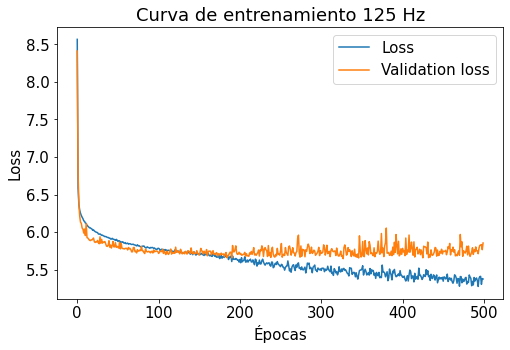

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
blind_estimation_model.predict(X_test[5,:,0].reshape(1,-1,1))[0]

array([ 0.84051275, -4.1619663 ,  0.06236887,  0.6001314 ], dtype=float32)

In [ ]:
np.round(y_test[0,:,0].reshape(1,-1,1),1)

array([[[0.8],
        [0.6],
        [0.8],
        [1. ]]])

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
prediction[0]

array([ 0.8 , -3.08,  0.26,  0.67], dtype=float32)

In [ ]:
np.round(prediction[1] - np.round(y_test[1,:,0].reshape(1,-1,1),2).flatten(),2)

array([ 0.03, -2.75, -0.37, -0.18])

In [ ]:
np.round(prediction[1][0] - np.round(y_test[1,:,0].reshape(1,-1,1),2).flatten()[0],2)

0.03

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([  18.,   30.,  254., 3223., 8905., 7120., 1119.,   27.]),
 array([-0.56  , -0.4425, -0.325 , -0.2075, -0.09  ,  0.0275,  0.145 ,
         0.2625,  0.38  ]),
 <a list of 8 Patch objects>)

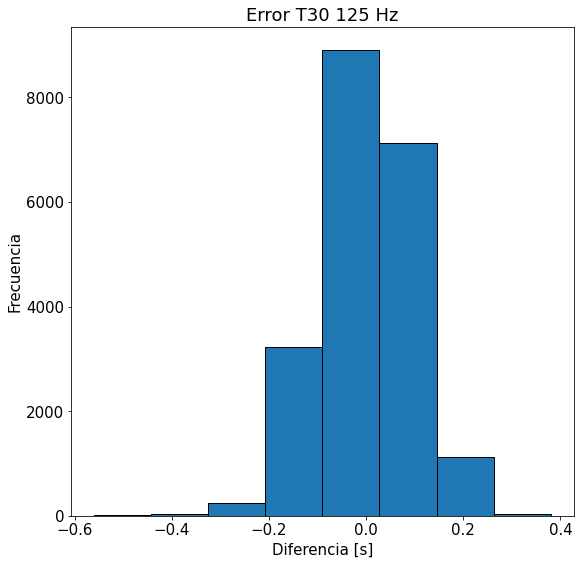

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([   43., 15418.,  5009.,   102.,    61.,    19.,    25.,    19.]),
 array([-21.43   ,  -9.83375,   1.7625 ,  13.35875,  24.955  ,  36.55125,
         48.1475 ,  59.74375,  71.34   ]),
 <a list of 8 Patch objects>)

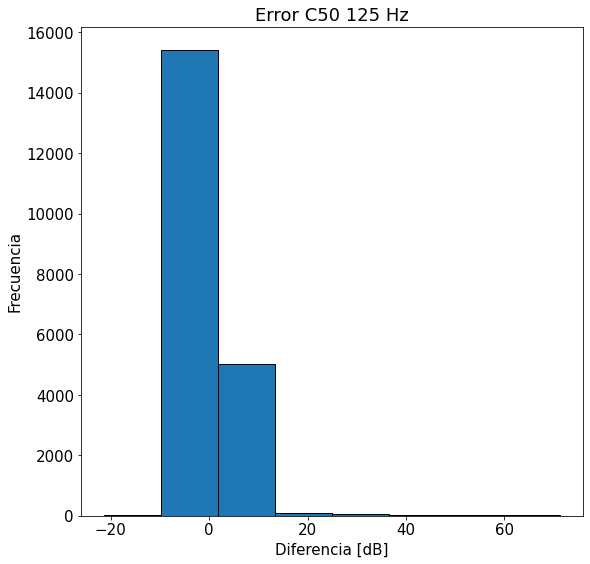

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([   11.,   232., 10602.,  9333.,   352.,   109.,    42.,    15.]),
 array([-3.65  , -2.4275, -1.205 ,  0.0175,  1.24  ,  2.4625,  3.685 ,
         4.9075,  6.13  ]),
 <a list of 8 Patch objects>)

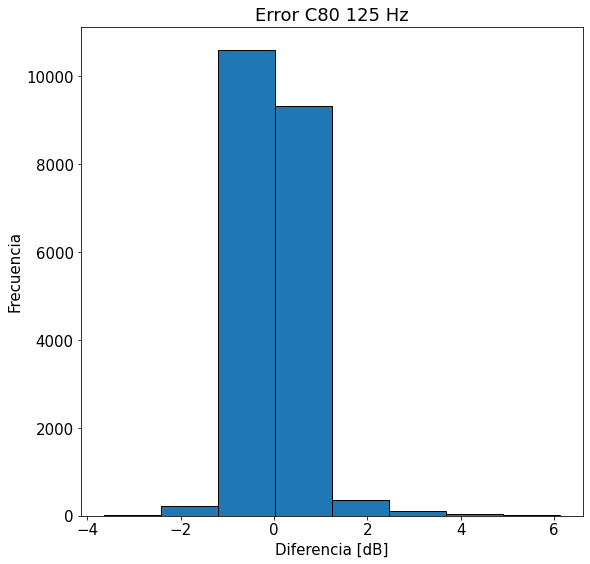

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([  14.,   33.,  501., 3229., 8188., 6672., 1826.,  233.]),
 array([-1.16, -0.92, -0.68, -0.44, -0.2 ,  0.04,  0.28,  0.52,  0.76]),
 <a list of 8 Patch objects>)

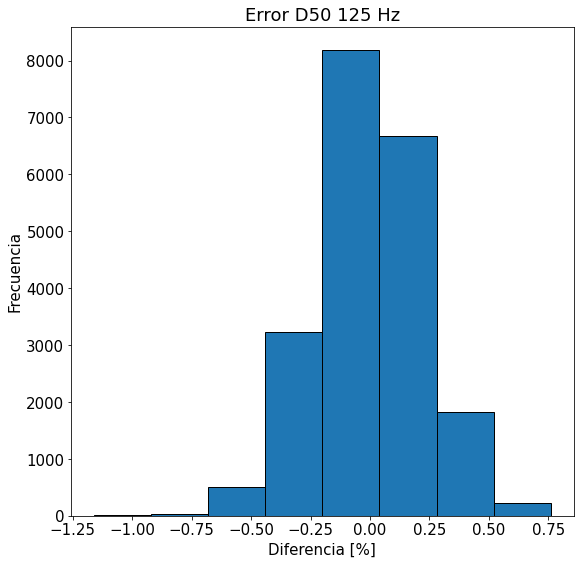

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

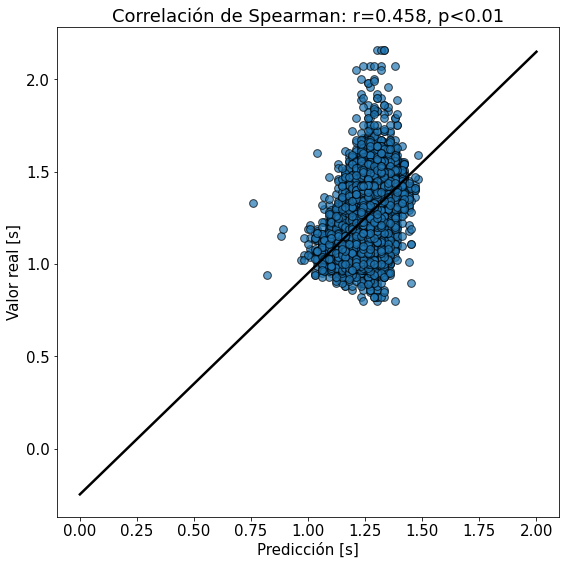

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

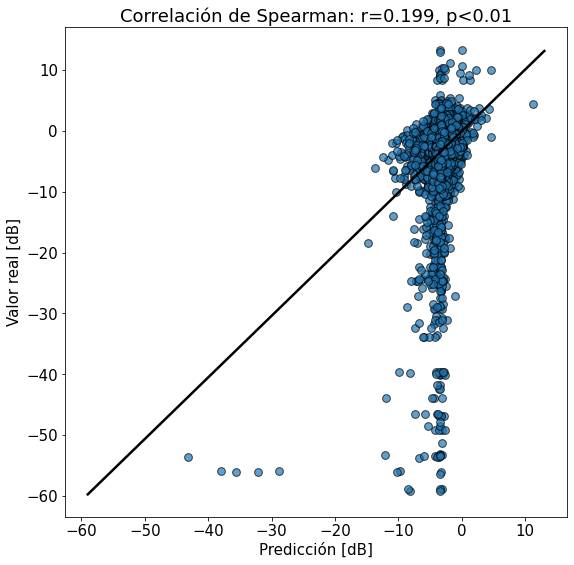

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

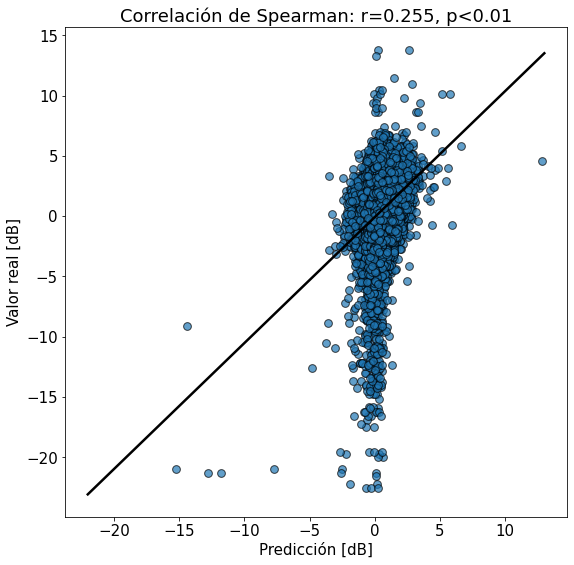

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

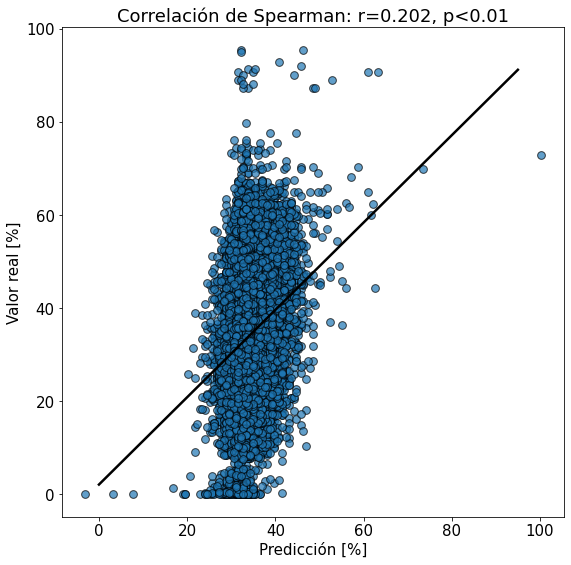

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

250 Hz:

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE con ruido - 1 a 1.5s')

band = 250

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-53.481208975831244
10.234041181296123


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

1.4881558431649256
1.011128322168877
3.714696605843349
55.79437218207431


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.1658146982083444
Máximo y_train: 10.234041181296123
Mínimo y_train: -53.481208975831244


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
73/73 [==============================] - 2s 17ms/step - loss: 3.1286 - val_loss: 2.5325
Epoch 2/500
73/73 [==============================] - 1s 12ms/step - loss: 2.3443 - val_loss: 2.1379
Epoch 3/500
73/73 [==============================] - 1s 12ms/step - loss: 2.2316 - val_loss: 2.1368
Epoch 4/500
73/73 [==============================] - 1s 12ms/step - loss: 2.1777 - val_loss: 2.1489
Epoch 5/500
73/73 [==============================] - 1s 13ms/step - loss: 2.1353 - val_loss: 2.1403
Epoch 6/500
73/73 [==============================] - 1s 12ms/step - loss: 2.1106 - val_loss: 2.0578
Epoch 7/500
73/73 [==============================] - 1s 12ms/step - loss: 2.0852 - val_loss: 2.0021
Epoch 8/500
73/73 [==============================] - 1s 13ms/step - loss: 2.0656 - val_loss: 1.9507
Epoch 9/500
73/73 [==============================] - 1s 12ms/step - loss: 2.0512 - val_loss: 1.8935
Epoch 10/500
73/73 [==============================] - 1s 13ms/step - loss: 2.0332 - val_loss: 1.9099

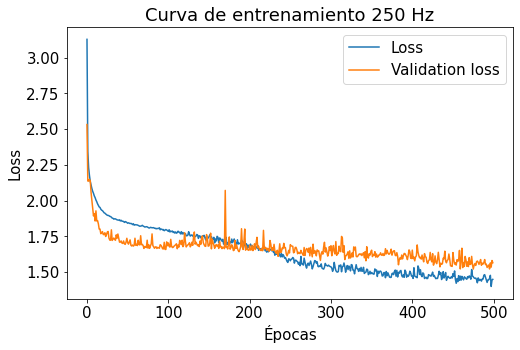

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([  17.,  373., 2687., 8511., 6701., 2079.,  298.,   30.]),
 array([-0.32  , -0.2375, -0.155 , -0.0725,  0.01  ,  0.0925,  0.175 ,
         0.2575,  0.34  ]),
 <a list of 8 Patch objects>)

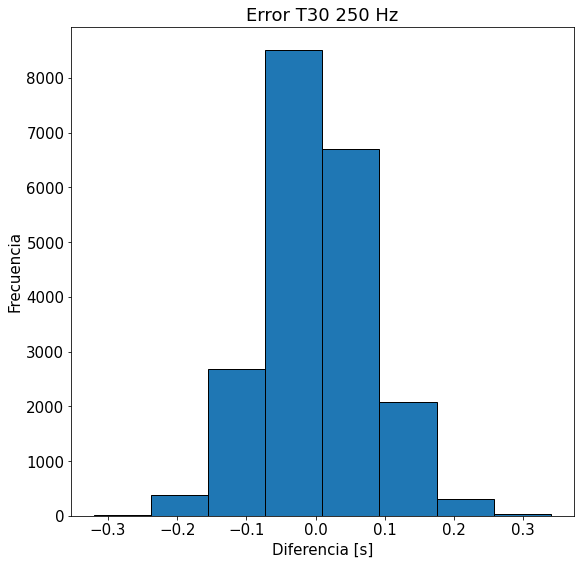

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([5.0000e+00, 1.0740e+03, 1.9379e+04, 1.5500e+02, 4.5000e+01,
        1.4000e+01, 1.6000e+01, 8.0000e+00]),
 array([-20.82   , -11.88375,  -2.9475 ,   5.98875,  14.925  ,  23.86125,
         32.7975 ,  41.73375,  50.67   ]),
 <a list of 8 Patch objects>)

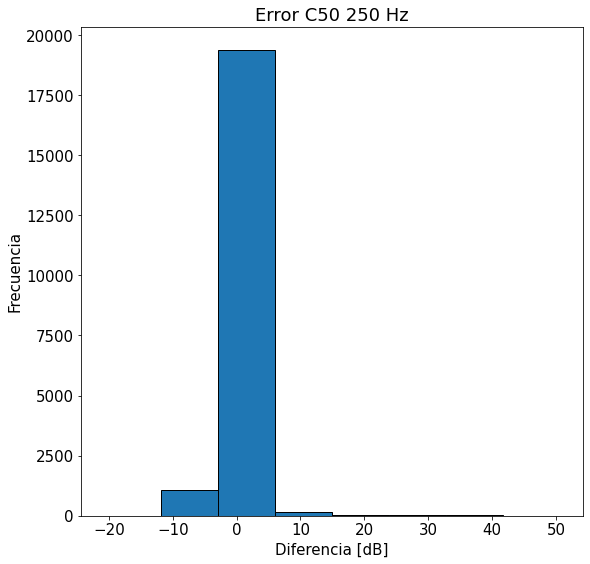

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([1.0000e+01, 9.7500e+02, 1.7425e+04, 2.0890e+03, 1.1100e+02,
        5.8000e+01, 2.6000e+01, 2.0000e+00]),
 array([-2.93   , -1.81625, -0.7025 ,  0.41125,  1.525  ,  2.63875,
         3.7525 ,  4.86625,  5.98   ]),
 <a list of 8 Patch objects>)

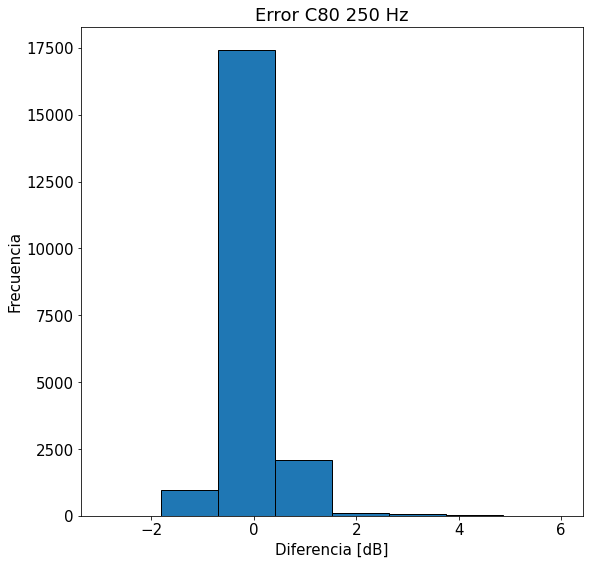

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([5.000e+00, 4.100e+01, 6.180e+02, 5.331e+03, 1.011e+04, 4.081e+03,
        3.850e+02, 1.250e+02]),
 array([-0.95, -0.74, -0.53, -0.32, -0.11,  0.1 ,  0.31,  0.52,  0.73]),
 <a list of 8 Patch objects>)

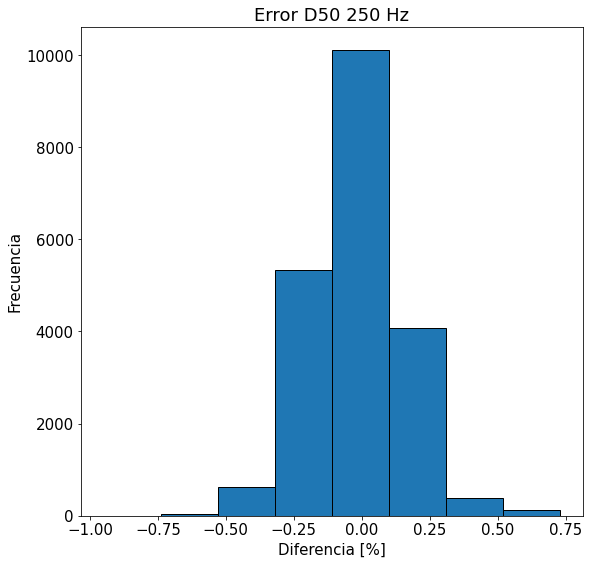

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

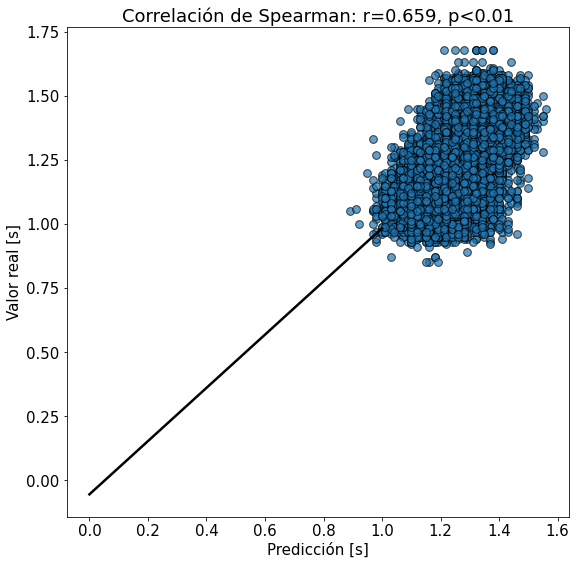

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

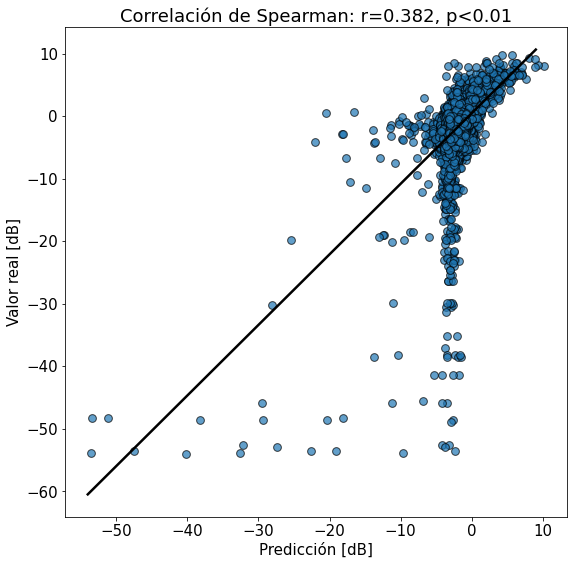

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

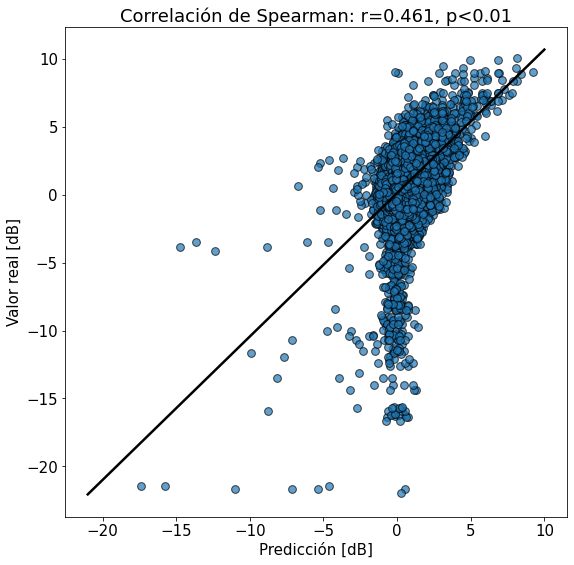

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

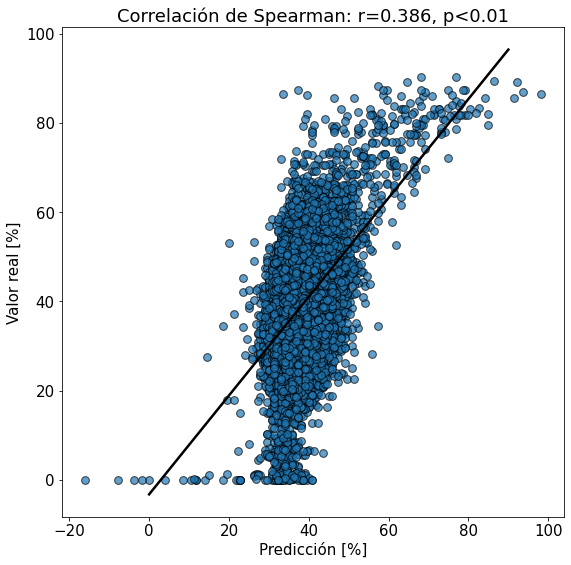

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

500 Hz

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE con ruido - 1 a 1.5s')

band = 500

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-68.61999126947327
25.9282644860192


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

1.4755233614336427
0.8674689269877232
3.5089012060823546
54.977016246130844


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.12858502532584673
Máximo y_train: 25.9282644860192
Mínimo y_train: -68.61999126947327


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
73/73 [==============================] - 2s 16ms/step - loss: 2.5758 - val_loss: 2.1055
Epoch 2/500
73/73 [==============================] - 1s 13ms/step - loss: 2.0841 - val_loss: 1.8998
Epoch 3/500
73/73 [==============================] - 1s 13ms/step - loss: 1.9671 - val_loss: 1.8288
Epoch 4/500
73/73 [==============================] - 1s 12ms/step - loss: 1.8577 - val_loss: 1.8628
Epoch 5/500
73/73 [==============================] - 1s 13ms/step - loss: 1.7784 - val_loss: 1.9646
Epoch 6/500
73/73 [==============================] - 1s 13ms/step - loss: 1.7230 - val_loss: 2.0330
Epoch 7/500
73/73 [==============================] - 1s 12ms/step - loss: 1.6832 - val_loss: 2.0736
Epoch 8/500
73/73 [==============================] - 1s 12ms/step - loss: 1.6583 - val_loss: 1.8957
Epoch 9/500
73/73 [==============================] - 1s 13ms/step - loss: 1.6411 - val_loss: 1.6529
Epoch 10/500
73/73 [==============================] - 1s 13ms/step - loss: 1.6230 - val_loss: 1.3720

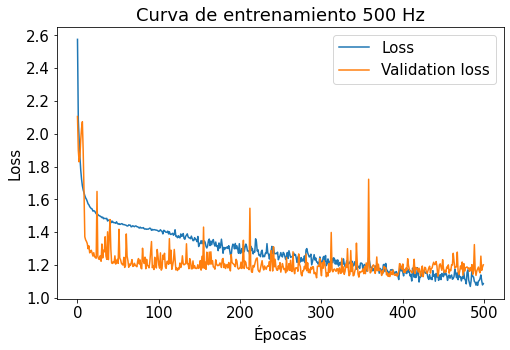

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([7.300e+01, 7.040e+02, 4.263e+03, 9.900e+03, 4.683e+03, 9.890e+02,
        7.900e+01, 5.000e+00]),
 array([-0.27 , -0.195, -0.12 , -0.045,  0.03 ,  0.105,  0.18 ,  0.255,
         0.33 ]),
 <a list of 8 Patch objects>)

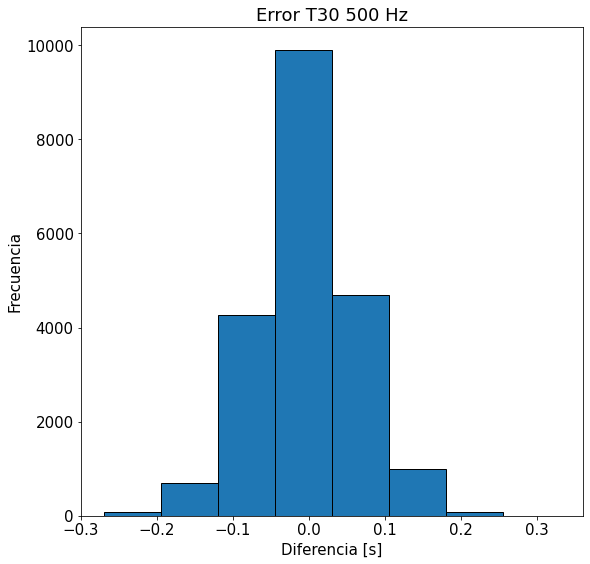

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([2.000e+00, 4.100e+01, 2.047e+04, 1.370e+02, 2.900e+01, 1.200e+01,
        2.000e+00, 3.000e+00]),
 array([-29.77   , -17.69875,  -5.6275 ,   6.44375,  18.515  ,  30.58625,
         42.6575 ,  54.72875,  66.8    ]),
 <a list of 8 Patch objects>)

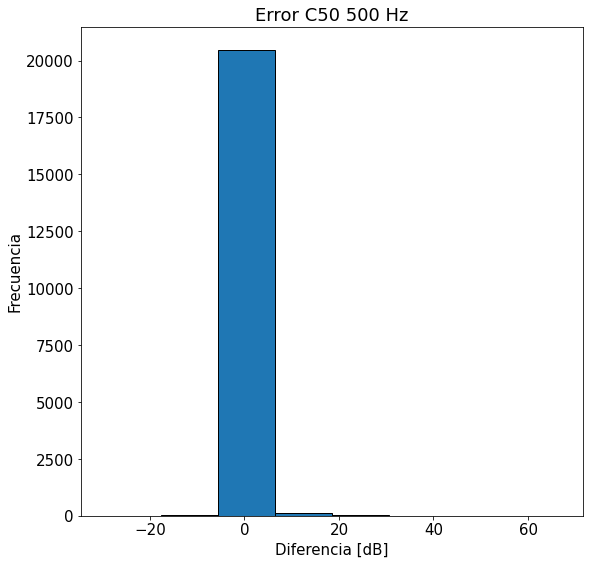

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([2.0000e+00, 8.0000e+00, 6.7500e+02, 1.8858e+04, 9.8300e+02,
        9.4000e+01, 6.2000e+01, 1.4000e+01]),
 array([-3.62   , -2.58125, -1.5425 , -0.50375,  0.535  ,  1.57375,
         2.6125 ,  3.65125,  4.69   ]),
 <a list of 8 Patch objects>)

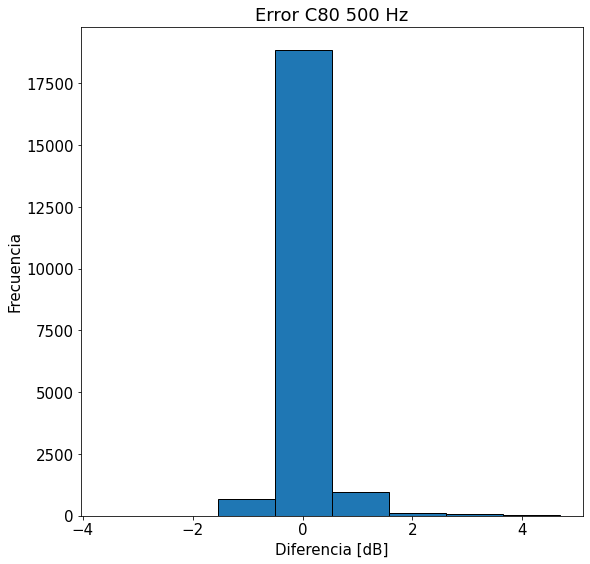

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([2.9000e+01, 5.8700e+02, 1.3289e+04, 6.5060e+03, 2.1100e+02,
        7.1000e+01, 2.0000e+00, 1.0000e+00]),
 array([-0.75   , -0.47875, -0.2075 ,  0.06375,  0.335  ,  0.60625,
         0.8775 ,  1.14875,  1.42   ]),
 <a list of 8 Patch objects>)

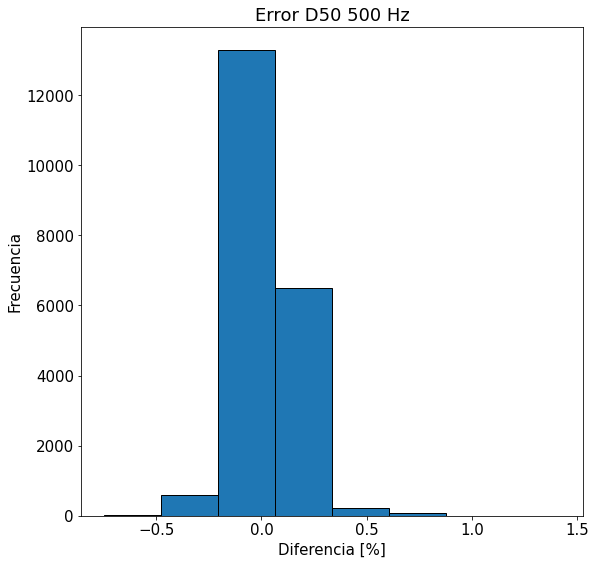

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

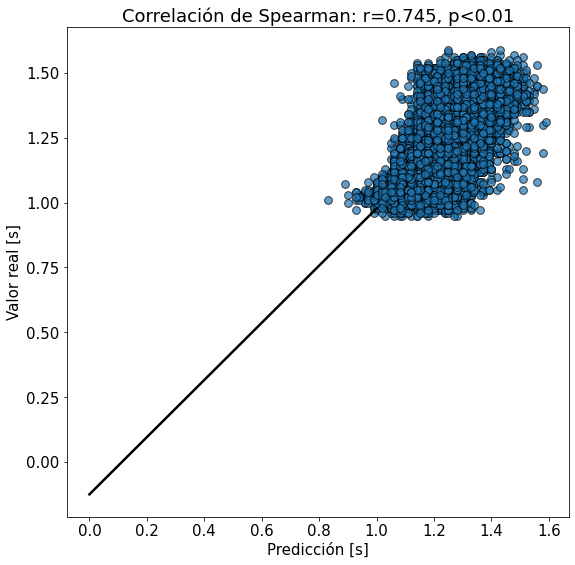

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

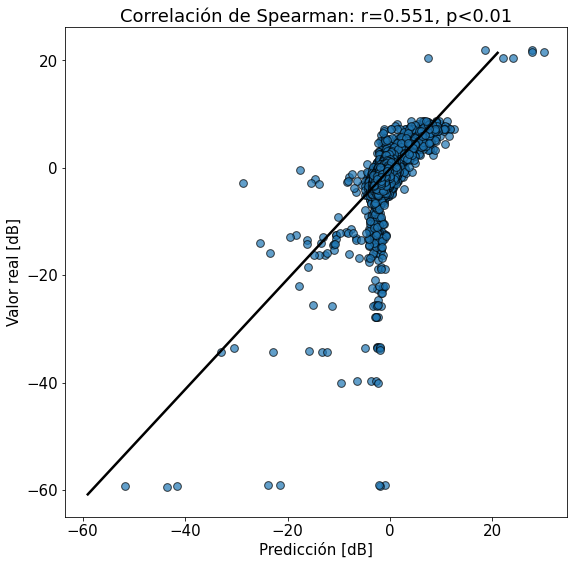

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

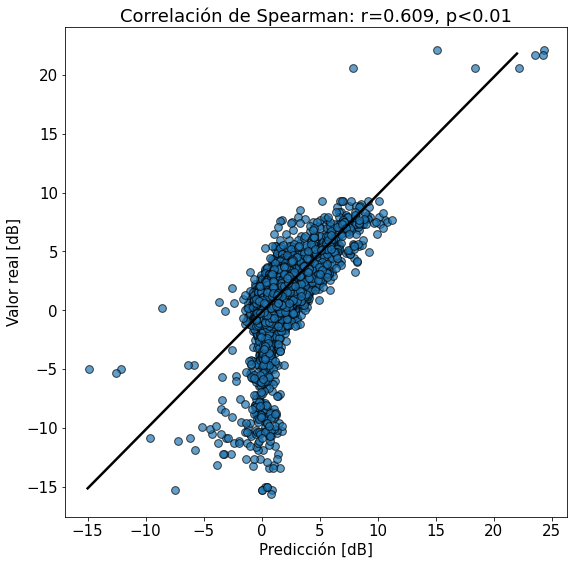

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

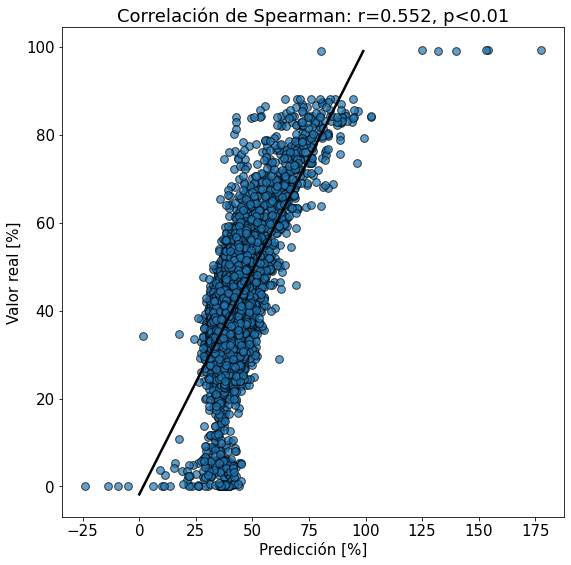

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

1000 Hz

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE con ruido - 1 a 1.5s')

band = 1000

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-107.58574981502125
30.606204380486993


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

1.4716634798495152
0.5944084377379139
3.3084932011856054
53.416358537650616


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.12762536256525198
Máximo y_train: 30.606204380486993
Mínimo y_train: -107.58574981502125


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
73/73 [==============================] - 2s 16ms/step - loss: 4.5149 - val_loss: 3.1786
Epoch 2/500
73/73 [==============================] - 1s 12ms/step - loss: 3.6002 - val_loss: 2.9295
Epoch 3/500
73/73 [==============================] - 1s 12ms/step - loss: 3.4340 - val_loss: 2.8329
Epoch 4/500
73/73 [==============================] - 1s 12ms/step - loss: 3.3200 - val_loss: 2.8006
Epoch 5/500
73/73 [==============================] - 1s 12ms/step - loss: 3.1997 - val_loss: 2.8420
Epoch 6/500
73/73 [==============================] - 1s 12ms/step - loss: 3.0673 - val_loss: 2.8010
Epoch 7/500
73/73 [==============================] - 1s 13ms/step - loss: 2.9815 - val_loss: 2.7098
Epoch 8/500
73/73 [==============================] - 1s 12ms/step - loss: 2.9052 - val_loss: 2.4956
Epoch 9/500
73/73 [==============================] - 1s 12ms/step - loss: 2.8447 - val_loss: 2.2181
Epoch 10/500
73/73 [==============================] - 1s 13ms/step - loss: 2.8011 - val_loss: 2.2820

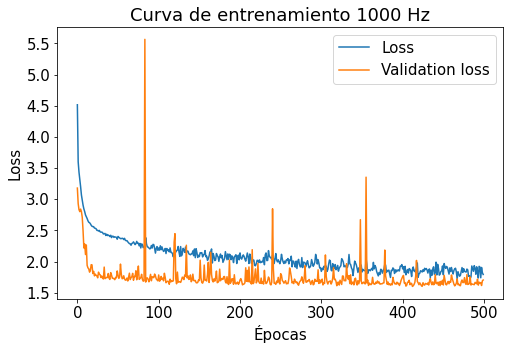

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([2.0000e+00, 8.0000e+00, 7.7700e+02, 1.2925e+04, 6.8310e+03,
        1.4900e+02, 2.0000e+00, 2.0000e+00]),
 array([-0.54  , -0.3975, -0.255 , -0.1125,  0.03  ,  0.1725,  0.315 ,
         0.4575,  0.6   ]),
 <a list of 8 Patch objects>)

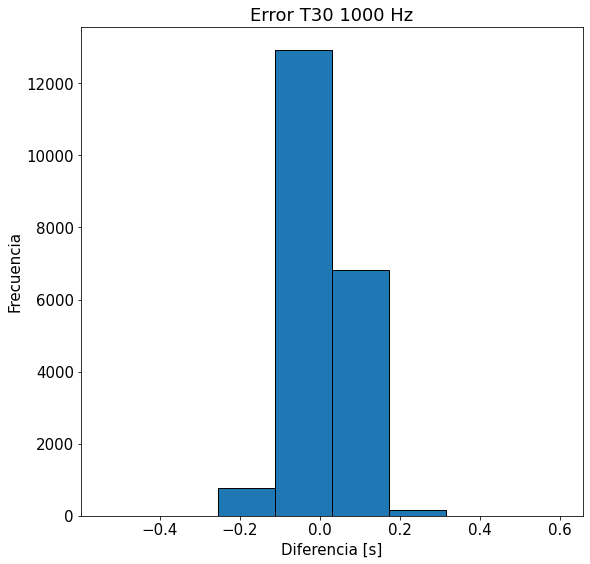

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([2.7000e+01, 2.0407e+04, 2.1800e+02, 3.1000e+01, 1.0000e+00,
        7.0000e+00, 1.0000e+00, 4.0000e+00]),
 array([-28.43   , -11.78625,   4.8575 ,  21.50125,  38.145  ,  54.78875,
         71.4325 ,  88.07625, 104.72   ]),
 <a list of 8 Patch objects>)

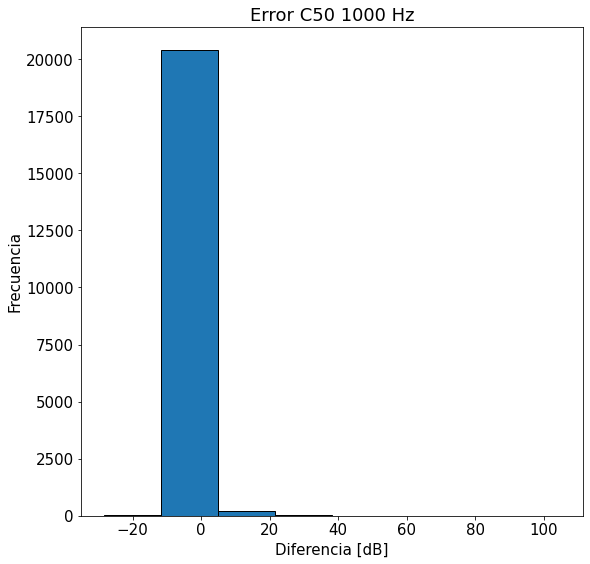

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([2.0000e+00, 1.1000e+01, 1.9000e+01, 1.2500e+02, 1.7707e+04,
        2.6330e+03, 1.4100e+02, 5.8000e+01]),
 array([-4.84   , -3.81625, -2.7925 , -1.76875, -0.745  ,  0.27875,
         1.3025 ,  2.32625,  3.35   ]),
 <a list of 8 Patch objects>)

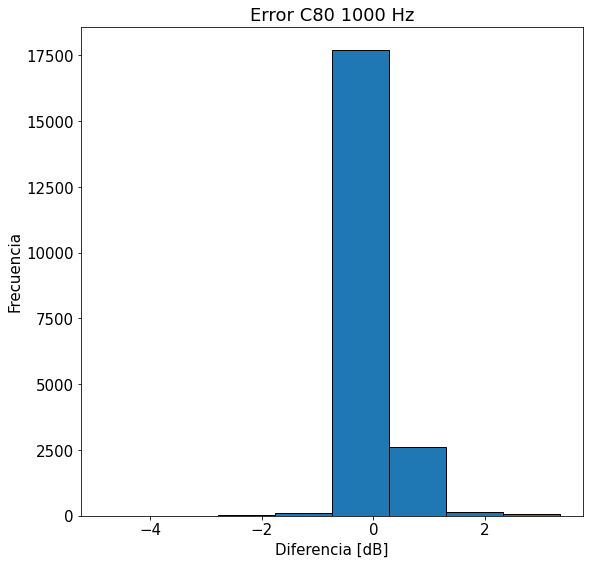

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([1.1000e+01, 8.2000e+01, 4.1400e+02, 1.1557e+04, 8.3410e+03,
        1.4200e+02, 1.3400e+02, 1.5000e+01]),
 array([-0.93   , -0.69375, -0.4575 , -0.22125,  0.015  ,  0.25125,
         0.4875 ,  0.72375,  0.96   ]),
 <a list of 8 Patch objects>)

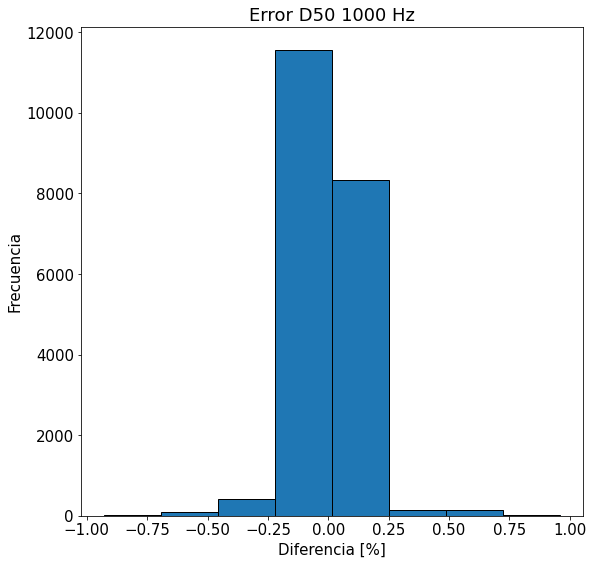

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

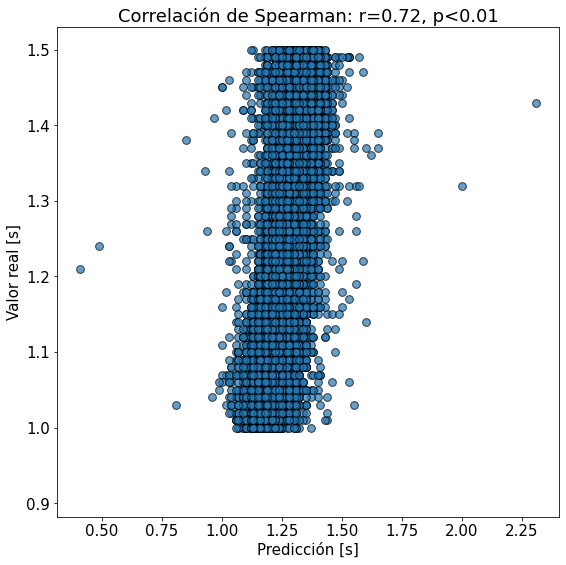

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

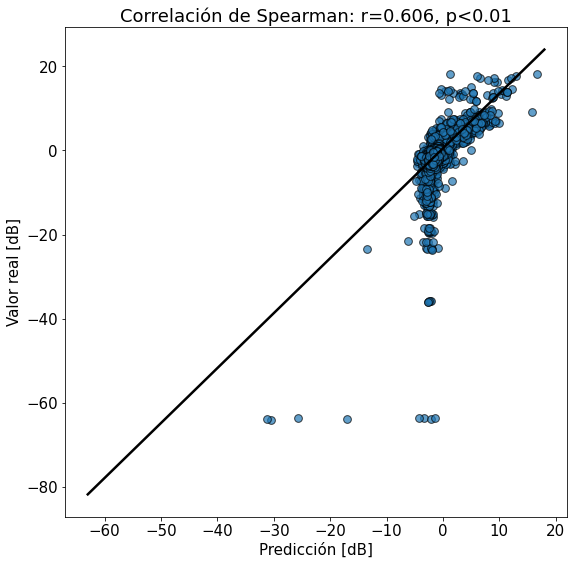

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

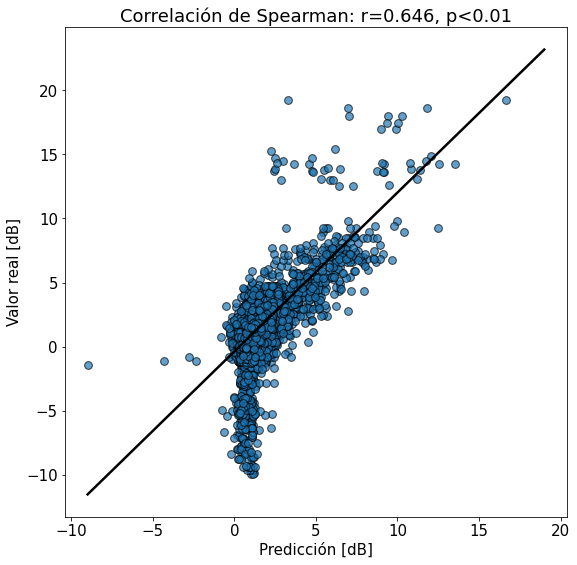

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

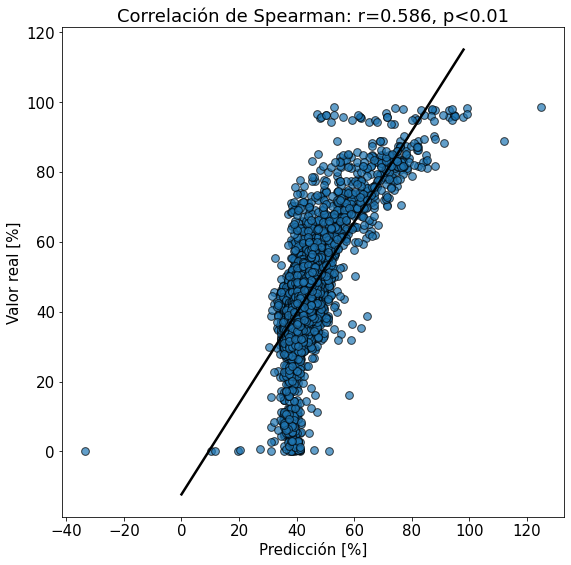

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

2000 Hz

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE con ruido - 1 a 1.5s')

band = 2000

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-126.51390018092403
37.14880162761945


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

1.4689237466823242
0.4223837432267146
3.1846123116450102
52.429521505822144


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.08346206415417988
Máximo y_train: 37.14880162761945
Mínimo y_train: -126.51390018092403


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
73/73 [==============================] - 3s 16ms/step - loss: 6.4396 - val_loss: 5.7777
Epoch 2/500
73/73 [==============================] - 1s 12ms/step - loss: 4.6859 - val_loss: 4.6621
Epoch 3/500
73/73 [==============================] - 1s 12ms/step - loss: 4.3867 - val_loss: 4.0505
Epoch 4/500
73/73 [==============================] - 1s 13ms/step - loss: 4.2079 - val_loss: 4.0246
Epoch 5/500
73/73 [==============================] - 1s 13ms/step - loss: 3.9863 - val_loss: 4.0082
Epoch 6/500
73/73 [==============================] - 1s 12ms/step - loss: 3.7788 - val_loss: 3.7776
Epoch 7/500
73/73 [==============================] - 1s 12ms/step - loss: 3.6411 - val_loss: 3.3584
Epoch 8/500
73/73 [==============================] - 1s 13ms/step - loss: 3.5645 - val_loss: 2.9693
Epoch 9/500
73/73 [==============================] - 1s 12ms/step - loss: 3.4943 - val_loss: 2.7098
Epoch 10/500
73/73 [==============================] - 1s 12ms/step - loss: 3.4417 - val_loss: 2.4902

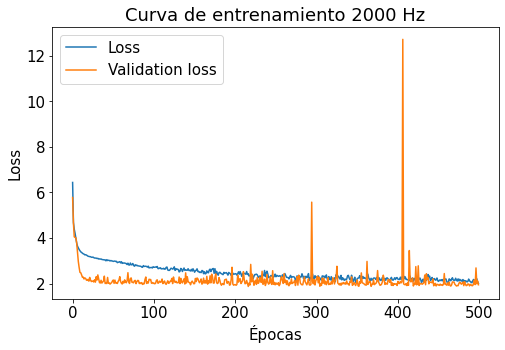

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([5.1000e+01, 3.6400e+02, 3.1740e+03, 1.1282e+04, 4.9020e+03,
        8.2900e+02, 8.4000e+01, 1.0000e+01]),
 array([-0.26   , -0.18625, -0.1125 , -0.03875,  0.035  ,  0.10875,
         0.1825 ,  0.25625,  0.33   ]),
 <a list of 8 Patch objects>)

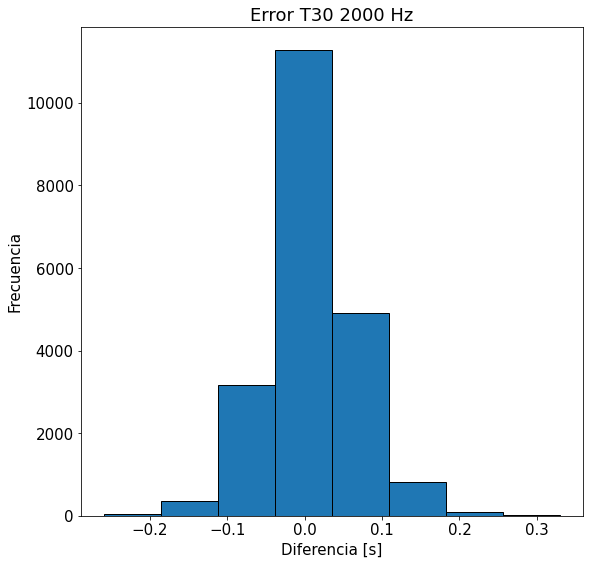

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([1.1000e+01, 2.0129e+04, 5.0600e+02, 4.3000e+01, 1.0000e+00,
        1.0000e+00, 1.0000e+00, 4.0000e+00]),
 array([-36.42, -16.65,   3.12,  22.89,  42.66,  62.43,  82.2 , 101.97,
        121.74]),
 <a list of 8 Patch objects>)

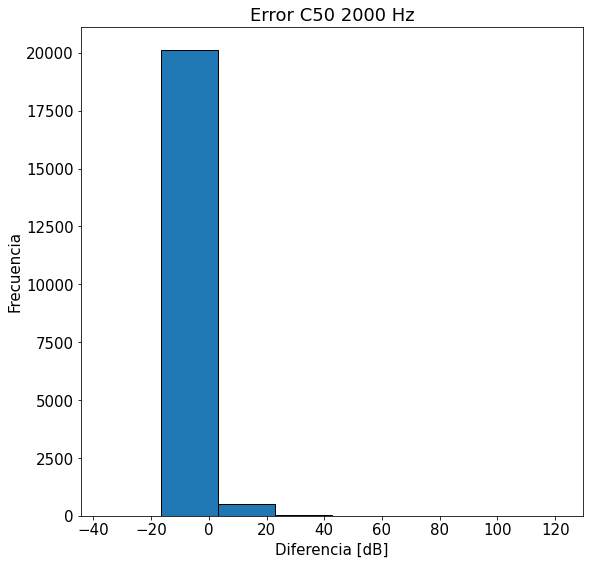

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([1.0000e+00, 3.0000e+00, 9.0000e+00, 8.5000e+01, 1.7707e+04,
        2.7530e+03, 1.0700e+02, 3.1000e+01]),
 array([-4.46 , -3.535, -2.61 , -1.685, -0.76 ,  0.165,  1.09 ,  2.015,
         2.94 ]),
 <a list of 8 Patch objects>)

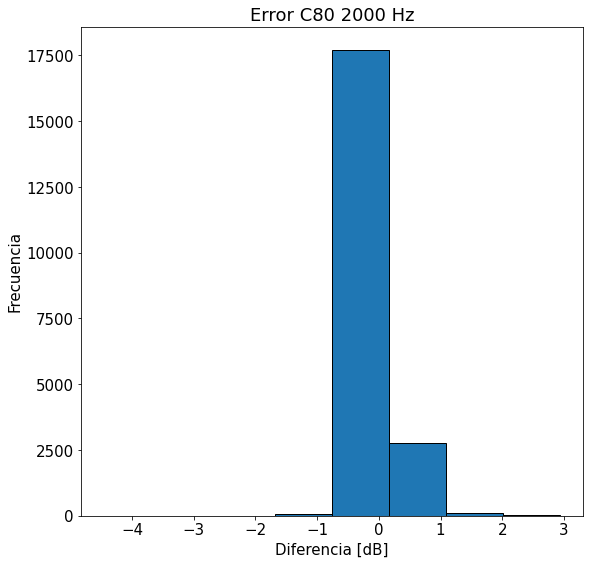

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([5.0000e+00, 3.4000e+01, 1.5700e+02, 5.3000e+03, 1.4674e+04,
        3.6600e+02, 9.3000e+01, 6.7000e+01]),
 array([-0.9   , -0.6925, -0.485 , -0.2775, -0.07  ,  0.1375,  0.345 ,
         0.5525,  0.76  ]),
 <a list of 8 Patch objects>)

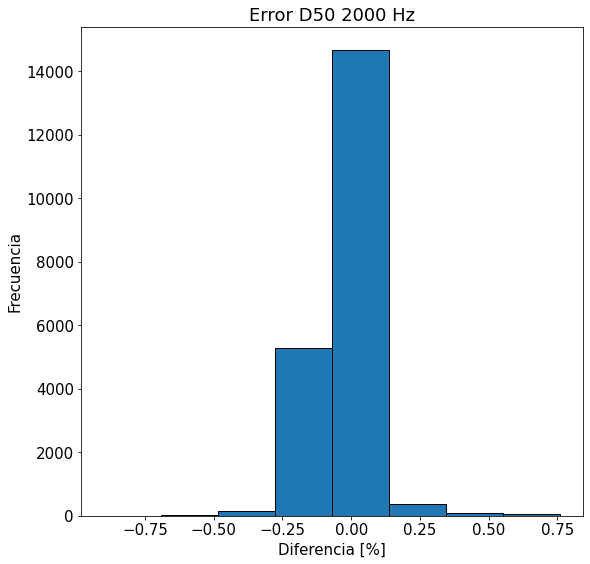

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

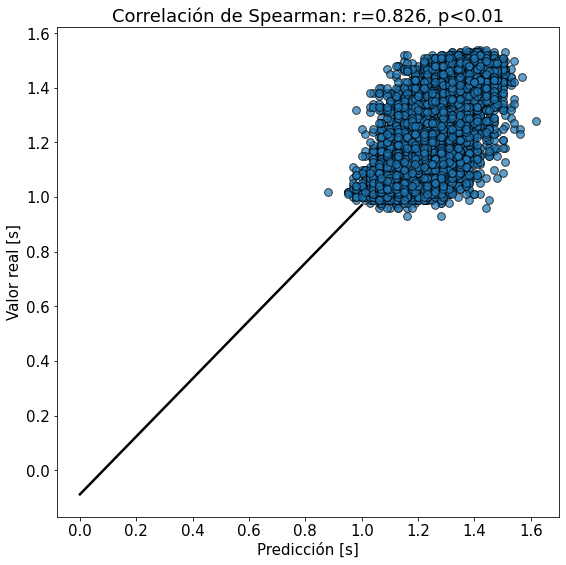

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

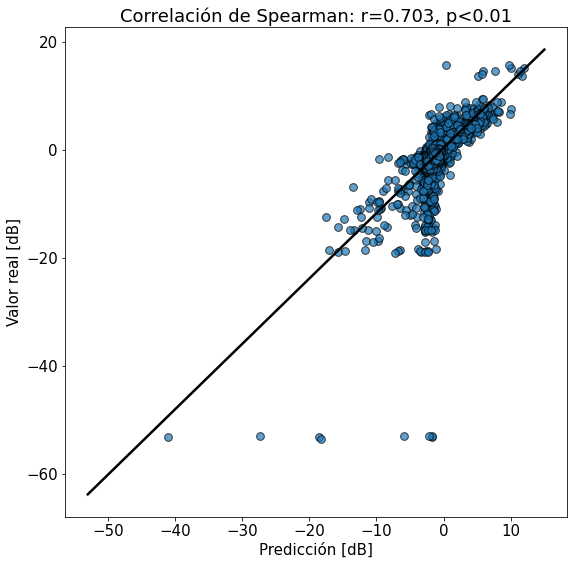

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

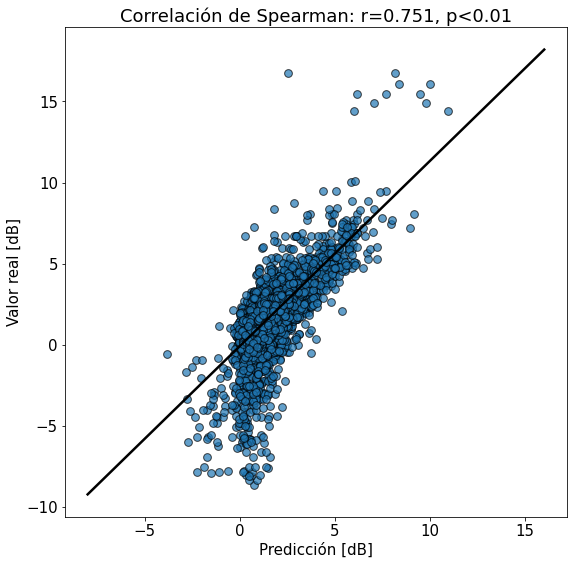

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

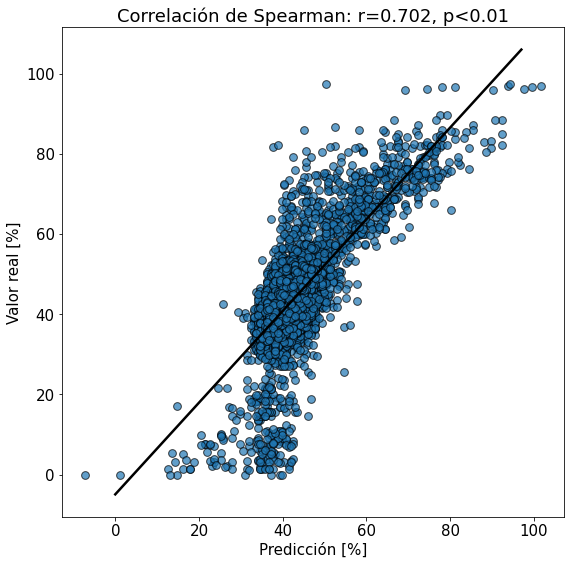

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

4000 Hz

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE con ruido - 1 a 1.5s')

band = 4000

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-135.32841016500925
29.56938376858373


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

1.4689115563552506
0.3456340723923269
3.1705500350632185
51.98858016152392


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.08929118511572362
Máximo y_train: 29.56938376858373
Mínimo y_train: -135.32841016500925


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
73/73 [==============================] - 2s 16ms/step - loss: 6.5181 - val_loss: 4.4434
Epoch 2/500
73/73 [==============================] - 1s 13ms/step - loss: 5.3520 - val_loss: 4.9436
Epoch 3/500
73/73 [==============================] - 1s 13ms/step - loss: 5.0419 - val_loss: 4.9835
Epoch 4/500
73/73 [==============================] - 1s 12ms/step - loss: 4.8212 - val_loss: 5.0405
Epoch 5/500
73/73 [==============================] - 1s 13ms/step - loss: 4.5161 - val_loss: 5.4090
Epoch 6/500
73/73 [==============================] - 1s 13ms/step - loss: 4.0161 - val_loss: 4.8411
Epoch 7/500
73/73 [==============================] - 1s 13ms/step - loss: 3.7026 - val_loss: 4.2276
Epoch 8/500
73/73 [==============================] - 1s 12ms/step - loss: 3.5569 - val_loss: 3.6331
Epoch 9/500
73/73 [==============================] - 1s 13ms/step - loss: 3.4774 - val_loss: 2.9519
Epoch 10/500
73/73 [==============================] - 1s 13ms/step - loss: 3.3918 - val_loss: 2.5938

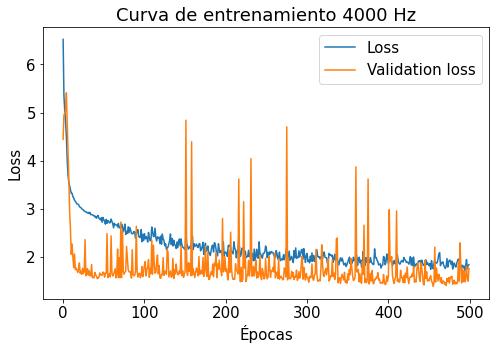

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([3.4400e+02, 6.9900e+03, 1.1568e+04, 1.7300e+03, 5.7000e+01,
        6.0000e+00, 0.0000e+00, 1.0000e+00]),
 array([-0.24 , -0.125, -0.01 ,  0.105,  0.22 ,  0.335,  0.45 ,  0.565,
         0.68 ]),
 <a list of 8 Patch objects>)

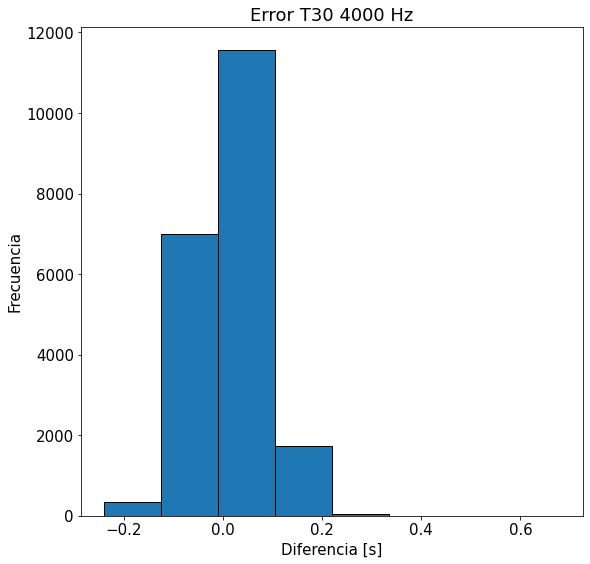

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([4.3000e+01, 2.0474e+04, 1.6100e+02, 1.1000e+01, 2.0000e+00,
        1.0000e+00, 1.0000e+00, 3.0000e+00]),
 array([-36.31   , -15.52375,   5.2625 ,  26.04875,  46.835  ,  67.62125,
         88.4075 , 109.19375, 129.98   ]),
 <a list of 8 Patch objects>)

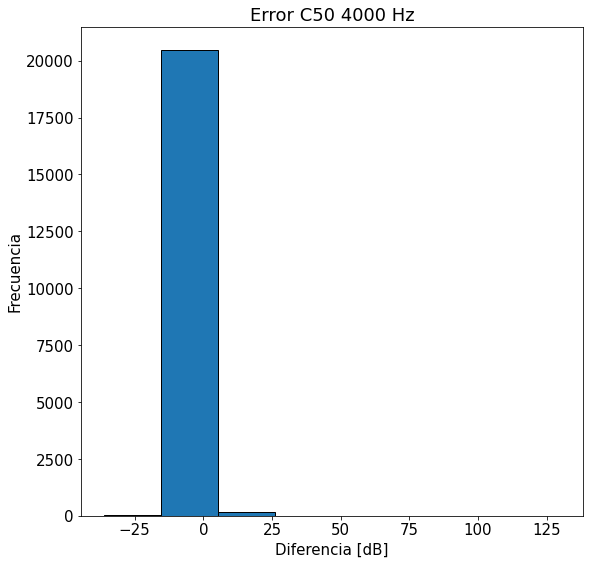

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([3.0000e+00, 2.9000e+01, 1.9800e+02, 9.3940e+03, 1.0907e+04,
        8.8000e+01, 5.4000e+01, 2.3000e+01]),
 array([-2.6    , -1.96125, -1.3225 , -0.68375, -0.045  ,  0.59375,
         1.2325 ,  1.87125,  2.51   ]),
 <a list of 8 Patch objects>)

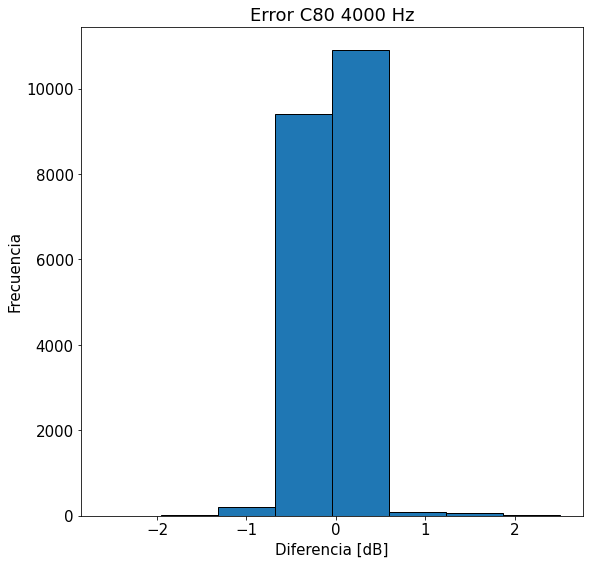

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([   20.,    64.,   285.,  8217., 11917.,    95.,    82.,    16.]),
 array([-0.87, -0.66, -0.45, -0.24, -0.03,  0.18,  0.39,  0.6 ,  0.81]),
 <a list of 8 Patch objects>)

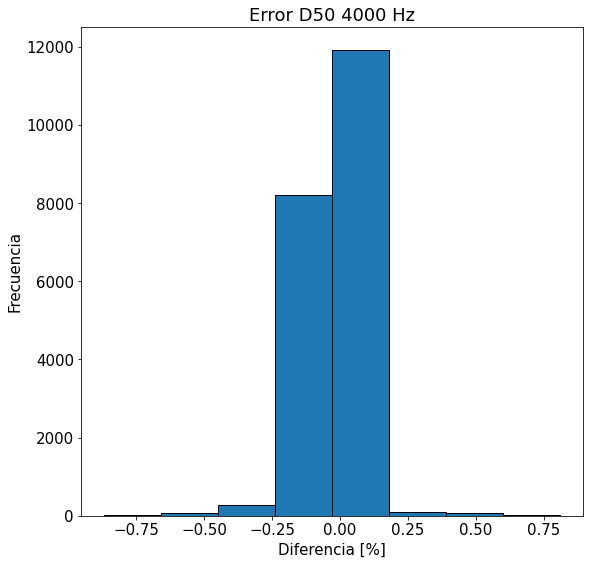

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

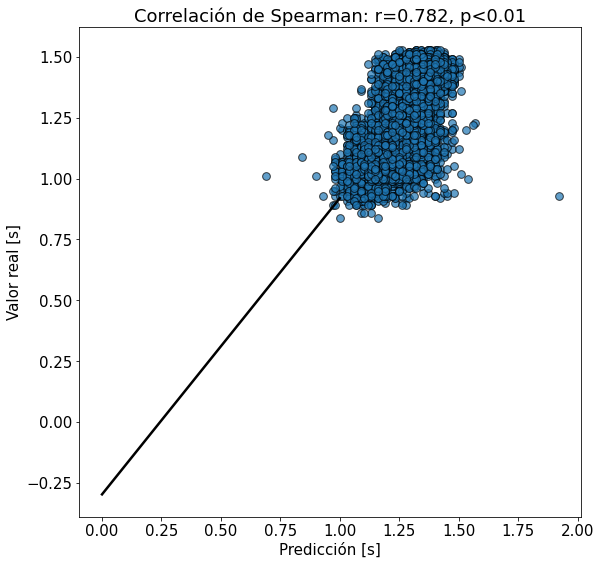

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

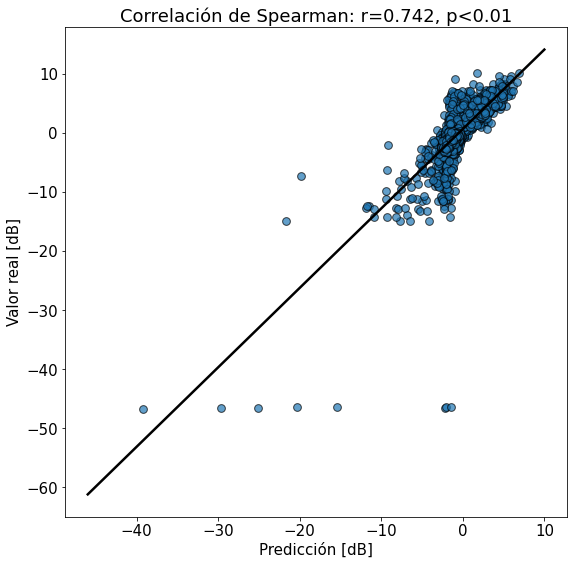

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

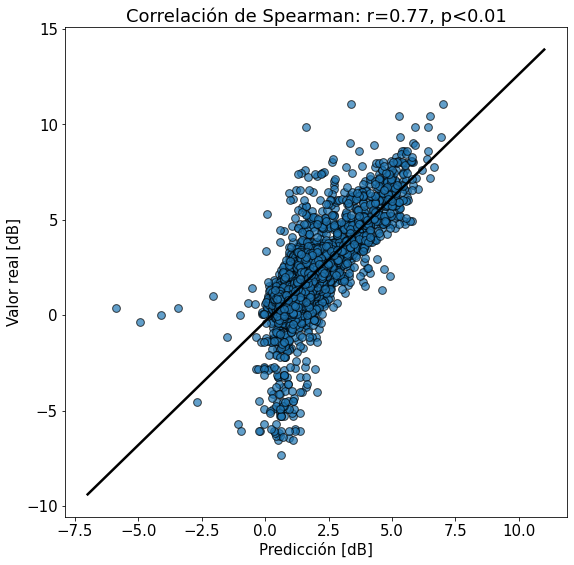

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

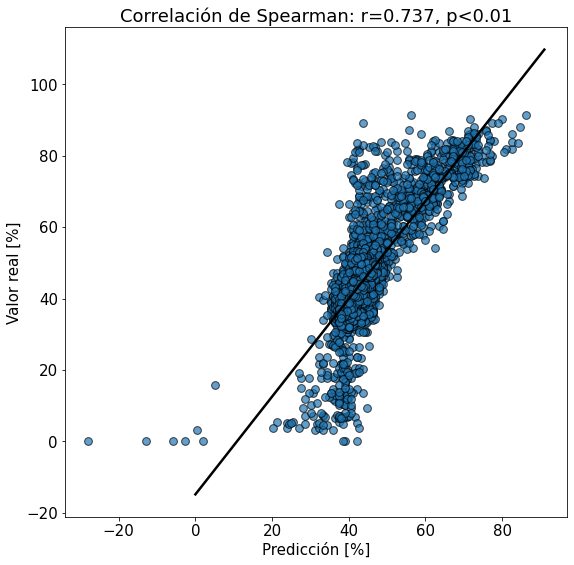

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')

8000 Hz

In [ ]:
#Me muevo al directorio de las bases de datos:
os.chdir('/content/drive/My Drive/Tesis/Base de datos/TAE con ruido - 1 a 1.5s')

band = 8000

#Busco los valores de TAE y los parámetros:
with open(f'TAE/TAE_{str(band)}.pickle', 'rb') as handle:
    tae_dic = pickle.load(handle)

with open(f'Parámetros/Parametros_{str(band)}.pickle', 'rb') as handle:
    params_dic = pickle.load(handle)

#Borro los outliers captados en "Análisis base de datos.ipynb":
for outlier in outliers:
  tae_dic.pop(outlier)
  params_dic.pop(outlier)

#Separo en train y test:

names = list(tae_dic.keys())

tae = [[]] * int(len(names)) #Genero una lista de listas vacías
params = [[]] * int(len(names)) #Genero una lista de listas vacías

for i, name in enumerate(names):
    
    tae[i] = tae_dic[name].reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow
    params[i] = np.array(params_dic[name]).reshape(-1, 1) #Le agrego una dimensión más para que lo tome tensorflow


X = np.array(tae)
y = np.array(params)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

#Normalización de los parámetros:
T30 = [params[i][0][0] for i in range(len(params))]
C50 = [params[i][1][0] for i in range(len(params))]
C80 = [params[i][2][0] for i in range(len(params))]
D50 = [params[i][3][0] for i in range(len(params))]
#C50 = [10**(params[i][1][0] / 10) for i in range(len(params))] #Saco el dB
#C80 = [10**(params[i][2][0] / 10) for i in range(len(params))] #Saco el dB
#D50 = [params[i][3][0]/100 for i in range(len(params))] #Saco el porcentaje

T30_perc_95 = np.percentile(T30, 95)
C50_perc_95 = np.percentile(C50, 95)
C80_perc_95 = np.percentile(C80, 95)
D50_perc_95 = np.percentile(D50, 95)

norm = np.array([T30_perc_95, C50_perc_95, C80_perc_95, D50_perc_95]).reshape(-1, 1)

y_train = np.array([y_train[i]/norm for i in range(len(y_train))])
y_test = np.array([y_test[i]/norm for i in range(len(y_test))])

In [ ]:
print(np.min(y_train))
print(np.max(y_train))

-92.42056548674425
31.972983703525617


In [ ]:
print(T30_perc_95) #Raro el T30! capaz tengo que calcular de nuevo!!!
print(C50_perc_95)
print(C80_perc_95)
print(D50_perc_95)

1.468178922994511
0.3605493680145957
3.1882832103587893
52.07429775592961


In [ ]:
#Cargo el modelo:
blind_estimation_model = modelo()

#Descripción:
blind_estimation_model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 Audio de entrada (InputLaye  [(None, 200, 1)]         0         
 r)                                                              
                                                                 
 capa1_conv (Conv1D)         (None, 191, 32)           352       
                                                                 
 capa1_pool (MaxPooling1D)   (None, 95, 32)            0         
                                                                 
 Batch_capa1 (BatchNormaliza  (None, 95, 32)           128       
 tion)                                                           
                                                                 
 capa2_conv (Conv1D)         (None, 91, 16)            2576      
                                                                 
 capa2_pool (MaxPooling1D)   (None, 45, 16)            0     

In [ ]:
assert not np.any(np.isnan(X_train))

print(f'Máximo X_train: {np.max(X_train)}')
print(f'Mínimo X_train: {np.min(X_train)}')

assert not np.any(np.isnan(y_train))

print(f'Máximo y_train: {np.max(y_train)}')
print(f'Mínimo y_train: {np.min(y_train)}')

Máximo X_train: 1.0
Mínimo X_train: -0.13020335814077358
Máximo y_train: 31.972983703525617
Mínimo y_train: -92.42056548674425


In [ ]:
#Entreno el modelo:
history = blind_estimation_model.fit(x=X_train[:,:,:], y=y_train[:,:,:], validation_split=0.1, batch_size=1024, epochs=500)

Epoch 1/500
73/73 [==============================] - 2s 17ms/step - loss: 5.4804 - val_loss: 4.7637
Epoch 2/500
73/73 [==============================] - 1s 12ms/step - loss: 4.1992 - val_loss: 4.7795
Epoch 3/500
73/73 [==============================] - 1s 12ms/step - loss: 3.2265 - val_loss: 5.0811
Epoch 4/500
73/73 [==============================] - 1s 13ms/step - loss: 2.8642 - val_loss: 4.9093
Epoch 5/500
73/73 [==============================] - 1s 13ms/step - loss: 2.7219 - val_loss: 4.7030
Epoch 6/500
73/73 [==============================] - 1s 13ms/step - loss: 2.6215 - val_loss: 4.5128
Epoch 7/500
73/73 [==============================] - 1s 13ms/step - loss: 2.5227 - val_loss: 4.0868
Epoch 8/500
73/73 [==============================] - 1s 12ms/step - loss: 2.4810 - val_loss: 3.1760
Epoch 9/500
73/73 [==============================] - 1s 13ms/step - loss: 2.4157 - val_loss: 2.4079
Epoch 10/500
73/73 [==============================] - 1s 13ms/step - loss: 2.3793 - val_loss: 2.0448

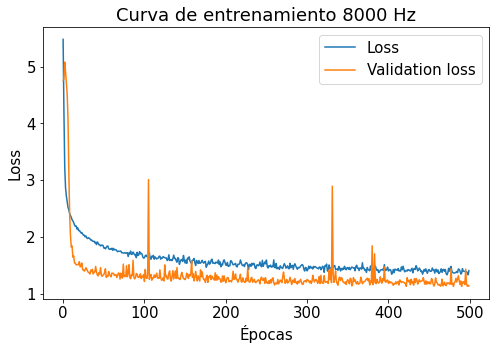

In [ ]:
#PLot del val_loss y del loss:
plt.figure(facecolor='white', figsize=[8,5] )
plt.rcParams.update({'font.size': 15})
plt.plot(history.history['loss'], label='Loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.ylabel('Loss')
plt.xlabel('Épocas')
plt.title(f'Curva de entrenamiento {band} Hz')
plt.legend()
plt.show()

In [ ]:
#Calculo del error cuadrático medio:
prediction = [np.round(blind_estimation_model.predict(X_test[i,:,0].reshape(1,-1,1)),2)[0] for i in range(len(y_test))]

In [ ]:
err_t30 = [np.round(prediction[i][0] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[0],2) for i in range(len(y_test))]
err_c50 = [np.round(prediction[i][1] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[1],2) for i in range(len(y_test))]
err_c80 = [np.round(prediction[i][2] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[2],2) for i in range(len(y_test))]
err_d50 = [np.round(prediction[i][3] - np.round(y_test[i,:,0].reshape(1,-1,1),2).flatten()[3],2) for i in range(len(y_test))]

(array([9.0700e+02, 1.8114e+04, 1.6200e+03, 4.3000e+01, 7.0000e+00,
        4.0000e+00, 0.0000e+00, 1.0000e+00]),
 array([-0.31   , -0.11875,  0.0725 ,  0.26375,  0.455  ,  0.64625,
         0.8375 ,  1.02875,  1.22   ]),
 <a list of 8 Patch objects>)

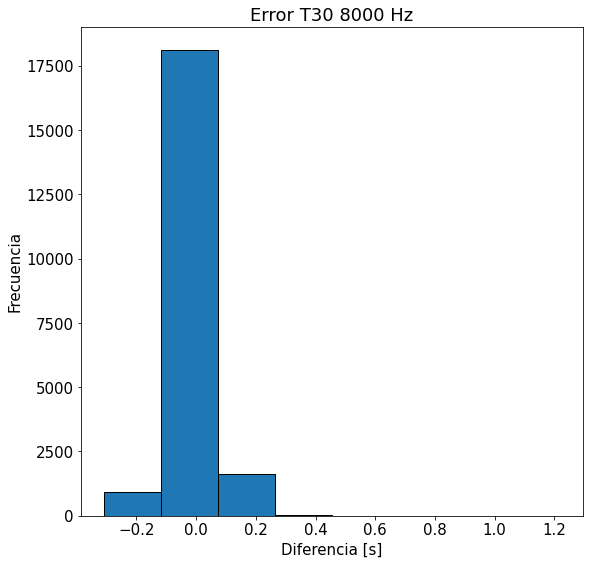

In [ ]:
# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error T30 {band} Hz')

ax.set_xlabel('Diferencia [s]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_t30, bins=8, edgecolor="black")

(array([2.2000e+01, 7.1700e+02, 1.9918e+04, 3.2000e+01, 1.0000e+00,
        0.0000e+00, 2.0000e+00, 4.0000e+00]),
 array([-34.41   , -18.63125,  -2.8525 ,  12.92625,  28.705  ,  44.48375,
         60.2625 ,  76.04125,  91.82   ]),
 <a list of 8 Patch objects>)

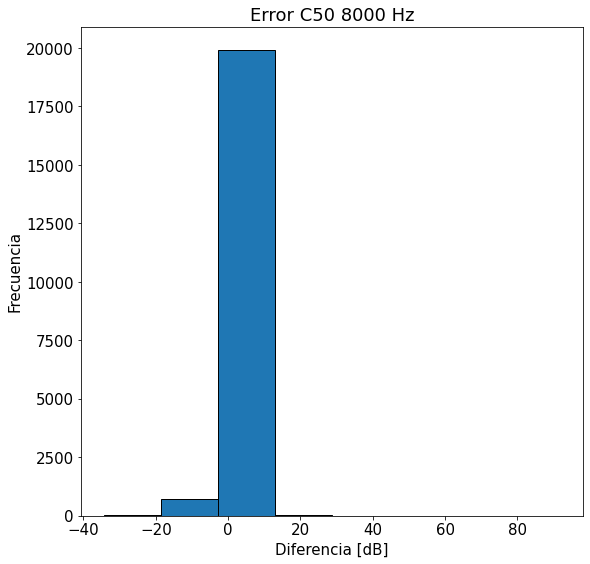

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C50 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c50, bins=8, edgecolor="black")

(array([1.0000e+00, 0.0000e+00, 2.0000e+00, 1.5000e+01, 1.3700e+02,
        1.6404e+04, 4.0830e+03, 5.4000e+01]),
 array([-5.19  , -4.3075, -3.425 , -2.5425, -1.66  , -0.7775,  0.105 ,
         0.9875,  1.87  ]),
 <a list of 8 Patch objects>)

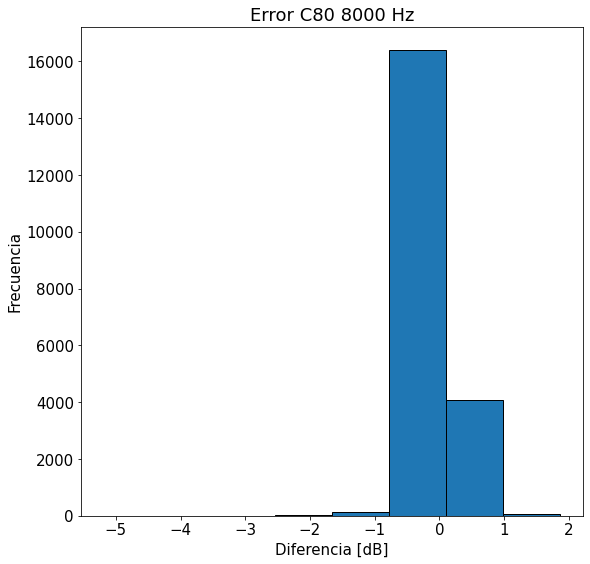

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error C80 {band} Hz')

ax.set_xlabel('Diferencia [dB]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_c80, bins=8, edgecolor="black")

(array([1.0000e+00, 0.0000e+00, 1.5000e+01, 1.0100e+02, 6.1490e+03,
        1.4369e+04, 5.3000e+01, 8.0000e+00]),
 array([-1.62   , -1.29875, -0.9775 , -0.65625, -0.335  , -0.01375,
         0.3075 ,  0.62875,  0.95   ]),
 <a list of 8 Patch objects>)

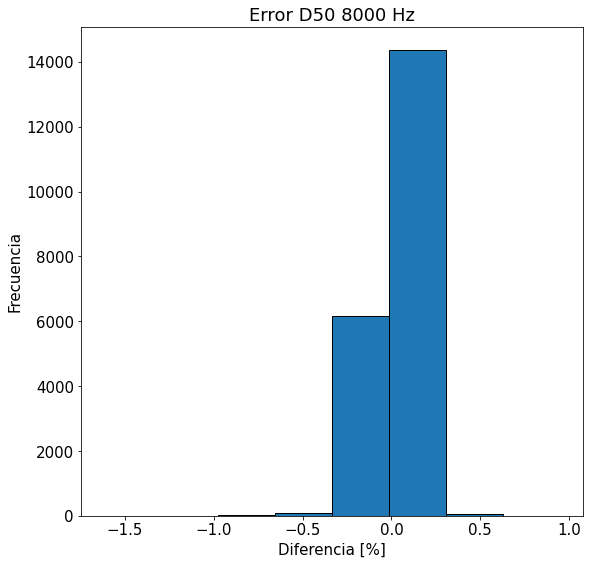

In [ ]:
#Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

ax.set_title(f'Error D50 {band} Hz')

ax.set_xlabel('Diferencia [%]')
ax.set_ylabel('Frecuencia')

#plot
ax.hist(err_d50, bins=8, edgecolor="black")

Text(0, 0.5, 'Valor real [s]')

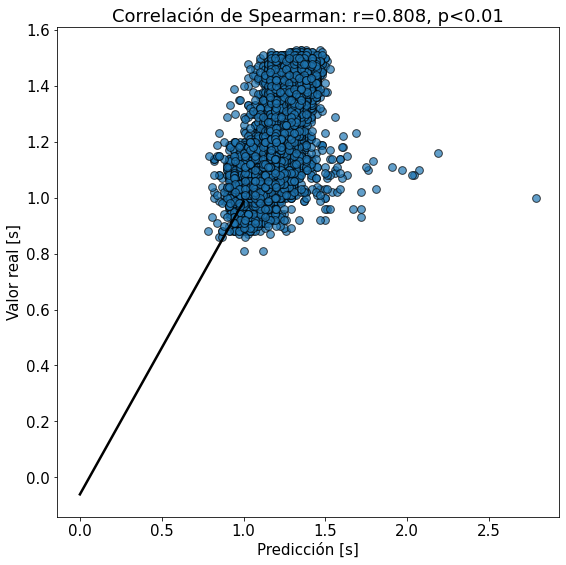

In [ ]:
# Generate data: T30
x = [np.round(prediction[i][0] * T30_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[0] * T30_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [s]')
ax.set_ylabel('Valor real [s]')

Text(0, 0.5, 'Valor real [dB]')

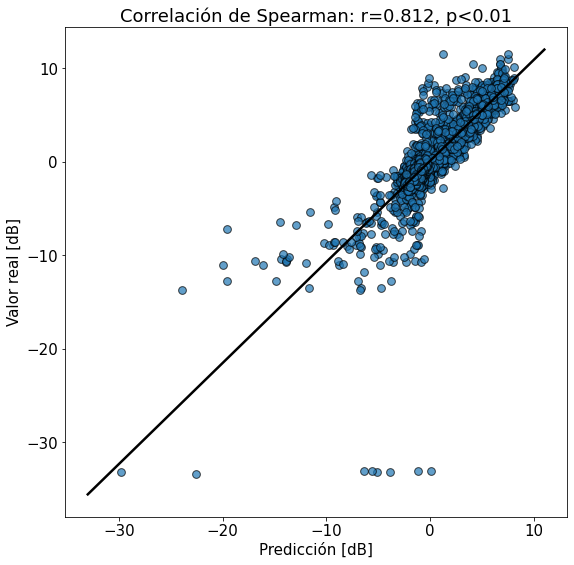

In [ ]:
# Generate data: C50
x = [np.round(prediction[i][1] * C50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[1] * C50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [dB]')

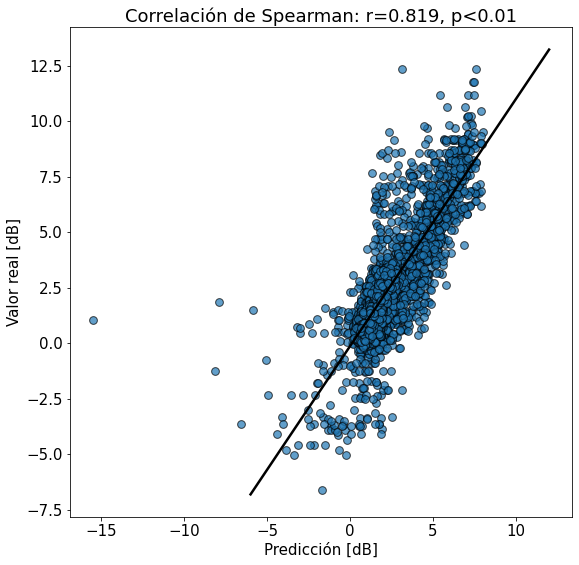

In [ ]:
# Generate data: C80
x = [np.round(prediction[i][2] * C80_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[2] * C80_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [dB]')
ax.set_ylabel('Valor real [dB]')

Text(0, 0.5, 'Valor real [%]')

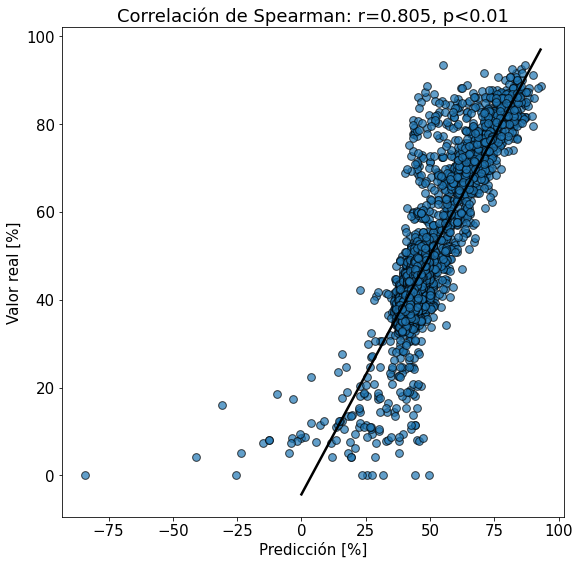

In [ ]:
# Generate data: d50
x = [np.round(prediction[i][3] * D50_perc_95,2) for i in range(len(y_test))]
y = [np.round(y_test[i,:,0].reshape(1,-1,1).flatten()[3] * D50_perc_95 ,2)  for i in range(len(y_test))]

# Initialize layout
fig, ax = plt.subplots(figsize = (9, 9))

# Add scatterplot
ax.scatter(x, y, s=60, alpha=0.7, edgecolors="k")

# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
b, a = np.polyfit(x, y, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(int(np.min(y)), int(np.max(y)), num=100)

# Plot regression line
ax.plot(xseq, a + b * xseq, color="k", lw=2.5);

ax.set_title(f'Correlación de Spearman: r={str(np.round(stats.spearmanr(x, y)[0],3))}, p<0.01')
ax.set_xlabel('Predicción [%]')
ax.set_ylabel('Valor real [%]')